# Wi-Fi Data Analysis on Router 2

In [128]:
# Import necessary libraries for data analysis

# Pandas for data manipulation and analysis
import pandas as pd

# Numpy for numerical operations
import numpy as np

# Matplotlib for creating static, animated, and interactive visualizations
import matplotlib.pyplot as plt

# Seaborn for statistical data visualization
import seaborn as sns

# SciPy for scientific computing
from scipy import stats

# Sklearn for machine learning
from sklearn import datasets, linear_model

# statsmodels for statistical modeling
import statsmodels.api as sm


In [773]:
import pandas as pd

# Load a csv file while skipping the first row
df_2_4ghz = pd.read_csv('2.4 Ghz Channel.csv', skiprows=1)
df_5ghz = pd.read_csv('5 Ghz Channel.csv', skiprows=1)
df_temp= pd.read_csv('Hardware Temperature.csv', skiprows=1)
df_inter = pd.read_csv('Interface Frequency.csv', skiprows=1)
df_signal = pd.read_csv('Signal Strength.csv', skiprows=1)
df_throughputs = pd.read_csv('Throughputs.csv', skiprows=1)
df_disk = pd.read_csv('Disk Space.csv', skiprows=1)
df_cpu1 = pd.read_csv('Cpu Basic Data.csv', skiprows=1)
df_cpu2 = pd.read_csv('Cpu Basic Data 2.csv')
df_discon = pd.read_csv('Disconnection Count.csv', skiprows=1)
df_net_receive = pd.read_csv('Network Receive Data.csv')
df_num_clients = pd.read_csv('Number of Clients.csv', skiprows=1)
df_resident = pd.read_csv('Resident Memory.csv')
df_status= pd.read_csv('Status.csv', skiprows=1)
df_traffic = pd.read_csv('Network Traffic.csv', skiprows=1)
df_memory_basic = pd.read_csv('Memory Basic Data.csv', skiprows=1)
df_transmit = pd.read_csv('Transmission Data.csv')
df_trottle = pd.read_csv('Throttle Cooling.csv', skiprows=1)
df_virt = pd.read_csv('Virtual Memory Data.csv')

In [774]:
# Create separate dataframes for each room, set 'Time' as the index, and drop missing values
df_bedroom1 = df_signal[['Time'] + [f'192.168.10.130 wlan{i}' for i in range(1, 8)]].set_index('Time').dropna()
df_bedroom2 = df_signal[['Time'] + [f'192.168.10.140 wlan{i}' for i in range(1, 8)]].set_index('Time').dropna()
df_recroom1 = df_signal[['Time'] + [f'192.168.10.150 wlan{i}' for i in range(1, 8)]].set_index('Time').dropna()
df_recroom2 = df_signal[['Time'] + [f'192.168.10.160 wlan{i}' for i in range(1, 8)]].set_index('Time').dropna()
df_gallery1 = df_signal[['Time'] + [f'192.168.10.210 wlan{i}' for i in range(1, 8)]].set_index('Time').dropna()
df_kitchen = df_signal[['Time'] + [f'192.168.10.220 wlan{i}' for i in range(1, 8)]].set_index('Time').dropna()
df_gallery2 = df_signal[['Time'] + [f'192.168.10.240 wlan{i}' for i in range(1, 8)]].set_index('Time').dropna()


In [468]:
# Fill NaN values with -100
#df_bedroom1.fillna(-100, inplace=True)
#df_bedroom2.fillna(-100, inplace=True)
#df_recroom1.fillna(-100, inplace=True)
#df_recroom2.fillna(-100, inplace=True)
#df_gallery1.fillna(-100, inplace=True)
#df_kitchen.fillna(-100, inplace=True)
#df_gallery2.fillna(-100, inplace=True)
df_bedroom1

,192.168.10.130 wlan1,192.168.10.130 wlan2,192.168.10.130 wlan3,192.168.10.130 wlan4,192.168.10.130 wlan5,192.168.10.130 wlan6,192.168.10.130 wlan7
Time,,,,,,,
2023-06-20 17:26:00,-42.0,-52.0,-50.0,-53.0,-51.0,-54.0,-50.0
2023-06-20 17:28:00,-43.0,-52.0,-49.0,-52.0,-50.0,-54.0,-49.0
2023-06-20 17:30:00,-43.0,-52.0,-50.0,-52.0,-51.0,-54.0,-49.0
2023-06-20 17:32:00,-43.0,-52.0,-50.0,-53.0,-50.0,-53.0,-50.0
2023-06-20 17:34:00,-42.0,-51.0,-49.0,-52.0,-50.0,-52.0,-48.0
...,...,...,...,...,...,...,...
2023-06-22 17:18:00,-44.0,-53.0,-50.0,-53.0,-48.0,-53.0,-49.0
2023-06-22 17:20:00,-44.0,-54.0,-50.0,-53.0,-49.0,-53.0,-50.0
2023-06-22 17:22:00,-44.0,-53.0,-50.0,-53.0,-49.0,-53.0,-50.0


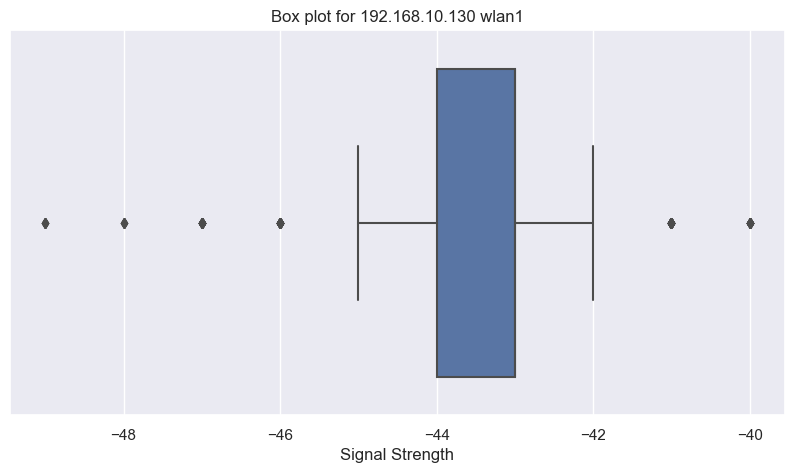

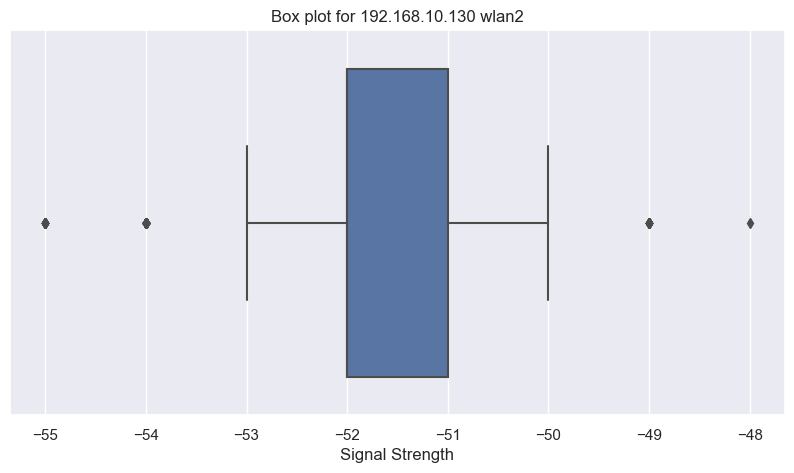

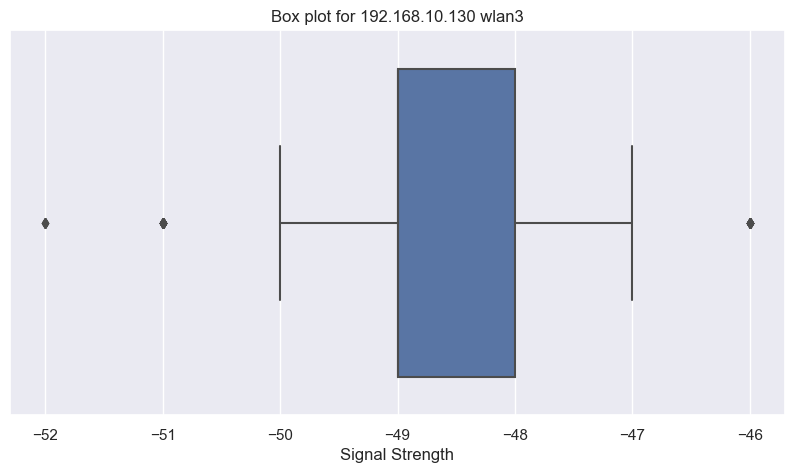

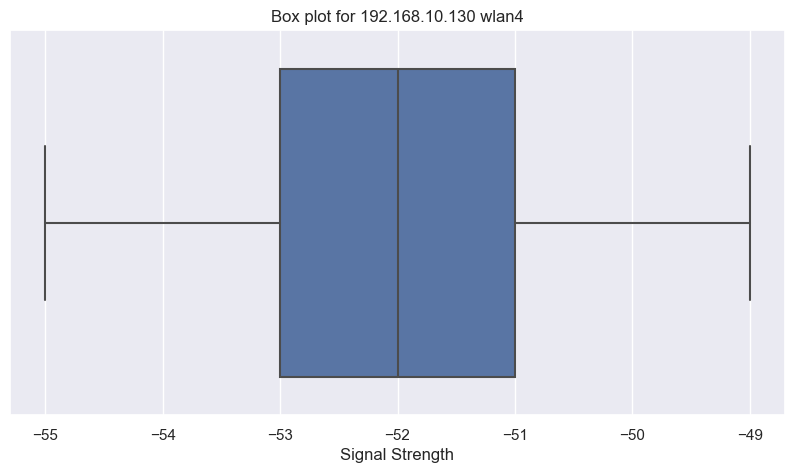

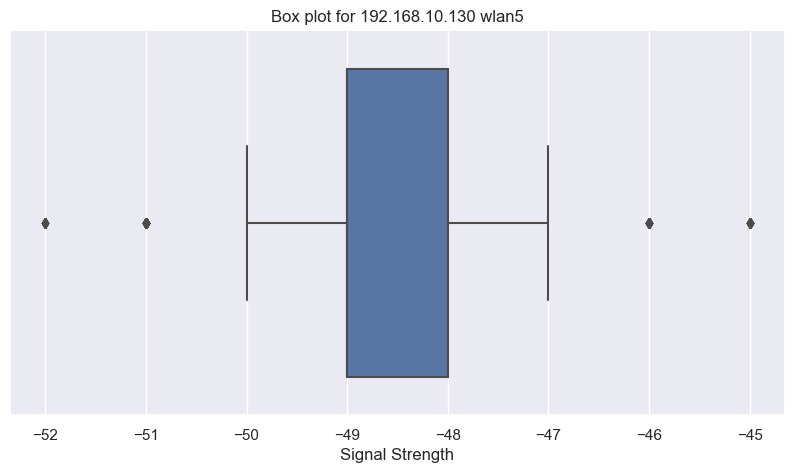

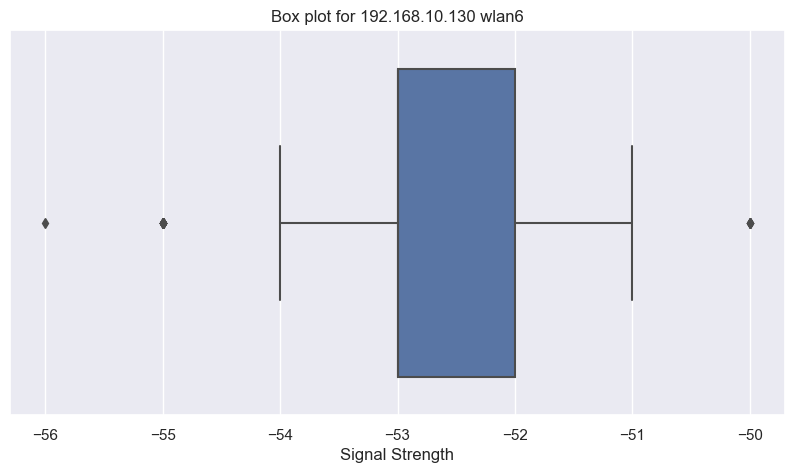

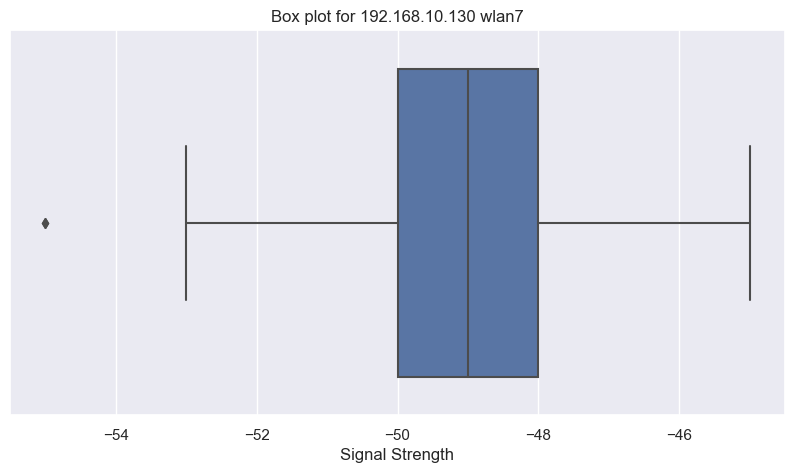

In [469]:
# Create a box plot for each column in df_bedroom1
for column in df_bedroom1.columns:
    plt.figure(figsize=(10,5))
    sns.boxplot(x=df_bedroom1[column])
    plt.title(f'Box plot for {column}')
    plt.xlabel('Signal Strength')
    plt.show()


In [470]:
from scipy import stats

# let's take df_bedroom1 as an example
z_scores = np.abs(stats.zscore(df_bedroom1))

# The below line will return the indices of points where the absolute z-score is greater than 3 (a common cut-off for outliers in a standard normal distribution).
outlier_indices = np.where(z_scores > 4)

# You can examine these points and see if they make sense given what you know about your data.
outliers = df_bedroom1.iloc[outlier_indices]

outliers


,192.168.10.130 wlan7,192.168.10.130 wlan1,192.168.10.130 wlan1,192.168.10.130 wlan1,192.168.10.130 wlan1,192.168.10.130 wlan1,192.168.10.130 wlan7
Time,,,,,,,
2023-06-20 19:38:00,-55.0,-45.0,-45.0,-45.0,-45.0,-45.0,-55.0
2023-06-20 23:42:00,-50.0,-49.0,-49.0,-49.0,-49.0,-49.0,-50.0
2023-06-20 23:44:00,-50.0,-49.0,-49.0,-49.0,-49.0,-49.0,-50.0
2023-06-20 23:50:00,-50.0,-49.0,-49.0,-49.0,-49.0,-49.0,-50.0
2023-06-20 23:56:00,-50.0,-49.0,-49.0,-49.0,-49.0,-49.0,-50.0
2023-06-21 00:00:00,-49.0,-49.0,-49.0,-49.0,-49.0,-49.0,-49.0
2023-06-21 15:40:00,-55.0,-42.0,-42.0,-42.0,-42.0,-42.0,-55.0


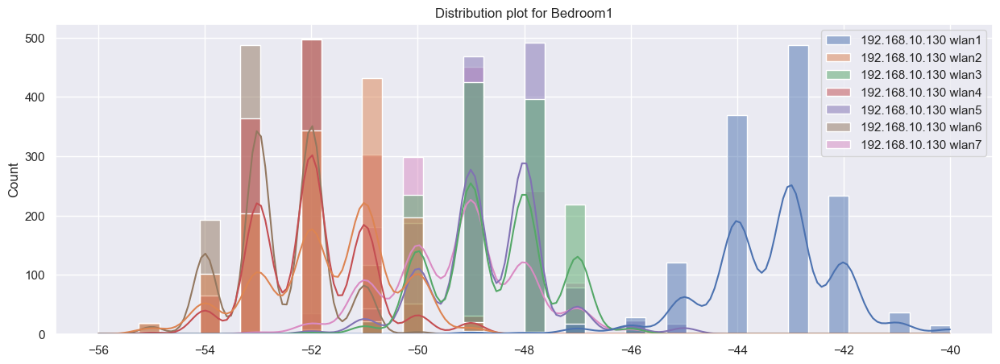

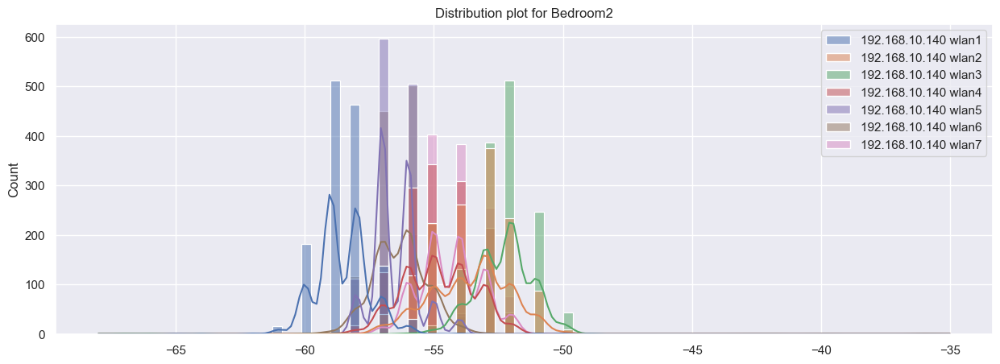

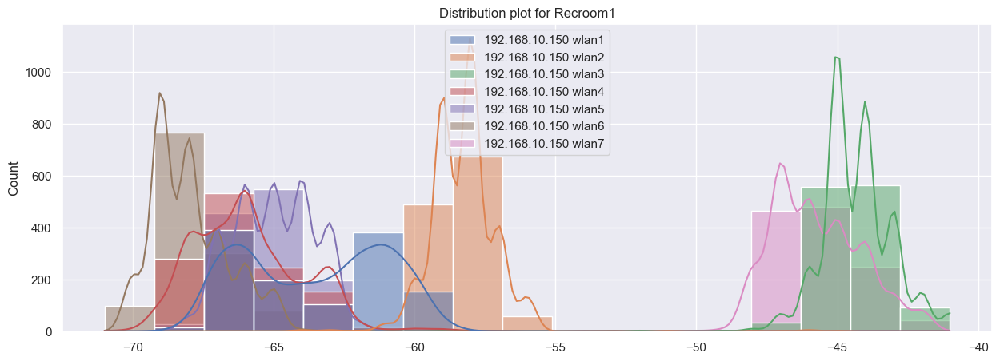

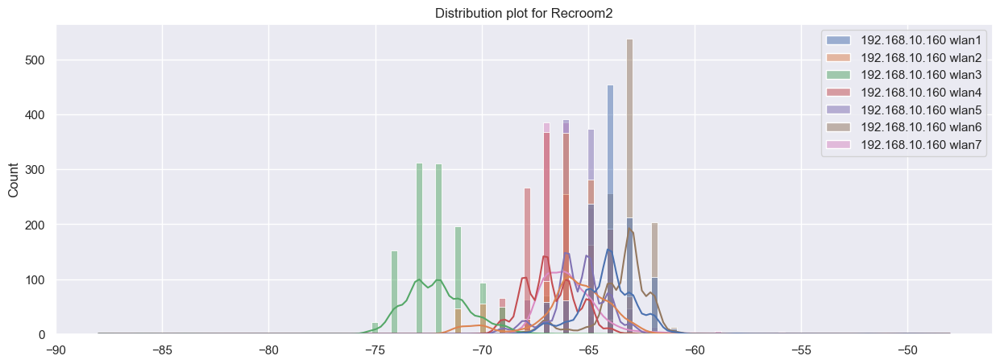

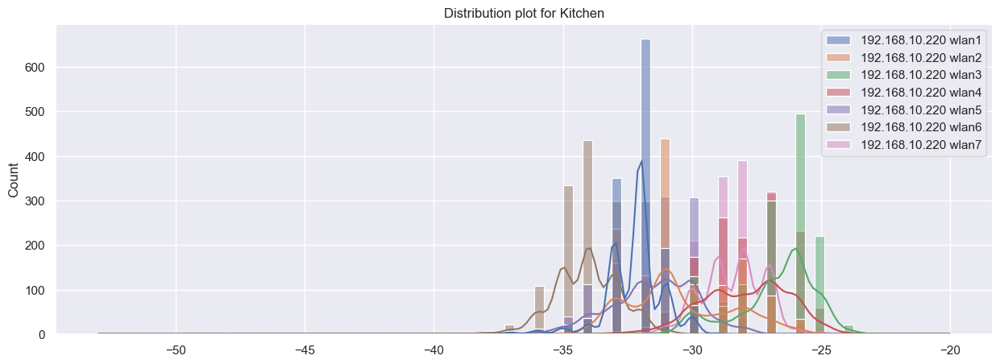

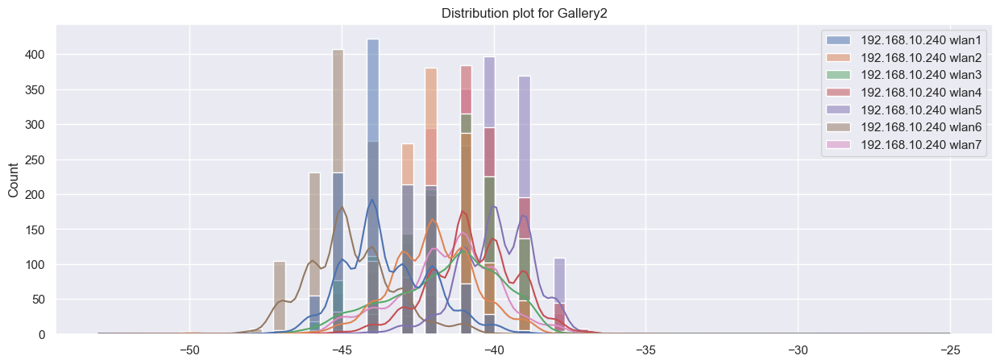

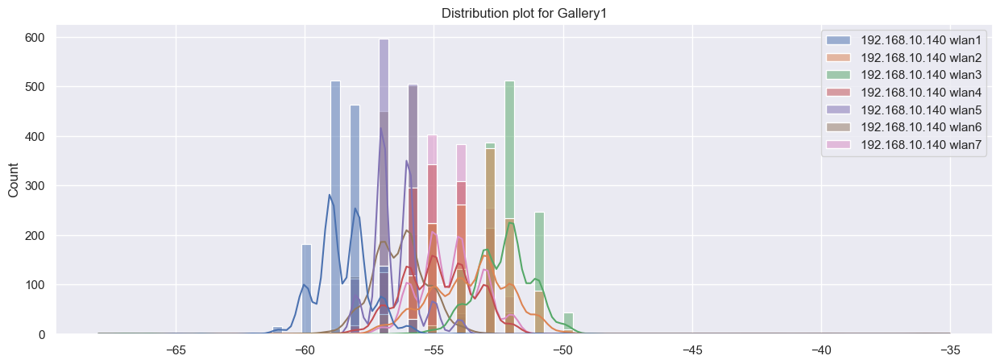

In [776]:
# Plot distribution for Bedroom1
plt.figure(figsize=(15,5))
sns.histplot(df_bedroom1, kde=True)
plt.title('Distribution plot for Bedroom1')
plt.show()



# Plot distribution for Bedroom2
plt.figure(figsize=(15,5))
sns.histplot(df_bedroom2, kde=True)
plt.title('Distribution plot for Bedroom2')
plt.show()


# Plot distribution for recroom1
plt.figure(figsize=(15,5))
sns.histplot(df_recroom1, kde=True)
plt.title('Distribution plot for Recroom1')
plt.show()

# Plot distribution for recroom 2
plt.figure(figsize=(15,5))
sns.histplot(df_recroom2, kde=True)
plt.title('Distribution plot for Recroom2')
plt.show()


# Plot distribution for Kitchen
plt.figure(figsize=(15,5))
sns.histplot(df_kitchen, kde=True)
plt.title('Distribution plot for Kitchen')
plt.show()

# Plot distribution for Gallery2
plt.figure(figsize=(15,5))
sns.histplot(df_gallery2, kde=True)
plt.title('Distribution plot for Gallery2')
plt.show()

# Plot distribution for Gallery 1
plt.figure(figsize=(15,5))
sns.histplot(df_bedroom2, kde=True)
plt.title('Distribution plot for Gallery1')
plt.show()


In [ ]:
from scipy.stats import f_oneway

f_oneway(df_bedroom1, df_bedroom2, df_recroom1, df_recroom2, df_gallery1, df_kitchen, df_gallery2)


The `F_onewayResult` object returned from the `f_oneway` function represents the result of the one-way ANOVA test. It contains two arrays: `statistic` and `pvalue`.

The `statistic` array contains the F-statistic values calculated for each group in the one-way ANOVA test. In your case, it appears that there are 7 groups, and the F-statistic values are as follows: [119571.39852634, 90957.07939214, 101765.07158577, 123537.68784536, 151958.73147422, 109611.26499612, 76143.28179494].

The `pvalue` array contains the p-value calculated for each group. The p-value represents the probability of observing the obtained F-statistic value (or a more extreme value) if the null hypothesis is true (i.e., if the means of all groups are equal). In your case, all the p-values are 0, indicating strong evidence against the null hypothesis. This suggests that there are significant differences between the groups in terms of the signal strength.

Overall, the one-way ANOVA test indicates that there are significant differences in signal strength among the groups, based on the extremely low p-values.

Creating Q-Q plot for 192.168.10.130 wlan1


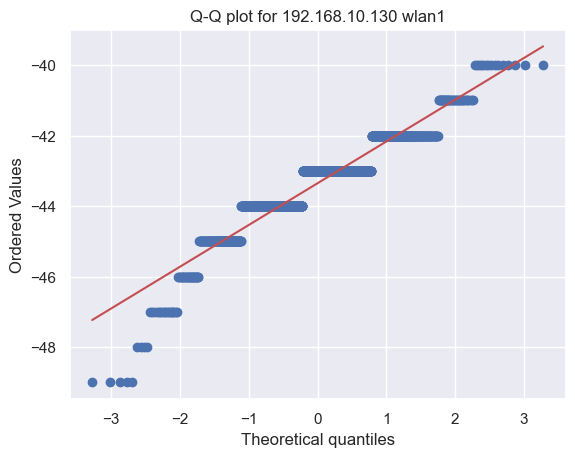

Creating Q-Q plot for 192.168.10.130 wlan2


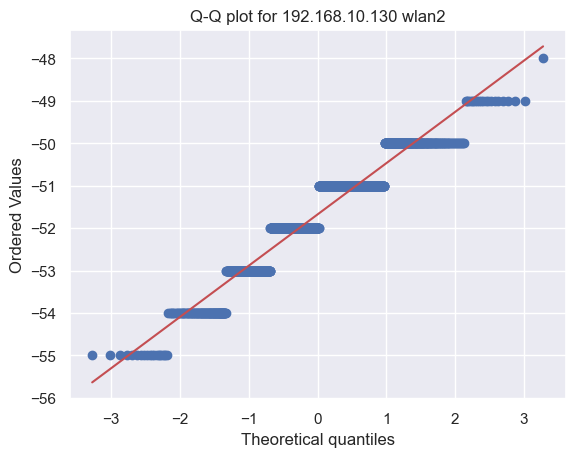

Creating Q-Q plot for 192.168.10.130 wlan3


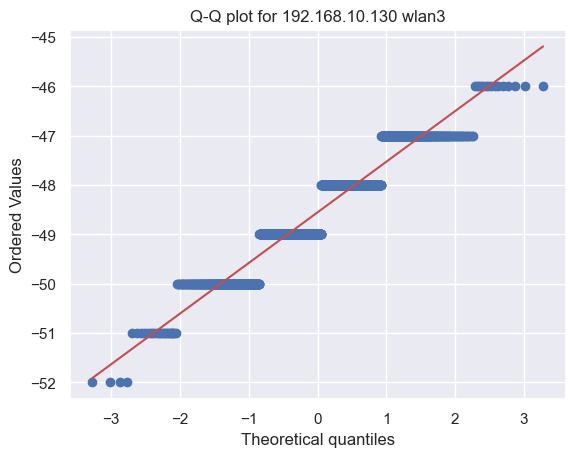

Creating Q-Q plot for 192.168.10.130 wlan4


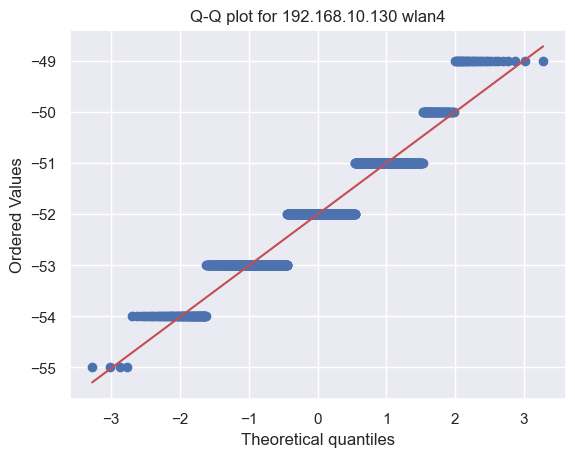

Creating Q-Q plot for 192.168.10.130 wlan5


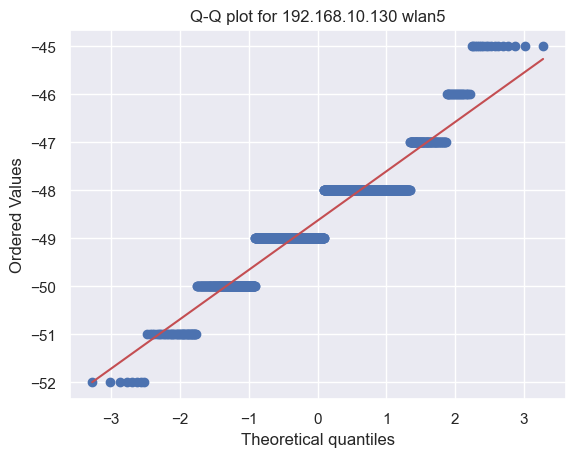

Creating Q-Q plot for 192.168.10.130 wlan6


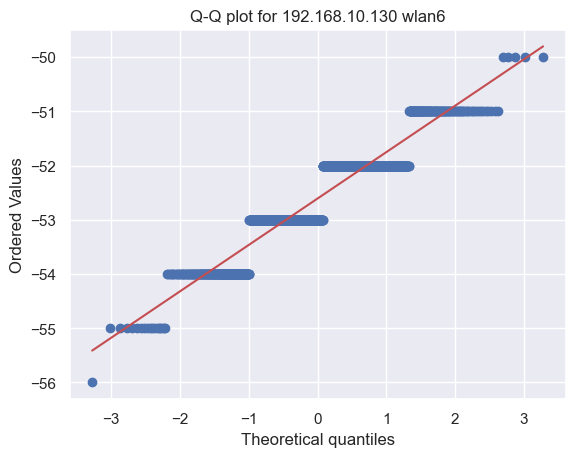

Creating Q-Q plot for 192.168.10.130 wlan7


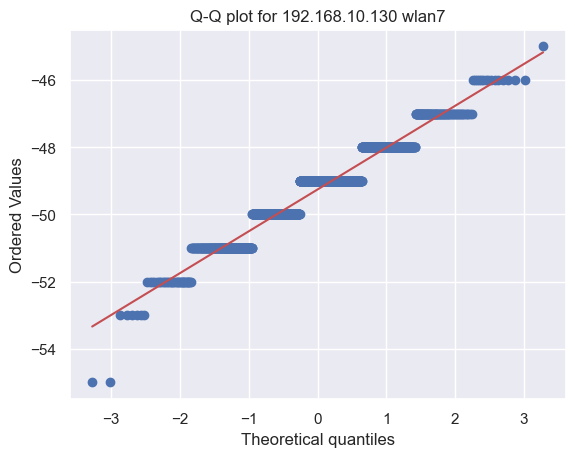

In [473]:
import numpy as np
import scipy.stats as stats
import matplotlib.pyplot as plt

for column in df_bedroom1.columns:
    print(f"Creating Q-Q plot for {column}")
    fig = plt.figure()
    res = stats.probplot(df_bedroom1[column].dropna(), plot=plt)
    plt.title(f'Q-Q plot for {column}')
    plt.show()


In [777]:
# Create separate dataframes for each room, set 'Time' as the index, and drop missing values
df_bedroom1 = df_inter[['Time'] + [f'192.168.10.130 wlan{i}' for i in range(1, 8)]].set_index('Time')
df_bedroom2 = df_inter[['Time'] + [f'192.168.10.140 wlan{i}' for i in range(1, 8)]].set_index('Time')
df_recroom1 = df_inter[['Time'] + [f'192.168.10.150 wlan{i}' for i in range(1, 8)]].set_index('Time')
df_recroom2 = df_inter[['Time'] + [f'192.168.10.160 wlan{i}' for i in range(1, 8)]].set_index('Time')
df_gallery1 = df_inter[['Time'] + [f'192.168.10.210 wlan{i}' for i in range(1, 8)]].set_index('Time')
df_kitchen = df_inter[['Time'] + [f'192.168.10.220 wlan{i}' for i in range(1, 8)]].set_index('Time')
df_gallery2 = df_inter[['Time'] + [f'192.168.10.240 wlan{i}' for i in range(1, 8)]].set_index('Time')


In [778]:
df_bedroom1

,192.168.10.130 wlan1,192.168.10.130 wlan2,192.168.10.130 wlan3,192.168.10.130 wlan4,192.168.10.130 wlan5,192.168.10.130 wlan6,192.168.10.130 wlan7
Time,,,,,,,
2023-06-20 17:26:00,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz
2023-06-20 17:28:00,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz
2023-06-20 17:30:00,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz
2023-06-20 17:32:00,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz
2023-06-20 17:34:00,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz
...,...,...,...,...,...,...,...
2023-06-22 17:18:00,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz
2023-06-22 17:20:00,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz
2023-06-22 17:22:00,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz,5.77 GHz


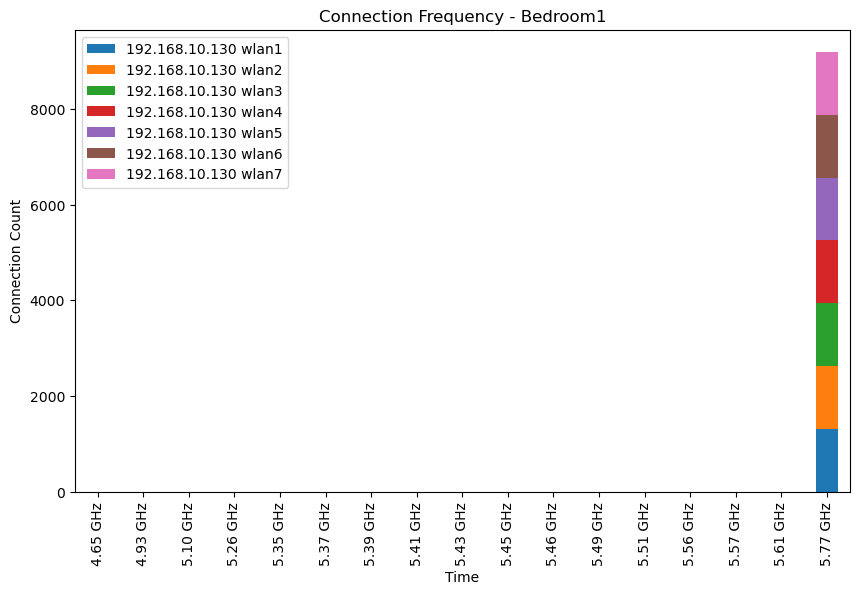

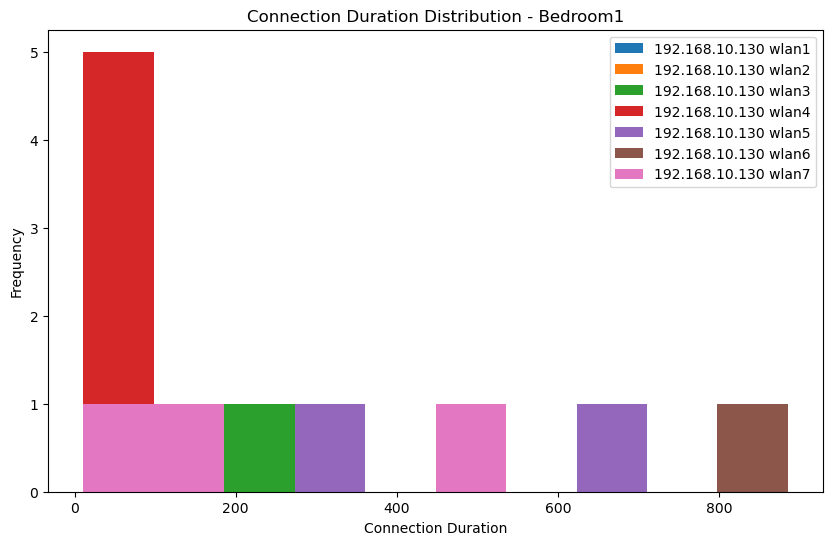

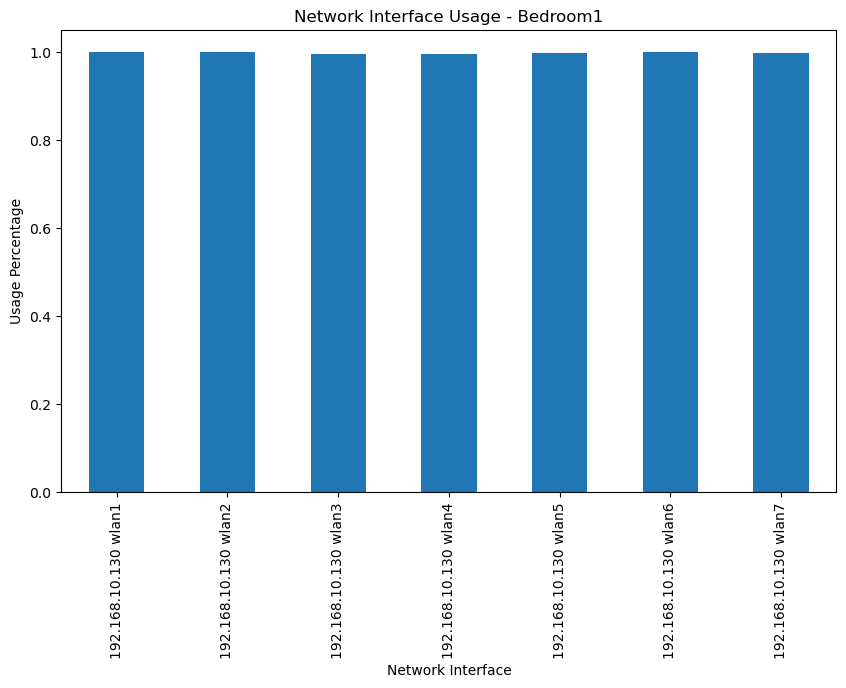

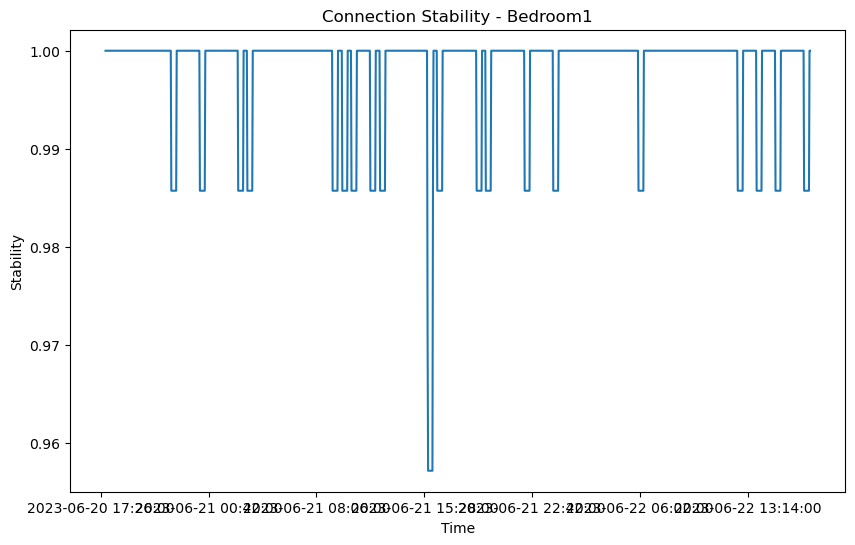

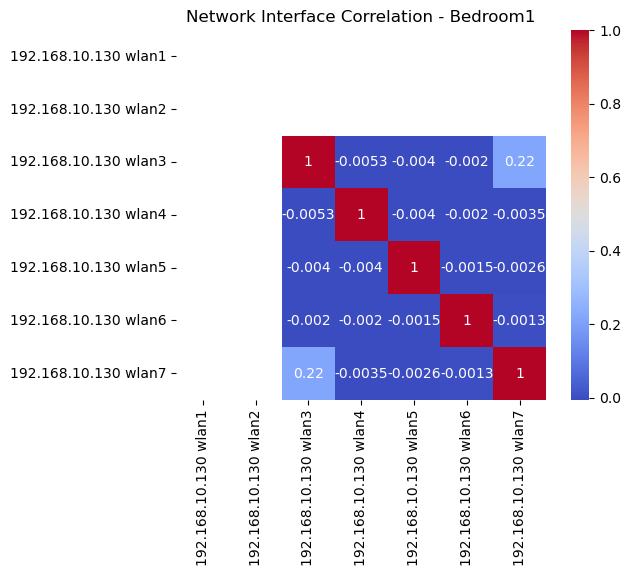

In [12]:
import matplotlib.pyplot as plt
import seaborn as sns

# Room: Bedroom1
df_bedroom1 = df_inter[['Time'] + [f'192.168.10.130 wlan{i}' for i in range(1, 8)]].set_index('Time').dropna()

# Connection Frequency
connection_count_bedroom1 = df_bedroom1.apply(pd.Series.value_counts)
connection_count_bedroom1.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.xlabel('Time')
plt.ylabel('Connection Count')
plt.title('Connection Frequency - Bedroom1')
plt.show()

# Connection Duration
connection_duration_bedroom1 = df_bedroom1.apply(lambda x: (x != '5.77 GHz').cumsum().where(x != '5.77 GHz').ffill().where(x == '5.77 GHz').value_counts())
connection_duration_bedroom1.plot(kind='hist', bins=10, figsize=(10, 6))
plt.xlabel('Connection Duration')
plt.ylabel('Frequency')
plt.title('Connection Duration Distribution - Bedroom1')
plt.show()

# Network Interface Usage
interface_usage_bedroom1 = df_bedroom1.apply(lambda x: (x == '5.77 GHz').mean())
interface_usage_bedroom1.plot(kind='bar', figsize=(10, 6))
plt.xlabel('Network Interface')
plt.ylabel('Usage Percentage')
plt.title('Network Interface Usage - Bedroom1')
plt.show()

# Connection Stability
connection_status_bedroom1 = df_bedroom1.applymap(lambda x: 1 if x == '5.77 GHz' else 0)
stability_bedroom1 = connection_status_bedroom1.rolling(window=10).mean().mean(axis=1)
stability_bedroom1.plot(figsize=(10, 6))
plt.xlabel('Time')
plt.ylabel('Stability')
plt.title('Connection Stability - Bedroom1')
plt.show()


# Correlation Analysis
correlation_matrix_bedroom1 = df_bedroom1.applymap(lambda x: 1 if x == '5.77 GHz' else 0).corr()
sns.heatmap(correlation_matrix_bedroom1, annot=True, cmap='coolwarm', square=True)
plt.title('Network Interface Correlation - Bedroom1')
plt.show()

# Repeat the above code for other rooms (Bedroom2, Recroom1, Recroom2, Gallery1, Kitchen, Gallery2)
# ...



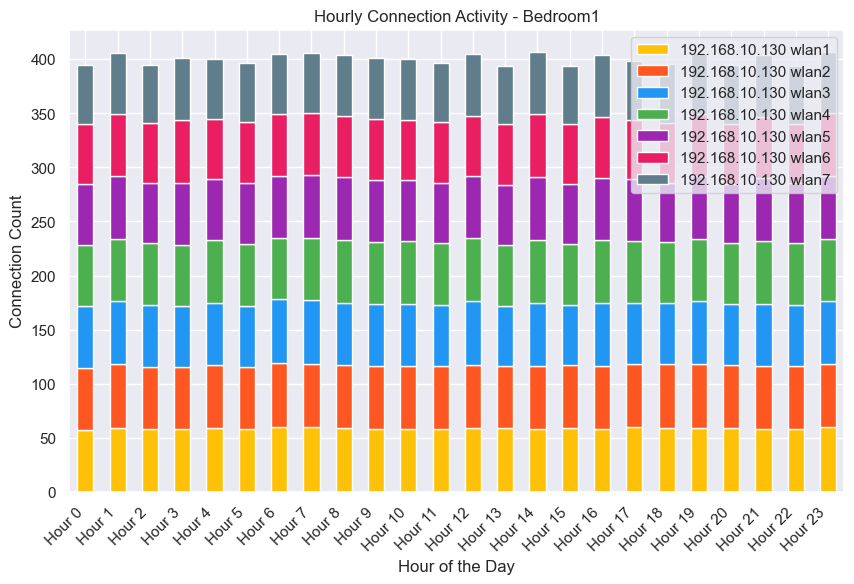

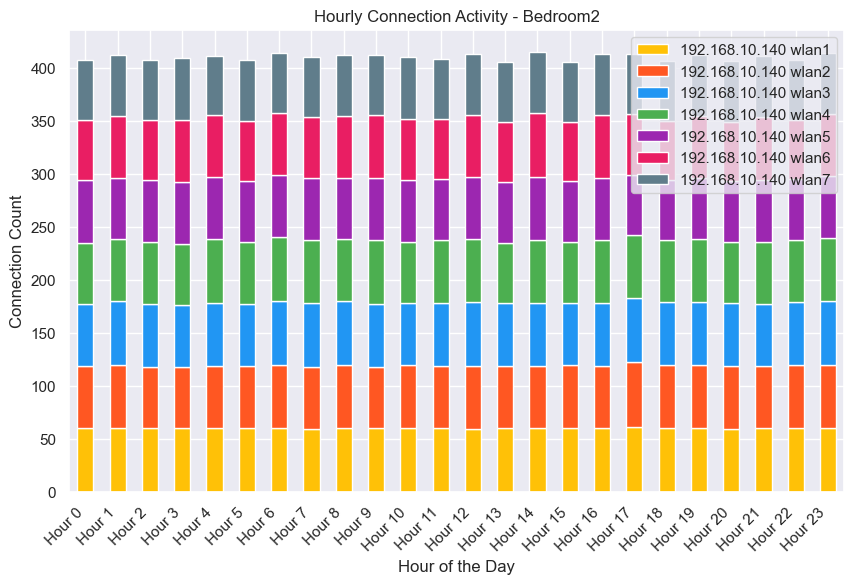

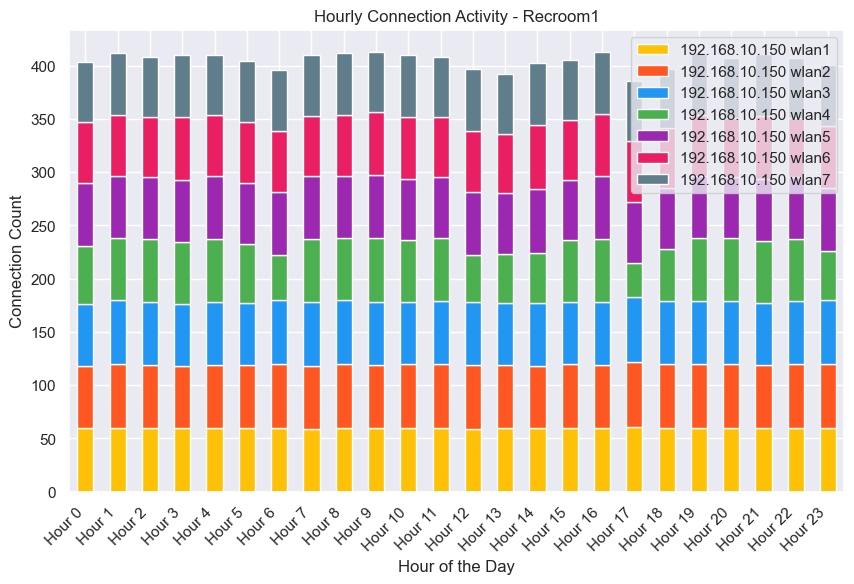

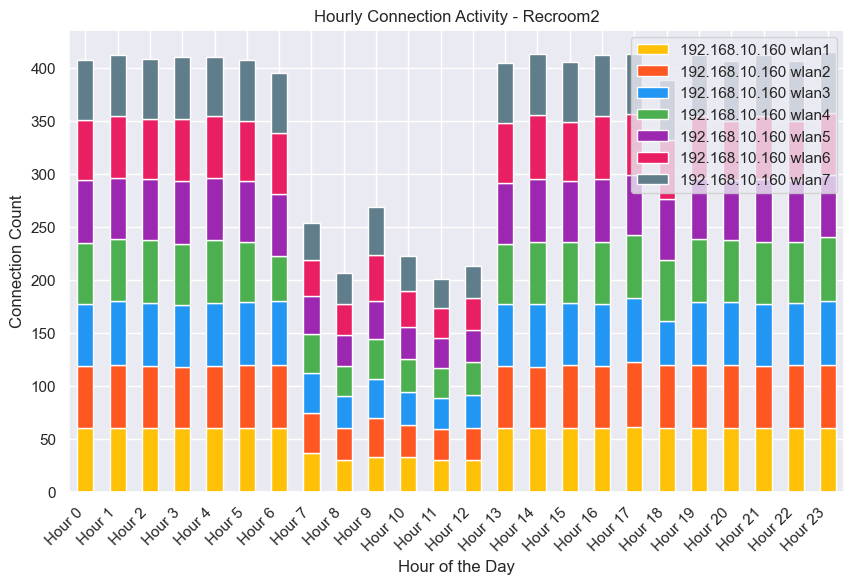

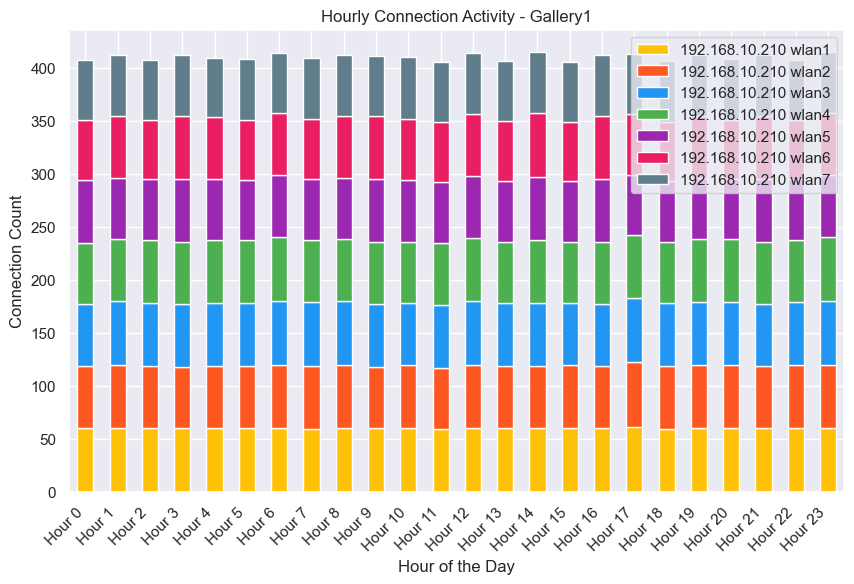

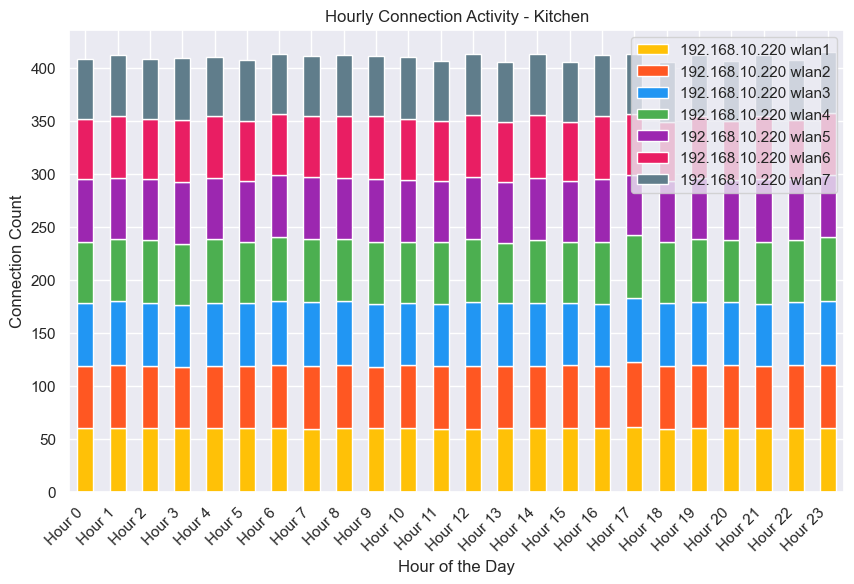

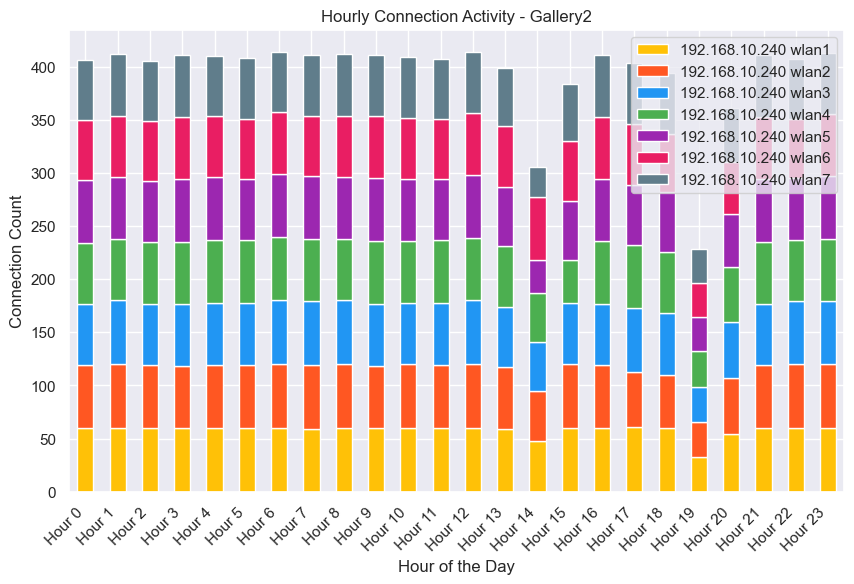

In [481]:
import matplotlib.pyplot as plt

# Function to plot stacked bar chart
def plot_stacked_bar_chart(data, title):
    wlan_labels = data.columns
    hour_labels = [f'Hour {hour}' for hour in data.index]
    colors = ['#FFC107', '#FF5722', '#2196F3', '#4CAF50', '#9C27B0', '#E91E63', '#607D8B'][:len(wlan_labels)]
    
    data.plot(kind='bar', stacked=True, figsize=(10, 6), color=colors)
    plt.xlabel('Hour of the Day')
    plt.ylabel('Connection Count')
    plt.title(title)
    plt.xticks(range(len(hour_labels)), hour_labels, rotation=45, ha='right')
    plt.legend(wlan_labels, loc='upper right')
    plt.show()

# Bedroom1
plot_stacked_bar_chart(hourly_connections_bedroom1, 'Hourly Connection Activity - Bedroom1')

# Bedroom2
plot_stacked_bar_chart(hourly_connections_bedroom2, 'Hourly Connection Activity - Bedroom2')

# Recroom1
plot_stacked_bar_chart(hourly_connections_recroom1, 'Hourly Connection Activity - Recroom1')

# Recroom2
plot_stacked_bar_chart(hourly_connections_recroom2, 'Hourly Connection Activity - Recroom2')

# Gallery1
plot_stacked_bar_chart(hourly_connections_gallery1, 'Hourly Connection Activity - Gallery1')

# Kitchen
plot_stacked_bar_chart(hourly_connections_kitchen, 'Hourly Connection Activity - Kitchen')

# Gallery2
plot_stacked_bar_chart(hourly_connections_gallery2, 'Hourly Connection Activity - Gallery2')


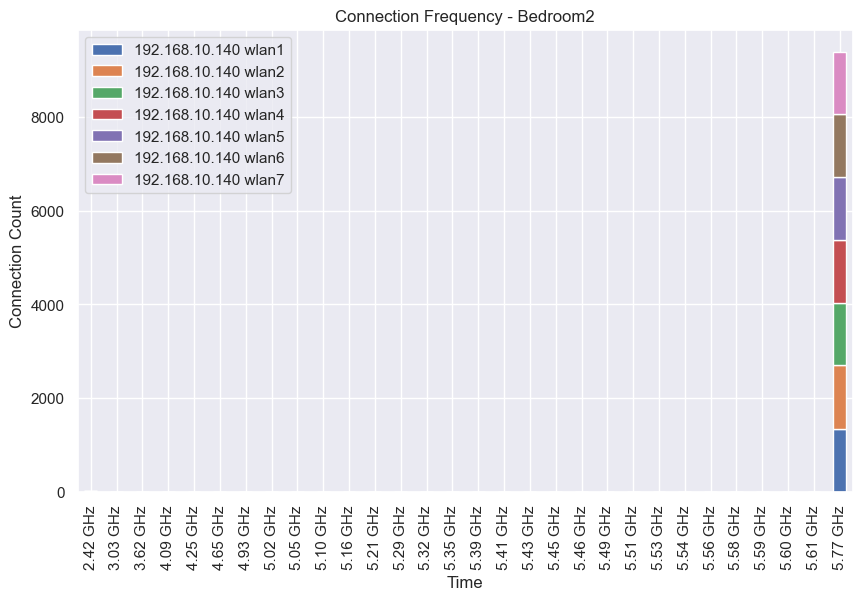

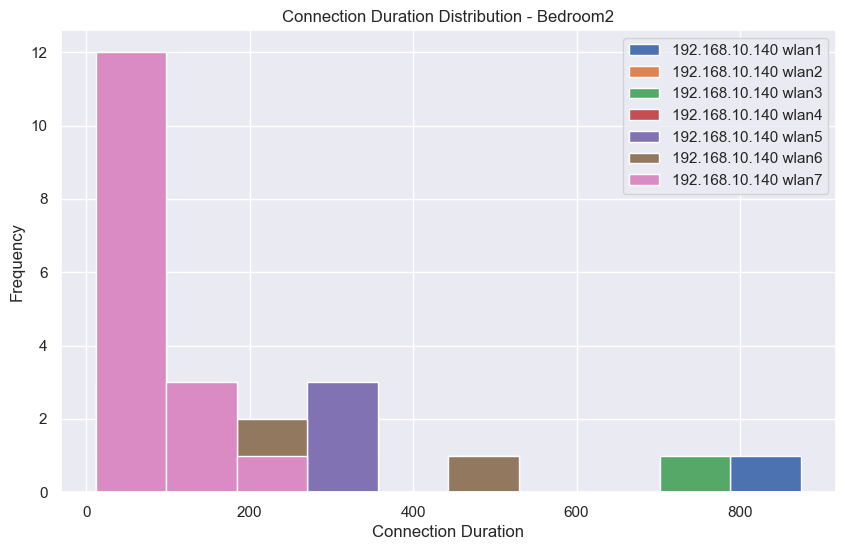

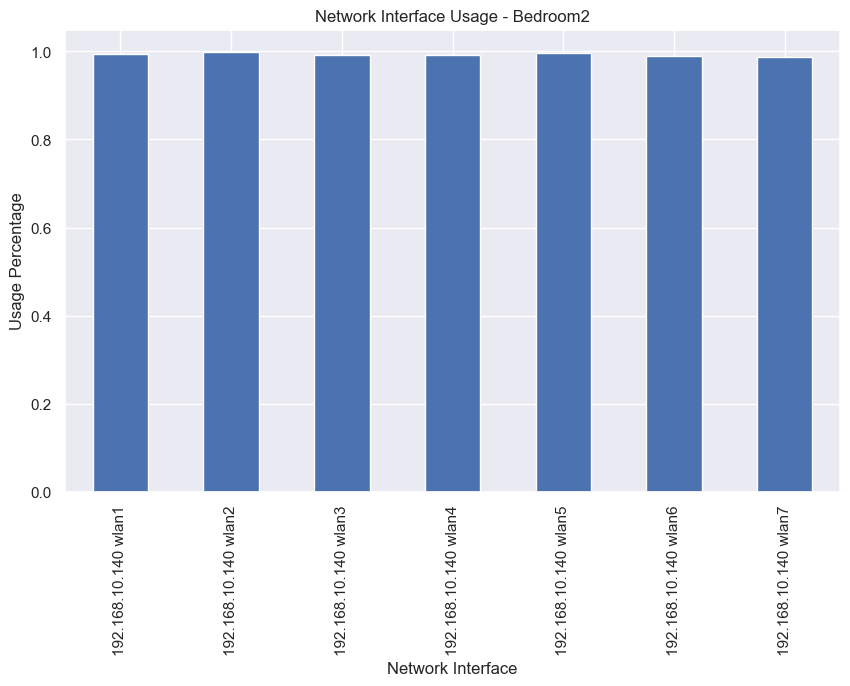

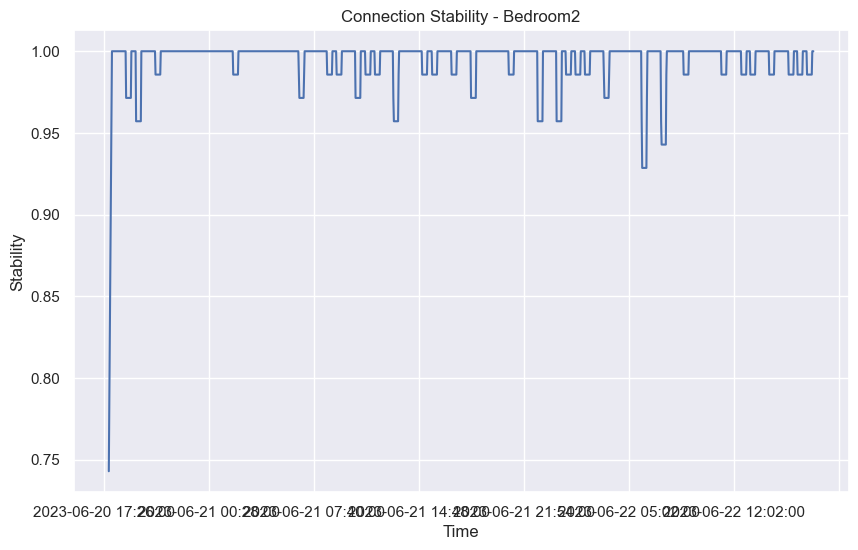

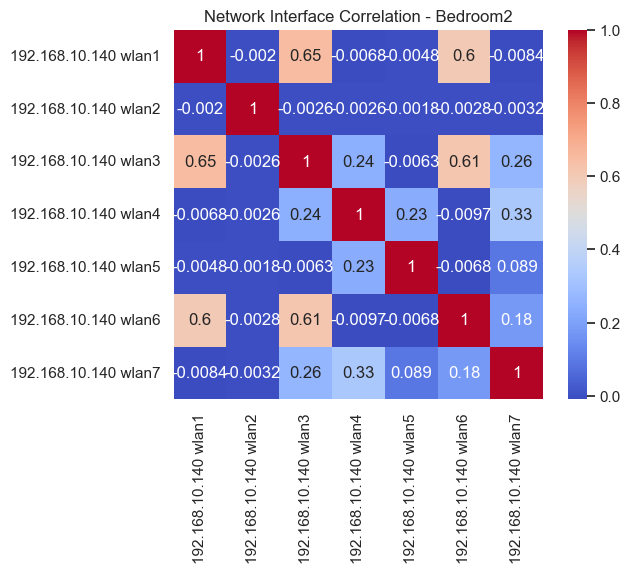

In [483]:
# Room: Bedroom2
df_bedroom2 = df_inter[['Time'] + [f'192.168.10.140 wlan{i}' for i in range(1, 8)]].set_index('Time').dropna()



import matplotlib.pyplot as plt

# Function to plot connection frequency
def plot_connection_frequency(data, title):
    filtered_data = data.loc[~data.index.isin(['connected_to', 'connected_from'])]
    filtered_data.plot(kind='bar', stacked=True, figsize=(10, 6))
    plt.xlabel('Time')
    plt.ylabel('Connection Count')
    plt.title(title)
    plt.show()

# Bedroom2
connection_count_bedroom2 = df_bedroom2.apply(pd.Series.value_counts)
plot_connection_frequency(connection_count_bedroom2, 'Connection Frequency - Bedroom2')


# Bedroom2

# Connection Duration
connection_duration_bedroom2 = df_bedroom2.apply(lambda x: (x != '5.77 GHz').cumsum().where(x != '5.77 GHz').ffill().where(x == '5.77 GHz').value_counts())
connection_duration_bedroom2.plot(kind='hist', bins=10, figsize=(10, 6))
plt.xlabel('Connection Duration')
plt.ylabel('Frequency')
plt.title('Connection Duration Distribution - Bedroom2')
plt.show()

# Network Interface Usage
interface_usage_bedroom2 = df_bedroom2.apply(lambda x: (x == '5.77 GHz').mean())
interface_usage_bedroom2.plot(kind='bar', figsize=(10, 6))
plt.xlabel('Network Interface')
plt.ylabel('Usage Percentage')
plt.title('Network Interface Usage - Bedroom2')
plt.show()

# Connection Stability
connection_status_bedroom2 = df_bedroom2.applymap(lambda x: 1 if x == '5.77 GHz' else 0)
stability_bedroom2 = connection_status_bedroom2.rolling(window=10).mean().mean(axis=1)
stability_bedroom2.plot(figsize=(10, 6))
plt.xlabel('Time')
plt.ylabel('Stability')
plt.title('Connection Stability - Bedroom2')
plt.show()

# Correlation Analysis
correlation_matrix_bedroom2 = df_bedroom2.applymap(lambda x: 1 if x == '5.77 GHz' else 0).corr()
sns.heatmap(correlation_matrix_bedroom2, annot=True, cmap='coolwarm', square=True)
plt.title('Network Interface Correlation - Bedroom2')
plt.show()


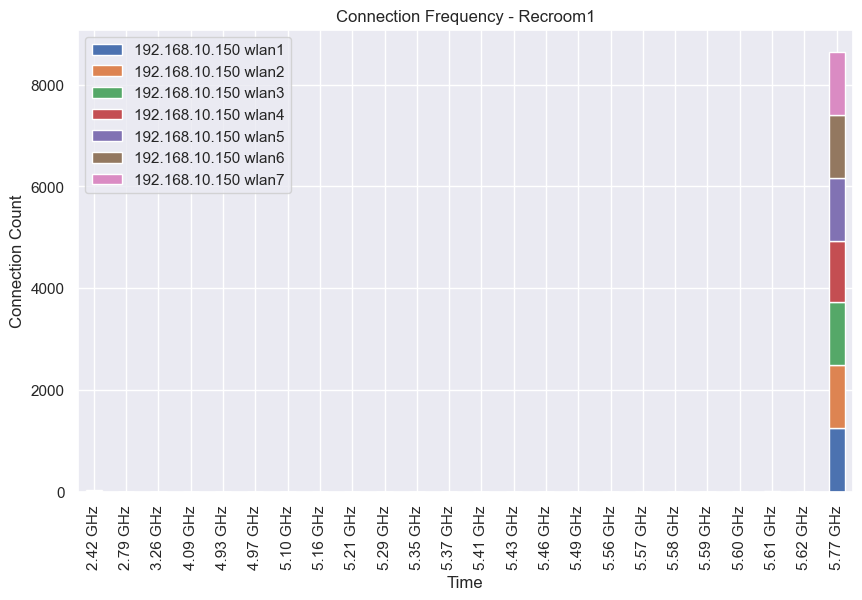

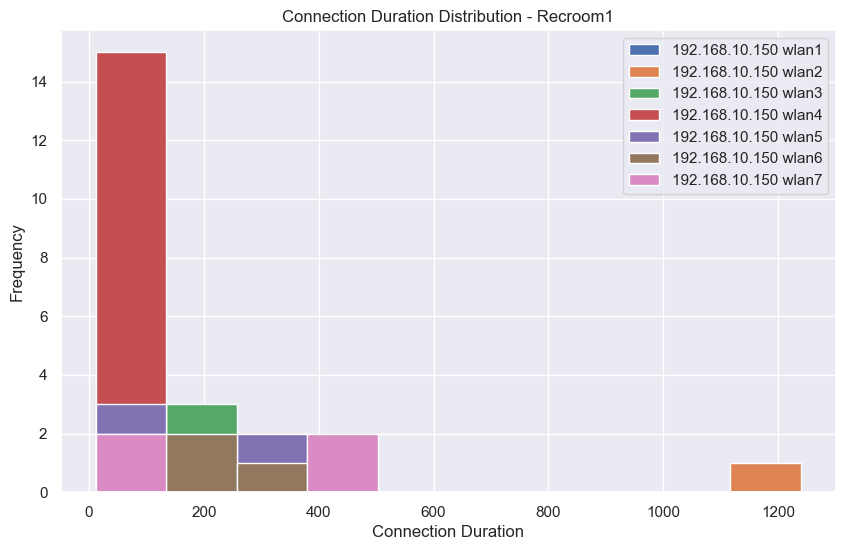

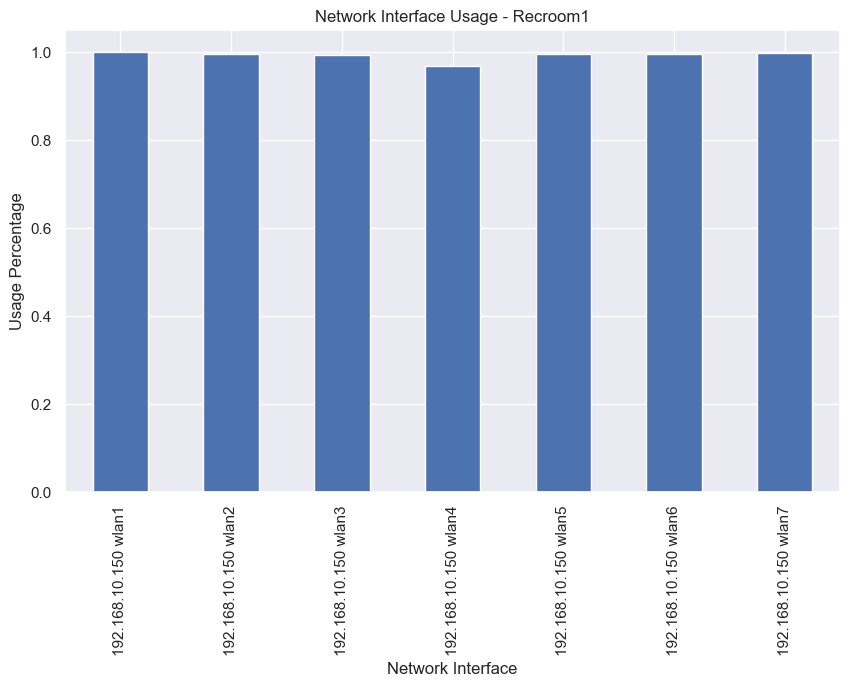

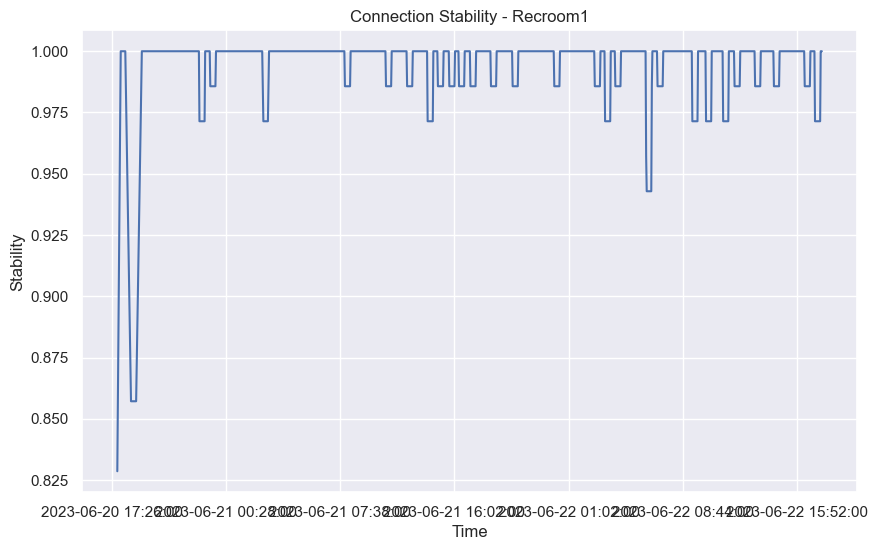

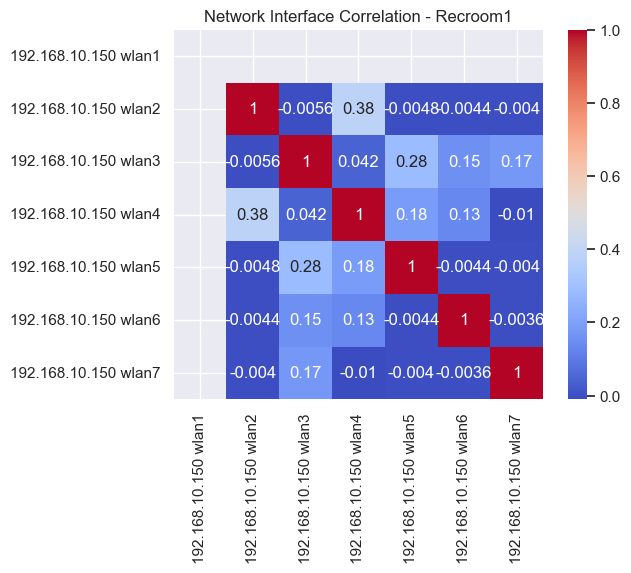

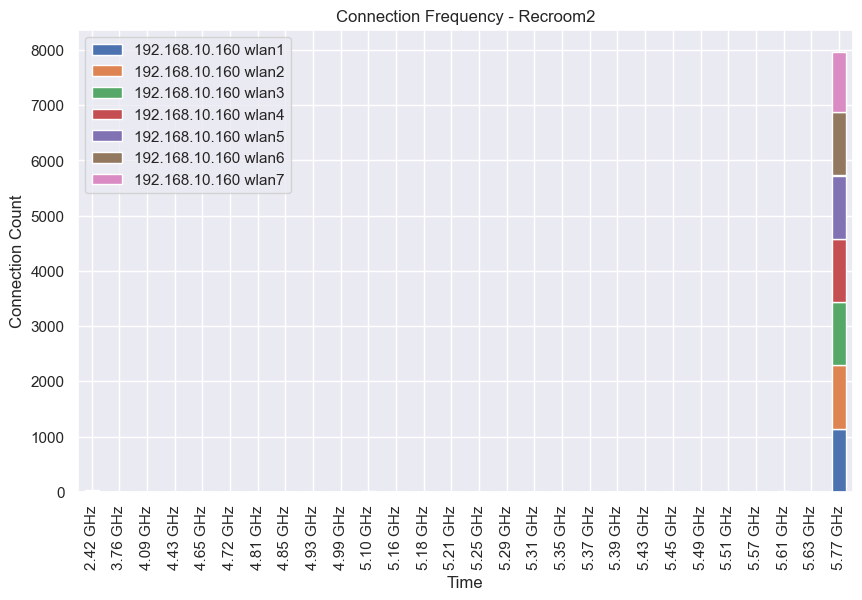

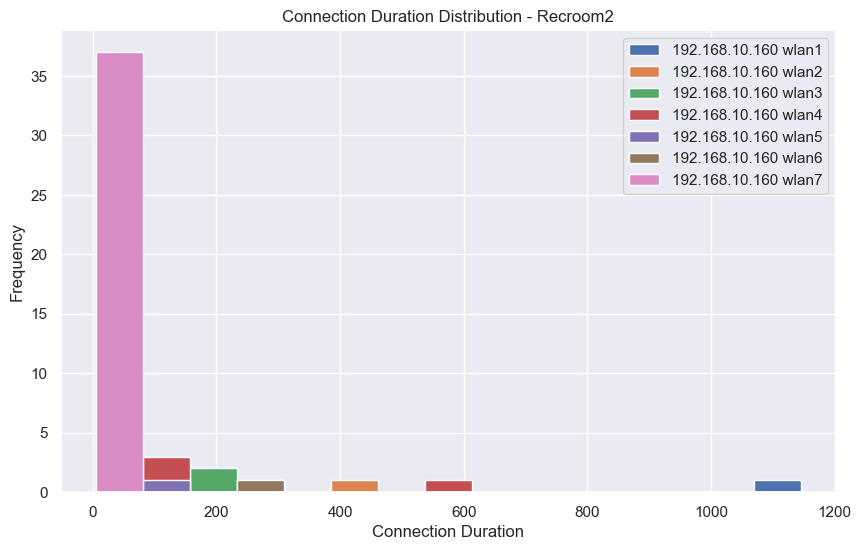

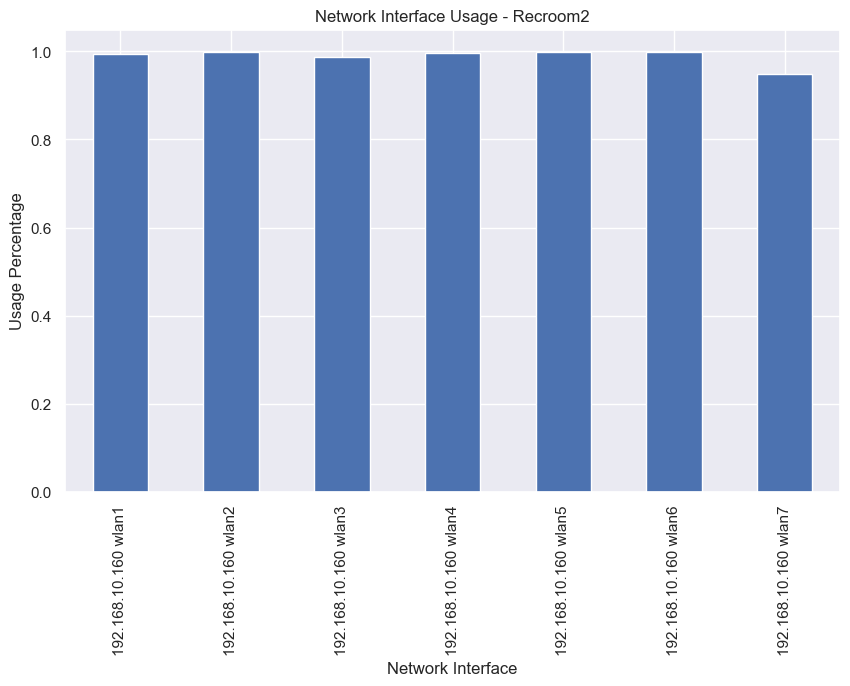

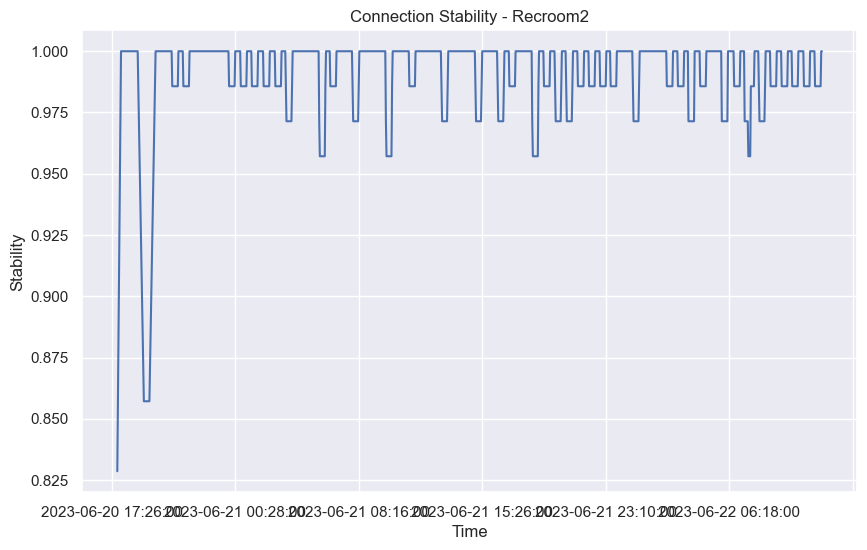

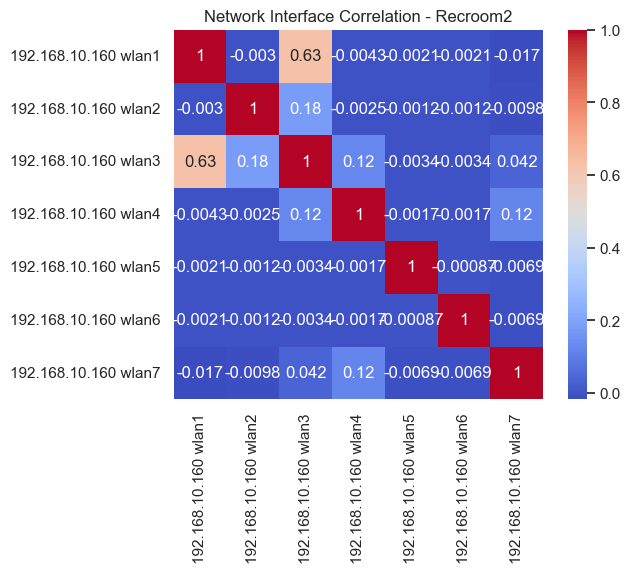

In [485]:




import matplotlib.pyplot as plt
import seaborn as sns

# Room: Recroom1
df_recroom1 = df_inter[['Time'] + [f'192.168.10.150 wlan{i}' for i in range(1, 8)]].set_index('Time').dropna()

# Connection Frequency - Recroom1
connection_count_recroom1 = df_recroom1.apply(pd.Series.value_counts)
connection_count_recroom1.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.xlabel('Time')
plt.ylabel('Connection Count')
plt.title('Connection Frequency - Recroom1')
plt.show()

# Connection Duration - Recroom1
connection_duration_recroom1 = df_recroom1.apply(lambda x: (x != '5.77 GHz').cumsum().where(x != '5.77 GHz').ffill().where(x == '5.77 GHz').value_counts())
connection_duration_recroom1.plot(kind='hist', bins=10, figsize=(10, 6))
plt.xlabel('Connection Duration')
plt.ylabel('Frequency')
plt.title('Connection Duration Distribution - Recroom1')
plt.show()

# Network Interface Usage - Recroom1
interface_usage_recroom1 = df_recroom1.apply(lambda x: (x == '5.77 GHz').mean())
interface_usage_recroom1.plot(kind='bar', figsize=(10, 6))
plt.xlabel('Network Interface')
plt.ylabel('Usage Percentage')
plt.title('Network Interface Usage - Recroom1')
plt.show()

# Connection Stability - Recroom1
connection_status_recroom1 = df_recroom1.applymap(lambda x: 1 if x == '5.77 GHz' else 0)
stability_recroom1 = connection_status_recroom1.rolling(window=10).mean().mean(axis=1)
stability_recroom1.plot(figsize=(10, 6))
plt.xlabel('Time')
plt.ylabel('Stability')
plt.title('Connection Stability - Recroom1')
plt.show()

# Correlation Analysis - Recroom1
correlation_matrix_recroom1 = df_recroom1.applymap(lambda x: 1 if x == '5.77 GHz' else 0).corr()
sns.heatmap(correlation_matrix_recroom1, annot=True, cmap='coolwarm', square=True)
plt.title('Network Interface Correlation - Recroom1')
plt.show()

# Room: Recroom2
df_recroom2 = df_inter[['Time'] + [f'192.168.10.160 wlan{i}' for i in range(1, 8)]].set_index('Time').dropna()

# Connection Frequency - Recroom2
connection_count_recroom2 = df_recroom2.apply(pd.Series.value_counts)
connection_count_recroom2.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.xlabel('Time')
plt.ylabel('Connection Count')
plt.title('Connection Frequency - Recroom2')
plt.show()

# Connection Duration - Recroom2
connection_duration_recroom2 = df_recroom2.apply(lambda x: (x != '5.77 GHz').cumsum().where(x != '5.77 GHz').ffill().where(x == '5.77 GHz').value_counts())
connection_duration_recroom2.plot(kind='hist', bins=15, figsize=(10, 6))
plt.xlabel('Connection Duration')
plt.ylabel('Frequency')
plt.title('Connection Duration Distribution - Recroom2')
plt.show()

# Network Interface Usage - Recroom2
interface_usage_recroom2 = df_recroom2.apply(lambda x: (x == '5.77 GHz').mean())
interface_usage_recroom2.plot(kind='bar', figsize=(10, 6))
plt.xlabel('Network Interface')
plt.ylabel('Usage Percentage')
plt.title('Network Interface Usage - Recroom2')
plt.show()

# Function to plot connection stability
def plot_connection_stability(data, title):
    data.plot(figsize=(10, 6))
    plt.xlabel('Time')
    plt.ylabel('Stability')
    plt.title(title)
    plt.xticks(rotation=0)  # Rotate x-axis labels to avoid overlapping
    plt.show()

# Connection Stability - Recroom2
connection_status_recroom2 = df_recroom2.applymap(lambda x: 1 if x == '5.77 GHz' else 0)
stability_recroom2 = connection_status_recroom2.rolling(window=10).mean().mean(axis=1)
plot_connection_stability(stability_recroom2, 'Connection Stability - Recroom2')
# Correlation Analysis - Recroom2
correlation_matrix_recroom2 = df_recroom2.applymap(lambda x: 1 if x == '5.77 GHz' else 0).corr()
sns.heatmap(correlation_matrix_recroom2, annot=True, cmap='coolwarm', square=True)
plt.title('Network Interface Correlation - Recroom2')
plt.show()

# Repeat the above code for other rooms: Gallery1, Kitchen, Gallery2


In [456]:
df_temp.dropna()

,Time,Location conn_gps Zone 21,Location cpu_little0 Zone 1,Location cpu_little1 Zone 2,Location cpu_little2 Zone 3,Location cpu_little3 Zone 4,Location dramc Zone 7,Location gpu0 Zone 5,Location gpu1 Zone 6,Location ltepa_ntc Zone 14,...,Location nrpa_ntc Zone 13,Location pmic Zone 16,Location pmic_vcore Zone 17,Location pmic_vgpu Zone 19,Location pmic_vproc Zone 18,Location rf_ntc Zone 15,Location soc_dram_ntc Zone 12,Location soc_max Zone 0,5GHz Thermal Temp,2.4GHz Thermal Temp
2,2023-06-20 17:32:00,52.0,62.4,62.8,62.6,62.6,61.7,61.9,62.4,57.5,...,56.8,60.8,57.8,56.7,57.8,56.5,57.2,62.7,76.0,70.0
4,2023-06-20 17:34:00,52.0,62.9,63.4,63.1,62.7,62.4,63.2,63.6,58.0,...,57.5,61.4,58.9,57.2,58.9,57.1,57.8,63.6,76.0,70.0
6,2023-06-20 17:36:00,54.0,63.0,62.9,63.2,62.7,61.8,62.5,62.9,57.1,...,56.7,61.4,58.9,57.2,58.9,56.6,57.3,63.1,59.0,64.0
8,2023-06-20 17:38:00,50.0,61.2,62.1,62.0,61.4,60.4,60.6,61.1,55.4,...,55.1,59.6,56.7,55.6,56.7,55.1,55.7,61.4,57.0,63.0
10,2023-06-20 17:40:00,50.0,62.4,62.6,62.6,62.3,60.3,60.1,60.4,53.9,...,53.5,58.4,55.6,54.0,55.6,53.6,54.2,62.6,57.0,61.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2872,2023-06-22 17:22:00,54.0,64.2,64.2,64.3,64.3,62.4,62.7,63.2,57.2,...,56.7,61.4,58.9,57.2,58.9,56.7,57.3,64.3,70.0,64.0
2874,2023-06-22 17:24:00,54.0,65.7,65.3,65.8,66.2,63.3,63.3,63.7,57.6,...,57.1,62.0,59.4,57.8,59.4,57.1,57.7,66.2,72.0,66.0
2876,2023-06-22 17:26:00,54.0,62.8,63.8,63.9,63.7,62.7,63.4,64.1,57.7,...,57.2,62.6,59.4,57.8,59.4,57.2,57.7,63.7,70.0,66.0
2878,2023-06-22 17:28:00,54.0,63.8,64.0,63.8,63.9,62.9,63.4,63.7,57.7,...,57.3,62.6,59.4,58.3,59.4,57.3,57.9,64.0,70.0,66.0


In [457]:
df_temp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2882 entries, 0 to 2881
Data columns (total 25 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   Time                                2882 non-null   object 
 1   Location conn_gps      Zone 21      1441 non-null   float64
 2   Location cpu_little0      Zone 1    1441 non-null   float64
 3   Location cpu_little1      Zone 2    1441 non-null   float64
 4   Location cpu_little2      Zone 3    1441 non-null   float64
 5   Location cpu_little3      Zone 4    1441 non-null   float64
 6   Location dramc      Zone 7          1441 non-null   float64
 7   Location gpu0      Zone 5           1441 non-null   float64
 8   Location gpu1      Zone 6           1441 non-null   float64
 9   Location ltepa_ntc      Zone 14     1441 non-null   float64
 10  Location md_3g      Zone 11         1441 non-null   float64
 11  Location md_4g      Zone 10         1441 no

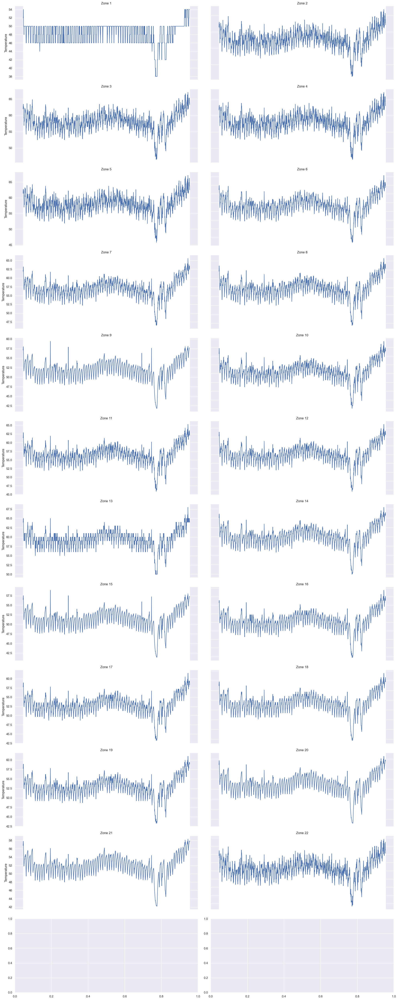

In [458]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style="darkgrid")

fig, axes = plt.subplots(nrows=12, ncols=2, figsize=(20, 50))

# Flatten the axes array so it's easier to iterate over
axes = axes.flatten()

# Drop the last two columns which are not zones
zone_columns = df_temp.columns[1:-2]

for i, column in enumerate(zone_columns):
    ax = axes[i]
    sns.lineplot(data=df_temp, x='Time', y=column, ax=ax)
    ax.set_title(f'Zone {i+1}')
    ax.set_xlabel('Time')
    ax.set_ylabel('Temperature')
    ax.label_outer() # Hide x labels and tick labels for inner plots.

plt.tight_layout()
plt.show()


In [459]:
!pip install plotly

In [462]:
df_temp.dropna()

,Time,Location conn_gps Zone 21,Location cpu_little0 Zone 1,Location cpu_little1 Zone 2,Location cpu_little2 Zone 3,Location cpu_little3 Zone 4,Location dramc Zone 7,Location gpu0 Zone 5,Location gpu1 Zone 6,Location ltepa_ntc Zone 14,...,Location nrpa_ntc Zone 13,Location pmic Zone 16,Location pmic_vcore Zone 17,Location pmic_vgpu Zone 19,Location pmic_vproc Zone 18,Location rf_ntc Zone 15,Location soc_dram_ntc Zone 12,Location soc_max Zone 0,5GHz Thermal Temp,2.4GHz Thermal Temp
2,2023-06-20 17:32:00,52.0,62.4,62.8,62.6,62.6,61.7,61.9,62.4,57.5,...,56.8,60.8,57.8,56.7,57.8,56.5,57.2,62.7,76.0,70.0
4,2023-06-20 17:34:00,52.0,62.9,63.4,63.1,62.7,62.4,63.2,63.6,58.0,...,57.5,61.4,58.9,57.2,58.9,57.1,57.8,63.6,76.0,70.0
6,2023-06-20 17:36:00,54.0,63.0,62.9,63.2,62.7,61.8,62.5,62.9,57.1,...,56.7,61.4,58.9,57.2,58.9,56.6,57.3,63.1,59.0,64.0
8,2023-06-20 17:38:00,50.0,61.2,62.1,62.0,61.4,60.4,60.6,61.1,55.4,...,55.1,59.6,56.7,55.6,56.7,55.1,55.7,61.4,57.0,63.0
10,2023-06-20 17:40:00,50.0,62.4,62.6,62.6,62.3,60.3,60.1,60.4,53.9,...,53.5,58.4,55.6,54.0,55.6,53.6,54.2,62.6,57.0,61.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2872,2023-06-22 17:22:00,54.0,64.2,64.2,64.3,64.3,62.4,62.7,63.2,57.2,...,56.7,61.4,58.9,57.2,58.9,56.7,57.3,64.3,70.0,64.0
2874,2023-06-22 17:24:00,54.0,65.7,65.3,65.8,66.2,63.3,63.3,63.7,57.6,...,57.1,62.0,59.4,57.8,59.4,57.1,57.7,66.2,72.0,66.0
2876,2023-06-22 17:26:00,54.0,62.8,63.8,63.9,63.7,62.7,63.4,64.1,57.7,...,57.2,62.6,59.4,57.8,59.4,57.2,57.7,63.7,70.0,66.0
2878,2023-06-22 17:28:00,54.0,63.8,64.0,63.8,63.9,62.9,63.4,63.7,57.7,...,57.3,62.6,59.4,58.3,59.4,57.3,57.9,64.0,70.0,66.0


In [ ]:
for column in location_columns:
    # Convert the temperature column to numeric format
    df_temp[column] = pd.to_numeric(df_temp[column], errors='coerce')

    if column in df_temp.columns:
        plt.figure(figsize=(15, 6))
        plt.plot(df_temp.index, df_temp[column])
        plt.title(f'Time Series Plot for {column}')
        plt.xlabel('Time')
        plt.ylabel('Temperature')
        plt.xticks([])  # Hide x-axis labels
        plt.show()
    else:
        continue




In [ ]:
df_temp

In [23]:
# Ensure 'Time' is in datetime format
df_temp.index = pd.to_datetime(df_temp.index)


In [24]:
from sklearn.metrics import mean_squared_error
from math import sqrt

# Assuming df_filtered is your DataFrame

# Drop rows with missing values in the relevant columns
df_temp = df_temp.dropna(subset=["5GHz Thermal Temp", "2.4GHz Thermal Temp"])

# Calculate RMSE
rmse = sqrt(mean_squared_error(df_temp["5GHz Thermal Temp"], df_temp["2.4GHz Thermal Temp"]))

print(f"The RMSE is: {rmse}")


The RMSE is: 5.052552700231346


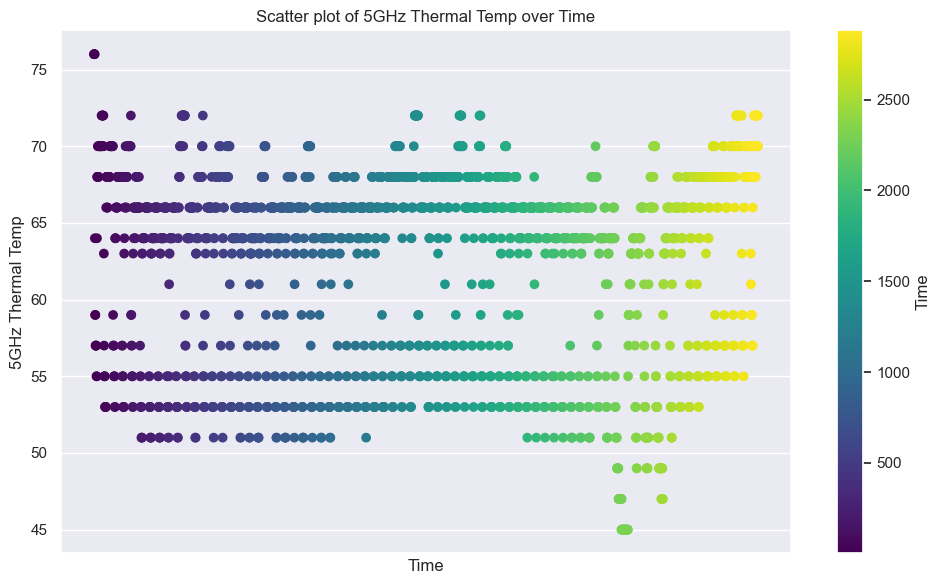

In [443]:
import matplotlib.pyplot as plt

# Convert the timestamps to datetime objects
timestamps = pd.to_datetime(df_temp.index)

plt.figure(figsize=(10, 6))

plt.scatter(range(len(timestamps)), df_temp["5GHz Thermal Temp"], c=timestamps, cmap='viridis')
plt.colorbar(label='Time')
plt.xticks([])  # Hide the tick labels on the x-axis
plt.xlabel("Time")
plt.ylabel('5GHz Thermal Temp')
plt.title('Scatter plot of 5GHz Thermal Temp over Time')

plt.tight_layout()
plt.show()


In [27]:
df_traffic = df_traffic.loc[:, (df_traffic != 0).any(axis=0)]


In [28]:
df_traffic.reset_index(inplace=True)


In [29]:
df_traffic['Time'] = pd.to_datetime(df_traffic['Time'])  # if 'Time' is not already in datetime format
df_traffic.set_index('Time', inplace=True)


In [30]:
df_traffic.describe()

,index,brlan0 - Receive,ccmni0 - Receive,cni0 - Receive,eth1 - Receive,eth_lan1 - Receive,eth_lan2 - Receive,lo - Receive,ra0 - Receive,rai0 - Receive,...,ra0 - Transmit,rai0 - Transmit,veth297478ae - Transmit,veth56438467 - Transmit,veth680f0a39 - Transmit,veth8fcf06f1 - Transmit,vetha1dcb680 - Transmit,vethb848bf5d - Transmit,vethbd5aced0 - Transmit,xlat - Transmit
count,721.00000,7.210000e+02,7.210000e+02,721.000000,7.210000e+02,721.000000,7.210000e+02,721.000000,721.000000,7.210000e+02,...,7.210000e+02,7.210000e+02,721.000000,721.000000,721.000000,721.000000,721.000000,721.000000,7.210000e+02,7.210000e+02
mean,360.00000,1.233211e+04,1.140410e+05,3285.983356,1.055210e+08,6.987517,1.562150e+05,32.152566,59.816366,3.230749e+04,...,9.126903e+05,1.042774e+08,228.804438,180826.678225,510.495423,1.396949,27.261026,1.396949,1.289844e+04,1.000356e+04
std,208.27906,1.120613e+05,1.561388e+06,782.043635,6.381104e+07,176.059992,2.206014e+05,305.418914,431.654484,1.200152e+05,...,4.984002e+06,6.318938e+07,790.494355,19649.179657,5306.918396,9.629152,398.128071,9.629152,1.343313e+05,1.161351e+05
min,0.00000,6.680000e+02,0.000000e+00,3049.000000,7.930000e+02,0.000000,6.680000e+02,0.000000,0.000000,0.000000e+00,...,0.000000e+00,0.000000e+00,35.200000,152499.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00
25%,180.00000,1.361000e+03,3.840000e+01,3104.000000,5.325024e+07,0.000000,6.866200e+04,0.000000,0.000000,9.015000e+03,...,0.000000e+00,5.070133e+07,92.800000,163427.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,6.610000e+01
50%,360.00000,1.765000e+03,8.960000e+01,3148.000000,1.407815e+08,0.000000,1.177570e+05,0.000000,0.000000,1.252900e+04,...,0.000000e+00,1.386378e+08,142.000000,192003.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,6.610000e+01
75%,540.00000,5.438000e+03,1.960000e+02,3324.000000,1.477449e+08,0.000000,1.601320e+05,0.000000,0.000000,2.524200e+04,...,0.000000e+00,1.471718e+08,187.000000,192039.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,2.310000e+02
max,720.00000,2.517060e+06,4.008976e+07,13293.000000,1.949373e+08,4717.000000,1.848903e+06,6133.000000,8517.000000,2.626839e+06,...,5.210834e+07,1.983460e+08,10300.000000,205790.000000,64288.000000,149.000000,6381.000000,149.000000,1.895154e+06,2.583893e+06


In [31]:
# Convert all columns in DataFrame from bytes to gigabytes
df_traffic = df_traffic.apply(lambda x: x / (1024*3))


In [32]:
df_traffic.describe()

,index,brlan0 - Receive,ccmni0 - Receive,cni0 - Receive,eth1 - Receive,eth_lan1 - Receive,eth_lan2 - Receive,lo - Receive,ra0 - Receive,rai0 - Receive,...,ra0 - Transmit,rai0 - Transmit,veth297478ae - Transmit,veth56438467 - Transmit,veth680f0a39 - Transmit,veth8fcf06f1 - Transmit,vetha1dcb680 - Transmit,vethb848bf5d - Transmit,vethbd5aced0 - Transmit,xlat - Transmit
count,721.000000,721.000000,721.000000,721.000000,721.000000,721.000000,721.000000,721.000000,721.000000,721.000000,...,721.000000,721.000000,721.000000,721.000000,721.000000,721.000000,721.000000,721.000000,721.000000,721.000000
mean,0.117188,4.014358,37.122716,1.069656,34349.285906,0.002275,50.851229,0.010466,0.019471,10.516760,...,297.099721,33944.468358,0.074481,58.862851,0.166177,0.000455,0.008874,0.000455,4.198711,3.256368
std,0.067799,36.478272,508.264198,0.254571,20771.822507,0.057311,71.810348,0.099420,0.140513,39.067443,...,1622.396578,20569.458257,0.257322,6.396217,1.727512,0.003134,0.129599,0.003134,43.727631,37.804383
min,0.000000,0.217448,0.000000,0.992513,0.258138,0.000000,0.217448,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.011458,49.641602,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.058594,0.443034,0.012500,1.010417,17334.063151,0.000000,22.350911,0.000000,0.000000,2.934570,...,0.000000,16504.340169,0.030208,53.198893,0.000000,0.000000,0.000000,0.000000,0.000000,0.021517
50%,0.117188,0.574544,0.029167,1.024740,45827.326823,0.000000,38.332357,0.000000,0.000000,4.078451,...,0.000000,45129.476888,0.046224,62.500977,0.000000,0.000000,0.000000,0.000000,0.000000,0.021517
75%,0.175781,1.770182,0.063802,1.082031,48094.048503,0.000000,52.126302,0.000000,0.000000,8.216797,...,0.000000,47907.501302,0.060872,62.512695,0.000000,0.000000,0.000000,0.000000,0.000000,0.075195
max,0.234375,819.355469,13050.052083,4.327148,63456.145833,1.535482,601.856445,1.996419,2.772461,855.090820,...,16962.349935,64565.743815,3.352865,66.988932,20.927083,0.048503,2.077148,0.048503,616.912109,841.111003


In [33]:
df_traffic.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 721 entries, 2023-06-20 17:32:00 to 2023-06-22 17:32:00
Data columns (total 35 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   index                    721 non-null    float64
 1   brlan0 - Receive         721 non-null    float64
 2   ccmni0 - Receive         721 non-null    float64
 3   cni0 - Receive           721 non-null    float64
 4   eth1 - Receive           721 non-null    float64
 5   eth_lan1 - Receive       721 non-null    float64
 6   eth_lan2 - Receive       721 non-null    float64
 7   lo - Receive             721 non-null    float64
 8   ra0 - Receive            721 non-null    float64
 9   rai0 - Receive           721 non-null    float64
 10  veth297478ae - Receive   721 non-null    float64
 11  veth56438467 - Receive   721 non-null    float64
 12  veth680f0a39 - Receive   721 non-null    float64
 13  veth8fcf06f1 - Receive   721 non-null    fl

In [34]:
# Select only the columns we're interested in
df_subset = df_traffic[['brlan0 - Receive', 'ccmni0 - Receive', 'cni0 - Receive', 'eth1 - Receive', 'eth_lan1 - Receive', 'eth_lan2 - Receive', 'lo - Receive', 'ra0 - Receive', 'rai0 - Receive', 'veth297478ae - Receive', 'veth56438467 - Receive', 'veth680f0a39 - Receive', 'veth8fcf06f1 - Receive', 'vetha1dcb680 - Receive', 'vethb848bf5d - Receive', 'vethbd5aced0 - Receive', 'xlat - Receive']]

# Compute the correlation matrix
corr_matrix = df_subset.corr()

# Print the correlation matrix
print(corr_matrix)


                        brlan0 - Receive  ccmni0 - Receive  cni0 - Receive  \
brlan0 - Receive                1.000000          0.085351       -0.015569   
ccmni0 - Receive                0.085351          1.000000        0.254187   
cni0 - Receive                 -0.015569          0.254187        1.000000   
eth1 - Receive                 -0.057886          0.007621       -0.000623   
eth_lan1 - Receive              0.002379         -0.001320       -0.009106   
eth_lan2 - Receive             -0.000256         -0.009570       -0.013674   
lo - Receive                   -0.005954         -0.007515       -0.000587   
ra0 - Receive                  -0.006378         -0.008951       -0.016276   
rai0 - Receive                  0.969012          0.078149       -0.015204   
veth297478ae - Receive         -0.009805          0.396114        0.954401   
veth56438467 - Receive         -0.024423         -0.004949        0.278419   
veth680f0a39 - Receive         -0.008737          0.128401      

rlan0 - Receive and rai0 - Receive (0.969012)

brlan0 - Receive and xlat - Receive (0.999299)

cni0 - Receive and veth297478ae - Receive (0.954401)

cni0 - Receive and veth680f0a39 - Receive (0.913709)

cni0 - Receive and vethbd5aced0 - Receive (0.924129)

veth680f0a39 - Receive and vethbd5aced0 - Receive (0.994531)

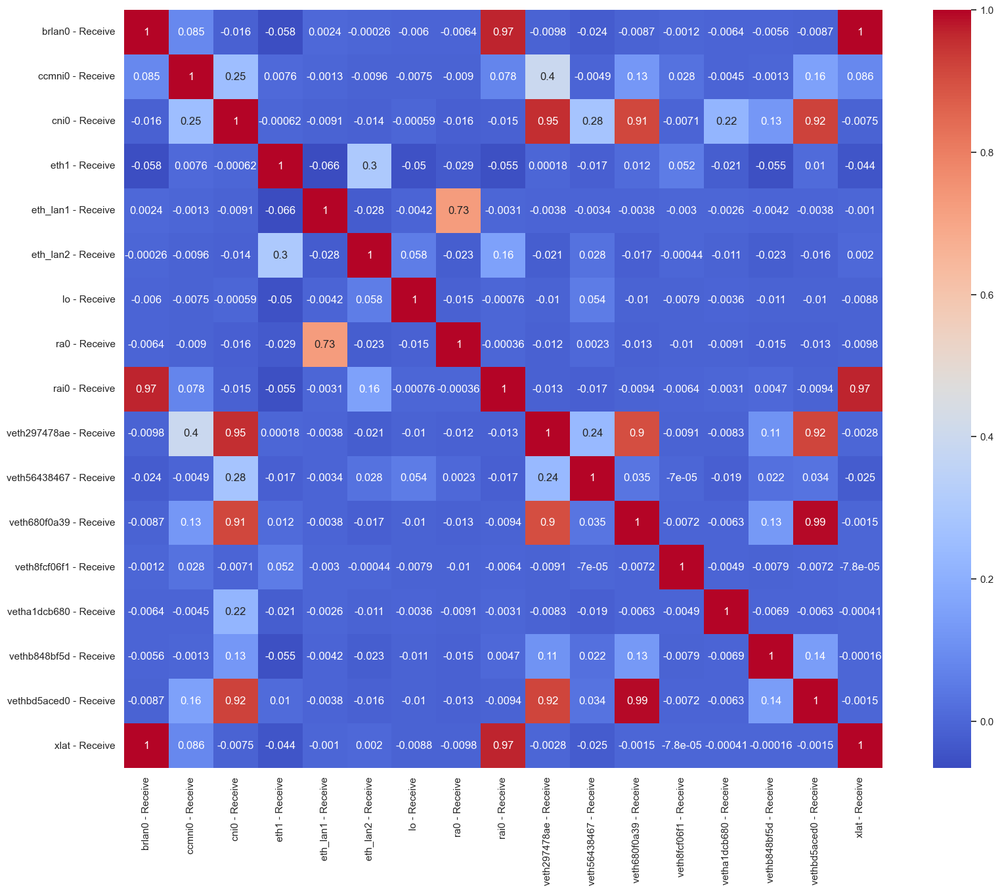

In [35]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(20, 15))
sns.heatmap(corr_matrix, annot=True, square=True, cmap='coolwarm', annot_kws={'size': 12})
plt.show()


In [36]:
from sklearn.preprocessing import MinMaxScaler

# create a scaler object
scaler = MinMaxScaler()

# fit and transform the data
df_traffic[['ra0 - Transmit', 'ra0 - Receive']] = scaler.fit_transform(df_traffic[['ra0 - Transmit', 'ra0 - Receive']])


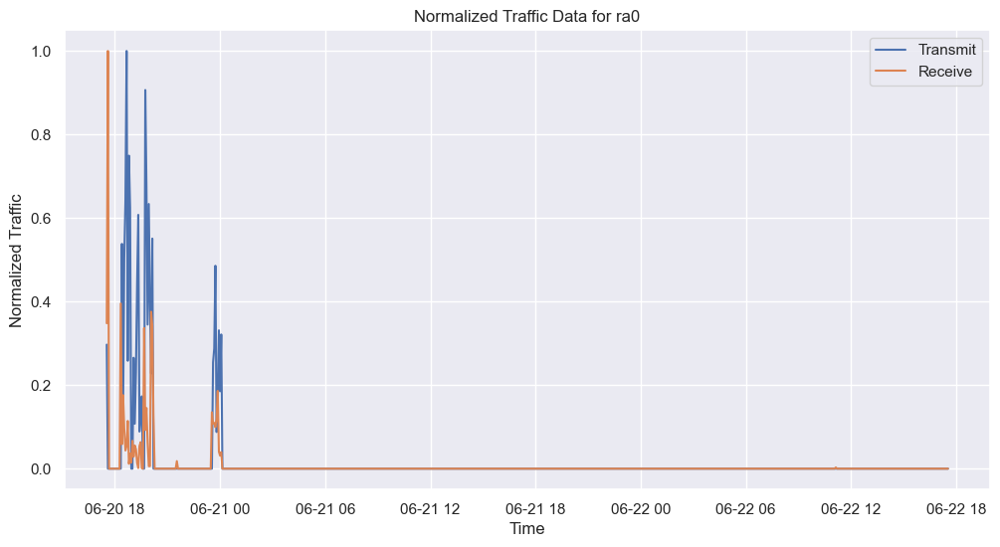

In [37]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12,6))
plt.plot(df_traffic['ra0 - Transmit'], label='Transmit')
plt.plot(df_traffic['ra0 - Receive'], label='Receive')
plt.title('Normalized Traffic Data for ra0')
plt.xlabel('Time')
plt.ylabel('Normalized Traffic')
plt.legend()
plt.show()


In [38]:
correlation = df_traffic[['ra0 - Transmit', 'ra0 - Receive']].corr()
print(correlation)


                ra0 - Transmit  ra0 - Receive
ra0 - Transmit        1.000000       0.277088
ra0 - Receive         0.277088       1.000000


In [39]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn import metrics

# define the data/predictors and the target
X = df_traffic['ra0 - Transmit'].values.reshape(-1,1)
y = df_traffic['ra0 - Receive'].values.reshape(-1,1)

# splitting the data into training and testing data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# create a Linear Regression model object
regressor = LinearRegression()

# train the model using the training sets
regressor.fit(X_train, y_train)

# making predictions using the testing set
y_pred = regressor.predict(X_test)

# comparing actual response values (y_test) with predicted response values (y_pred)
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))


Mean Absolute Error: 0.013427718335332314
Mean Squared Error: 0.007243970029869731
Root Mean Squared Error: 0.08511151526009704


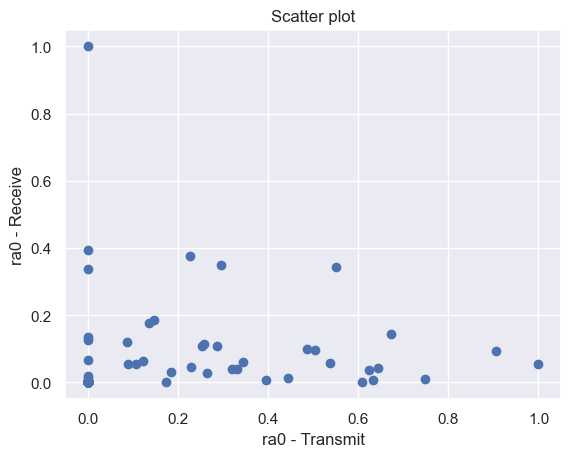

<Axes: >

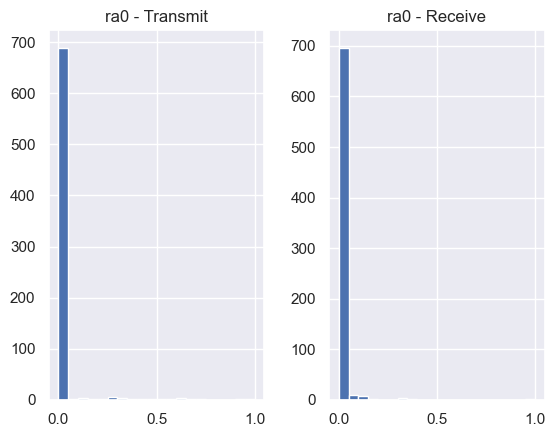

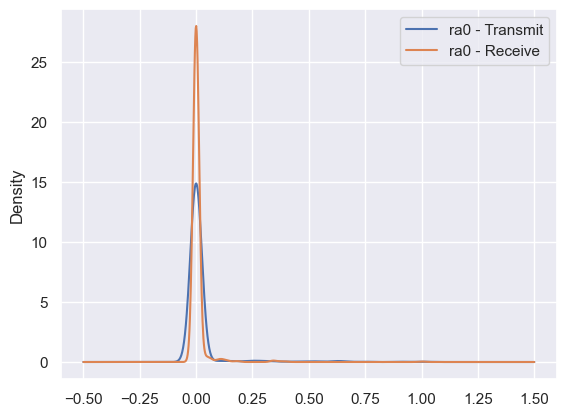

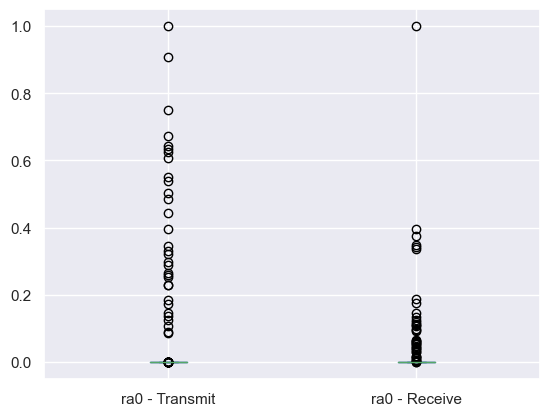

In [40]:
# Scatter plot
plt.scatter(df_traffic['ra0 - Transmit'], df_traffic['ra0 - Receive'])
plt.title('Scatter plot')
plt.xlabel('ra0 - Transmit')
plt.ylabel('ra0 - Receive')
plt.show()

# Histogram
df_traffic[['ra0 - Transmit', 'ra0 - Receive']].hist(bins=20)

# Density plot
df_traffic[['ra0 - Transmit', 'ra0 - Receive']].plot(kind='density')

# Box plot
df_traffic[['ra0 - Transmit', 'ra0 - Receive']].plot(kind='box')


<Axes: xlabel='hour'>

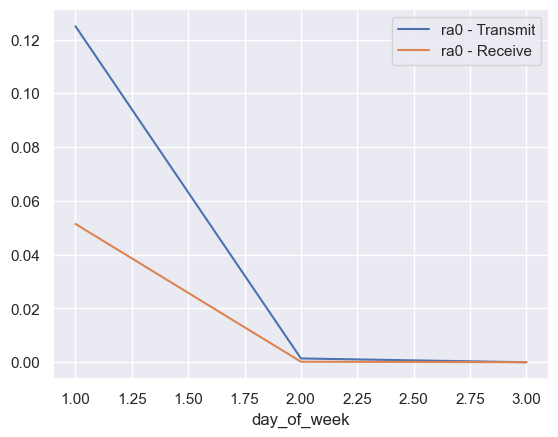

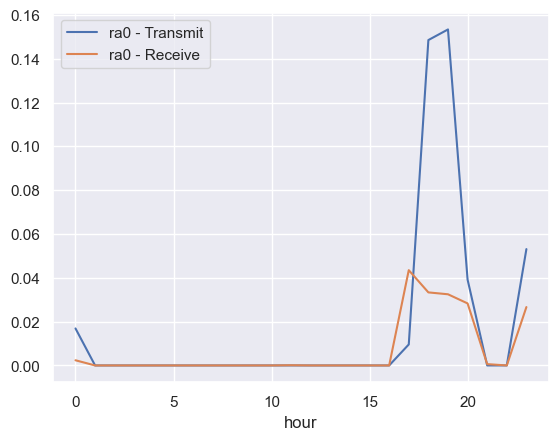

In [41]:
df_traffic['day_of_week'] = df_traffic.index.dayofweek
df_traffic.groupby('day_of_week')[['ra0 - Transmit', 'ra0 - Receive']].mean().plot()

# For hour of the day
df_traffic['hour'] = df_traffic.index.hour
df_traffic.groupby('hour')[['ra0 - Transmit', 'ra0 - Receive']].mean().plot()


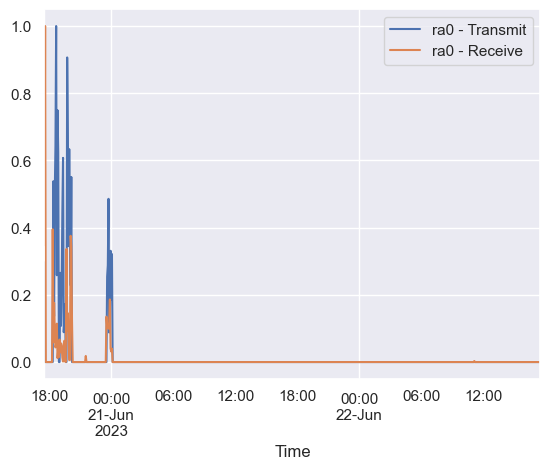

In [42]:
df_traffic[['ra0 - Transmit', 'ra0 - Receive']].plot()
plt.show()


In [43]:
# Import necessary library
import pandas as pd

# Assuming df_disk is your DataFrame
varied_columns = []

# Iterate over columns
for col in df_disk.columns:
    if df_disk[col].nunique() > 1:  # If column has more than one unique value
        varied_columns.append(col)

df_varied = df_disk[varied_columns]  # New DataFrame with only columns that vary


In [44]:
df_varied

,Time,/data,/etc/config,/nvram2,/user_data,/var/volatile/etc/config,/TMO_Container,/TMO_Container/container/kube/var/lib/containers/storage/overlay,/container,/container/kube/var/lib/containers/storage/overlay,/TMO_Container/container/kube/var/run,/container/kube/var/run,/home/root,/rdklogs,/var
0,2023-06-20 17:30:00,14.0,14.0,14.0,14.0,14.0,11.4,11.4,11.4,11.4,0.112,0.112,0.0391,34.2,0.133
1,2023-06-20 17:32:00,14.0,14.0,14.0,14.0,14.0,11.4,11.4,11.4,11.4,0.112,0.112,0.0391,37.9,0.133
2,2023-06-20 17:34:00,14.0,14.0,14.0,14.0,14.0,11.4,11.4,11.4,11.4,0.112,0.112,0.0391,43.2,0.134
3,2023-06-20 17:36:00,14.0,14.0,14.0,14.0,14.0,11.4,11.4,11.4,11.4,0.112,0.112,0.0391,37.5,0.134
4,2023-06-20 17:38:00,14.0,14.0,14.0,14.0,14.0,11.4,11.4,11.4,11.4,0.112,0.112,0.0391,37.9,0.120
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1436,2023-06-22 17:22:00,14.0,14.0,14.0,14.0,14.0,11.6,11.6,11.6,11.6,0.117,0.117,0.0781,72.2,0.156
1437,2023-06-22 17:24:00,14.0,14.0,14.0,14.0,14.0,11.6,11.6,11.6,11.6,0.117,0.117,0.0781,68.3,0.156
1438,2023-06-22 17:26:00,14.0,14.0,14.0,14.0,14.0,11.6,11.6,11.6,11.6,0.117,0.117,0.0781,66.8,0.156
1439,2023-06-22 17:28:00,14.0,14.0,14.0,14.0,14.0,11.6,11.6,11.6,11.6,0.117,0.117,0.0781,67.0,0.156


C:\Users\mwj97\AppData\Local\Temp\ipykernel_45596\2536429092.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\mwj97\AppData\Local\Temp\ipykernel_45596\2536429092.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



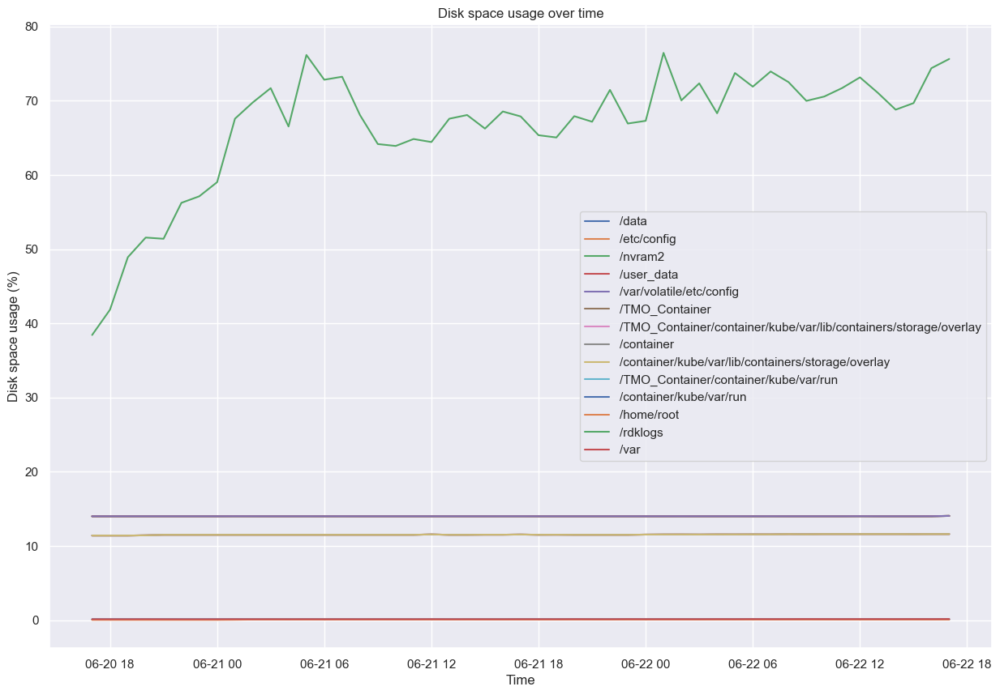

In [45]:
import pandas as pd
import matplotlib.pyplot as plt

# Make sure the Time column is interpreted as datetime
df_varied['Time'] = pd.to_datetime(df_varied['Time'])

# Set Time as index
df_varied.set_index('Time', inplace=True)

# Convert all other columns to numeric type
for col in df_varied.columns:
    df_varied[col] = pd.to_numeric(df_varied[col], errors='coerce')

# Resample the data to every hour instead of every 4 minutes
df_resampled = df_varied.resample('1H').mean()

# Plot the data
plt.figure(figsize=(15,10))

for col in df_resampled.columns:
    plt.plot(df_resampled.index, df_resampled[col], label=col)

plt.xlabel('Time')
plt.ylabel('Disk space usage (%)')
plt.legend()
plt.title('Disk space usage over time')
plt.show()


In [46]:
nat_mask = pd.isna(df_varied.index.to_series())
if nat_mask.any():
    print(f"'NaT' values found in index. Count: {nat_mask.sum()}")


In [47]:
df_varied = df_varied.loc[~nat_mask]


In [48]:
df_resampled = df_varied.resample('1H').mean()


In [49]:
df_resampled

,/data,/etc/config,/nvram2,/user_data,/var/volatile/etc/config,/TMO_Container,/TMO_Container/container/kube/var/lib/containers/storage/overlay,/container,/container/kube/var/lib/containers/storage/overlay,/TMO_Container/container/kube/var/run,/container/kube/var/run,/home/root,/rdklogs,/var
Time,,,,,,,,,,,,,,
2023-06-20 17:00:00,14.000000,14.000000,14.000000,14.000000,14.000000,11.400000,11.400000,11.400000,11.400000,0.1120,0.1120,0.0391,38.426667,0.126733
2023-06-20 18:00:00,14.000000,14.000000,14.000000,14.000000,14.000000,11.400000,11.400000,11.400000,11.400000,0.1120,0.1120,0.0391,41.833333,0.126233
2023-06-20 19:00:00,14.000000,14.000000,14.000000,14.000000,14.000000,11.400000,11.400000,11.400000,11.400000,0.1120,0.1120,0.0391,48.906667,0.126400
2023-06-20 20:00:00,14.000000,14.000000,14.000000,14.000000,14.000000,11.436667,11.436667,11.436667,11.436667,0.1120,0.1120,0.0391,51.556667,0.131933
2023-06-20 21:00:00,14.000000,14.000000,14.000000,14.000000,14.000000,11.500000,11.500000,11.500000,11.500000,0.1120,0.1120,0.0391,51.393333,0.127067
2023-06-20 22:00:00,14.000000,14.000000,14.000000,14.000000,14.000000,11.500000,11.500000,11.500000,11.500000,0.1120,0.1120,0.0391,56.236667,0.122800
2023-06-20 23:00:00,14.000000,14.000000,14.000000,14.000000,14.000000,11.500000,11.500000,11.500000,11.500000,0.1120,0.1120,0.0391,57.116667,0.121933
2023-06-21 00:00:00,14.000000,14.000000,14.000000,14.000000,14.000000,11.500000,11.500000,11.500000,11.500000,0.1120,0.1120,0.0391,59.020000,0.125667
2023-06-21 01:00:00,14.006667,14.006667,14.006667,14.006667,14.006667,11.500000,11.500000,11.500000,11.500000,0.1120,0.1120,0.0534,67.573333,0.132833


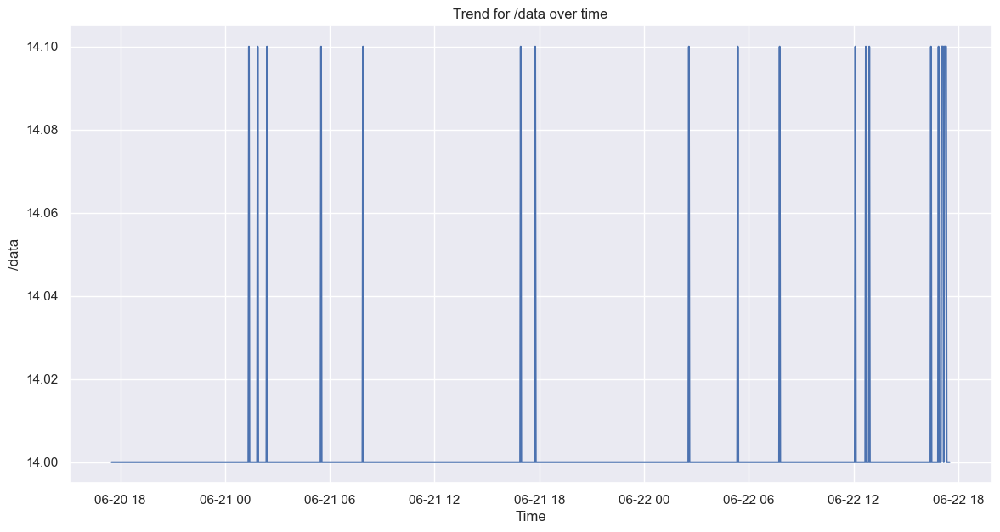

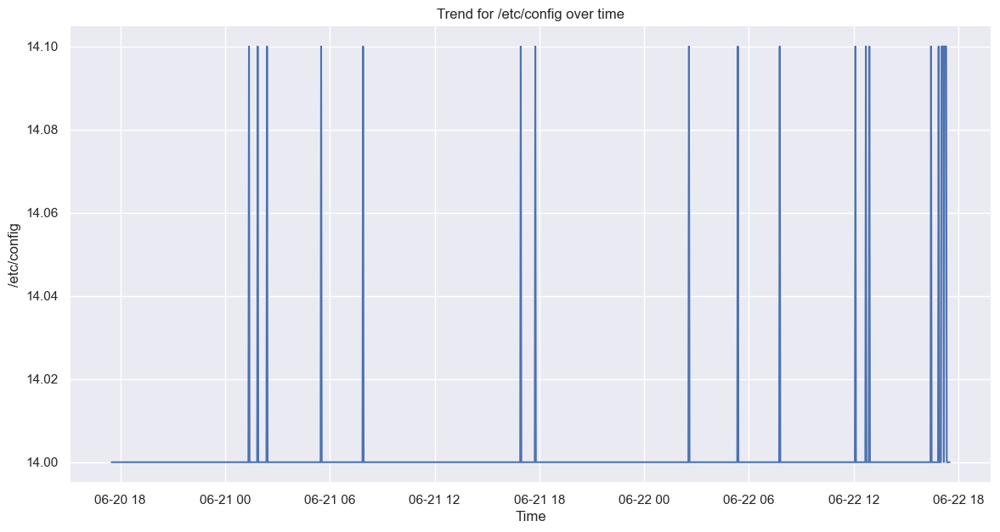

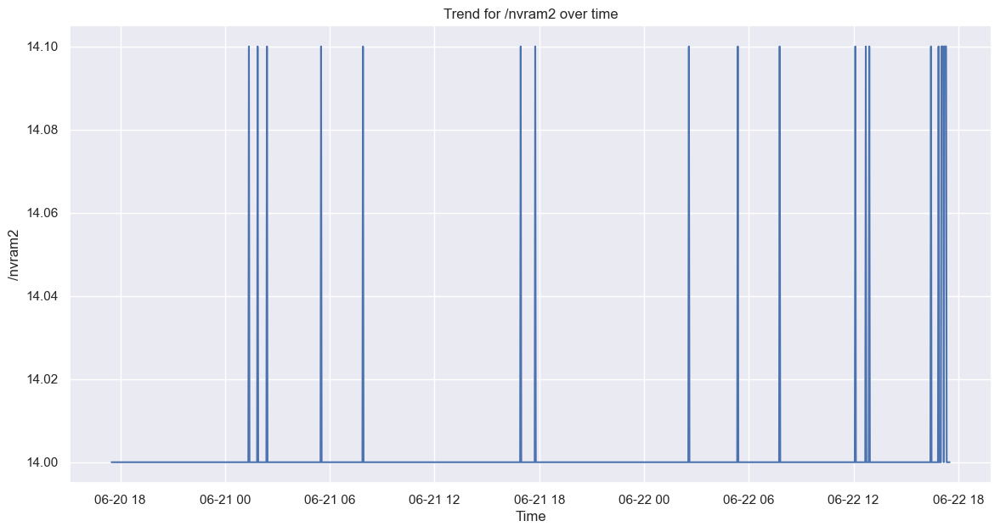

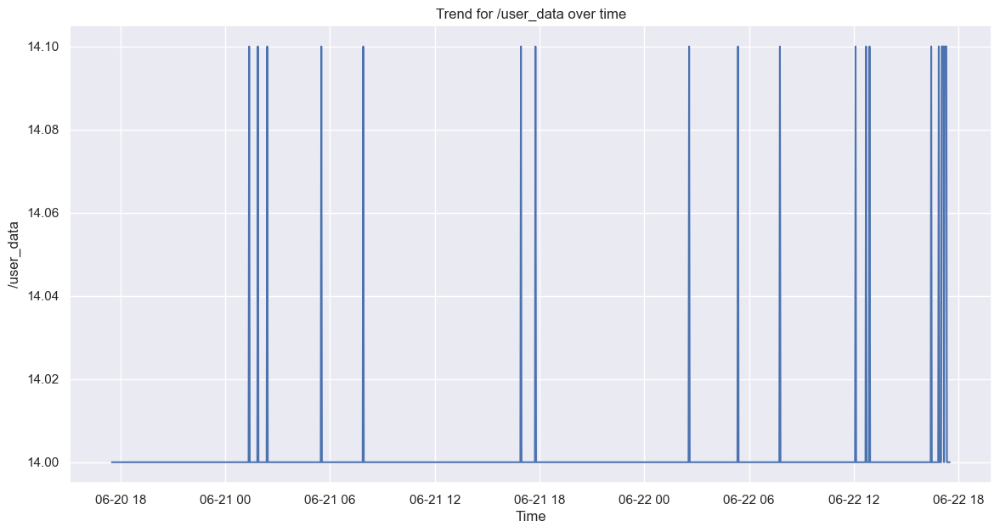

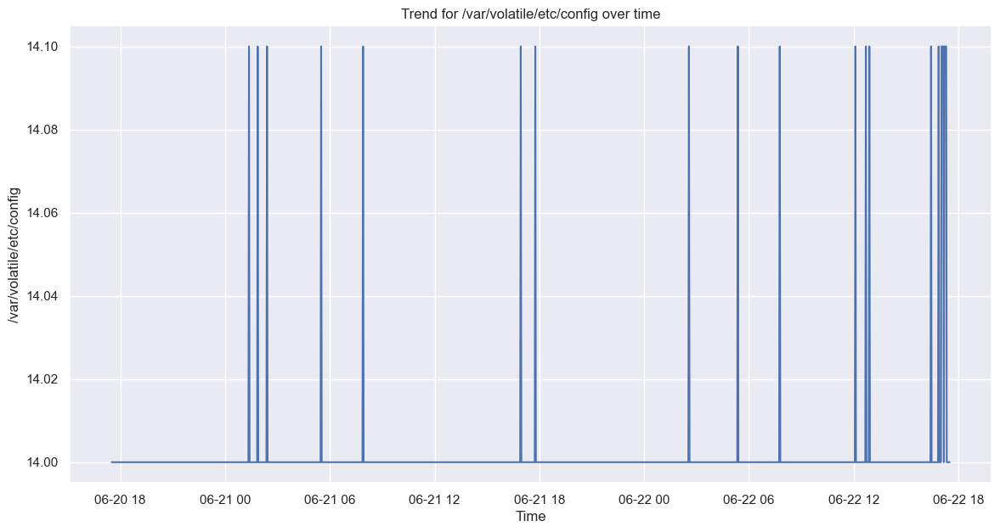

...

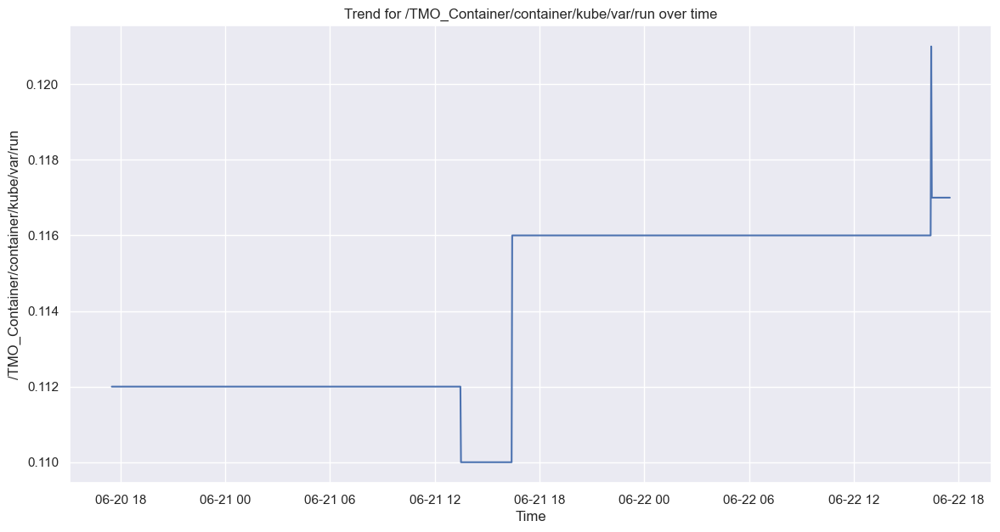

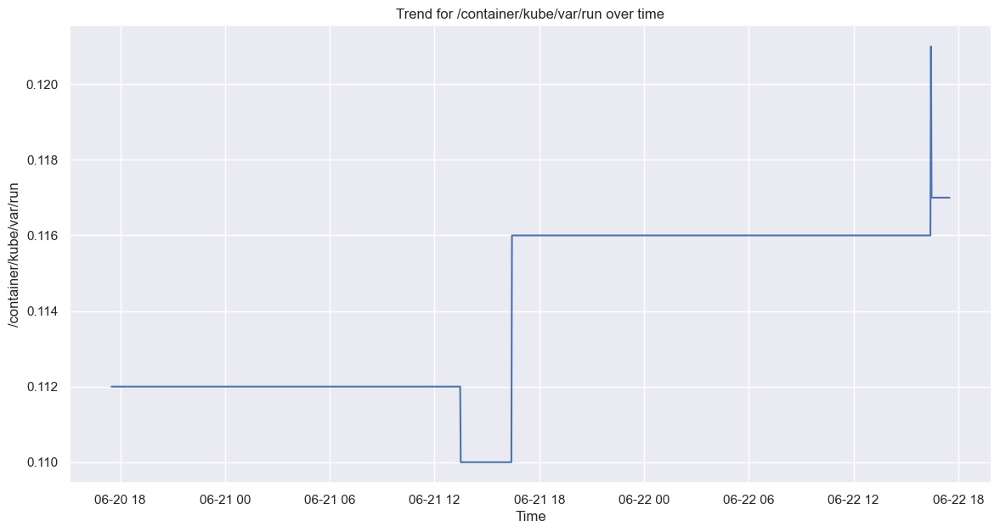

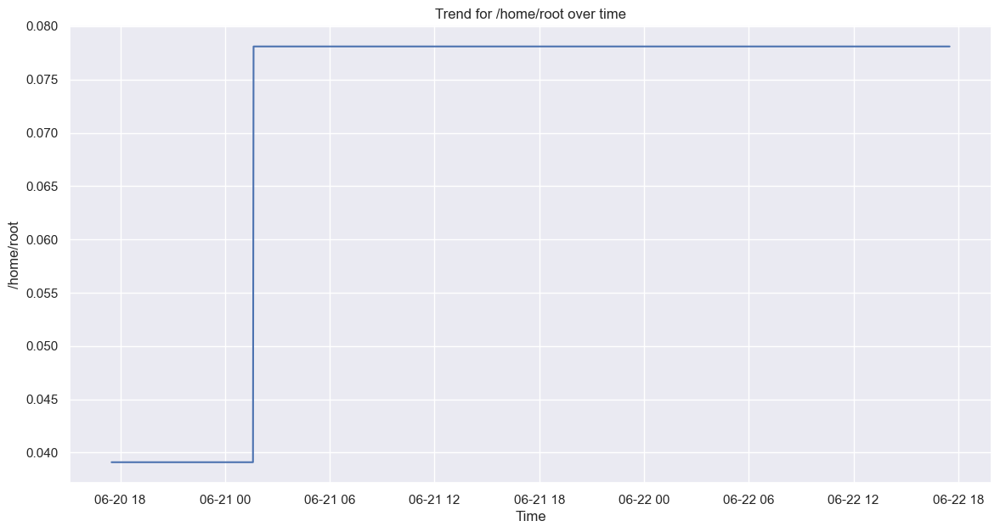

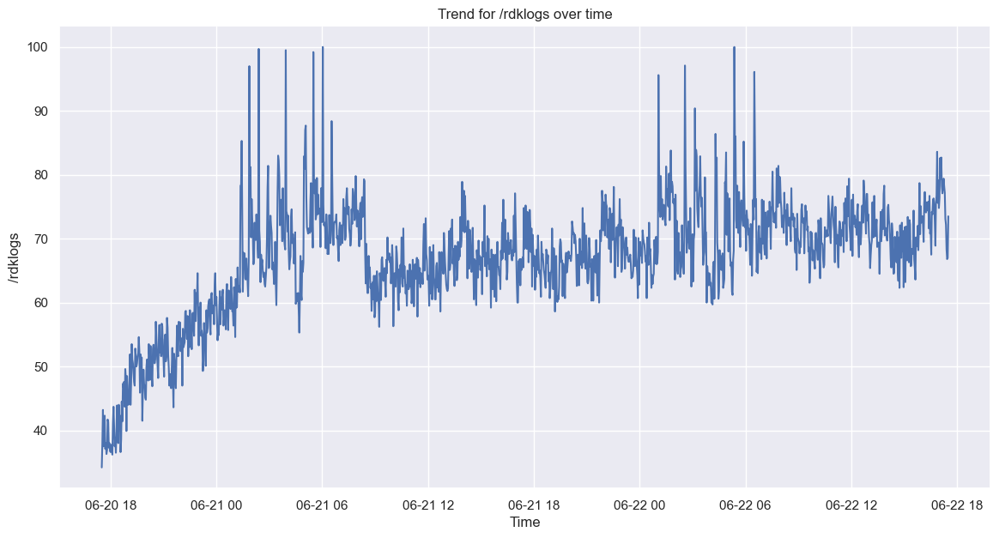

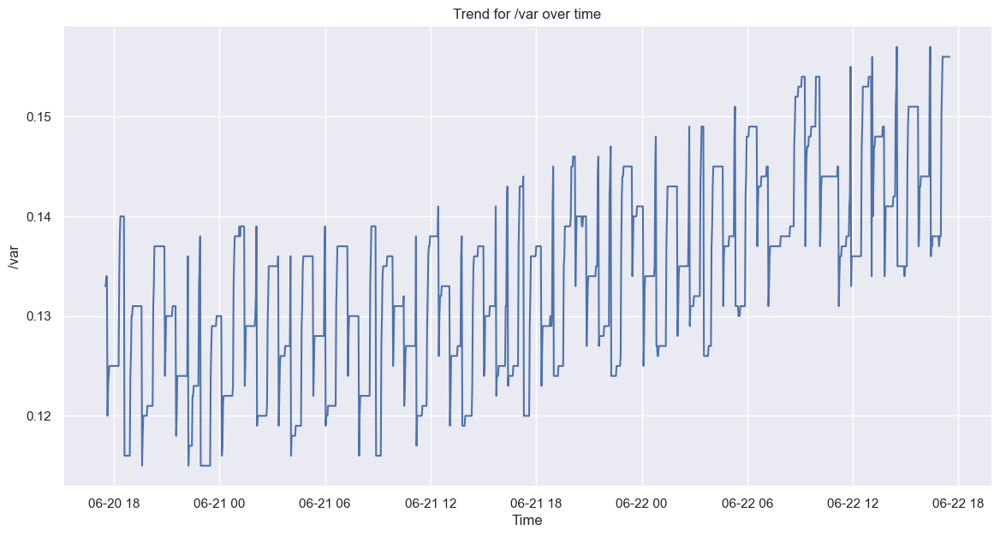

In [50]:
import matplotlib.pyplot as plt

# Create a list of column names
columns = df_varied.columns

# For each column in the dataframe, create a separate plot
for column in columns:
    plt.figure(figsize=(14,7))
    plt.plot(df_varied.index, df_varied[column])
    plt.title(f'Trend for {column} over time')
    plt.xlabel('Time')
    plt.ylabel(column)
    plt.show()


In [51]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

# Preprocessing
df_varied = df_disk[['Time', '/rdklogs']].copy()
df_varied['Time'] = pd.to_datetime(df_varied['Time'])
df_varied.set_index('Time', inplace=True)
df_varied.dropna(inplace=True)

# Splitting the data
train_size = int(len(df_varied) * 0.8)
train_data = df_varied.iloc[:train_size]
test_data = df_varied.iloc[train_size:]

# Scaling the data
scaler = MinMaxScaler()
train_scaled = scaler.fit_transform(train_data)
test_scaled = scaler.transform(test_data)

# Creating sequences
def create_sequences(data, sequence_length):
    X, y = [], []
    for i in range(len(data) - sequence_length):
        X.append(data[i:i+sequence_length])
        y.append(data[i+sequence_length])
    return np.array(X), np.array(y)

sequence_length = 10
X_train, y_train = create_sequences(train_scaled, sequence_length)
X_test, y_test = create_sequences(test_scaled, sequence_length)

# Building the LSTM model
model = Sequential()
model.add(LSTM(64, activation='relu', input_shape=(sequence_length, 1)))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')

# Training the model
model.fit(X_train, y_train, epochs=10, batch_size=16, verbose=1)

# Evaluation
train_loss = model.evaluate(X_train, y_train, verbose=0)
test_loss = model.evaluate(X_test, y_test, verbose=0)
print(f'Training loss: {train_loss}')
print(f'Testing loss: {test_loss}')

# Predicting future values
future_input = test_scaled[-sequence_length:]
future_input = future_input.reshape((1, sequence_length, 1))
future_pred = model.predict(future_input)
future_pred = scaler.inverse_transform(future_pred)
print(f'Predicted future value: {future_pred[0][0]}')


Epoch 1/10
72/72 [==============================] - 5s 10ms/step - loss: 0.0334
Epoch 2/10
72/72 [==============================] - 1s 10ms/step - loss: 0.0062
Epoch 3/10
72/72 [==============================] - 1s 11ms/step - loss: 0.0059
Epoch 4/10
72/72 [==============================] - 1s 10ms/step - loss: 0.0061
Epoch 5/10
72/72 [==============================] - 1s 10ms/step - loss: 0.0059
Epoch 6/10
72/72 [==============================] - 1s 10ms/step - loss: 0.0057
Epoch 7/10
72/72 [==============================] - 1s 10ms/step - loss: 0.0056
Epoch 8/10
72/72 [==============================] - 1s 11ms/step - loss: 0.0057
Epoch 9/10
72/72 [==============================] - 1s 10ms/step - loss: 0.0055
Epoch 10/10
72/72 [==============================] - 1s 10ms/step - loss: 0.0055
Training loss: 0.005465602036565542
Testing loss: 0.002569791628047824
1/1 [==============================] - 1s 536ms/step
Predicted future value: 70.10028839111328


In [52]:
from statsmodels.tsa.arima.model import ARIMA

# Iterate over each column in the dataframe
for column in df_varied.columns:
    # Get the time series data for the current column
    series = df_varied[column]
    
    # Define the order for ARIMA (p, d, q)
    order = (1, 0, 0)  # Update the order based on the characteristics of your data
    
    # Fit the ARIMA model
    model = ARIMA(series, order=order)
    model_fit = model.fit()
    
    # Forecast future values
    forecast = model_fit.forecast(steps=10)  # Adjust the number of steps as needed
    
    # Print the forecasted values
    print(f'Forecasted values for {column}:')
    print(forecast)
    print()


C:\Users\mwj97\anaconda4\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency 2T will be used.

C:\Users\mwj97\anaconda4\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency 2T will be used.

C:\Users\mwj97\anaconda4\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency 2T will be used.



Forecasted values for /rdklogs:
2023-06-22 17:32:00    72.386432
2023-06-22 17:34:00    71.454363
2023-06-22 17:36:00    70.674211
2023-06-22 17:38:00    70.021215
2023-06-22 17:40:00    69.474650
2023-06-22 17:42:00    69.017169
2023-06-22 17:44:00    68.634252
2023-06-22 17:46:00    68.313747
2023-06-22 17:48:00    68.045480
2023-06-22 17:50:00    67.820938
Freq: 2T, Name: predicted_mean, dtype: float64



In [54]:
# Check for empty cells in each column
empty_columns = df_resident.columns[df_resident.isnull().any()]

# Calculate the sum of occurrences for each column
occurrence_sum = df_resident[empty_columns].notnull().sum().sum()

# Display the sum of occurrences
print(f"Sum of Occurrences: {occurrence_sum}")


Sum of Occurrences: 153


In [55]:
# Check for empty cells in each column
empty_columns = df_resident.columns[df_resident.isnull().any()]

# Calculate the number of occurrences for each column
occurrence_counts = df_resident[empty_columns].isnull().sum()

# Sort the columns by occurrence counts in ascending order
sorted_columns = occurrence_counts.sort_values()

# Display the columns with the most and least occurrences
most_occurrences_column = sorted_columns.index[-1]
least_occurrences_column = sorted_columns.index[0]

print(f"Column with the Most Occurrences: {most_occurrences_column}")
print(f"Column with the Least Occurrences: {least_occurrences_column}")


Column with the Most Occurrences: uci_restful
Column with the Least Occurrences: timeout


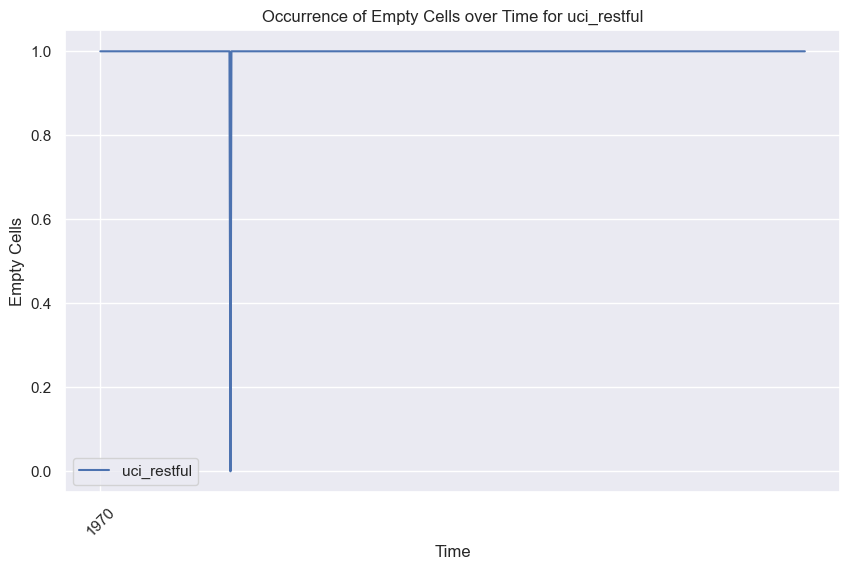

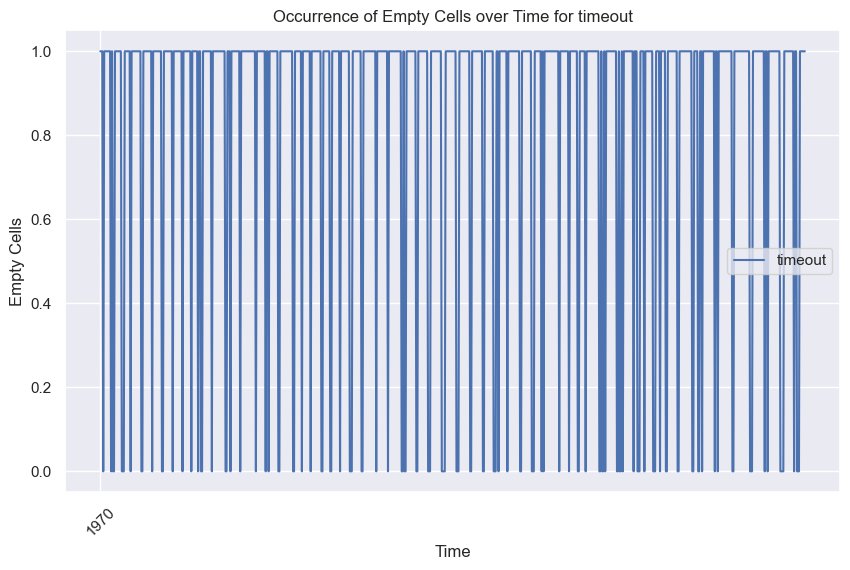

In [56]:
import pandas as pd
import matplotlib.pyplot as plt

# Convert index to datetime format
df_resident.index = pd.to_datetime(df_resident.index)

# Choose the columns with the most and least occurrences
most_occurrences_column = sorted_columns.index[-1]
least_occurrences_column = sorted_columns.index[0]

# Plot the occurrence of empty cells over time for the most occurrences column
plt.figure(figsize=(10, 6))
plt.plot(df_resident.index, df_resident[most_occurrences_column].isnull(), label=f"{most_occurrences_column}")
plt.title(f"Occurrence of Empty Cells over Time for {most_occurrences_column}")
plt.xlabel("Time")
plt.ylabel("Empty Cells")
plt.xticks(rotation=45)
plt.legend()
plt.show()

# Plot the occurrence of empty cells over time for the least occurrences column
plt.figure(figsize=(10, 6))
plt.plot(df_resident.index, df_resident[least_occurrences_column].isnull(), label=f"{least_occurrences_column}")
plt.title(f"Occurrence of Empty Cells over Time for {least_occurrences_column}")
plt.xlabel("Time")
plt.ylabel("Empty Cells")
plt.xticks(rotation=45)
plt.legend()
plt.show()


In [57]:
# Calculate the minimum and maximum values for each column
min_values = df_resident.min()
max_values = df_resident.max()

# Find columns where the minimum and maximum values are the same
unchanged_columns = min_values[min_values == max_values].index

# Display the columns that do not change in value
print("Columns that do not change in value throughout the two days of experimentation:")
print(unchanged_columns)


Columns that do not change in value throughout the two days of experimentation:
Index(['adbd', 'aee_aed64', 'agetty', 'atci_service', 'atcid',
       'audio-ctrl-serv', 'bs20', 'ccci_fsd', 'ccci_mdinit', 'cut',
       'dibbler-server', 'emdlogger1', 'gnss_adpd', 'jq', 'ld-linux.so',
       'libmodem-afe-ct', 'log_controld', 'mtk_netagent', 'obuspa',
       'obuspa_start.sh', 'pause', 'sc-keypad', 'sc_modem_cli',
       'sc_push_button', 'scd', 'sed', 'speech_daemon', 'start_speedtest',
       'systemd-logind', 'thermal_core', 'tmo_agent', 'trigger', 'uci_restful',
       'wtchdogstarter.', 'zebra'],
      dtype='object')


In [58]:
import pandas as pd

# Convert columns to numeric data type
df_resident_numeric = df_resident.apply(pd.to_numeric, errors='coerce')

# Calculate range and standard deviation for each column
column_changes = {}

for column in df_resident_numeric.columns:
    column_range = df_resident_numeric[column].max() - df_resident_numeric[column].min()
    column_std = df_resident_numeric[column].std()
    column_changes[column] = {'Range': column_range, 'Standard Deviation': column_std}

column_changes_df = pd.DataFrame.from_dict(column_changes, orient='index')
column_changes_df.sort_values(by='Range', inplace=True, ascending=False)

print(column_changes_df)


                      Range  Standard Deviation
dropbear         17944576.0        4.961208e+06
sh               10383360.0        3.042423e+06
dynamic_agent     8519680.0        2.497431e+06
kubelet           8060928.0        1.778372e+06
systemd-journal   7024640.0        1.974931e+06
...                     ...                 ...
sc_push_button          0.0        0.000000e+00
log_controld            0.0        0.000000e+00
scd                     0.0        0.000000e+00
zebra                   0.0        0.000000e+00
Time                    NaN                 NaN

[108 rows x 2 columns]


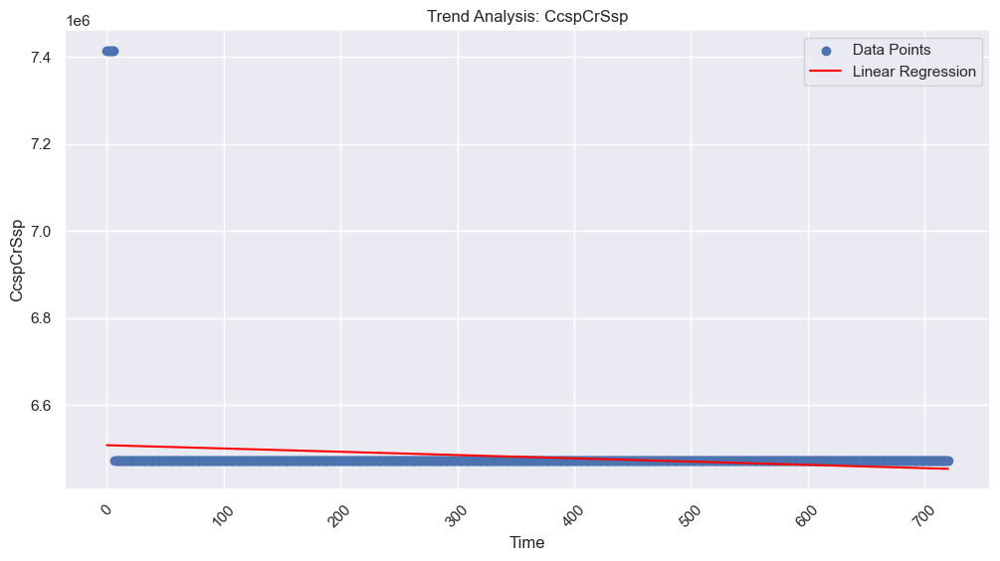

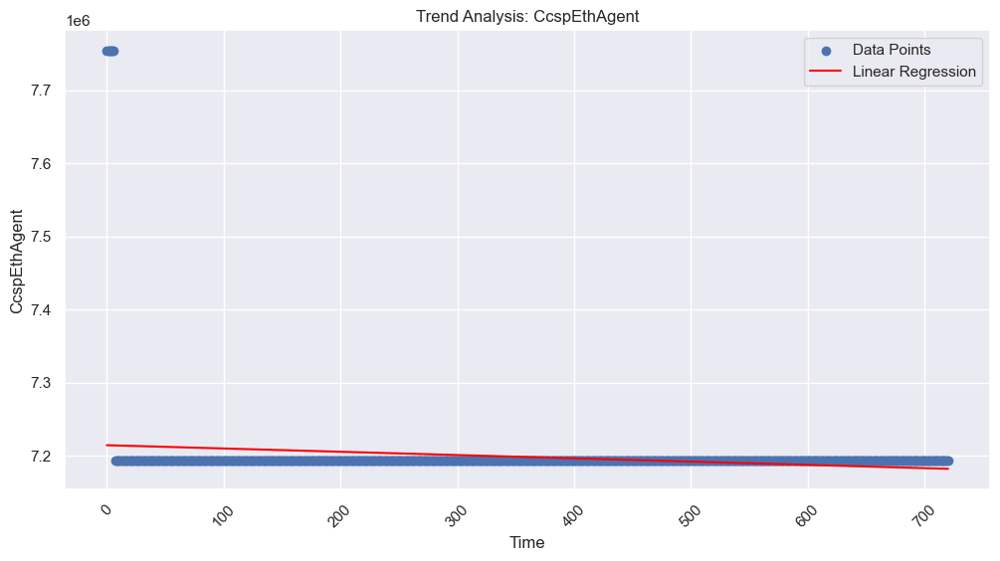

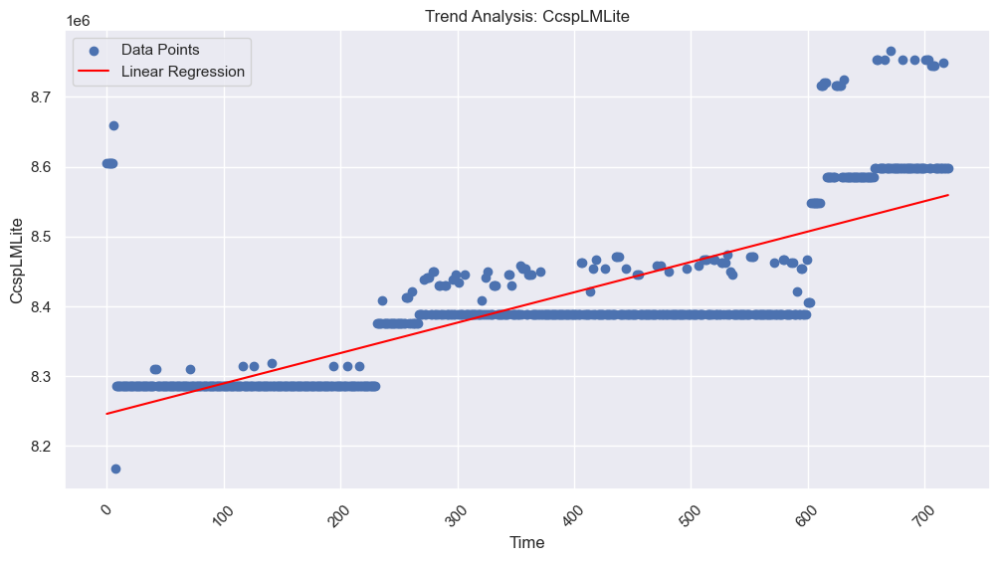

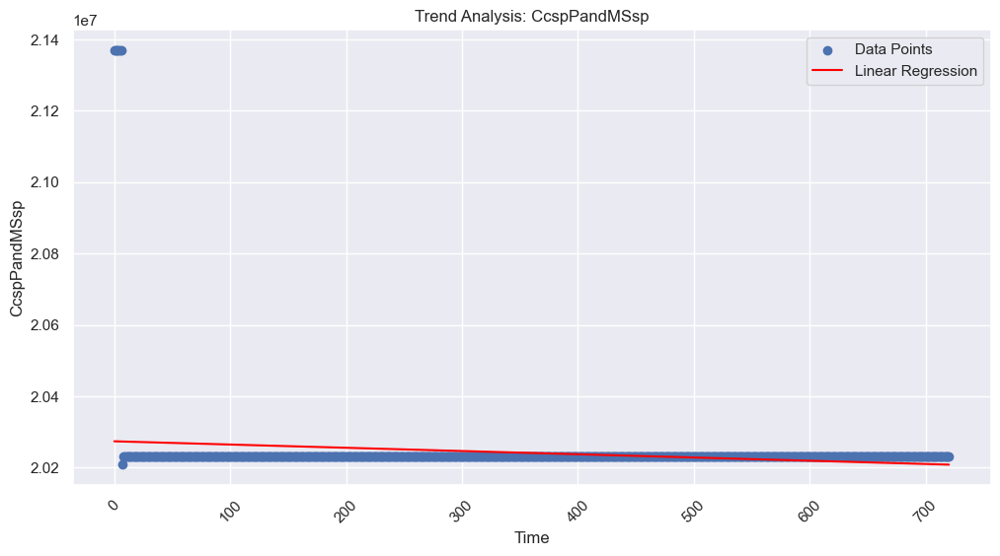

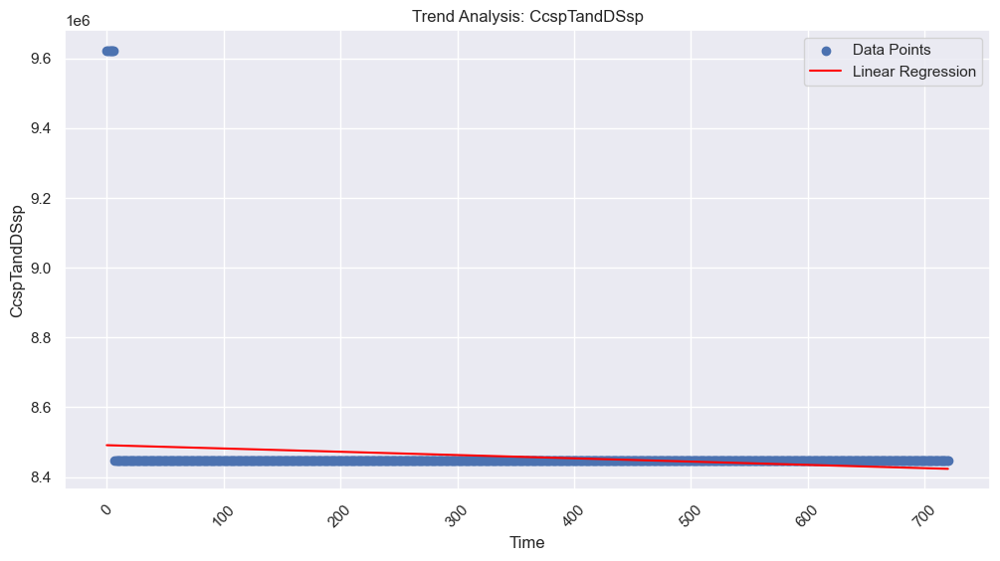

...

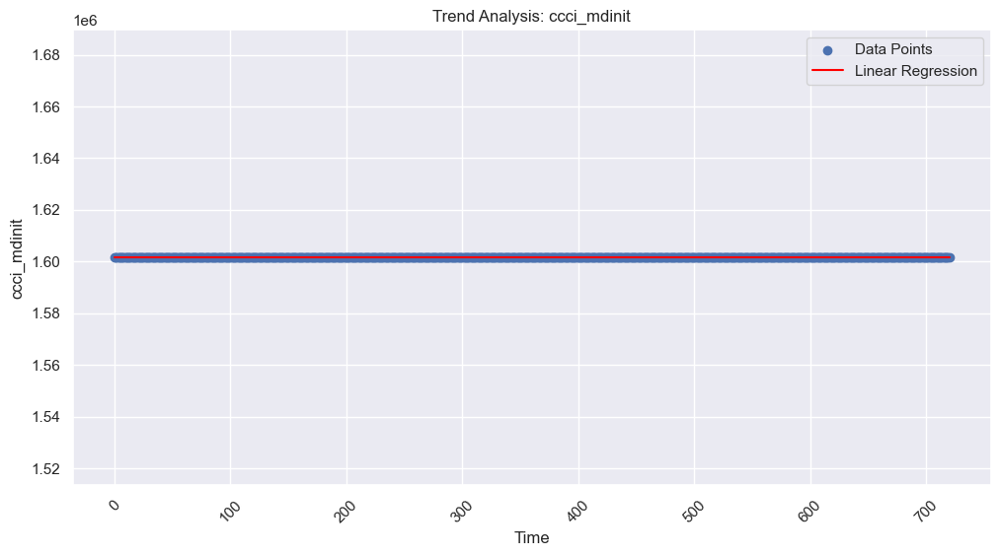

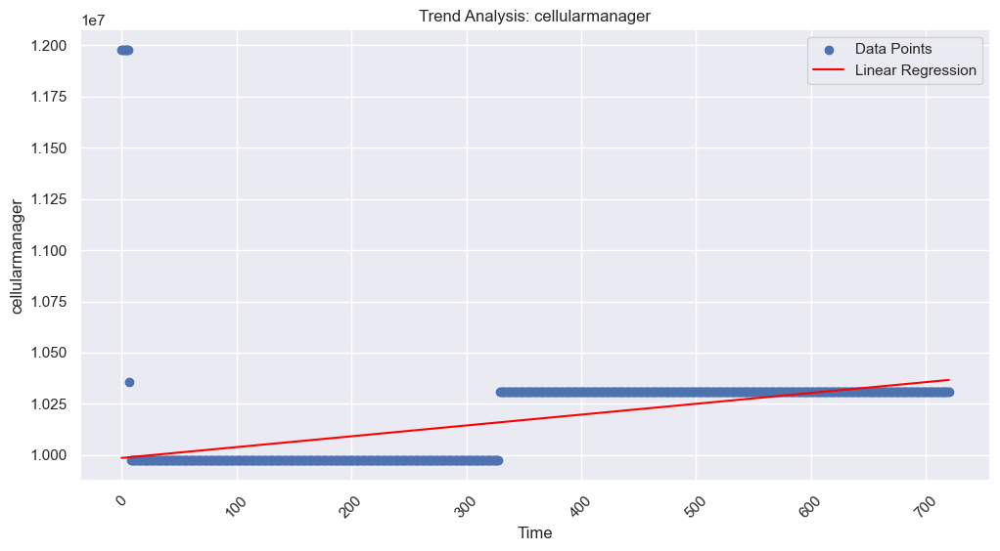

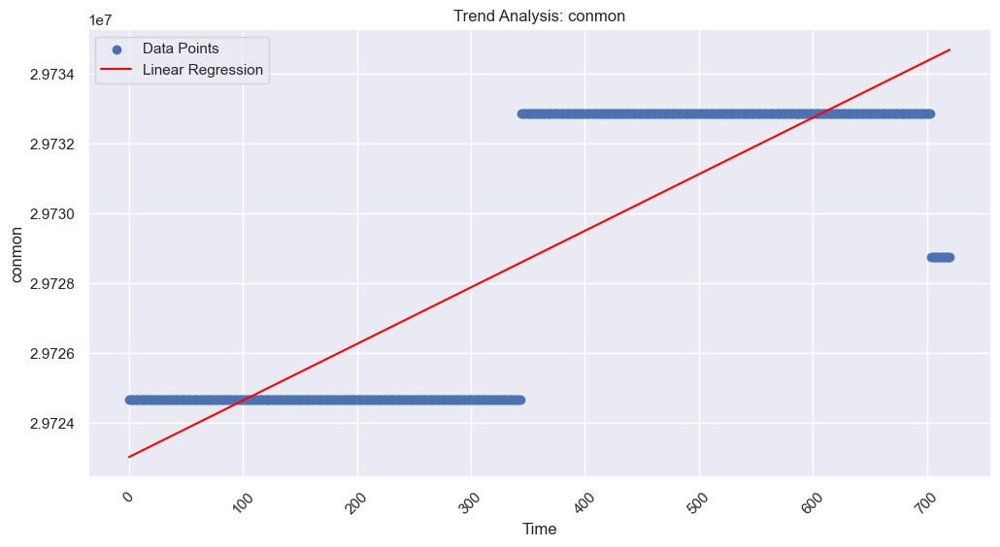

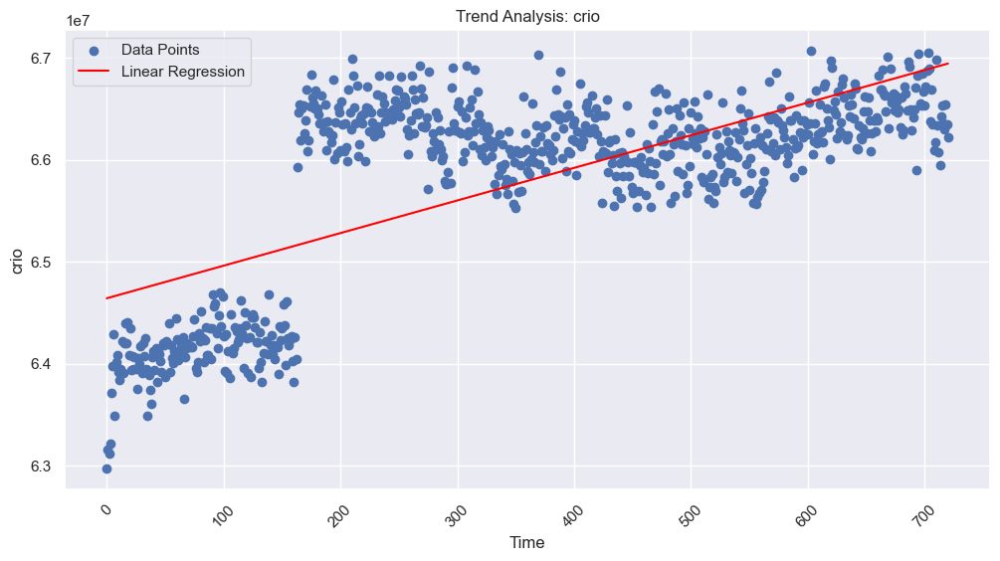

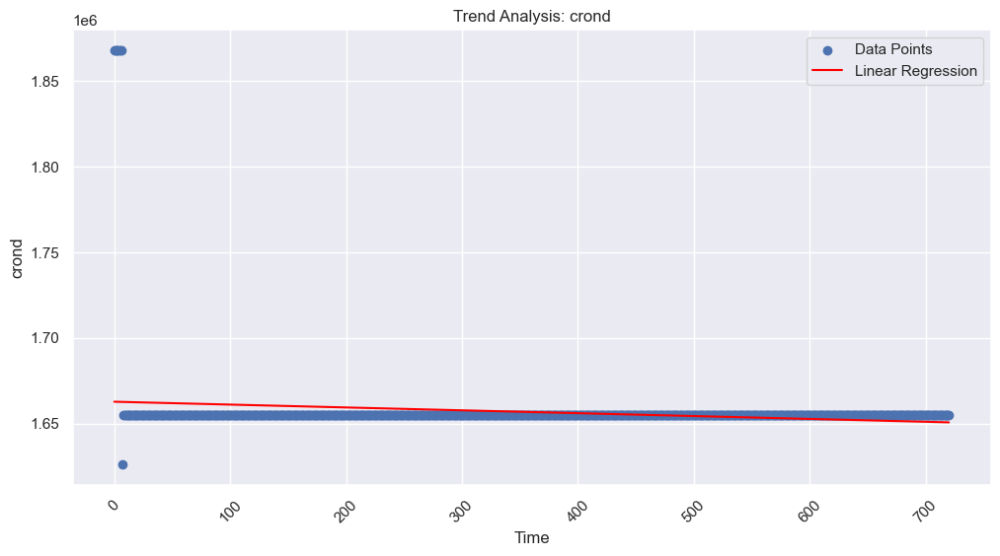

Skipping column 'cut' due to NaN values.


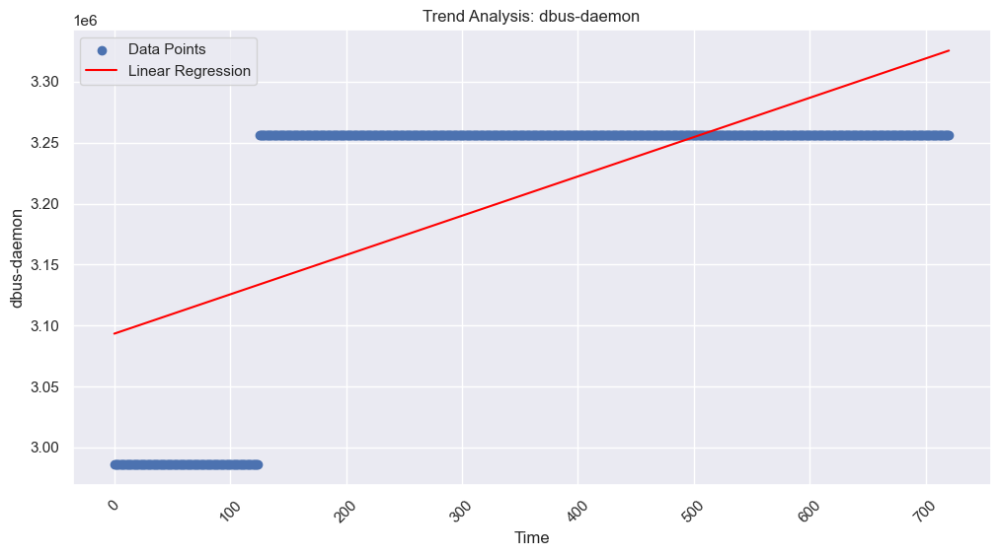

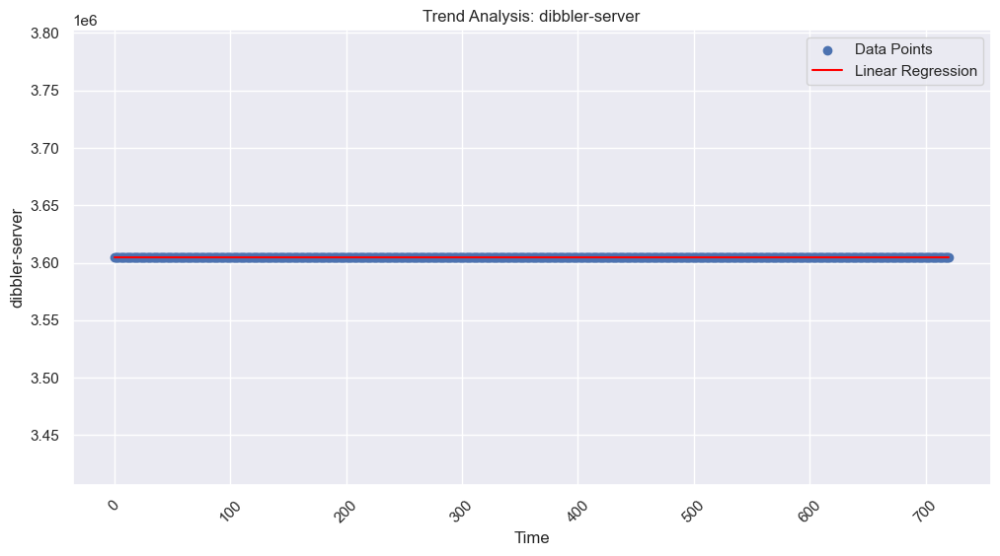

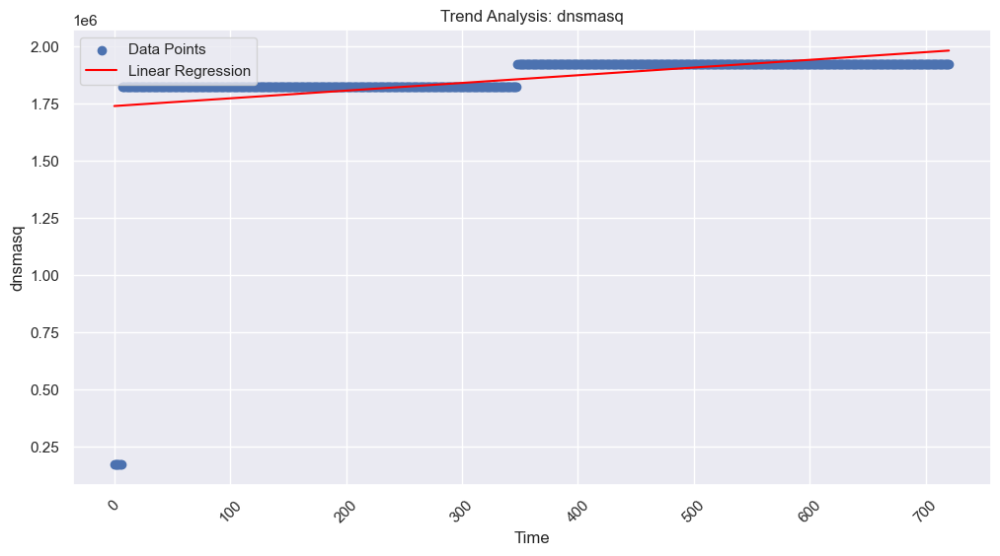

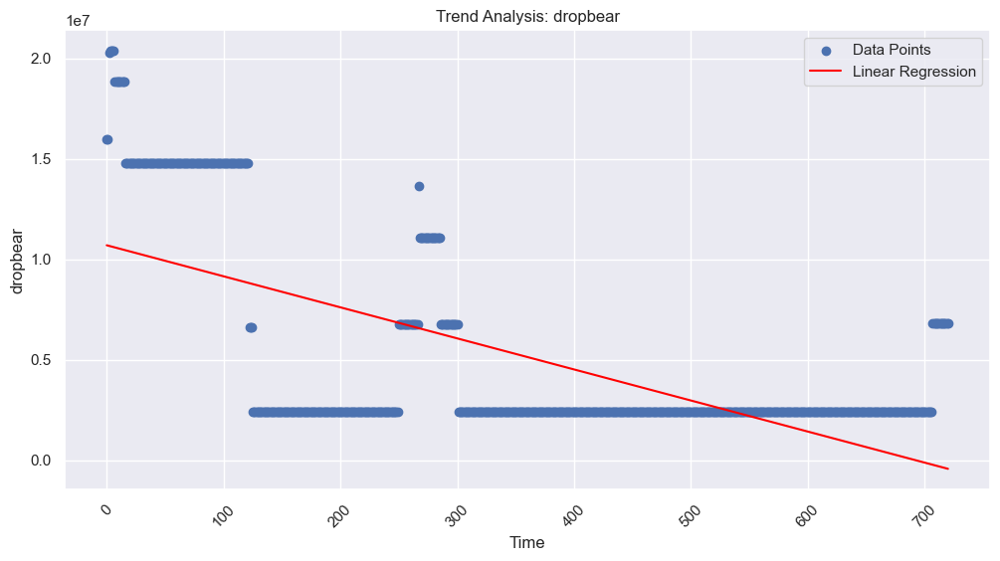

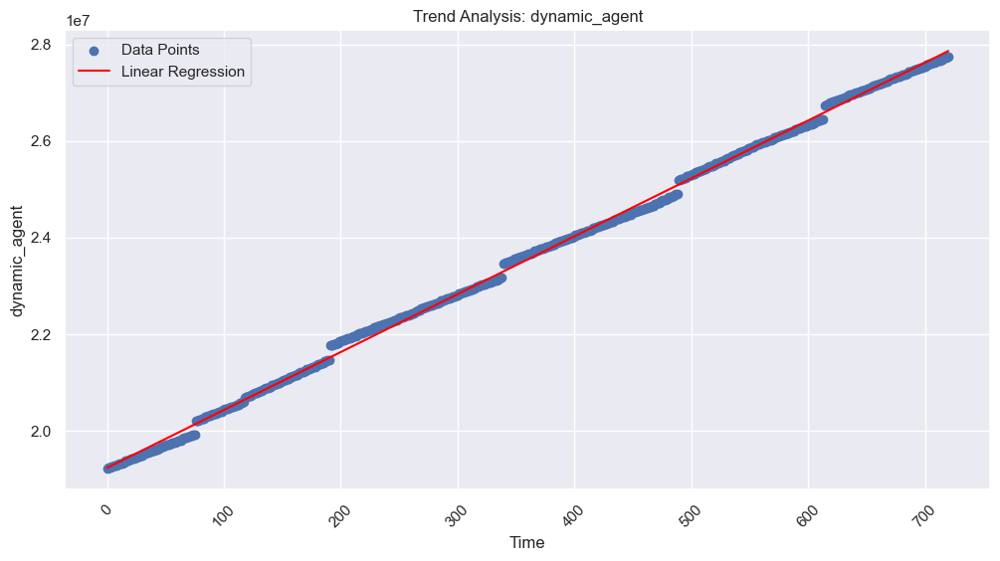

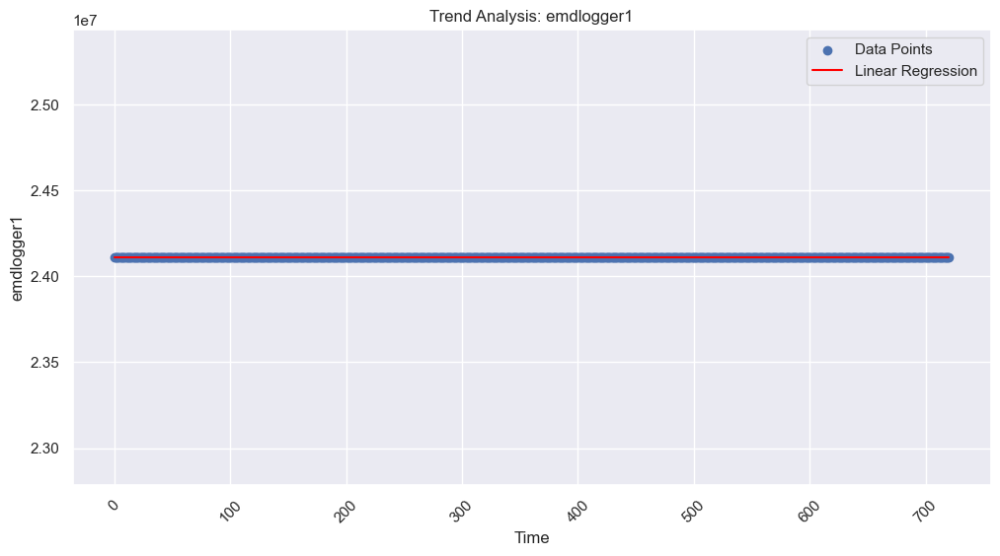

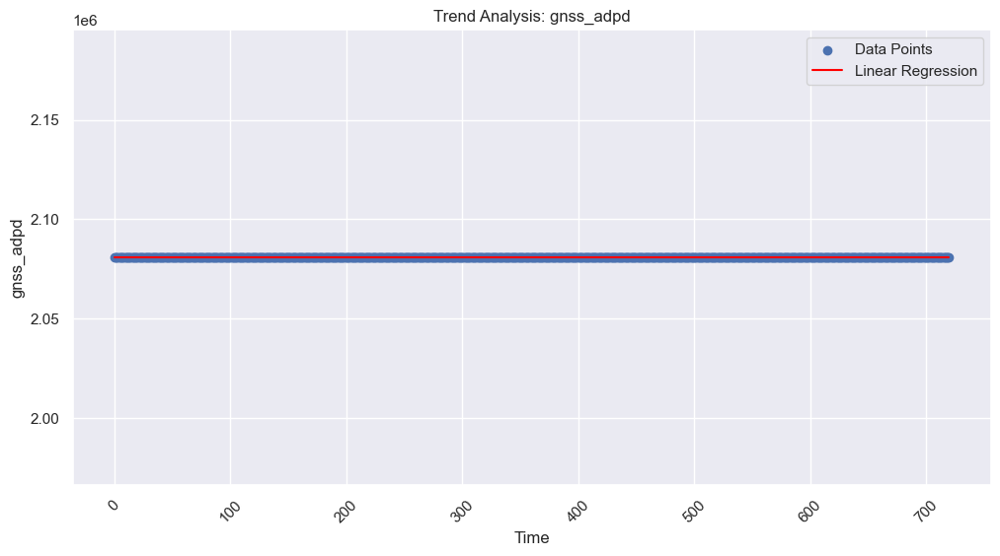

Skipping column 'grep' due to NaN values.
Skipping column 'jq' due to NaN values.


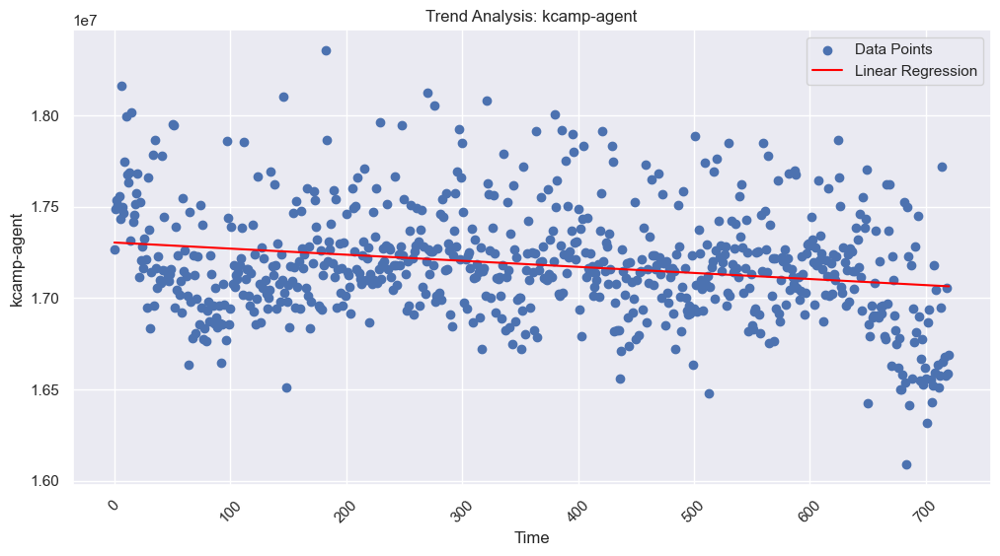

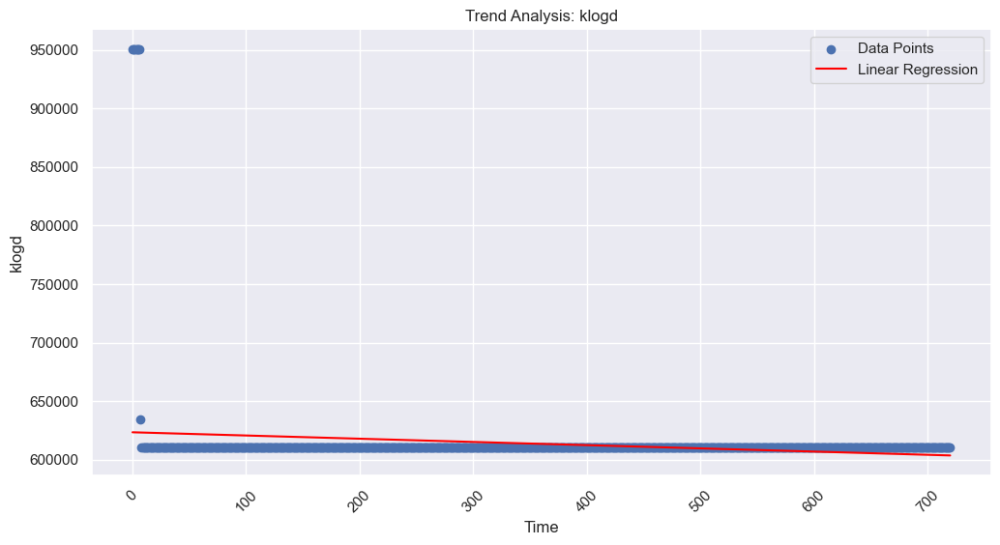

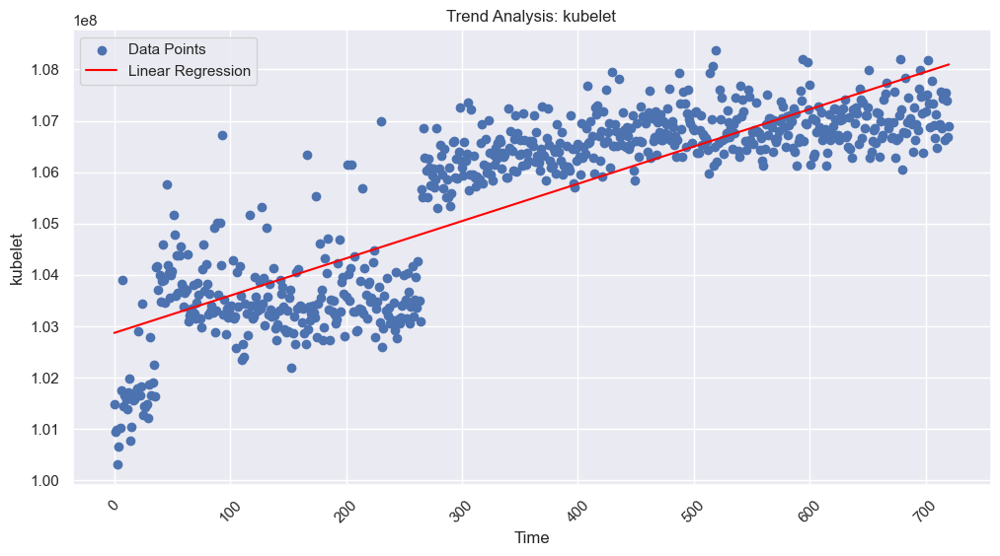

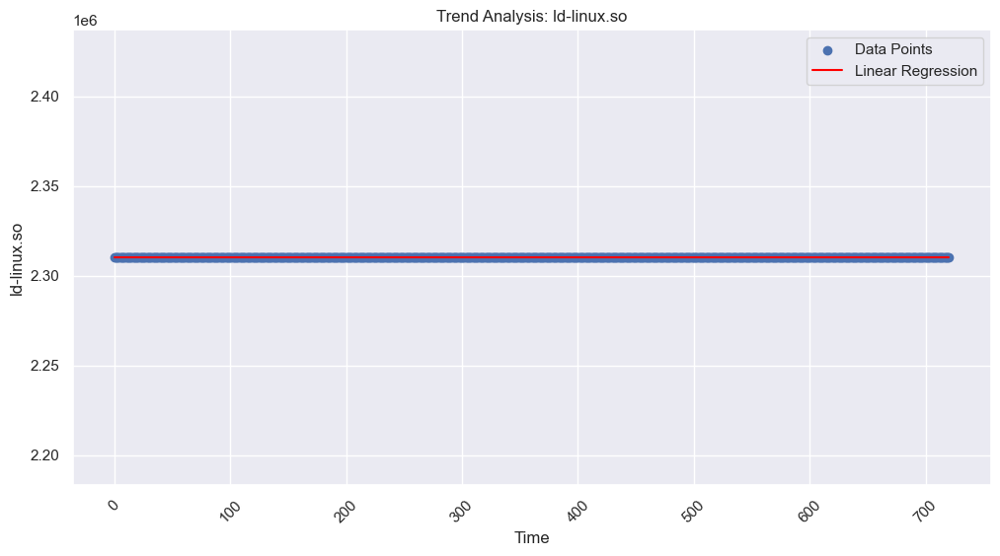

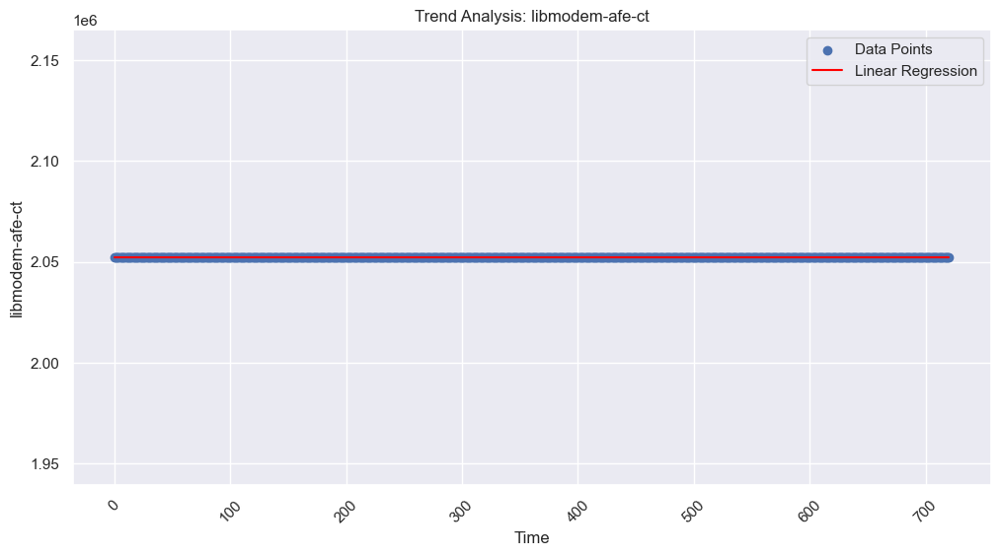

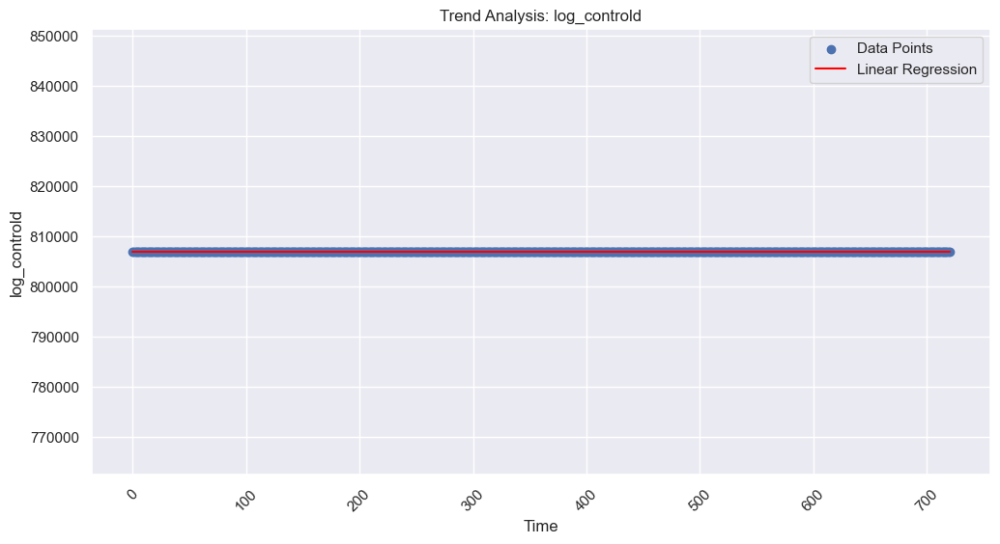

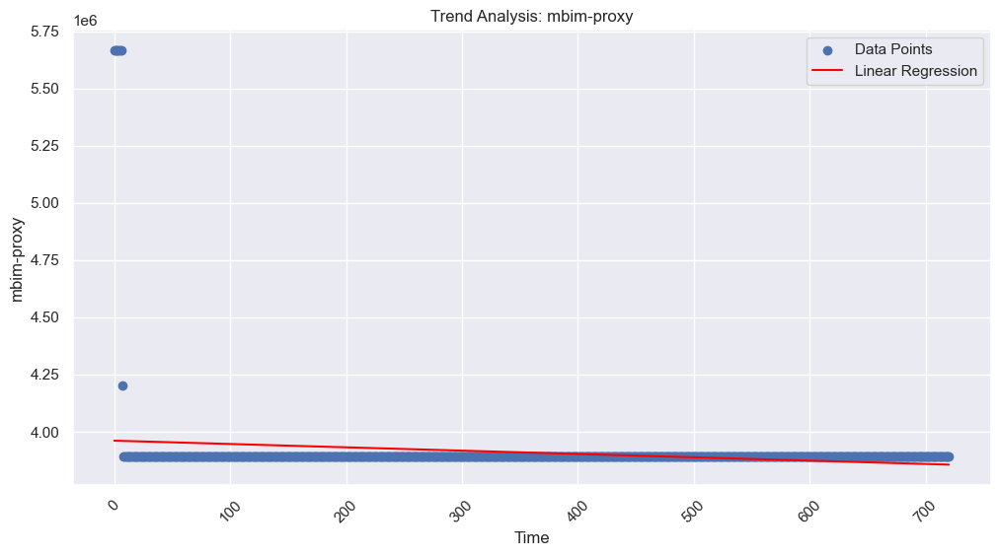

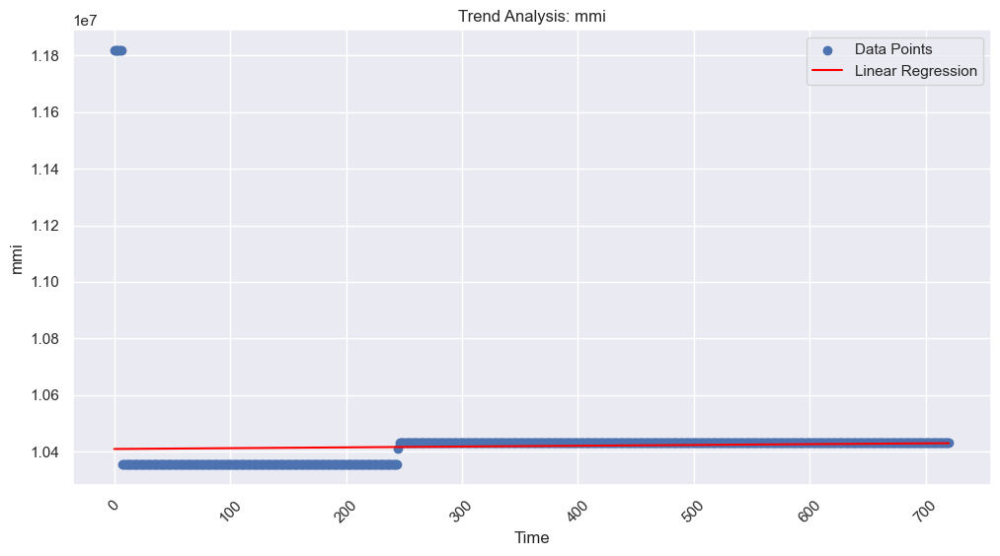

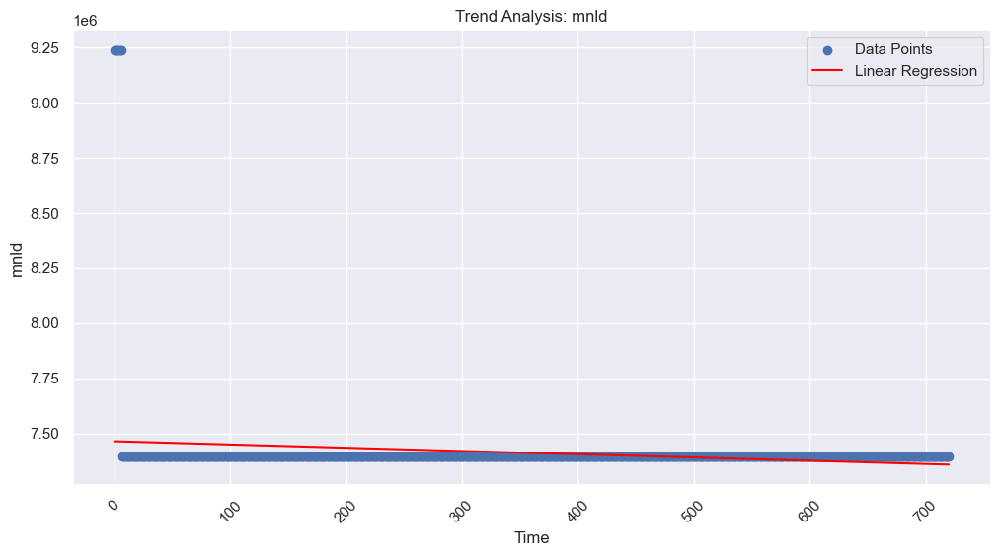

Skipping column 'more' due to NaN values.


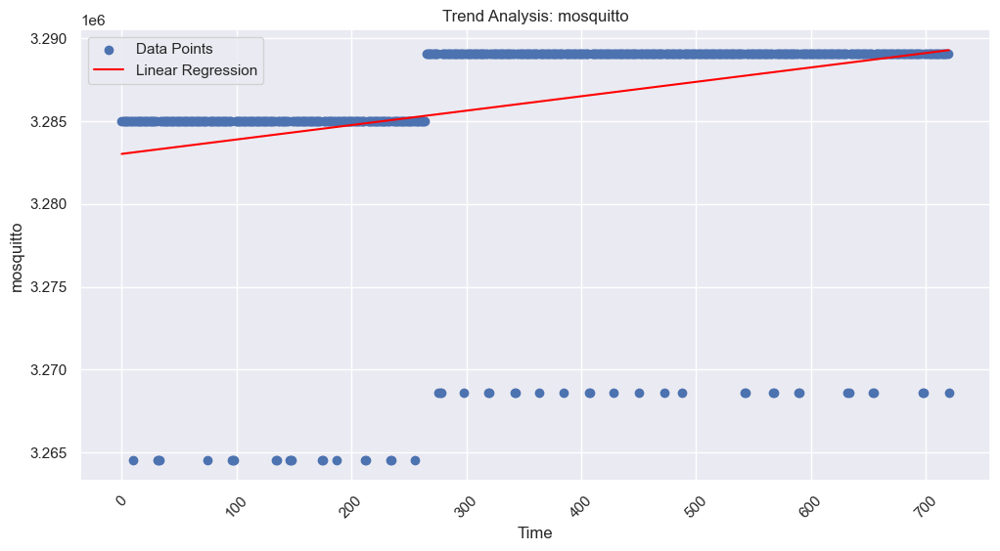

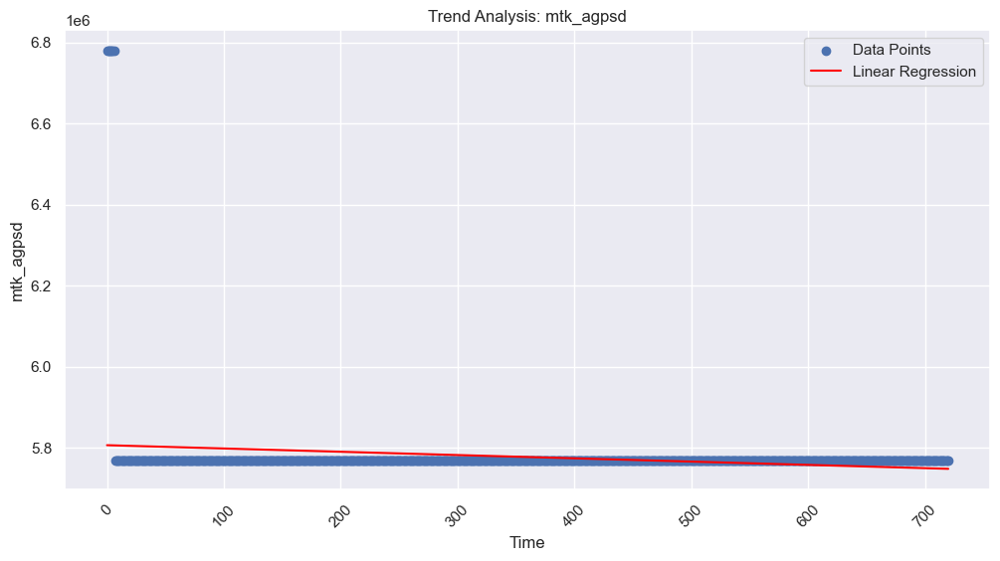

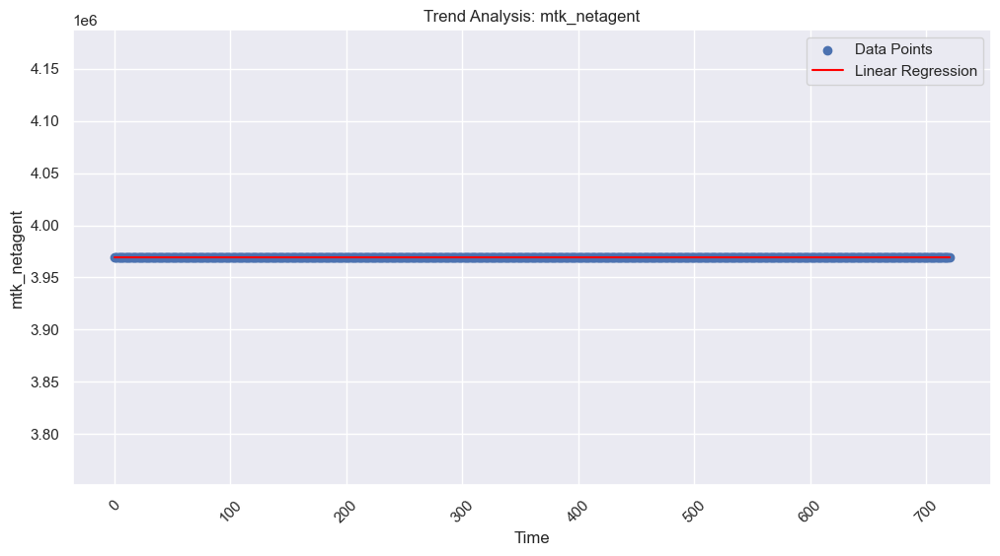

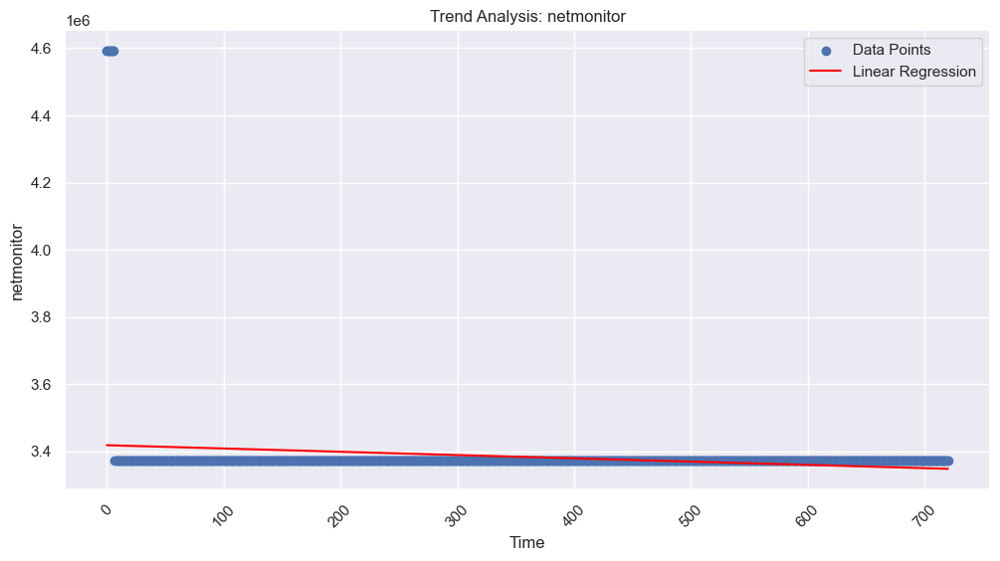

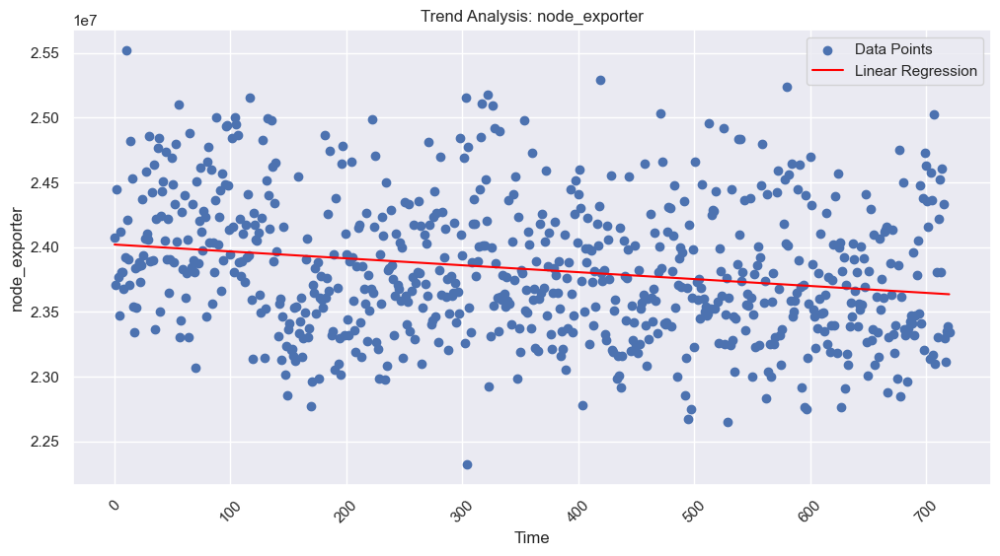

...

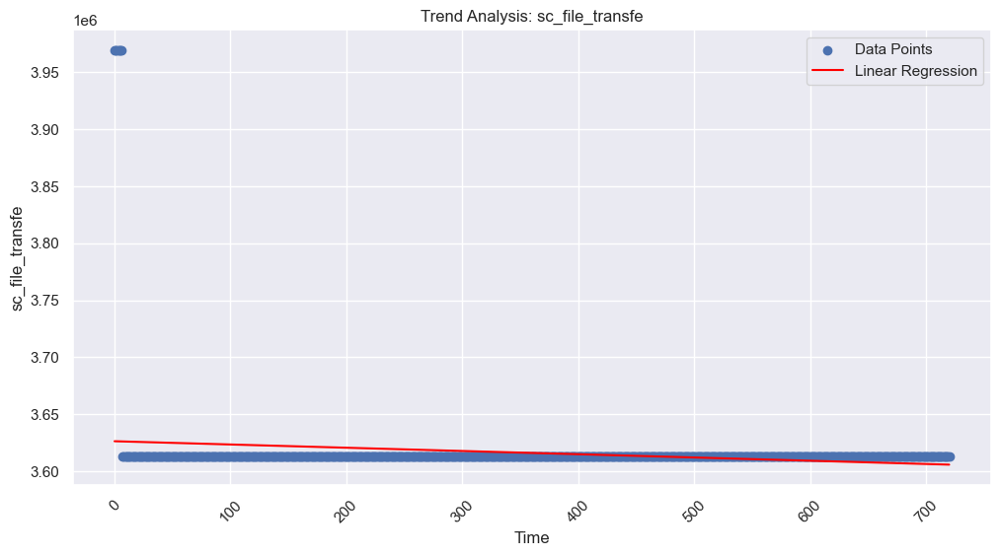

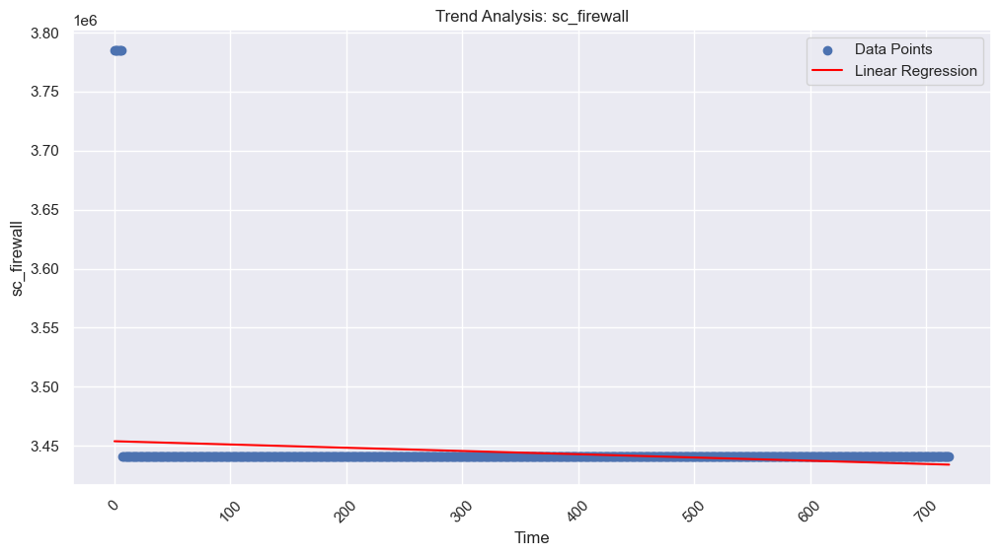

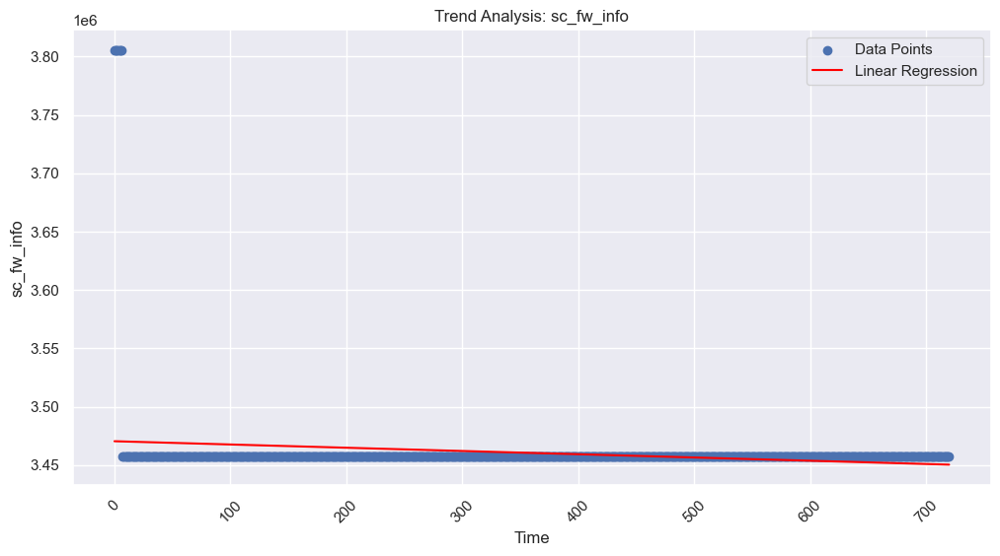

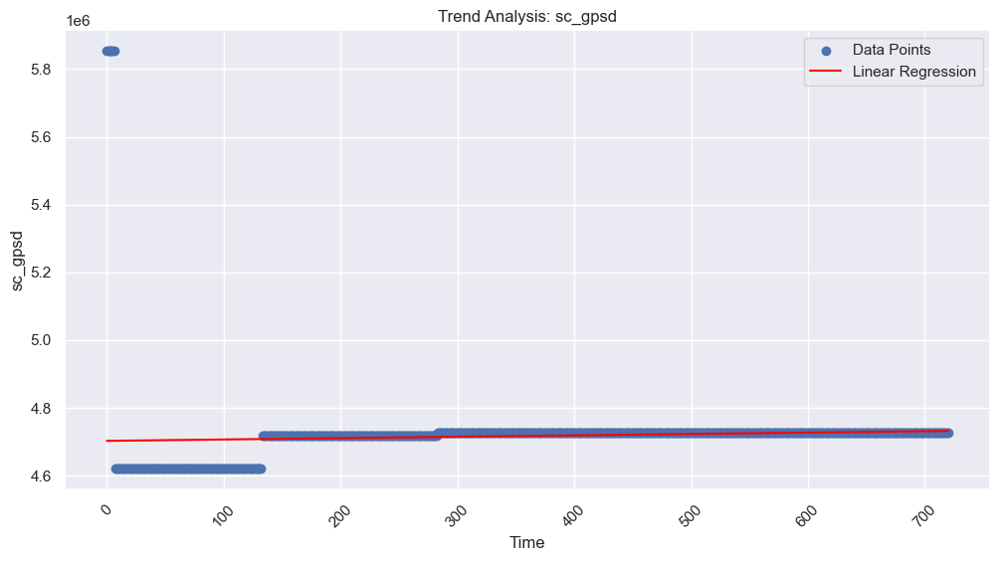

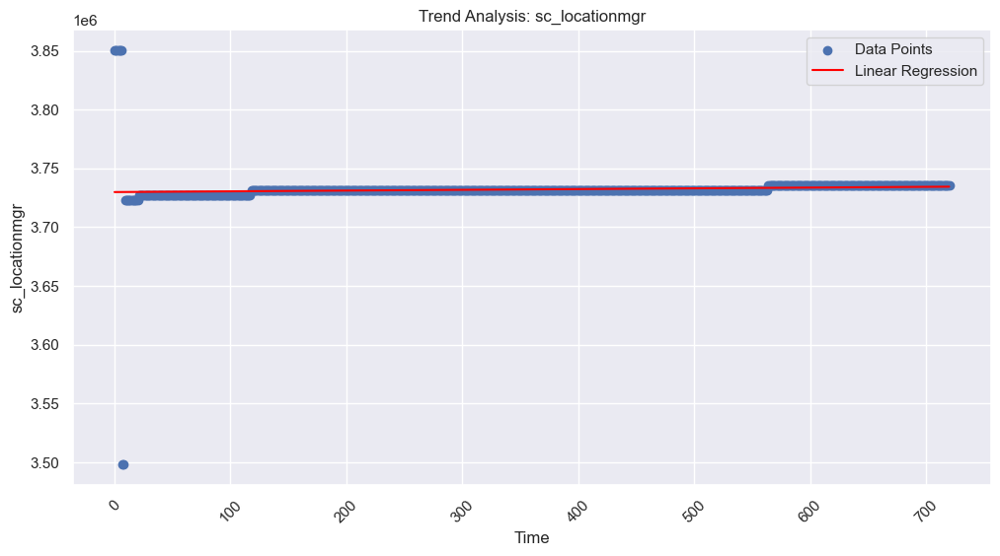

Skipping column 'sc_modem_cli' due to NaN values.


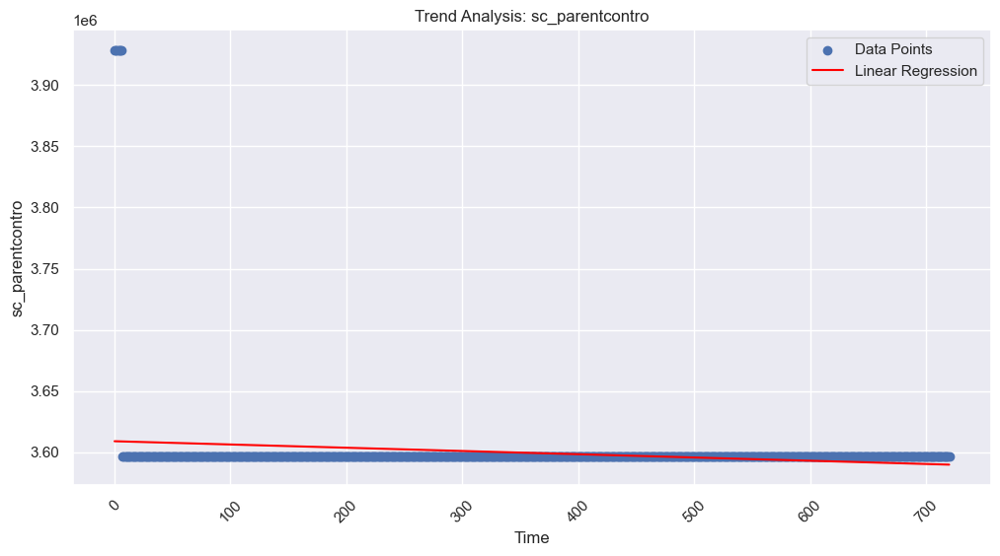

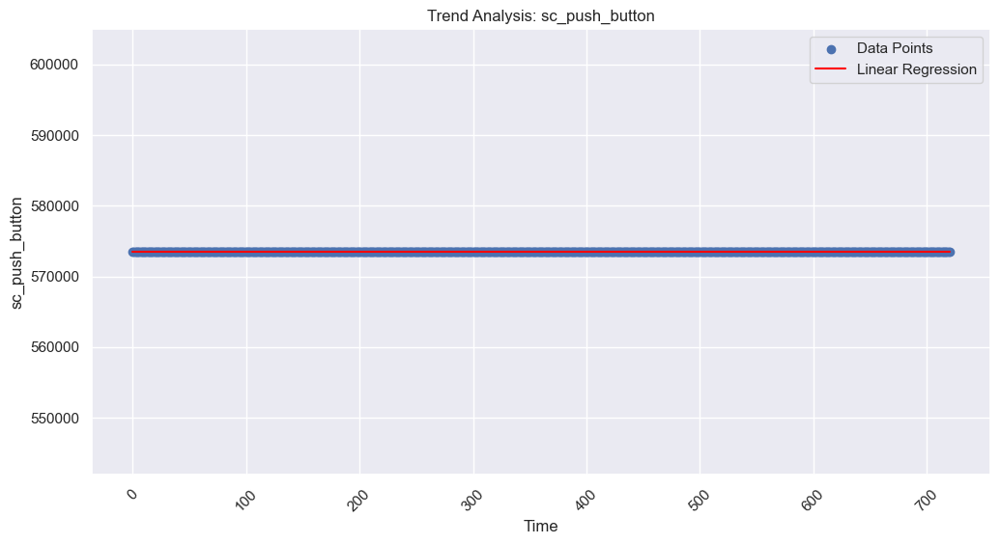

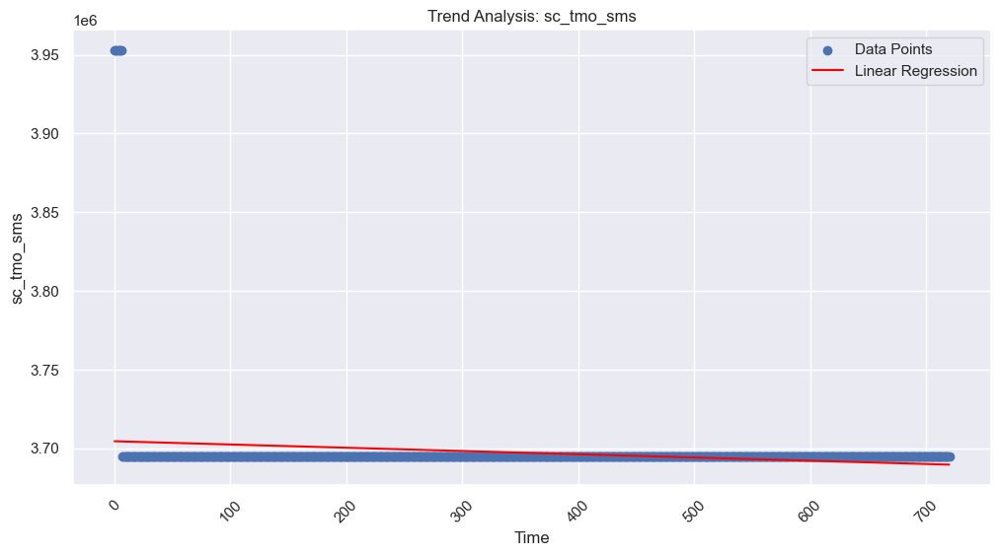

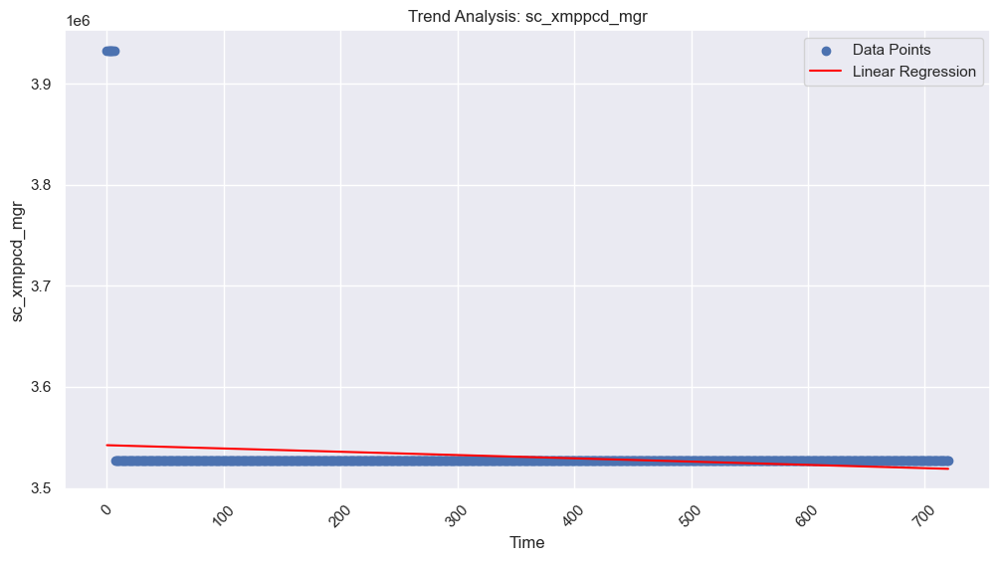

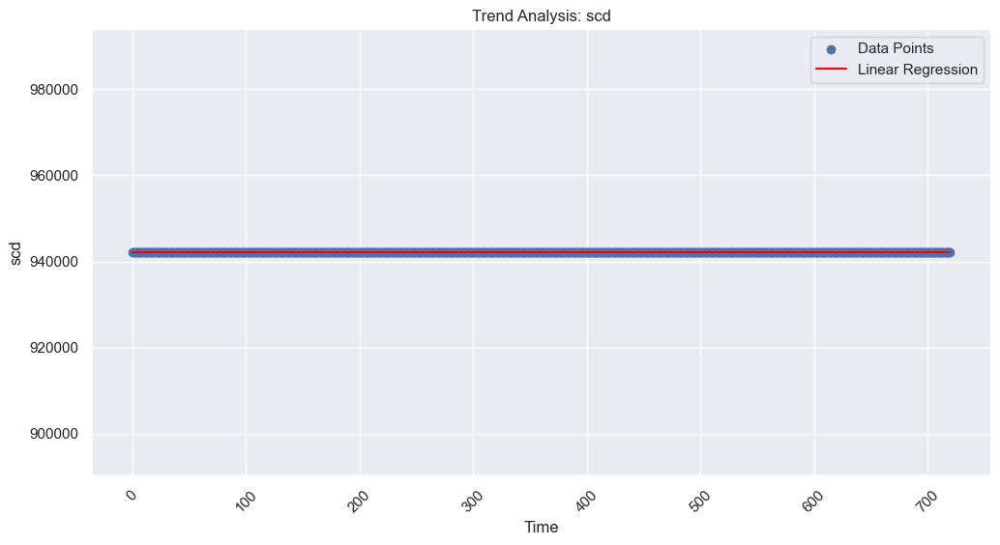

Skipping column 'sed' due to NaN values.


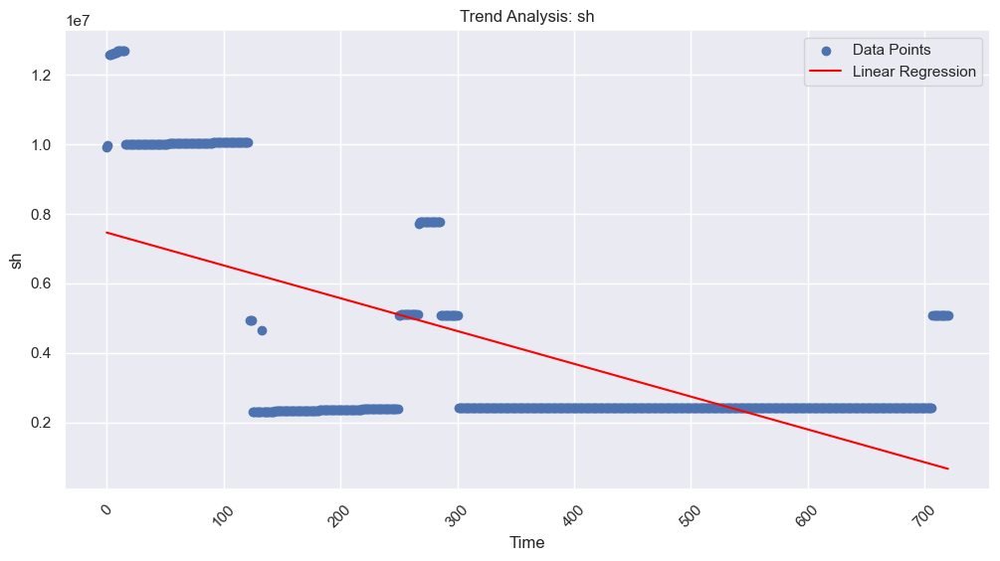

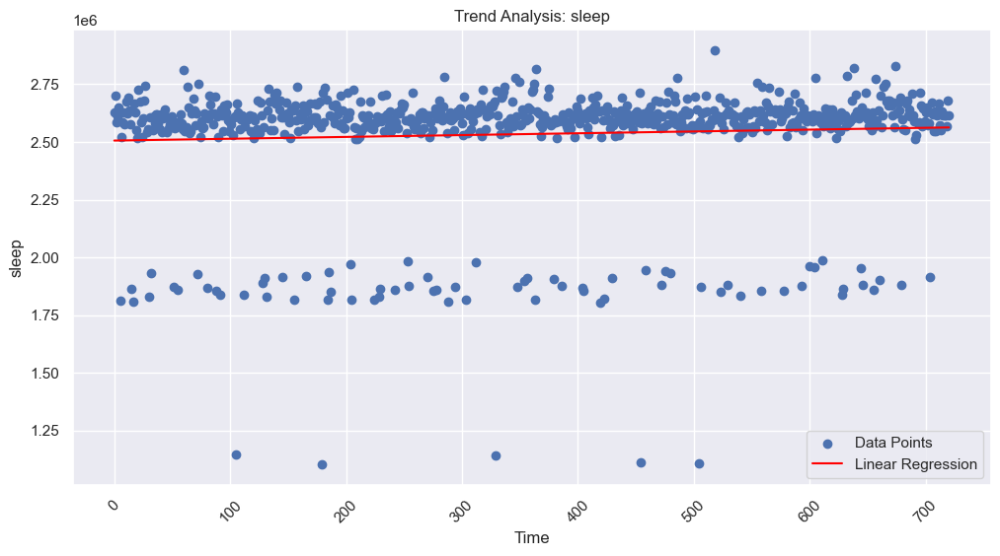

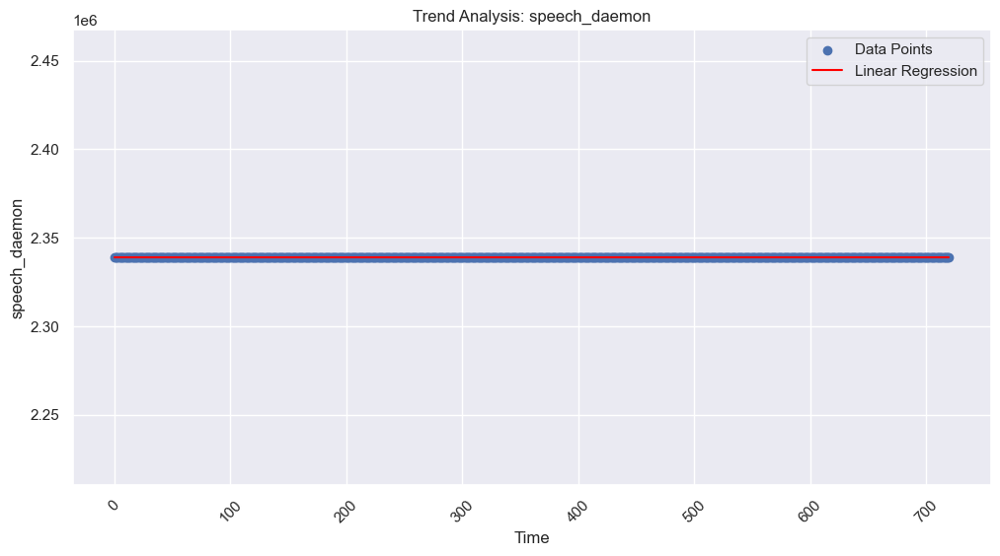

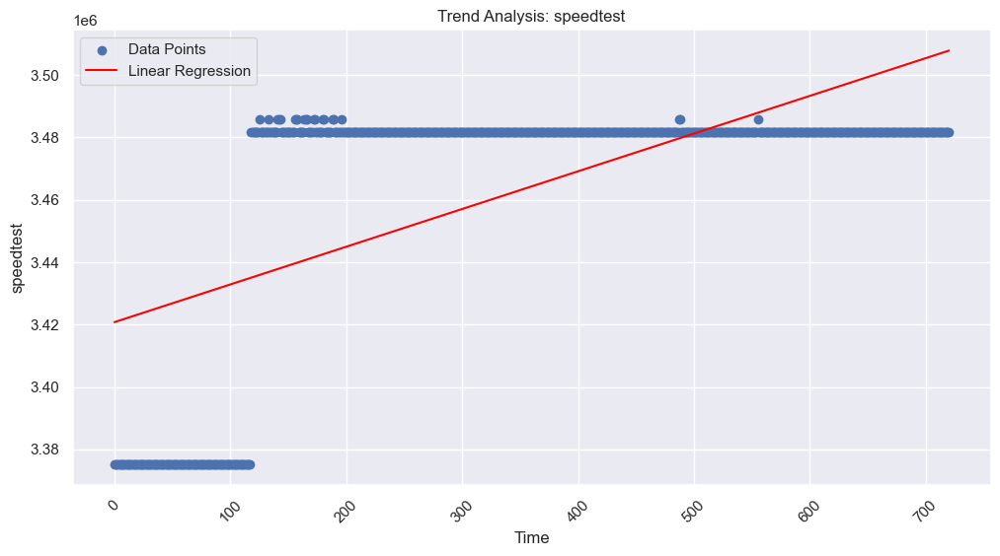

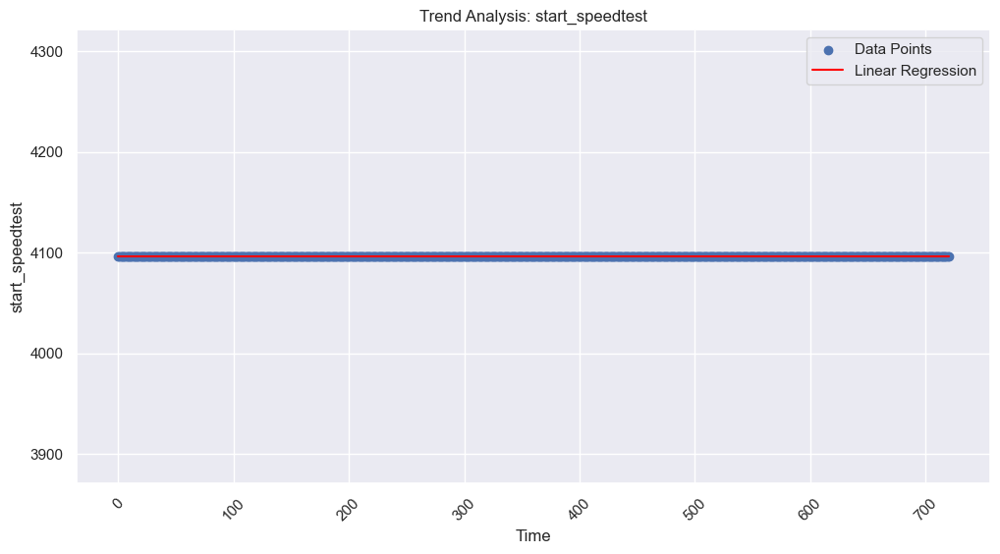

...

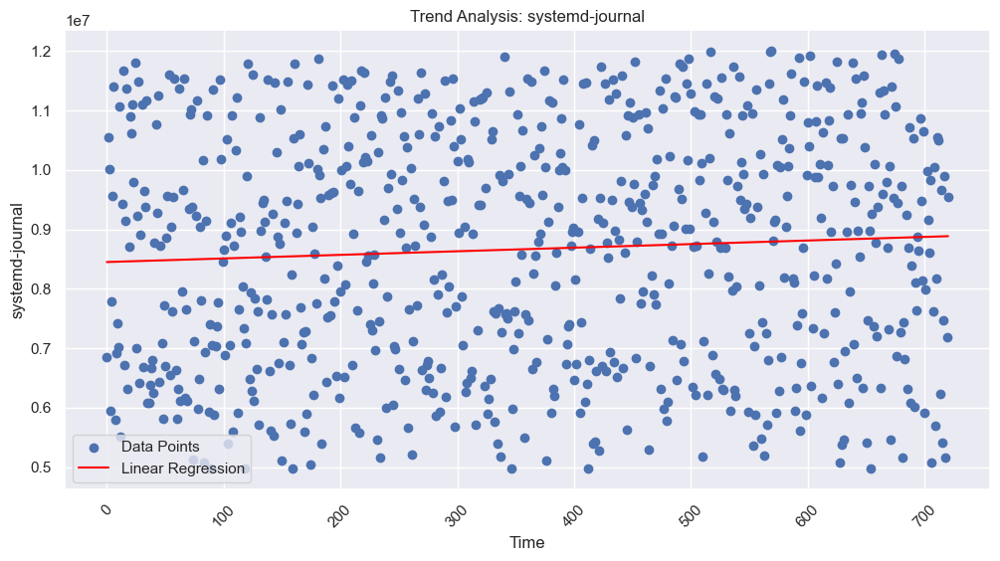

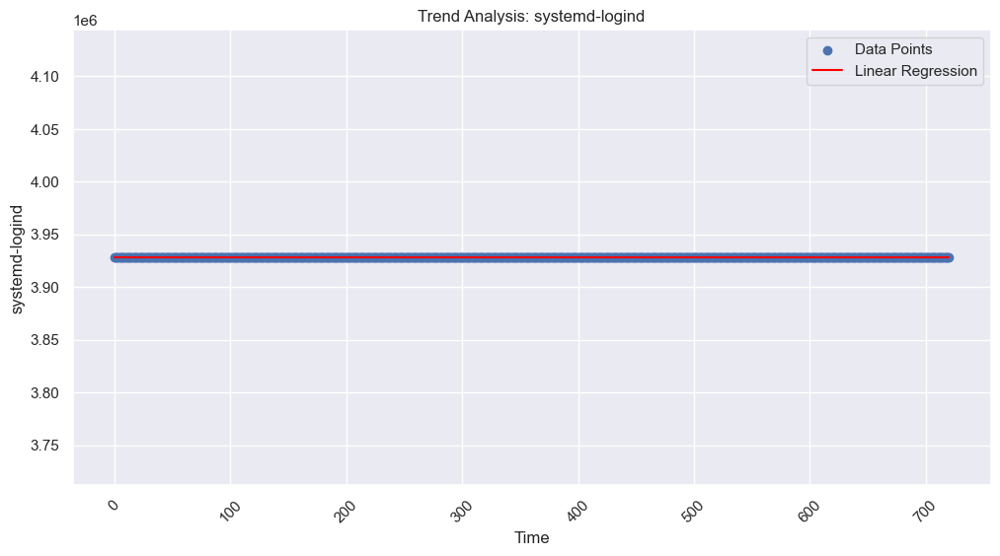

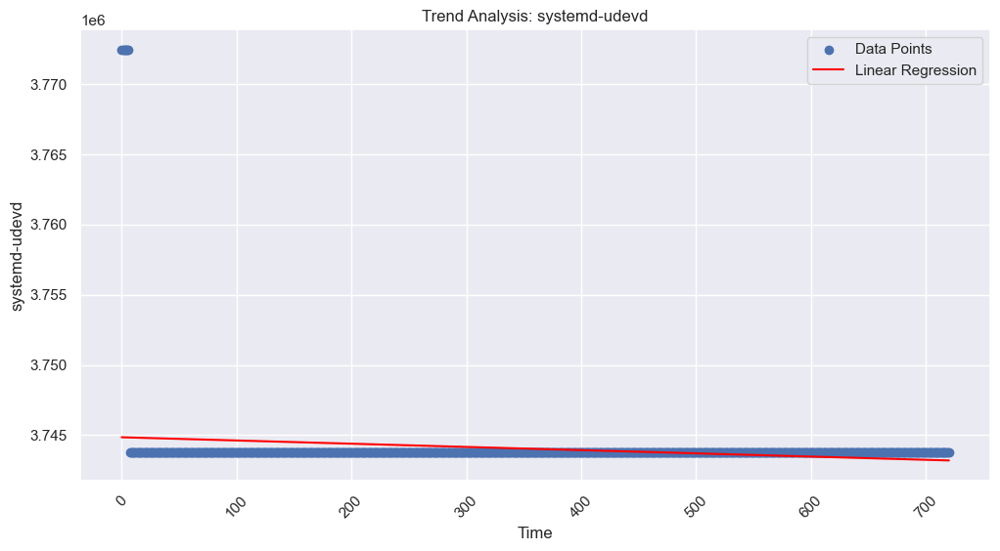

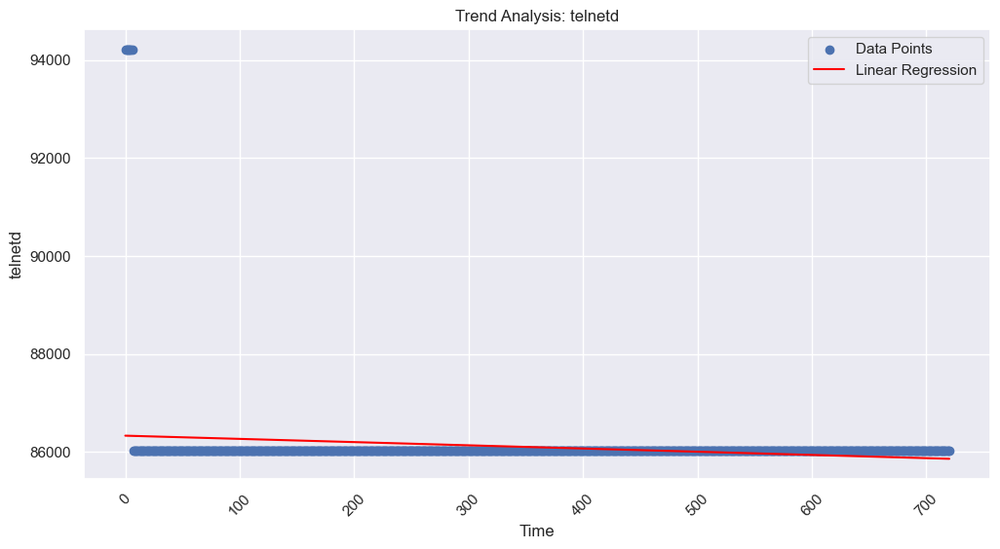

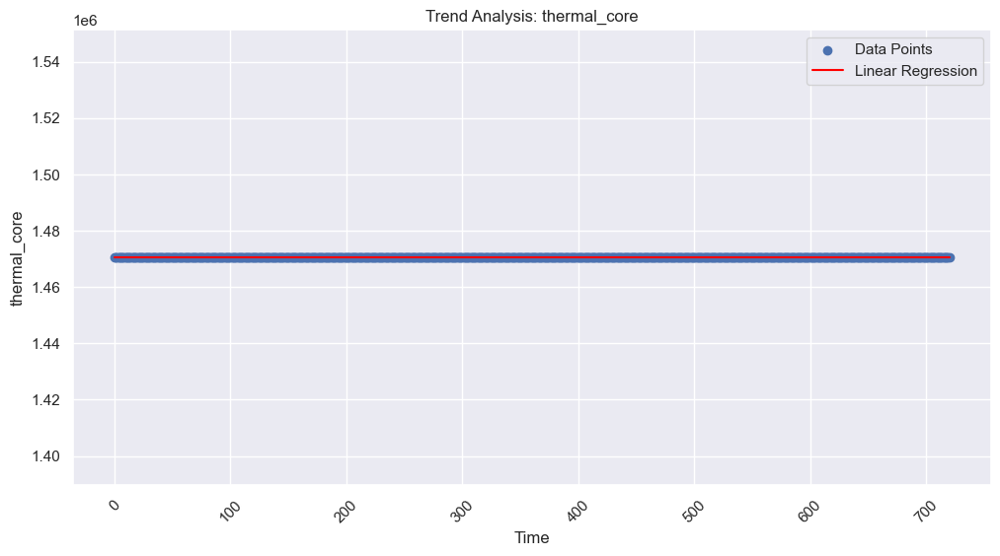

Skipping column 'timeout' due to NaN values.


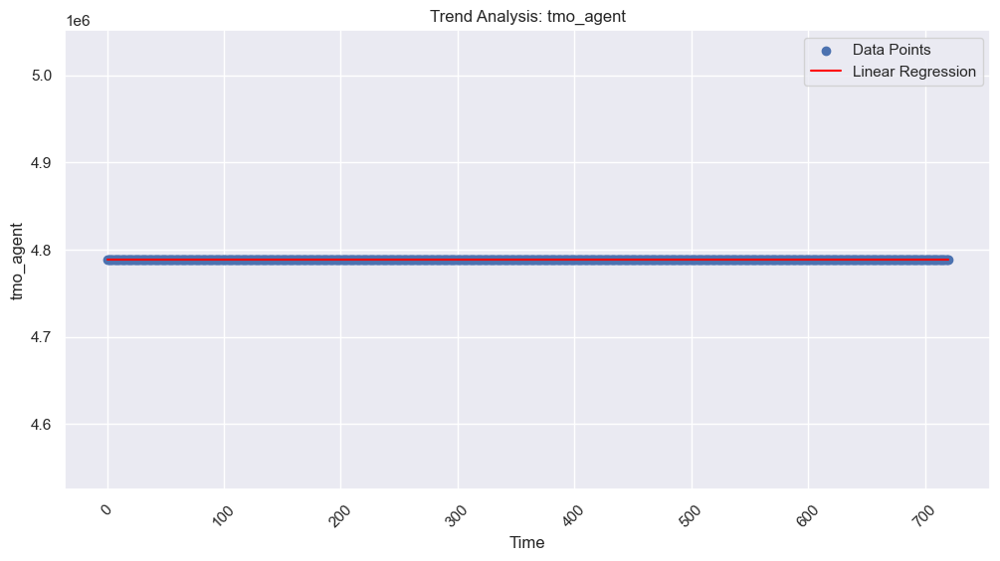

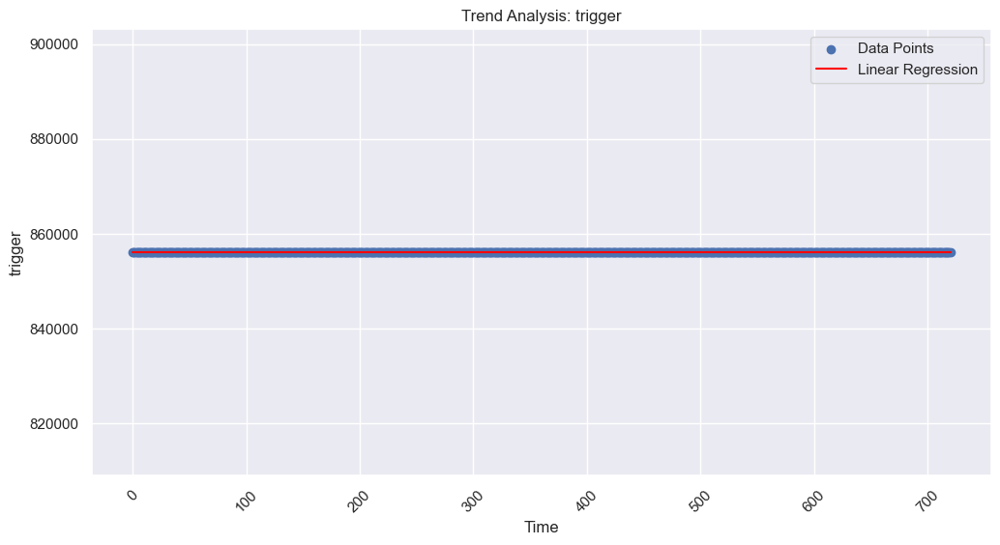

Skipping column 'uci_restful' due to NaN values.


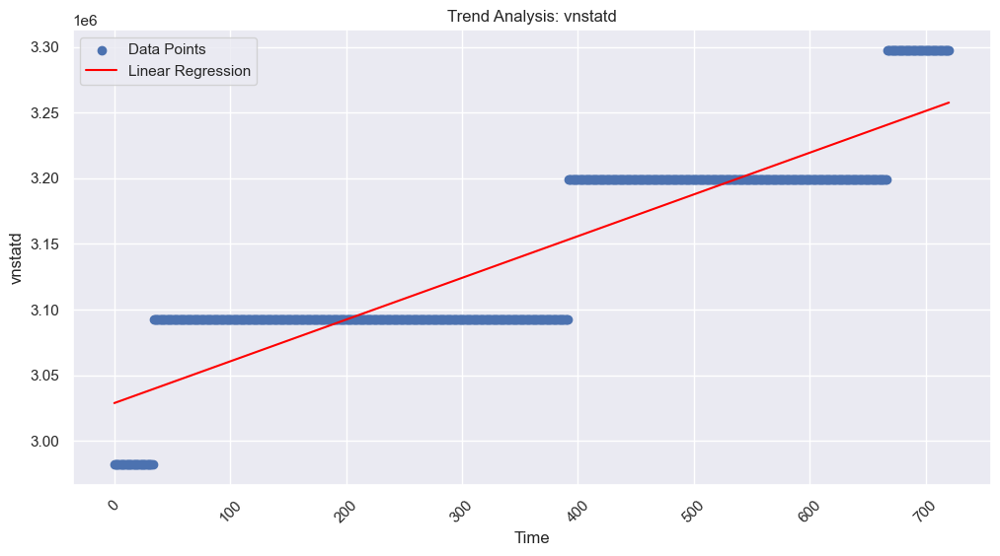

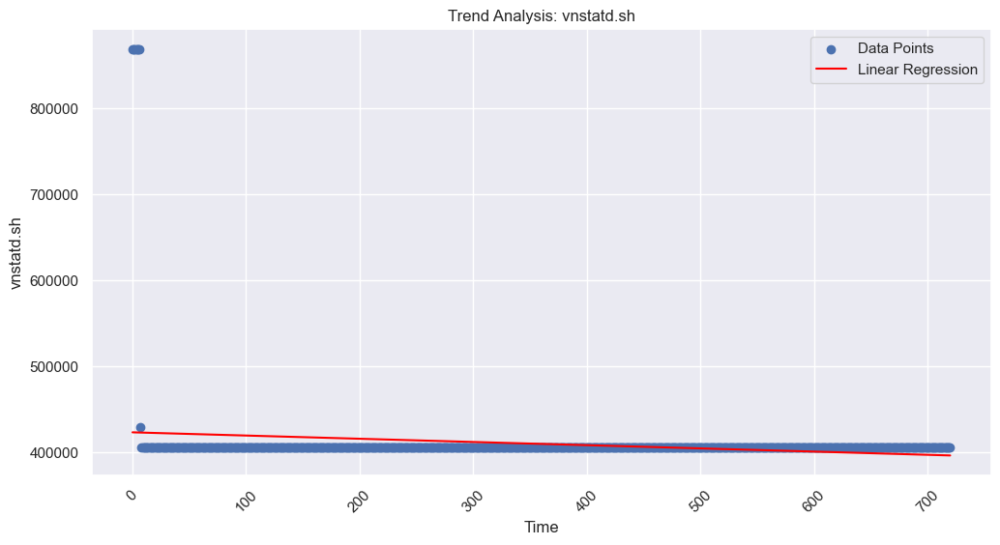

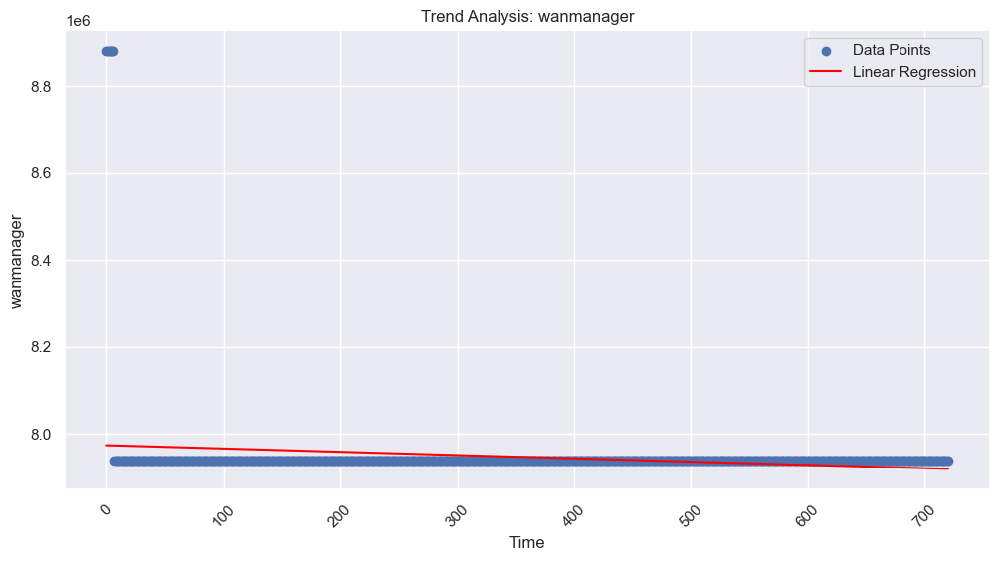

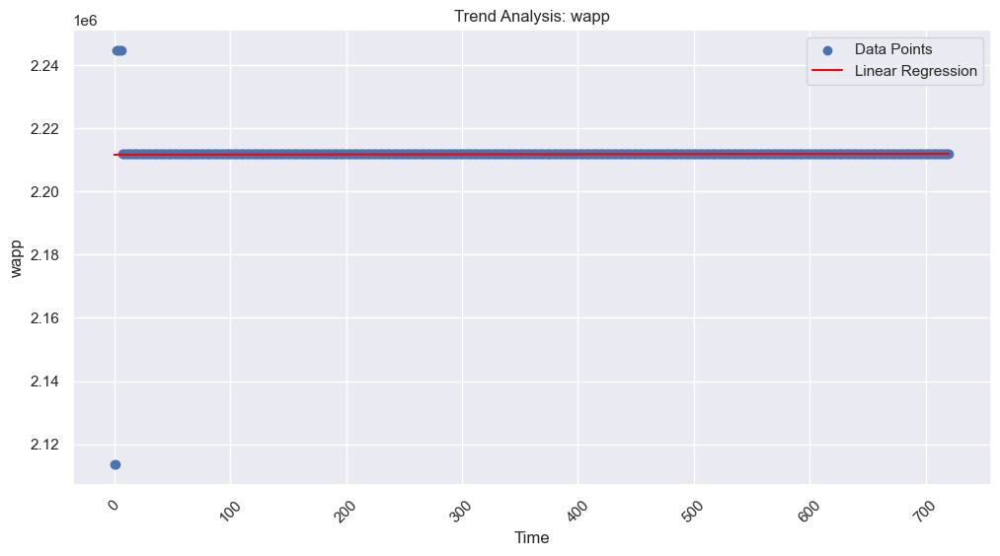

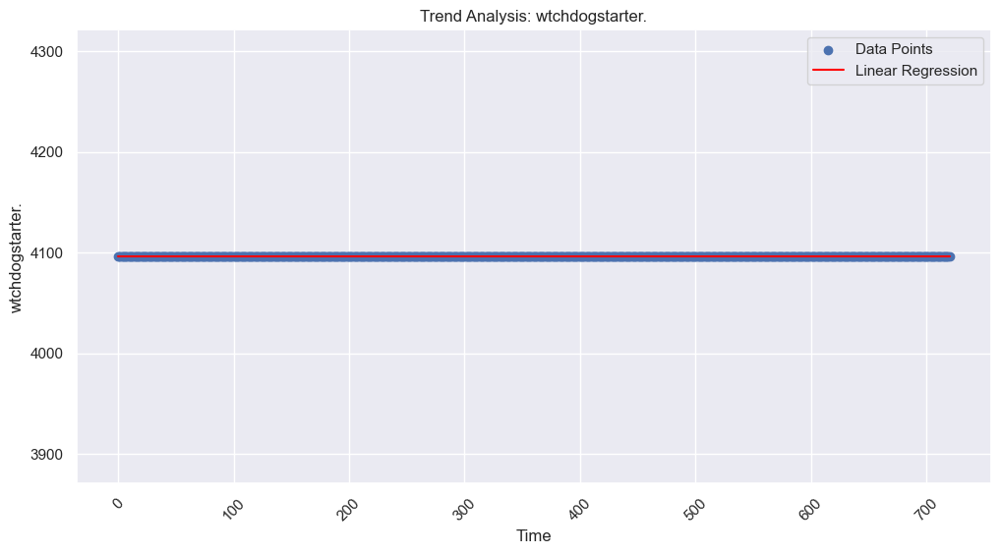

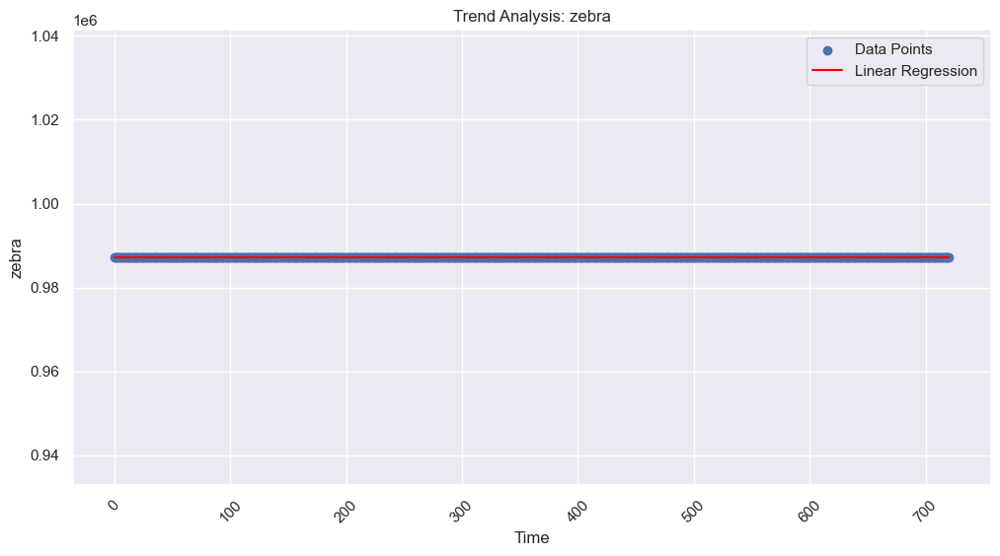

In [59]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.linear_model import LinearRegression

# Filter out columns with at least one non-empty value
non_empty_columns = df_resident_numeric.columns[df_resident_numeric.notnull().any()]

# Perform trend analysis for each non-empty column
for column in non_empty_columns:
    # Check if the column contains NaN values
    if df_resident_numeric[column].isnull().any():
        print(f"Skipping column '{column}' due to NaN values.")
        continue

    # Prepare the data for linear regression
    x = np.arange(len(df_resident_numeric))
    y = df_resident_numeric[column].values.reshape(-1, 1)

    # Create and fit the linear regression model
    model = LinearRegression()
    model.fit(x.reshape(-1, 1), y)

    # Generate the regression line
    y_pred = model.predict(x.reshape(-1, 1))

    # Plot the data points and regression line
    plt.figure(figsize=(12, 6))
    plt.scatter(x, y, label='Data Points')
    plt.plot(x, y_pred, color='red', label='Linear Regression')
    plt.title(f'Trend Analysis: {column}')
    plt.xlabel('Time')
    plt.ylabel(column)
    plt.legend()
    plt.xticks(rotation=45)
    plt.show()


In [60]:
# Iterate over each column in the dataframe
for column in df_resident.columns:
    if column == 'Time':
        continue  # Skip the 'Time' column
    
    # Calculate memory usage statistics for the column
    memory_statistics = df_resident[column].describe()
    
    # Calculate total memory usage for the column
    total_memory_usage = df_resident[column].sum()
    
    # Print column name
    print(f"Column: {column}")
    
    # Print memory usage statistics
    print(memory_statistics)
    
    # Print total memory usage
    print(f"Total Memory Usage: {total_memory_usage}\n")


Column: CcspCrSsp
count    7.210000e+02
mean     6.480826e+06
std      9.243832e+04
min      6.471680e+06
25%      6.471680e+06
50%      6.471680e+06
75%      6.471680e+06
max      7.413760e+06
Name: CcspCrSsp, dtype: float64
Total Memory Usage: 4672675840

Column: CcspEthAgent
count    7.210000e+02
mean     7.198024e+06
std      5.506108e+04
min      7.192576e+06
25%      7.192576e+06
50%      7.192576e+06
75%      7.192576e+06
max      7.753728e+06
Name: CcspEthAgent, dtype: float64
Total Memory Usage: 5189775360

Column: CcspLMLite
count    7.210000e+02
mean     8.402708e+06
std      1.151590e+05
min      8.167424e+06
25%      8.286208e+06
50%      8.388608e+06
75%      8.441856e+06
max      8.765440e+06
Name: CcspLMLite, dtype: float64
Total Memory Usage: 6058352640

Column: CcspPandMSsp
count    7.210000e+02
mean     2.024117e+07
std      1.117352e+05
min      2.020966e+07
25%      2.023014e+07
50%      2.023014e+07
75%      2.023014e+07
max      2.136883e+07
Name: CcspPandMSsp, d

Column: emdlogger1
count         721.0
mean     24109056.0
std             0.0
min      24109056.0
25%      24109056.0
50%      24109056.0
75%      24109056.0
max      24109056.0
Name: emdlogger1, dtype: float64
Total Memory Usage: 17382629376

Column: gnss_adpd
count        721.0
mean     2080768.0
std            0.0
min      2080768.0
25%      2080768.0
50%      2080768.0
75%      2080768.0
max      2080768.0
Name: gnss_adpd, dtype: float64
Total Memory Usage: 1500233728

Column: grep
count    1.000000e+01
mean     3.092890e+06
std      1.318552e+06
min      8.232960e+05
25%      1.998848e+06
50%      4.083712e+06
75%      4.083712e+06
max      4.083712e+06
Name: grep, dtype: float64
Total Memory Usage: 30928896.0

Column: jq
count          1.0
mean     2404352.0
std            NaN
min      2404352.0
25%      2404352.0
50%      2404352.0
75%      2404352.0
max      2404352.0
Name: jq, dtype: float64
Total Memory Usage: 2404352.0

Column: kcamp-agent
count    7.210000e+02
mean     1.7

In [788]:
import matplotlib.pyplot as plt

# Select the columns for analysis
columns = ['CcspPandMSsp', 'CcspWifiSsp', 'conmon', 'crio', 'dynamic_agent', 'emdlogger1', 'kcamp-agent','speedtest','systemd-journal','process-exporte','node_exporter']

# Convert the "Time" column to datetime
df_resident['Time'] = pd.to_datetime(df_resident['Time'])

# Plot the memory usage for each column
for column in columns:
    plt.figure()
    plt.plot(df_resident['Time'], df_resident[column])
    plt.xlabel('Time')
    plt.ylabel('Memory Usage')
    plt.title(f'Memory Usage - {column}')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.savefig(f'{column}_memory_usage.png')
    plt.close()

print('Memory usage plots generated successfully.')


Memory usage plots generated successfully.


C:\Users\mwj97\AppData\Local\Temp\ipykernel_45596\1605012744.py:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\mwj97\AppData\Local\Temp\ipykernel_45596\1605012744.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\mwj97\AppData\Local\Temp\ipykernel_45596\1605012744.py:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

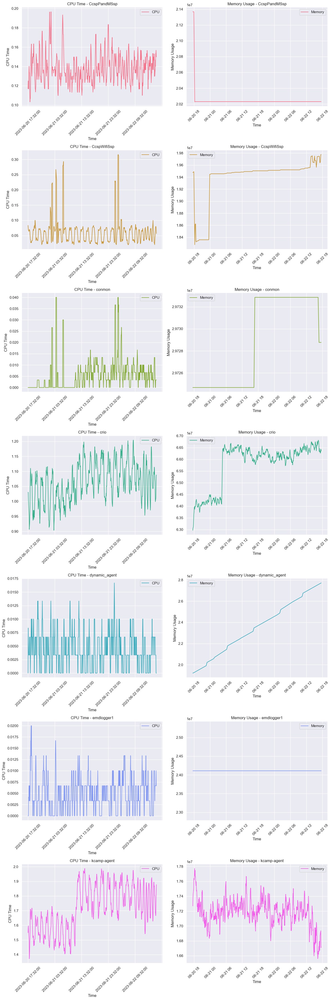

In [790]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

# Define a color palette with enough colors for each column
color_palette = sns.color_palette('husl', n_colors=len(columns_to_analyze))

# Set the figure size and adjust subplot spacing
fig, axes = plt.subplots(nrows=len(columns_to_analyze), ncols=2, figsize=(14, 6 * len(columns_to_analyze)))
plt.tight_layout()

# Plot CPU time and memory usage for each process
for i, column in enumerate(columns_to_analyze):
    # Filter the CPU data for the specific process
    df_cpu_filtered = df_cpu1[['Time', column]]
    
    # Apply moving average to CPU data
    df_cpu_filtered['Smoothed_CPU'] = df_cpu_filtered[column].rolling(window=5, min_periods=1).mean()
    
    # Plot smoothed CPU time with a different color
    ax_cpu = axes[i, 0]
    ax_cpu.plot(df_cpu_filtered['Time'], df_cpu_filtered['Smoothed_CPU'], label='CPU', color=color_palette[i])
    ax_cpu.set_xlabel('Time')
    ax_cpu.set_ylabel('CPU Time')
    ax_cpu.set_title(f'CPU Time - {column}')
    ax_cpu.legend()
    ax_cpu.tick_params(axis='x', rotation=45)  # Rotate x-axis labels
    
    # Filter the memory data for the specific process
    df_memory_filtered = df_resident[['Time', column]]
    
    # Apply moving average to memory data
    df_memory_filtered['Smoothed_Memory'] = df_memory_filtered[column].rolling(window=5, min_periods=1).mean()
    
    # Plot smoothed memory usage with a different color
    ax_memory = axes[i, 1]
    ax_memory.plot(df_memory_filtered['Time'], df_memory_filtered['Smoothed_Memory'], label='Memory', color=color_palette[i])
    ax_memory.set_xlabel('Time')
    ax_memory.set_ylabel('Memory Usage')
    ax_memory.set_title(f'Memory Usage - {column}')
    ax_memory.legend()
    ax_memory.tick_params(axis='x', rotation=45)  # Rotate x-axis labels

    # Adjust x-axis tick frequency
    ax_cpu.xaxis.set_major_locator(plt.MaxNLocator(6))  # Show maximum of 6 tick labels
    
# Adjust subplot spacing
plt.tight_layout()


In [108]:
import pandas as pd

# Group the data by IP address and WLAN
grouped_data = df_discon.groupby(['ip', 'wifi'])

# Map the IP addresses to room names
ip_to_room = {
    "192.168.10.130": "Bedroom 1",
    "192.168.10.140": "Bedroom 2",
    "192.168.10.150": "Recroom",
    "192.168.10.210": "Gallery",
    "192.168.10.220": "Kitchen",
    "192.168.10.240": "Gallery",
    "192.168.10.160": "Recroom"
}

# Analyze the behavior of each room and WLAN
room_data = []
for (ip, wlan), group in grouped_data:
    room_name = ip_to_room.get(ip, "Unknown")
    total_count = group['count'].sum()
    most_common_reason = group['reason'].value_counts().idxmax()
    room_data.append((room_name, wlan, total_count, most_common_reason))

# Create a DataFrame with the results
result_df = pd.DataFrame(room_data, columns=['Room', 'WLAN', 'Total Disconnections', 'Most Common Reason'])


In [110]:
grouped_data = df_discon.groupby(['ip', 'reason', 'description']).sum().reset_index()


C:\Users\mwj97\AppData\Local\Temp\ipykernel_45596\802508277.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [430]:
import pandas as pd

# Create a DataFrame from the resulting database
data = {
    'ip': [
        "192.168.10.130", "192.168.10.130", "192.168.10.130", "192.168.10.140",
        "192.168.10.140", "192.168.10.140", "192.168.10.140", "192.168.10.140",
        "192.168.10.150", "192.168.10.150", "192.168.10.150", "192.168.10.150",
        "192.168.10.150", "192.168.10.150", "192.168.10.150", "192.168.10.150",
        "192.168.10.160", "192.168.10.160", "192.168.10.160", "192.168.10.160",
        "192.168.10.160", "192.168.10.160", "192.168.10.160", "192.168.10.210",
        "192.168.10.210", "192.168.10.210", "192.168.10.210", "192.168.10.210",
        "192.168.10.220", "192.168.10.220", "192.168.10.220", "192.168.10.220",
        "192.168.10.220", "192.168.10.240", "192.168.10.240", "192.168.10.240",
        "192.168.10.240"
    ],
    'reason': [
        3, 15, 17, 0, 1, 3, 6, 15, 0, 1, 3, 6, 7, 15, 17, 37, 0, 1, 3, 6, 7, 15, 17, 1,
        3, 6, 15, 17, 1, 3, 6, 15, 17, 1, 3, 15, 17
    ],
    'description': [
        "Deauthenticated_because_sending_STA_is_leaving",
        "4-Way_Handshake_timeout",
        "Information_element_in_4-Way_Handshake_different",
        "None",
        "Unspecified_reason",
        "Deauthenticated_because_sending_STA_is_leaving",
        "Class_2_frame_received_from_nonauthenticated_STA",
        "4-Way_Handshake_timeout",
        "None",
        "Unspecified_reason",
        "Deauthenticated_because_sending_STA_is_leaving",
        "Class_2_frame_received_from_nonauthenticated_STA",
        "Class_3_frame_received_from_nonassociated_STA",
        "4-Way_Handshake_timeout",
        "Information_element_in_4-Way_Handshake_different",
        "Requested_from_peer_STA_as_it_does_not_want_to_use",
        "None",
        "Unspecified_reason",
        "Deauthenticated_because_sending_STA_is_leaving",
        "Class_2_frame_received_from_nonauthenticated_STA",
        "Class_3_frame_received_from_nonassociated_STA",
        "4-Way_Handshake_timeout",
        "Information_element_in_4-Way_Handshake_different",
        "Unspecified_reason",
        "Deauthenticated_because_sending_STA_is_leaving",
        "Class_2_frame_received_from_nonauthenticated_STA",
        "4-Way_Handshake_timeout",
        "Information_element_in_4-Way_Handshake_different",
        "Unspecified_reason",
        "Deauthenticated_because_sending_STA_is_leaving",
        "Class_2_frame_received_from_nonauthenticated_STA",
        "4-Way_Handshake_timeout",
        "Information_element_in_4-Way_Handshake_different",
        "Unspecified_reason",
        "Deauthenticated_because_sending_STA_is_leaving",
        "4-Way_Handshake_timeout",
        "Information_element_in_4-Way_Handshake_different"
    ]
}

df = pd.DataFrame(data)

# Define room mappings
room_mappings = {
    "192.168.10.130": "Bedroom 1",
    "192.168.10.140": "Bedroom 2",
    "192.168.10.150": "Recroom",
    "192.168.10.160": "Recroom 2",
    "192.168.10.210": "Gallery",
    "192.168.10.220": "Kitchen",
    "192.168.10.240": "Gallery 2"
}

# Map IP addresses to room names
df['room'] = df['ip'].map(room_mappings)

# Group by room, IP, reason, and description, and calculate the count
grouped_df = df.groupby(['room', 'ip', 'reason', 'description']).size().reset_index(name='count')



In [117]:
grouped_df

,room,ip,reason,description,count
0,Bedroom 1,192.168.10.130,3,Deauthenticated_because_sending_STA_is_leaving,1
1,Bedroom 1,192.168.10.130,15,4-Way_Handshake_timeout,1
2,Bedroom 1,192.168.10.130,17,Information_element_in_4-Way_Handshake_different,1
3,Bedroom 2,192.168.10.140,0,None,1
4,Bedroom 2,192.168.10.140,1,Unspecified_reason,1
5,Bedroom 2,192.168.10.140,3,Deauthenticated_because_sending_STA_is_leaving,1
6,Bedroom 2,192.168.10.140,6,Class_2_frame_received_from_nonauthenticated_STA,1
7,Bedroom 2,192.168.10.140,15,4-Way_Handshake_timeout,1
8,Gallery,192.168.10.210,1,Unspecified_reason,1
9,Gallery,192.168.10.210,3,Deauthenticated_because_sending_STA_is_leaving,1


In [647]:
# Remove ":9100" from each column name in df_net_receive
df_net_receive.columns = df_net_receive.columns.str.replace(":9100", "")

# Remove "wlan0" from the column name for 192.168.10.150
df_net_receive.rename(columns={ "192.168.10.150: wlan0" : "192.168.10.150" }, inplace=True)

# Create separate dataframes for each room, set 'Time' as the index, and drop missing values
df_bedroom1 = df_net_receive[['Time'] + [f'192.168.10.130 wlan{i}' for i in range(1, 8)]]
df_bedroom2 = df_net_receive[['Time'] + [f'192.168.10.140 wlan{i}' for i in range(1, 8)]]
df_recroom1 = df_net_receive[['Time'] + [f'192.168.10.150 wlan{i}' for i in range(1, 8)]]
df_recroom2 = df_net_receive[['Time'] + [f'192.168.10.160 wlan{i}' for i in range(1, 8)]]
df_gallery1 = df_net_receive[['Time'] + [f'192.168.10.210 wlan{i}' for i in range(1, 8)]]
df_kitchen = df_net_receive[['Time'] + [f'192.168.10.220 wlan{i}' for i in range(1, 8)]]
df_gallery2 = df_net_receive[['Time'] + [f'192.168.10.240 wlan{i}' for i in range(1, 8)]]


In [648]:
df_bedroom1_net = df_bedroom1.rename(columns=lambda x: f"net_{x}" if x != "Time" else x)
df_bedroom2_net = df_bedroom2.rename(columns=lambda x: f"net_{x}" if x != "Time" else x)
df_recroom1_net = df_recroom1.rename(columns=lambda x: f"net_{x}" if x != "Time" else x)
df_recroom2_net = df_recroom2.rename(columns=lambda x: f"net_{x}" if x != "Time" else x)
df_gallery1_net = df_gallery1.rename(columns=lambda x: f"net_{x}" if x != "Time" else x)
df_kitchen_net = df_kitchen.rename(columns=lambda x: f"net_{x}" if x != "Time" else x)
df_gallery2_net = df_gallery2.rename(columns=lambda x: f"net_{x}" if x != "Time" else x)


In [391]:
df_bedroom1_net = df_bedroom1_net.iloc[1:-1]
df_bedroom2_net = df_bedroom2_net.iloc[1:-1]
df_recroom1_net = df_recroom1_net.iloc[1:-1]
df_recroom2_net = df_recroom2_net.iloc[1:-1]
df_gallery1_net = df_gallery1_net.iloc[1:-1]
df_kitchen_net = df_kitchen_net.iloc[1:-1]
df_gallery2_net = df_gallery2_net.iloc[1:-1]


In [393]:
# Create separate dataframes for each room, set 'Time' as the index, and drop missing values
df_bedroom1 = df_signal[['Time'] + [f'192.168.10.130 wlan{i}' for i in range(1, 8)]]
df_bedroom2 = df_signal[['Time'] + [f'192.168.10.140 wlan{i}' for i in range(1, 8)]]
df_recroom1 = df_signal[['Time'] + [f'192.168.10.150 wlan{i}' for i in range(1, 8)]]
df_recroom2 = df_signal[['Time'] + [f'192.168.10.160 wlan{i}' for i in range(1, 8)]]
df_gallery1 = df_signal[['Time'] + [f'192.168.10.210 wlan{i}' for i in range(1, 8)]]
df_kitchen = df_signal[['Time'] + [f'192.168.10.220 wlan{i}' for i in range(1, 8)]]
df_gallery2 = df_signal[['Time'] + [f'192.168.10.240 wlan{i}' for i in range(1, 8)]]


In [394]:
df_bedroom1_signal = df_bedroom1.rename(columns=lambda x: f"signal_{x}" if x != "Time" else x)
df_bedroom2_signal = df_bedroom2.rename(columns=lambda x: f"signal_{x}" if x != "Time" else x)
df_recroom1_signal = df_recroom1.rename(columns=lambda x: f"signal_{x}" if x != "Time" else x)
df_recroom2_signal = df_recroom2.rename(columns=lambda x: f"signal_{x}" if x != "Time" else x)
df_gallery1_signal = df_gallery1.rename(columns=lambda x: f"signal_{x}" if x != "Time" else x)
df_kitchen_signal = df_kitchen.rename(columns=lambda x: f"signal_{x}" if x != "Time" else x)
df_gallery2_signal = df_gallery2.rename(columns=lambda x: f"signal_{x}" if x != "Time" else x)


In [395]:
df_bedroom1_signal = df_bedroom1_signal.iloc[:-2]
df_bedroom2_signal = df_bedroom2_signal.iloc[:-2]
df_recroom1_signal = df_recroom1_signal.iloc[:-2]
df_recroom2_signal = df_recroom2_signal.iloc[:-2]
df_gallery1_signal = df_gallery1_signal.iloc[:-2]
df_kitchen_signal = df_kitchen_signal.iloc[:-2]
df_gallery2_signal = df_gallery2_signal.iloc[:-2]


In [397]:
df_bedroom1_signal['Time'] = pd.to_datetime(df_bedroom1_signal['Time']).dt.strftime('%m/%d/%y %H:%M')
df_bedroom2_signal['Time'] = pd.to_datetime(df_bedroom2_signal['Time']).dt.strftime('%m/%d/%y %H:%M')
df_recroom1_signal['Time'] = pd.to_datetime(df_recroom1_signal['Time']).dt.strftime('%m/%d/%y %H:%M')
df_recroom2_signal['Time'] = pd.to_datetime(df_recroom2_signal['Time']).dt.strftime('%m/%d/%y %H:%M')
df_gallery1_signal['Time'] = pd.to_datetime(df_gallery1_signal['Time']).dt.strftime('%m/%d/%y %H:%M')
df_kitchen_signal['Time'] = pd.to_datetime(df_kitchen_signal['Time']).dt.strftime('%m/%d/%y %H:%M')
df_gallery2_signal['Time'] = pd.to_datetime(df_gallery2_signal['Time']).dt.strftime('%m/%d/%y %H:%M')

In [400]:
df_bedroom1 = df_bedroom1_net.merge(df_bedroom1_signal, on='Time')
df_bedroom2 = df_bedroom2_net.merge(df_bedroom2_signal, on='Time')
df_recroom1 = df_recroom1_net.merge(df_recroom1_signal, on='Time')
df_recroom2 = df_recroom2_net.merge(df_recroom2_signal, on='Time')
df_gallery1 = df_gallery1_net.merge(df_gallery1_signal, on='Time')
df_kitchen = df_kitchen_net.merge(df_kitchen_signal, on='Time')
df_gallery2 = df_gallery2_net.merge(df_gallery2_signal, on='Time')


In [402]:
df_bedroom1_net['Time'] = pd.to_datetime(df_bedroom1_net['Time'], format='%m/%d/%y %H:%M')
df_bedroom1_signal['Time'] = pd.to_datetime(df_bedroom1_signal['Time'], format='%m/%d/%y %H:%M')

df_bedroom1 = df_bedroom1_net.merge(df_bedroom1_signal, on='Time', how='inner')


In [404]:
df_bedroom1.set_index('Time', inplace=True)


In [406]:
import pandas as pd

wlan_columns = ['signal_192.168.10.130 wlan1', 'signal_192.168.10.130 wlan2', 'signal_192.168.10.130 wlan3',
                'signal_192.168.10.130 wlan4', 'signal_192.168.10.130 wlan5', 'signal_192.168.10.130 wlan6',
                'signal_192.168.10.130 wlan7', 'net_192.168.10.130 wlan1', 'net_192.168.10.130 wlan2',
                'net_192.168.10.130 wlan3', 'net_192.168.10.130 wlan4', 'net_192.168.10.130 wlan5',
                'net_192.168.10.130 wlan6', 'net_192.168.10.130 wlan7']

# Create a new DataFrame with the selected columns
df_interaction = df_bedroom1[wlan_columns]

# Calculate the correlation matrix
correlation_matrix = df_interaction.corr()

# Print the correlation matrix
print(correlation_matrix)


                             signal_192.168.10.130 wlan1  \
signal_192.168.10.130 wlan1                     1.000000   
signal_192.168.10.130 wlan2                     0.148707   
signal_192.168.10.130 wlan3                    -0.049290   
signal_192.168.10.130 wlan4                     0.545057   
signal_192.168.10.130 wlan5                     0.360156   
signal_192.168.10.130 wlan6                     0.233790   
signal_192.168.10.130 wlan7                     0.237869   
net_192.168.10.130 wlan1                       -0.123594   
net_192.168.10.130 wlan2                       -0.155164   
net_192.168.10.130 wlan3                       -0.228540   
net_192.168.10.130 wlan4                       -0.207172   
net_192.168.10.130 wlan5                       -0.215684   
net_192.168.10.130 wlan6                       -0.150148   
net_192.168.10.130 wlan7                       -0.241026   

                             signal_192.168.10.130 wlan2  \
signal_192.168.10.130 wlan1            

In [407]:
import pandas as pd

# Select the columns for WLAN 1 signal and net receive data
wlan1_signal = 'signal_192.168.10.130 wlan1'
wlan1_net = 'net_192.168.10.130 wlan1'

# Create a new DataFrame with the selected columns
df_wlan1 = df_bedroom1[[wlan1_signal, wlan1_net]]

# Calculate the correlation between signal and net receive data
correlation = df_wlan1.corr()

# Print the correlation
print(correlation)


                             signal_192.168.10.130 wlan1  \
signal_192.168.10.130 wlan1                     1.000000   
net_192.168.10.130 wlan1                       -0.123594   

                             net_192.168.10.130 wlan1  
signal_192.168.10.130 wlan1                 -0.123594  
net_192.168.10.130 wlan1                     1.000000  


In [408]:
import pandas as pd

# Select the columns for signal and net receive data
signal_columns = [col for col in df_bedroom1.columns if col.startswith('signal')]
net_columns = [col for col in df_bedroom1.columns if col.startswith('net')]

# Calculate correlation for each client and corresponding WLAN
correlations = {}
for signal_col, net_col in zip(signal_columns, net_columns):
    client = signal_col.split(' ')[1]
    correlation = df_bedroom1[[signal_col, net_col]].corr().iloc[0, 1]
    correlations[client] = correlation

# Print the correlations
for client, correlation in correlations.items():
    print(f"Correlation for WLAN {client}: {correlation}")


Correlation for WLAN wlan1: -0.1235944316386877
Correlation for WLAN wlan2: -0.11718084543159939
Correlation for WLAN wlan3: 0.3273009890249589
Correlation for WLAN wlan4: -0.22368585215656725
Correlation for WLAN wlan5: -0.19745748812473746
Correlation for WLAN wlan6: -0.0662573460320886
Correlation for WLAN wlan7: -0.20291136736561505


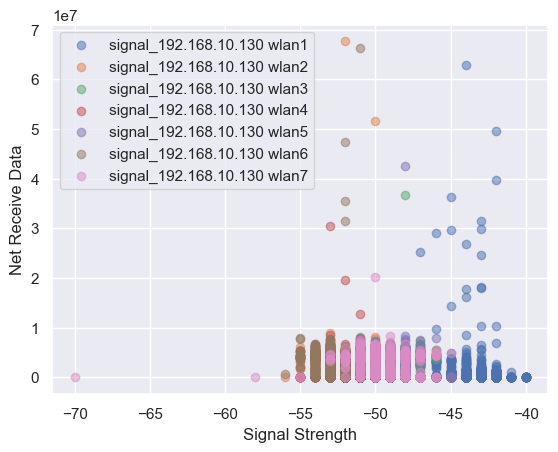

In [409]:
import matplotlib.pyplot as plt

# Define the signal and net column names
signal_columns = ['signal_192.168.10.130 wlan1', 'signal_192.168.10.130 wlan2', 'signal_192.168.10.130 wlan3',
                  'signal_192.168.10.130 wlan4', 'signal_192.168.10.130 wlan5', 'signal_192.168.10.130 wlan6',
                  'signal_192.168.10.130 wlan7']
net_columns = ['net_192.168.10.130 wlan1', 'net_192.168.10.130 wlan2', 'net_192.168.10.130 wlan3',
               'net_192.168.10.130 wlan4', 'net_192.168.10.130 wlan5', 'net_192.168.10.130 wlan6',
               'net_192.168.10.130 wlan7']

# Create a scatter plot for each WLAN
for signal_col, net_col in zip(signal_columns, net_columns):
    plt.scatter(df_bedroom1[signal_col], df_bedroom1[net_col], alpha=0.5, label=signal_col)

# Add labels and legend
plt.xlabel('Signal Strength')
plt.ylabel('Net Receive Data')
plt.legend()

# Show the plot
plt.show()


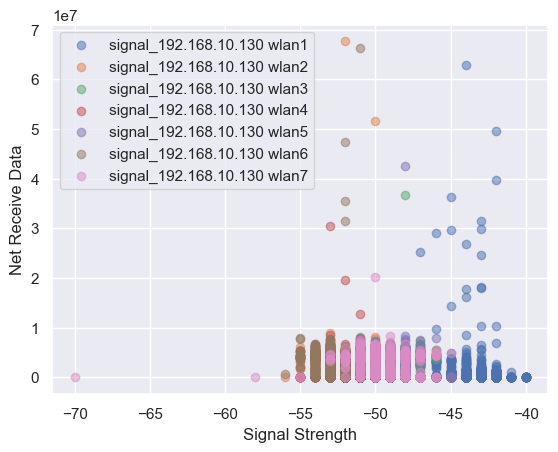

In [410]:
import matplotlib.pyplot as plt

# Define the signal and net column names
signal_columns = ['signal_192.168.10.130 wlan1', 'signal_192.168.10.130 wlan2', 'signal_192.168.10.130 wlan3',
                  'signal_192.168.10.130 wlan4', 'signal_192.168.10.130 wlan5', 'signal_192.168.10.130 wlan6',
                  'signal_192.168.10.130 wlan7']
net_columns = ['net_192.168.10.130 wlan1', 'net_192.168.10.130 wlan2', 'net_192.168.10.130 wlan3',
               'net_192.168.10.130 wlan4', 'net_192.168.10.130 wlan5', 'net_192.168.10.130 wlan6',
               'net_192.168.10.130 wlan7']

# Create a scatter plot for each WLAN
for signal_col, net_col in zip(signal_columns, net_columns):
    plt.scatter(df_bedroom1[signal_col], df_bedroom1[net_col], alpha=0.5, label=signal_col)

# Add labels and legend
plt.xlabel('Signal Strength')
plt.ylabel('Net Receive Data')
plt.legend()

# Show the plot
plt.show()


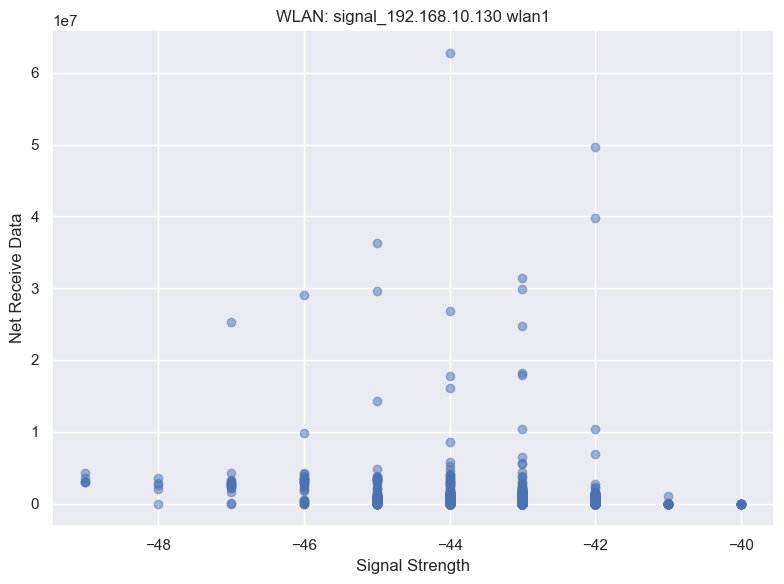

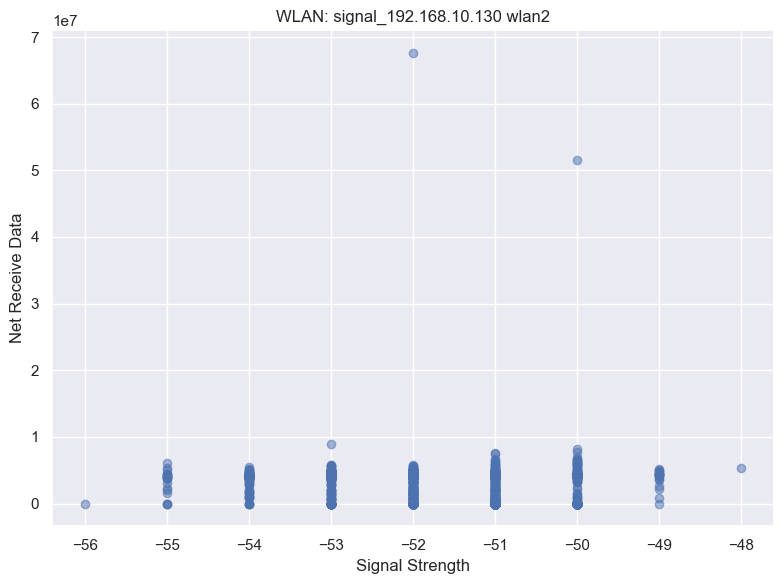

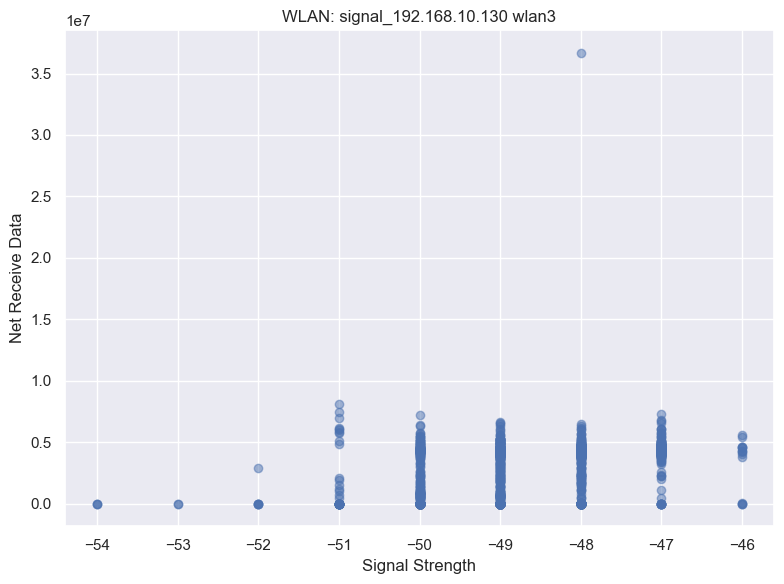

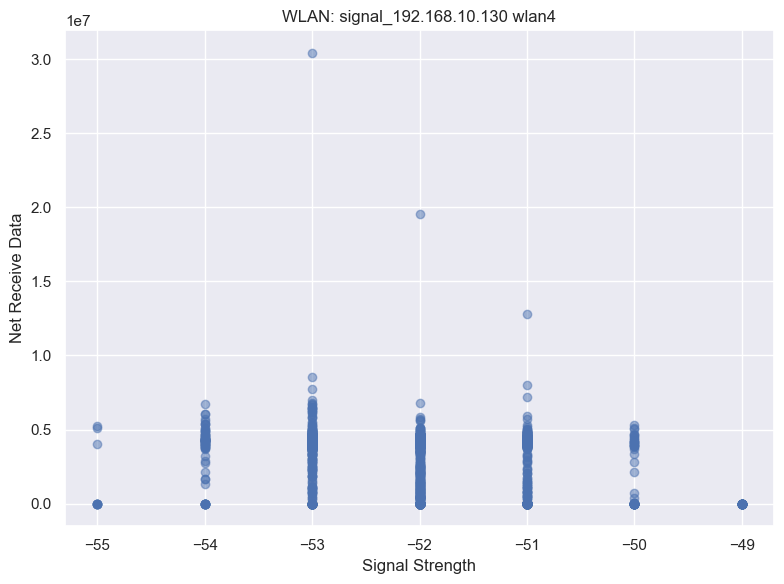

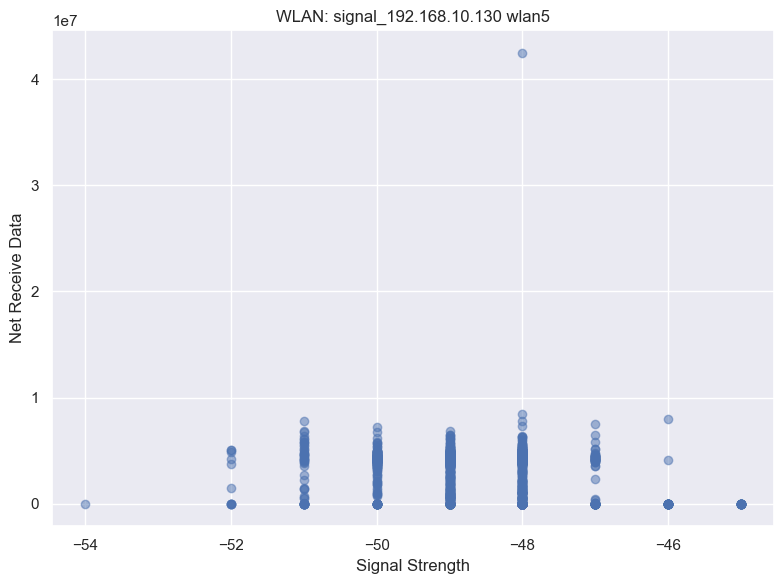

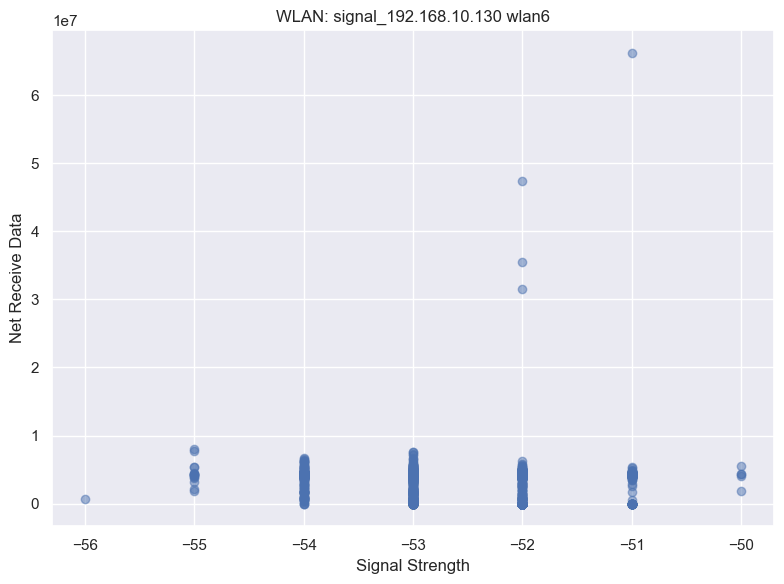

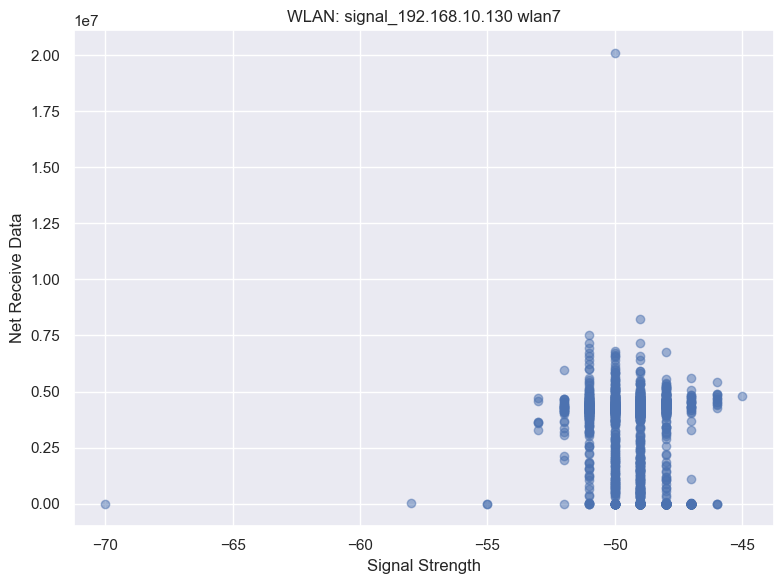

In [413]:
import matplotlib.pyplot as plt

# Define the signal and net column names
signal_columns = ['signal_192.168.10.130 wlan1', 'signal_192.168.10.130 wlan2', 'signal_192.168.10.130 wlan3',
                  'signal_192.168.10.130 wlan4', 'signal_192.168.10.130 wlan5', 'signal_192.168.10.130 wlan6',
                  'signal_192.168.10.130 wlan7']
net_columns = ['net_192.168.10.130 wlan1', 'net_192.168.10.130 wlan2', 'net_192.168.10.130 wlan3',
               'net_192.168.10.130 wlan4', 'net_192.168.10.130 wlan5', 'net_192.168.10.130 wlan6',
               'net_192.168.10.130 wlan7']

# Create a scatter plot for each WLAN
for signal_col, net_col in zip(signal_columns, net_columns):
    plt.figure(figsize=(8, 6))
    plt.scatter(df_bedroom1[signal_col], df_bedroom1[net_col], alpha=0.5)
    plt.xlabel('Signal Strength')
    plt.ylabel('Net Receive Data')
    plt.title(f'WLAN: {signal_col}')
    plt.tight_layout()
    plt.show()


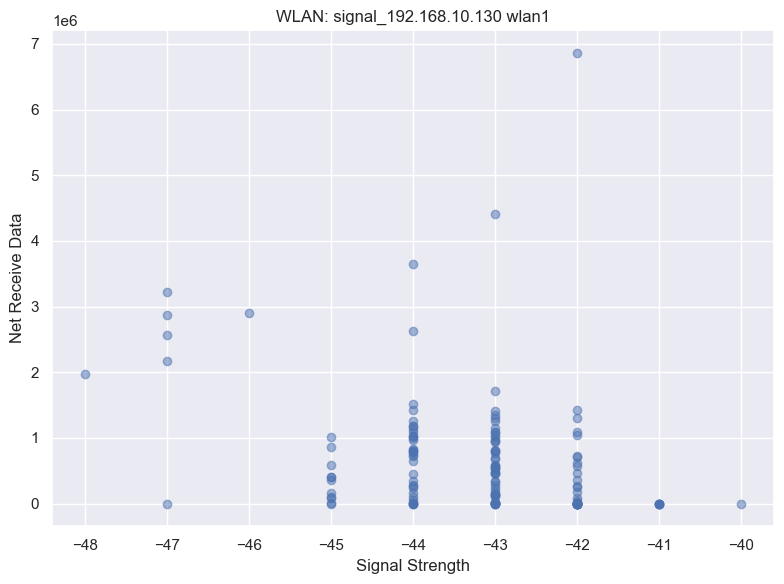

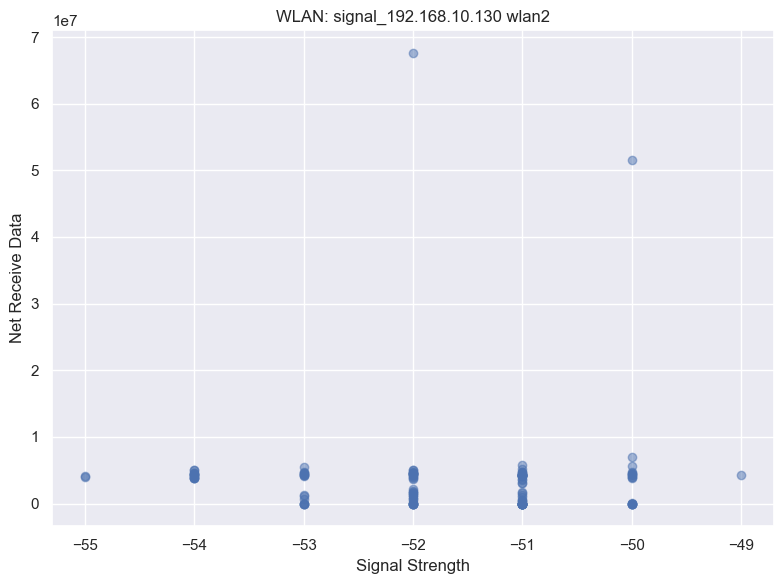

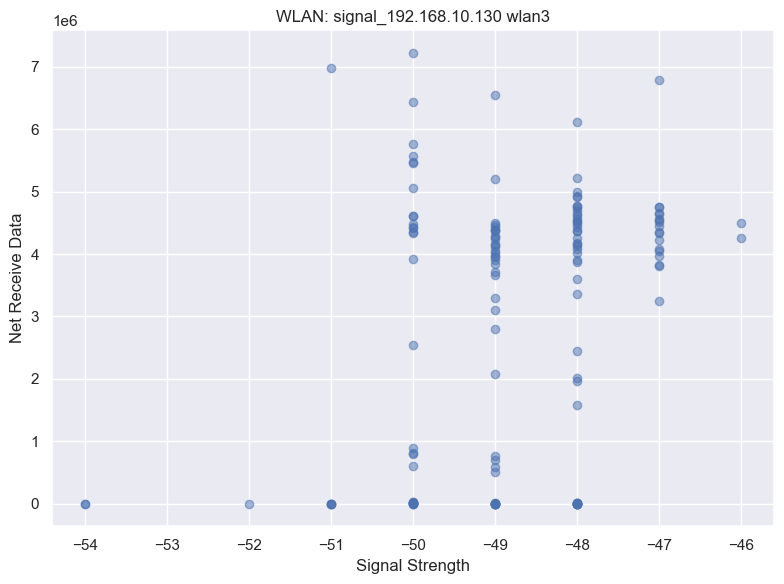

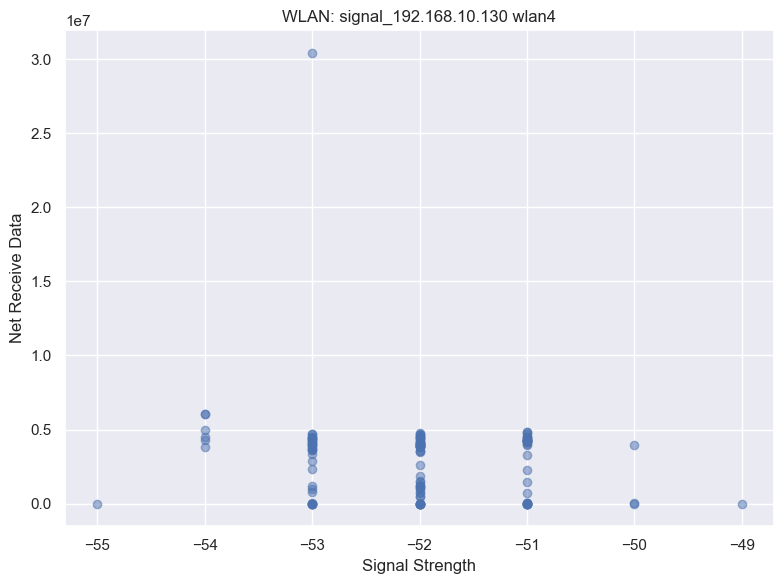

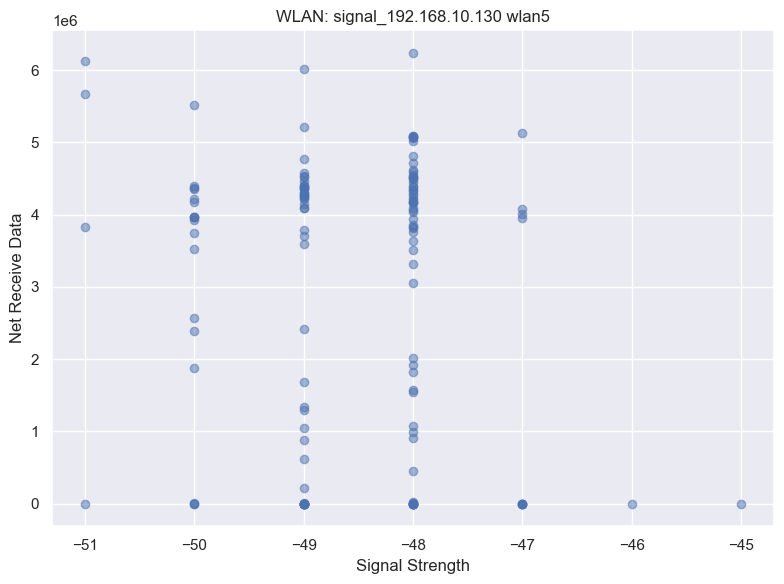

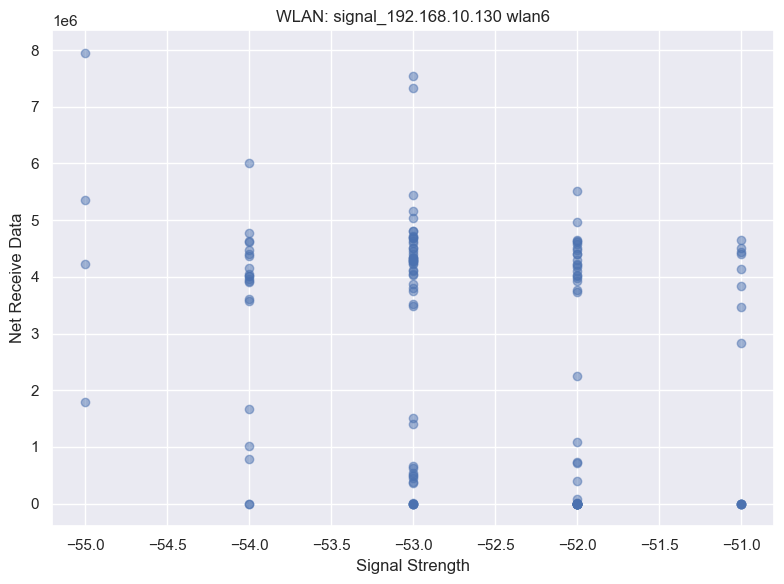

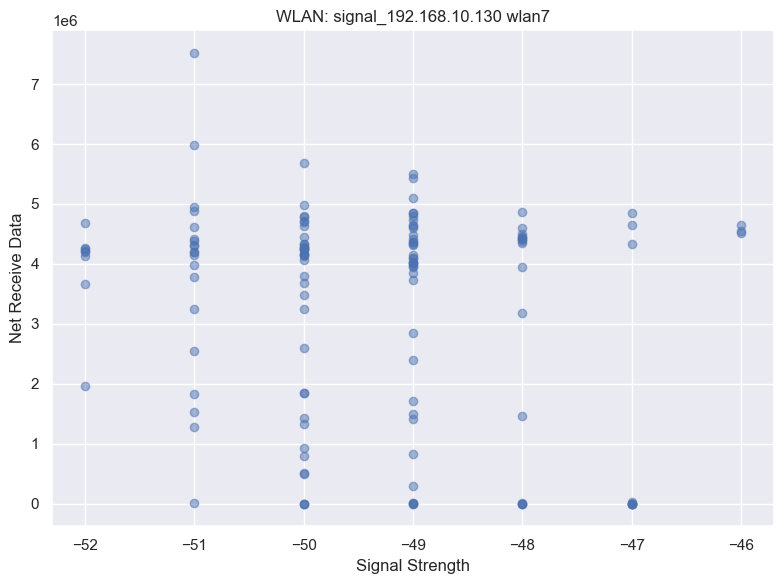

In [414]:
import numpy as np
import matplotlib.pyplot as plt

# Define the signal and net column names
signal_columns = ['signal_192.168.10.130 wlan1', 'signal_192.168.10.130 wlan2', 'signal_192.168.10.130 wlan3',
                  'signal_192.168.10.130 wlan4', 'signal_192.168.10.130 wlan5', 'signal_192.168.10.130 wlan6',
                  'signal_192.168.10.130 wlan7']
net_columns = ['net_192.168.10.130 wlan1', 'net_192.168.10.130 wlan2', 'net_192.168.10.130 wlan3',
               'net_192.168.10.130 wlan4', 'net_192.168.10.130 wlan5', 'net_192.168.10.130 wlan6',
               'net_192.168.10.130 wlan7']

# Set the downsampling factor
downsample_factor = 0.1  # Adjust this value as per your preference (e.g., 0.1 for 10% of the data)

# Create a scatter plot for each WLAN
for signal_col, net_col in zip(signal_columns, net_columns):
    # Downsample the data
    num_samples = int(len(df_bedroom1) * downsample_factor)
    indices = np.random.choice(len(df_bedroom1), num_samples, replace=False)
    signal_data = df_bedroom1[signal_col].iloc[indices]
    net_data = df_bedroom1[net_col].iloc[indices]
    
    # Create the scatter plot
    plt.figure(figsize=(8, 6))
    plt.scatter(signal_data, net_data, alpha=0.5)
    plt.xlabel('Signal Strength')
    plt.ylabel('Net Receive Data')
    plt.title(f'WLAN: {signal_col}')
    plt.tight_layout()
    plt.show()


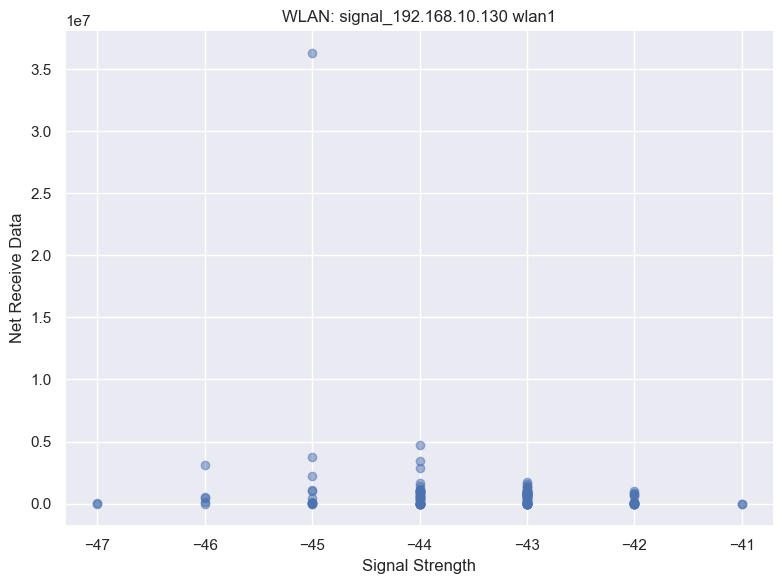

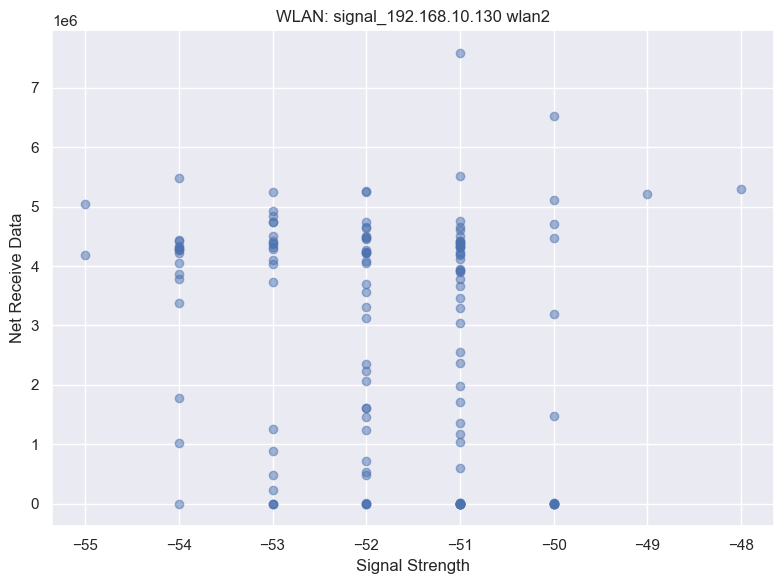

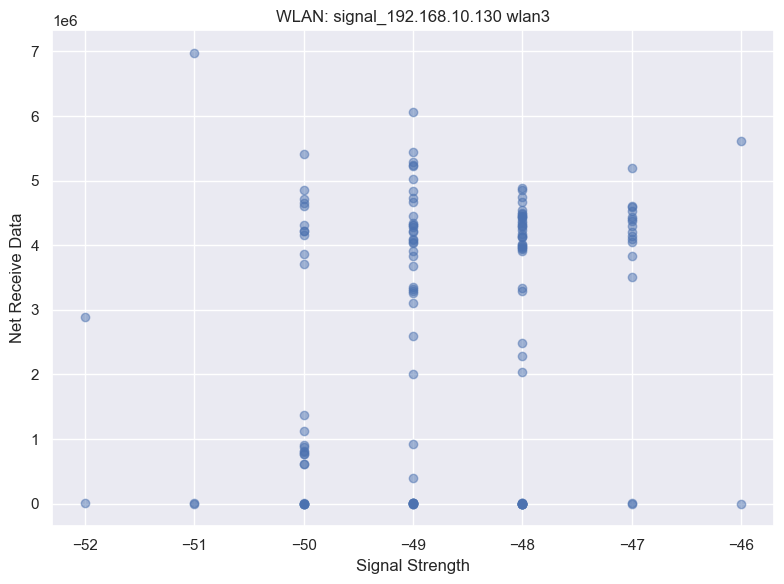

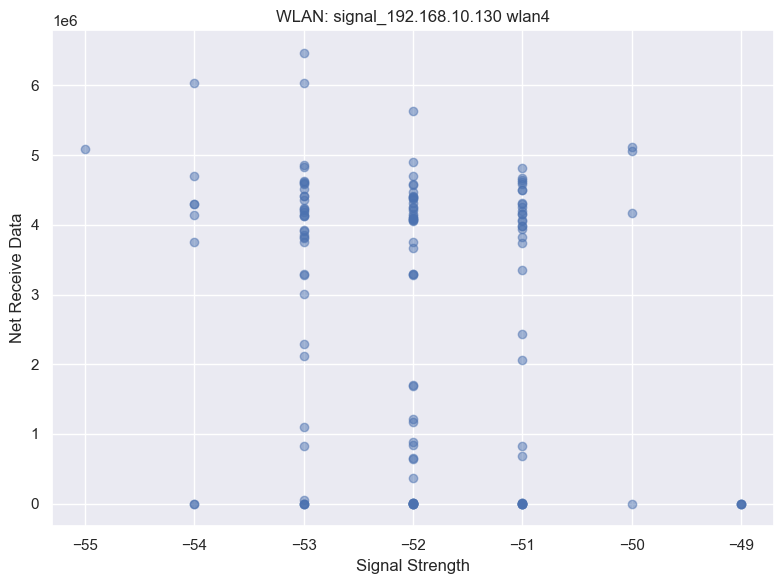

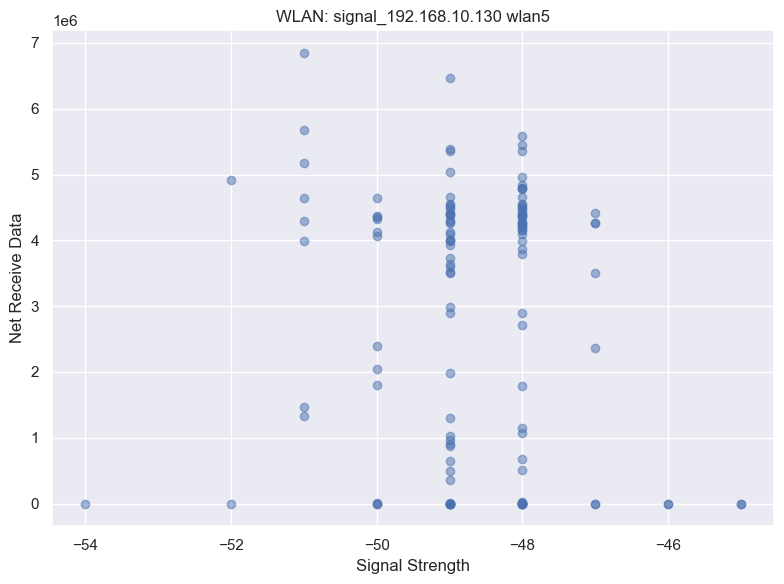

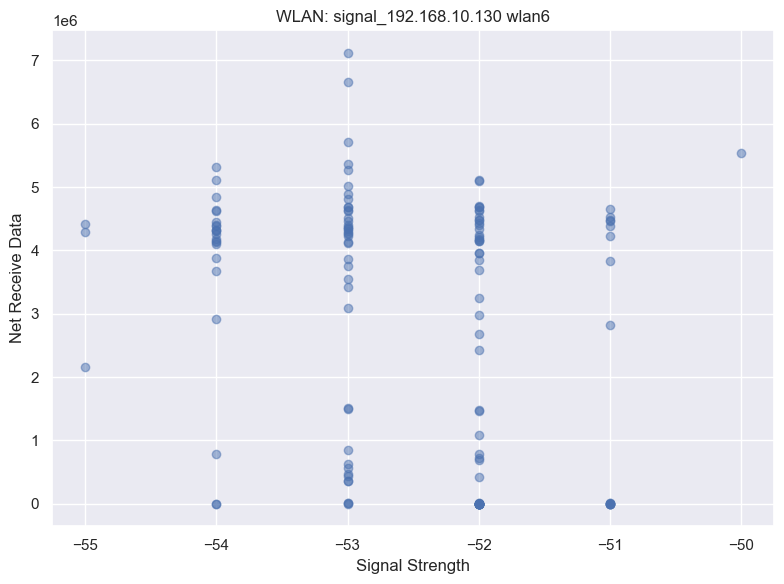

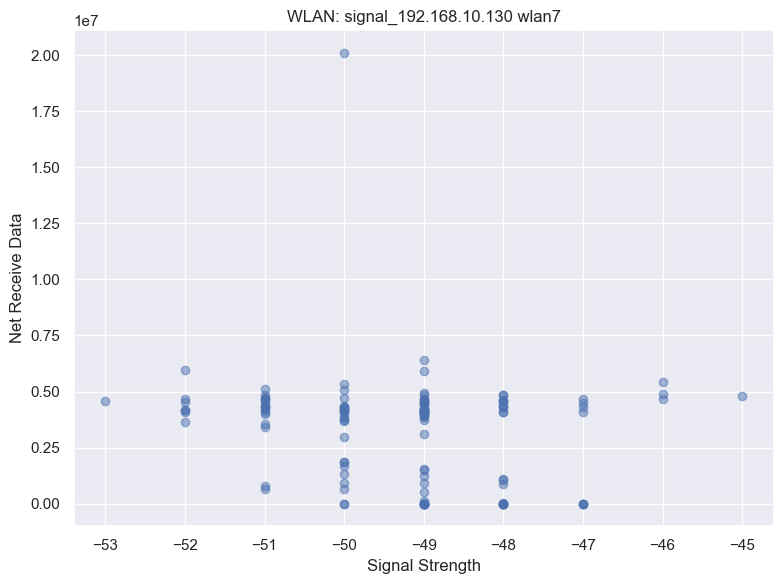

In [415]:
import numpy as np
import matplotlib.pyplot as plt

# Define the signal and net column names
signal_columns = ['signal_192.168.10.130 wlan1', 'signal_192.168.10.130 wlan2', 'signal_192.168.10.130 wlan3',
                  'signal_192.168.10.130 wlan4', 'signal_192.168.10.130 wlan5', 'signal_192.168.10.130 wlan6',
                  'signal_192.168.10.130 wlan7']
net_columns = ['net_192.168.10.130 wlan1', 'net_192.168.10.130 wlan2', 'net_192.168.10.130 wlan3',
               'net_192.168.10.130 wlan4', 'net_192.168.10.130 wlan5', 'net_192.168.10.130 wlan6',
               'net_192.168.10.130 wlan7']

# Set the downsampling factor
downsample_factor = 0.1  # Adjust this value as per your preference (e.g., 0.1 for 10% of the data)

# Create a scatter plot for each WLAN
for signal_col, net_col in zip(signal_columns, net_columns):
    # Downsample the data
    num_samples = int(len(df_bedroom1) * downsample_factor)
    indices = np.random.choice(len(df_bedroom1), num_samples, replace=False)
    signal_data = df_bedroom1[signal_col].iloc[indices]
    net_data = df_bedroom1[net_col].iloc[indices]
    
    # Create the scatter plot
    plt.figure(figsize=(8, 6))
    plt.scatter(signal_data, net_data, alpha=0.5)
    plt.xlabel('Signal Strength')
    plt.ylabel('Net Receive Data')
    plt.title(f'WLAN: {signal_col}')
    plt.tight_layout()
    plt.show()


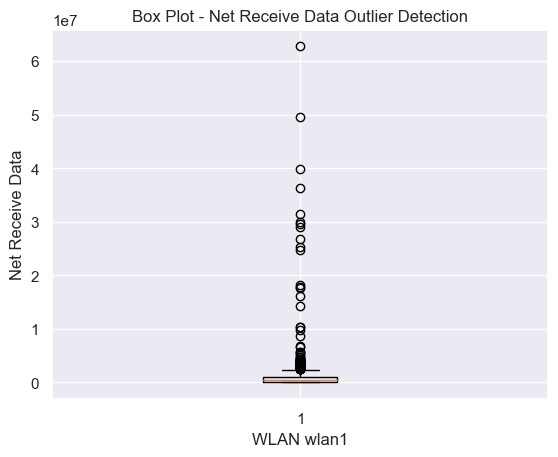

In [416]:
import matplotlib.pyplot as plt

# Select the column for outlier detection
net_receive_data = df_bedroom1['net_192.168.10.130 wlan1']

# Create a box plot
plt.boxplot(net_receive_data)

# Set the plot title and axis labels
plt.title('Box Plot - Net Receive Data Outlier Detection')
plt.xlabel('WLAN wlan1')
plt.ylabel('Net Receive Data')

# Show the plot
plt.show()


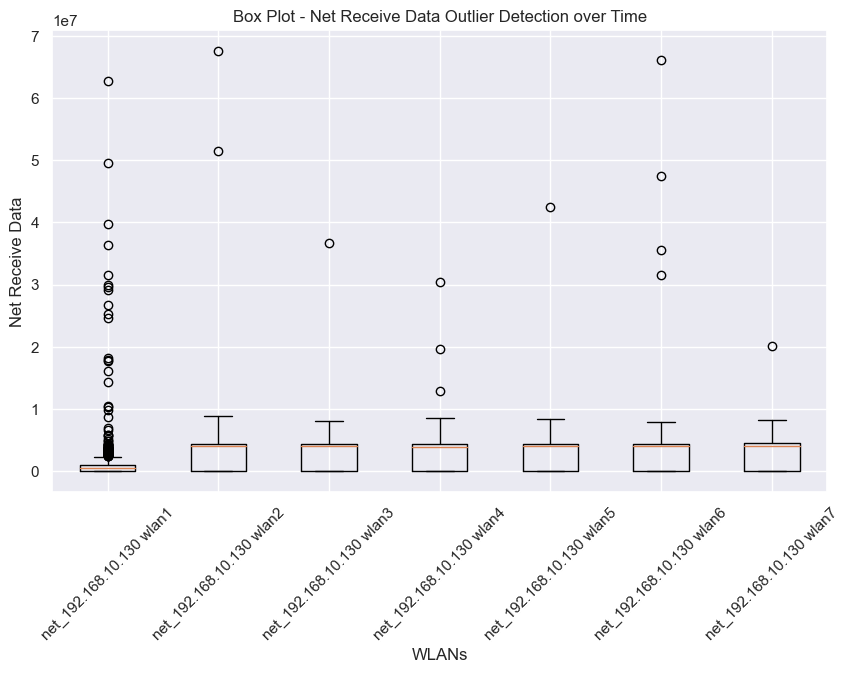

In [417]:
import matplotlib.pyplot as plt

# Select the columns for outlier detection
net_receive_columns = ['net_192.168.10.130 wlan1', 'net_192.168.10.130 wlan2', 'net_192.168.10.130 wlan3',
                       'net_192.168.10.130 wlan4', 'net_192.168.10.130 wlan5', 'net_192.168.10.130 wlan6',
                       'net_192.168.10.130 wlan7']

# Create a box plot for each WLAN over time
fig, ax = plt.subplots(figsize=(10, 6))
ax.boxplot(df_bedroom1[net_receive_columns].values, labels=net_receive_columns)
ax.set_title('Box Plot - Net Receive Data Outlier Detection over Time')
ax.set_xlabel('WLANs')
ax.set_ylabel('Net Receive Data')

# Rotate the x-axis labels for better visibility
plt.xticks(rotation=45)

# Show the plot
plt.show()


In [419]:
df_bedroom1.isna().sum()

net_192.168.10.130 wlan1         0
net_192.168.10.130 wlan2         0
net_192.168.10.130 wlan3         0
net_192.168.10.130 wlan4         0
net_192.168.10.130 wlan5         0
net_192.168.10.130 wlan6         0
net_192.168.10.130 wlan7         0
signal_192.168.10.130 wlan1     33
signal_192.168.10.130 wlan2     50
signal_192.168.10.130 wlan3     55
signal_192.168.10.130 wlan4     67
signal_192.168.10.130 wlan5     76
signal_192.168.10.130 wlan6     91
signal_192.168.10.130 wlan7    104
dtype: int64

In [420]:
np.isfinite(signal_strength_data) 

array([ True,  True,  True, ...,  True,  True,  True])

In [519]:
# Load a csv file while skipping the first row
df_2_4ghz_router1 = pd.read_csv('2.4 Ghz Channel Info Router1.csv', skiprows=1)
df_5ghz_router1 = pd.read_csv('5 Ghz Channel Info Router 1.csv', skiprows=1)
df_temp_router1= pd.read_csv('Hardware Temp Router 1.csv', skiprows=1)


df_throughputs_router1 = pd.read_csv('Throughput Router 1.csv', skiprows=1)
df_disk_router1 = pd.read_csv('Disk Space Used Router 1.csv', skiprows=1)
df_cpu1_router1 = pd.read_csv('Cpu Basic Data A Router 1.csv', skiprows=1)
df_cpu2_router1 = pd.read_csv('Cpu Basic Data B Router 1.csv')


df_num_clients_router1 = pd.read_csv('Number of Clients Router 1.csv', skiprows=1)
df_resident_router1 = pd.read_csv('resident memory data Router 1.csv')


df_memory_basic = pd.read_csv('Memory Basic Router 1.csv', skiprows=1)
df_transmit = pd.read_csv('Receive Transmit Diff Router 1.csv', skiprows=1)
df_trottle = pd.read_csv('Throttle Cooling device Router 1.csv', skiprows=1)
df_virt = pd.read_csv('Virtual Memory Data Router 1.csv')

In [520]:
df_2_4ghz_router1

,Time,2.4 GHZ 192.168.10.130 wlan2,2.4 GHZ 192.168.10.130 wlan3,2.4 GHZ 192.168.10.130 wlan4,2.4 GHZ 192.168.10.130 wlan5,2.4 GHZ 192.168.10.130 wlan6,2.4 GHZ 192.168.10.130 wlan7,2.4 GHZ 192.168.10.140 wlan1,2.4 GHZ 192.168.10.140 wlan2,2.4 GHZ 192.168.10.140 wlan3,...,2.4 GHZ 192.168.10.220 wlan4,2.4 GHZ 192.168.10.220 wlan5,2.4 GHZ 192.168.10.220 wlan6,2.4 GHZ 192.168.10.220 wlan7,2.4 GHZ 192.168.10.240 wlan2,2.4 GHZ 192.168.10.240 wlan3,2.4 GHZ 192.168.10.240 wlan4,2.4 GHZ 192.168.10.240 wlan5,2.4 GHZ 192.168.10.240 wlan6,2.4 GHZ 192.168.10.240 wlan7
0,2023-05-11 06:50:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,6.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2023-05-11 06:55:00,NaN,NaN,NaN,6.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2023-05-11 07:00:00,NaN,NaN,NaN,6.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2023-05-11 07:05:00,NaN,NaN,NaN,6.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2023-05-11 07:10:00,NaN,NaN,NaN,6.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1051,2023-05-16 13:45:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1052,2023-05-16 13:50:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1053,2023-05-16 13:55:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1054,2023-05-16 14:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [521]:
df_2_4ghz_router1 = df_2_4ghz_router1.dropna(axis=1, how='all')


In [522]:
df_2_4ghz_router1

,Time,2.4 GHZ 192.168.10.130 wlan2,2.4 GHZ 192.168.10.130 wlan3,2.4 GHZ 192.168.10.130 wlan4,2.4 GHZ 192.168.10.130 wlan5,2.4 GHZ 192.168.10.130 wlan6,2.4 GHZ 192.168.10.130 wlan7,2.4 GHZ 192.168.10.140 wlan1,2.4 GHZ 192.168.10.140 wlan2,2.4 GHZ 192.168.10.140 wlan3,...,2.4 GHZ 192.168.10.220 wlan4,2.4 GHZ 192.168.10.220 wlan5,2.4 GHZ 192.168.10.220 wlan6,2.4 GHZ 192.168.10.220 wlan7,2.4 GHZ 192.168.10.240 wlan2,2.4 GHZ 192.168.10.240 wlan3,2.4 GHZ 192.168.10.240 wlan4,2.4 GHZ 192.168.10.240 wlan5,2.4 GHZ 192.168.10.240 wlan6,2.4 GHZ 192.168.10.240 wlan7
0,2023-05-11 06:50:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,6.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2023-05-11 06:55:00,NaN,NaN,NaN,6.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2023-05-11 07:00:00,NaN,NaN,NaN,6.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2023-05-11 07:05:00,NaN,NaN,NaN,6.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2023-05-11 07:10:00,NaN,NaN,NaN,6.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1051,2023-05-16 13:45:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1052,2023-05-16 13:50:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1053,2023-05-16 13:55:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1054,2023-05-16 14:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [523]:
df_temp_router1

,Time,Location conn_gps Zone 21,Location cpu_little0 Zone 1,Location cpu_little1 Zone 2,Location cpu_little2 Zone 3,Location cpu_little3 Zone 4,Location dramc Zone 7,Location gpu0 Zone 5,Location gpu1 Zone 6,Location ltepa_ntc Zone 14,...,Location md_rf Zone 20,Location mmsys Zone 8,Location nrpa_ntc Zone 13,Location pmic Zone 16,Location pmic_vcore Zone 17,Location pmic_vgpu Zone 19,Location pmic_vproc Zone 18,Location rf_ntc Zone 15,Location soc_dram_ntc Zone 12,Location soc_max Zone 0
0,2023-05-11 07:28:00,-274,88.7,87.6,87.8,88.5,83.0,80.8,80.2,72.0,...,72,77.4,69.9,76.9,72.8,71.2,71.8,70.1,72.6,88.7
1,2023-05-11 07:32:00,-274,91.1,91.4,92.3,91.6,86.2,85.2,84.9,73.4,...,75,80.4,71.6,79.3,76.1,73.4,74.5,71.9,74.4,92.3
2,2023-05-11 07:36:00,-274,87.2,87.4,88.2,87.8,82.6,81.5,81.4,70.3,...,74,77.9,69.7,76.9,73.4,71.2,72.8,70.1,71.6,87.8
3,2023-05-11 07:40:00,-274,80.8,81.0,81.2,81.2,76.1,74.3,73.8,65.0,...,67,70.8,64.3,70.4,66.9,65.9,66.4,64.6,66.1,81.2
4,2023-05-11 07:44:00,-274,77.3,77.3,77.0,77.1,72.9,72.3,72.3,61.2,...,64,68.3,61.0,66.8,64.3,62.6,63.7,61.4,62.6,77.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1897,2023-05-16 13:56:00,-274,94.5,93.2,93.8,95.6,88.5,87.5,87.2,76.3,...,79,83.3,74.5,82.9,78.8,76.6,77.7,74.8,77.2,95.6
1898,2023-05-16 14:00:00,-274,95.7,96.0,97.7,96.4,90.3,89.8,89.5,78.1,...,81,85.5,76.2,84.7,80.4,78.8,79.8,76.5,79.0,97.7
1899,2023-05-16 14:04:00,-274,97.8,97.6,99.0,98.4,91.7,89.6,89.1,79.0,...,82,85.8,77.1,85.3,80.9,79.3,79.8,77.4,80.1,99.0
1900,2023-05-16 14:08:00,-274,98.3,98.5,100.0,99.3,92.5,91.7,91.4,79.4,...,81,87.1,77.7,87.1,82.0,80.4,80.9,78.1,80.4,100.0


In [524]:
df_temp_router1

,Time,Location conn_gps Zone 21,Location cpu_little0 Zone 1,Location cpu_little1 Zone 2,Location cpu_little2 Zone 3,Location cpu_little3 Zone 4,Location dramc Zone 7,Location gpu0 Zone 5,Location gpu1 Zone 6,Location ltepa_ntc Zone 14,...,Location md_rf Zone 20,Location mmsys Zone 8,Location nrpa_ntc Zone 13,Location pmic Zone 16,Location pmic_vcore Zone 17,Location pmic_vgpu Zone 19,Location pmic_vproc Zone 18,Location rf_ntc Zone 15,Location soc_dram_ntc Zone 12,Location soc_max Zone 0
0,2023-05-11 07:28:00,-274,88.7,87.6,87.8,88.5,83.0,80.8,80.2,72.0,...,72,77.4,69.9,76.9,72.8,71.2,71.8,70.1,72.6,88.7
1,2023-05-11 07:32:00,-274,91.1,91.4,92.3,91.6,86.2,85.2,84.9,73.4,...,75,80.4,71.6,79.3,76.1,73.4,74.5,71.9,74.4,92.3
2,2023-05-11 07:36:00,-274,87.2,87.4,88.2,87.8,82.6,81.5,81.4,70.3,...,74,77.9,69.7,76.9,73.4,71.2,72.8,70.1,71.6,87.8
3,2023-05-11 07:40:00,-274,80.8,81.0,81.2,81.2,76.1,74.3,73.8,65.0,...,67,70.8,64.3,70.4,66.9,65.9,66.4,64.6,66.1,81.2
4,2023-05-11 07:44:00,-274,77.3,77.3,77.0,77.1,72.9,72.3,72.3,61.2,...,64,68.3,61.0,66.8,64.3,62.6,63.7,61.4,62.6,77.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1897,2023-05-16 13:56:00,-274,94.5,93.2,93.8,95.6,88.5,87.5,87.2,76.3,...,79,83.3,74.5,82.9,78.8,76.6,77.7,74.8,77.2,95.6
1898,2023-05-16 14:00:00,-274,95.7,96.0,97.7,96.4,90.3,89.8,89.5,78.1,...,81,85.5,76.2,84.7,80.4,78.8,79.8,76.5,79.0,97.7
1899,2023-05-16 14:04:00,-274,97.8,97.6,99.0,98.4,91.7,89.6,89.1,79.0,...,82,85.8,77.1,85.3,80.9,79.3,79.8,77.4,80.1,99.0
1900,2023-05-16 14:08:00,-274,98.3,98.5,100.0,99.3,92.5,91.7,91.4,79.4,...,81,87.1,77.7,87.1,82.0,80.4,80.9,78.1,80.4,100.0


In [525]:
df_cpu1_router1

,5/11/23 7:30,150,170,0,17.9,0.0667,51.7
0,5/11/23 7:40,142,227,0.0000,15.8,0.0000,11.60
1,5/11/23 7:50,145,142,0.2000,17.3,0.0667,81.90
2,5/11/23 8:00,141,160,0.0667,16.5,0.0667,68.50
3,5/11/23 8:10,145,150,0.0667,17.1,0.0667,72.20
4,5/11/23 8:20,130,251,0.0000,11.4,0.0000,4.33
...,...,...,...,...,...,...,...
755,5/16/23 13:30,123,137,0.0000,10.9,0.0000,114.00
756,5/16/23 13:40,124,163,0.1330,13.9,0.0000,87.40
757,5/16/23 13:50,126,147,0.0667,13.1,0.0667,102.00
758,5/16/23 14:00,127,153,0.0000,13.5,0.0000,94.80


df_virt

In [671]:
import pandas as pd

# Read the CSV files into DataFrames
df_2_4ghz_router1 = pd.read_csv('2.4 Ghz Channel Info Router1.csv', skiprows=1)
df_5ghz_router1 = pd.read_csv('5 Ghz Channel Info Router 1.csv', skiprows=1)
df_temp_router1 = pd.read_csv('Hardware Temp Router 1.csv', skiprows=1)
df_throughputs_router1 = pd.read_csv('Throughput Router 1.csv', skiprows=1)
df_disk_router1 = pd.read_csv('Disk Space Used Router 1.csv', skiprows=1)
df_cpu1_router1 = pd.read_csv('Cpu Basic Data A Router 1.csv')
df_cpu2_router1 = pd.read_csv('Cpu Basic Data B Router 1.csv', skiprows=1)
df_num_clients_router1 = pd.read_csv('Number of Clients Router 1.csv', skiprows=1)
df_resident_router1 = pd.read_csv('resident memory data Router 1.csv', skiprows=1)
df_memory_basic_router1 = pd.read_csv('Memory Basic Router 1.csv')
df_transmit_router1 = pd.read_csv('Receive Transmit Diff Router 1.csv', skiprows=1)
df_trottle_router1 = pd.read_csv('Throttle Cooling device Router 1.csv', skiprows=1)
df_virt_router1 = pd.read_csv('Virtual Memory Data Router 1.csv')

# Convert 'Time' column to datetime
df_2_4ghz_router1['Time'] = pd.to_datetime(df_2_4ghz_router1['Time'])
df_5ghz_router1['Time'] = pd.to_datetime(df_5ghz_router1['Time'])
df_temp_router1['Time'] = pd.to_datetime(df_temp_router1['Time'])
df_throughputs_router1['Time'] = pd.to_datetime(df_throughputs_router1['Time'])
df_disk_router1['Time'] = pd.to_datetime(df_disk_router1['Time'])
df_cpu1_router1['Time'] = pd.to_datetime(df_cpu1_router1['Time'])
df_cpu2_router1['Time'] = pd.to_datetime(df_cpu2_router1['Time'])
df_num_clients_router1['Time'] = pd.to_datetime(df_num_clients_router1['Time'])
df_resident_router1['Time'] = pd.to_datetime(df_resident_router1['Time'])
df_memory_basic_router1['Time'] = pd.to_datetime(df_memory_basic_router1['Time'])
df_transmit_router1['Time'] = pd.to_datetime(df_transmit_router1['Time'])
df_trottle_router1['Time'] = pd.to_datetime(df_trottle_router1['Time'])


# Filter data for the desired date range
start_time = pd.to_datetime('2023-05-11 07:40:00')
end_time = start_time + pd.DateOffset(days=2)

df_2_4ghz_router1 = df_2_4ghz_router1.loc[(df_2_4ghz_router1['Time'] >= start_time) & (df_2_4ghz_router1['Time'] <= end_time)]
df_5ghz_router1 = df_5ghz_router1.loc[(df_5ghz_router1['Time'] >= start_time) & (df_5ghz_router1['Time'] <= end_time)]
df_temp_router1 = df_temp_router1.loc[(df_temp_router1['Time'] >= start_time) & (df_temp_router1['Time'] <= end_time)]
df_throughputs_router1 = df_throughputs_router1.loc[(df_throughputs_router1['Time'] >= start_time) & (df_throughputs_router1['Time'] <= end_time)]
df_disk_router1 = df_disk_router1.loc[(df_disk_router1['Time'] >= start_time) & (df_disk_router1['Time'] <= end_time)]
df_cpu1_router1 = df_cpu1_router1.loc[(df_cpu1_router1['Time'] >= start_time) & (df_cpu1_router1['Time'] <= end_time)]
df_cpu2_router1 = df_cpu2_router1.loc[(df_cpu2_router1['Time'] >= start_time) & (df_cpu2_router1['Time'] <= end_time)]
df_num_clients_router1 = df_num_clients_router1.loc[(df_num_clients_router1['Time'] >= start_time) & (df_num_clients_router1['Time'] <= end_time)]
df_resident_router1 = df_resident_router1.loc[(df_resident_router1['Time'] >= start_time) & (df_resident_router1['Time'] <= end_time)]
df_memory_basic_router1 = df_memory_basic_router1.loc[(df_memory_basic_router1['Time'] >= start_time) & (df_memory_basic_router1['Time'] <= end_time)]
df_transmit_router1 = df_transmit_router1.loc[(df_transmit_router1['Time'] >= start_time) & (df_transmit_router1['Time'] <= end_time)]
df_trottle_router1 = df_trottle_router1.loc[(df_trottle_router1['Time'] >= start_time) & (df_trottle_router1['Time'] <= end_time)]



In [543]:
df_trottle_router1

,Time,Current 0 in thermal-devfreq-0,Current 1 in mutt-pa1,Current 2 in mutt-pa2,Current 3 in mutt-pa1-no-ims,Current 4 in mutt-pa2-no-ims,Current 5 in tx-pwr-pa1,Current 6 in tx-pwr-pa2,Current 7 in scg-off-pa2,Current 8 in thermal-cpufreq-0,Max 0 in thermal-devfreq-0,Max 1 in mutt-pa1,Max 2 in mutt-pa2,Max 3 in mutt-pa1-no-ims,Max 4 in mutt-pa2-no-ims,Max 5 in tx-pwr-pa1,Max 6 in tx-pwr-pa2,Max 7 in scg-off-pa2,Max 8 in thermal-cpufreq-0
1,2023-05-11 07:40:00,0,0,0,0,0,0,0,0,0,3,8,8,1,1,3,3,1,15
2,2023-05-11 07:50:00,0,0,0,0,0,0,0,0,0,3,8,8,1,1,3,3,1,15
3,2023-05-11 08:00:00,0,0,0,0,0,0,0,0,0,3,8,8,1,1,3,3,1,15
4,2023-05-11 08:10:00,0,0,0,0,0,0,0,0,0,3,8,8,1,1,3,3,1,15
5,2023-05-11 08:20:00,0,0,0,0,0,0,0,0,0,3,8,8,1,1,3,3,1,15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
285,2023-05-13 07:00:00,0,0,0,0,0,0,0,0,0,3,8,8,1,1,3,3,1,15
286,2023-05-13 07:10:00,0,0,0,0,0,0,0,0,0,3,8,8,1,1,3,3,1,15
287,2023-05-13 07:20:00,3,0,0,0,0,0,0,0,0,3,8,8,1,1,3,3,1,15
288,2023-05-13 07:30:00,3,0,0,0,0,0,0,0,0,3,8,8,1,1,3,3,1,15


In [531]:
df_trottle_router1 = df_trottle_router1.iloc[:, :2]


In [532]:
df_trottle_router1

,Time,Current 0 in thermal-devfreq-0
1,2023-05-11 07:40:00,0
2,2023-05-11 07:50:00,0
3,2023-05-11 08:00:00,0
4,2023-05-11 08:10:00,0
5,2023-05-11 08:20:00,0
...,...,...
285,2023-05-13 07:00:00,0
286,2023-05-13 07:10:00,0
287,2023-05-13 07:20:00,3
288,2023-05-13 07:30:00,3


In [544]:
df_temp_router1

,Time,Location conn_gps Zone 21,Location cpu_little0 Zone 1,Location cpu_little1 Zone 2,Location cpu_little2 Zone 3,Location cpu_little3 Zone 4,Location dramc Zone 7,Location gpu0 Zone 5,Location gpu1 Zone 6,Location ltepa_ntc Zone 14,...,Location md_rf Zone 20,Location mmsys Zone 8,Location nrpa_ntc Zone 13,Location pmic Zone 16,Location pmic_vcore Zone 17,Location pmic_vgpu Zone 19,Location pmic_vproc Zone 18,Location rf_ntc Zone 15,Location soc_dram_ntc Zone 12,Location soc_max Zone 0
3,2023-05-11 07:40:00,-274,80.8,81.0,81.2,81.2,76.1,74.3,73.8,65.0,...,67,70.8,64.3,70.4,66.9,65.9,66.4,64.6,66.1,81.2
4,2023-05-11 07:44:00,-274,77.3,77.3,77.0,77.1,72.9,72.3,72.3,61.2,...,64,68.3,61.0,66.8,64.3,62.6,63.7,61.4,62.6,77.3
5,2023-05-11 07:48:00,-274,75.1,73.6,73.8,74.4,70.1,69.1,69.3,59.2,...,62,65.5,58.7,64.5,62.1,60.5,61.0,59.1,60.4,75.1
6,2023-05-11 07:52:00,-274,74.7,75.0,75.1,75.4,70.5,69.8,69.7,59.9,...,62,66.1,59.1,65.0,62.1,61.0,61.6,59.4,60.9,75.0
7,2023-05-11 07:56:00,-274,73.9,73.5,73.7,73.8,69.8,68.3,68.2,60.2,...,61,65.3,59.0,64.5,61.6,60.5,60.5,59.3,60.9,73.9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
719,2023-05-13 07:24:00,-274,90.4,91.3,91.5,91.1,85.0,84.5,84.2,73.2,...,75,80.3,71.4,79.3,75.5,73.4,74.5,71.6,74.1,91.5
720,2023-05-13 07:28:00,-274,94.0,93.4,94.0,95.1,88.0,86.9,86.7,74.7,...,77,82.1,73.0,81.1,77.7,75.5,76.6,73.2,75.7,95.0
721,2023-05-13 07:32:00,-274,94.4,94.8,96.0,94.5,88.6,87.8,87.4,76.0,...,78,83.1,74.1,82.3,78.2,76.6,77.7,74.4,76.9,96.2
722,2023-05-13 07:36:00,-274,95.5,96.0,96.6,95.9,89.7,88.7,88.2,76.9,...,78,84.4,75.0,83.5,79.3,77.1,78.2,75.3,77.9,96.6


In [548]:
df_temp_router1

,Time,Location conn_gps Zone 21,Location cpu_little0 Zone 1,Location cpu_little1 Zone 2,Location cpu_little2 Zone 3,Location cpu_little3 Zone 4,Location dramc Zone 7,Location gpu0 Zone 5,Location gpu1 Zone 6,Location ltepa_ntc Zone 14,...,Location md_rf Zone 20,Location mmsys Zone 8,Location nrpa_ntc Zone 13,Location pmic Zone 16,Location pmic_vcore Zone 17,Location pmic_vgpu Zone 19,Location pmic_vproc Zone 18,Location rf_ntc Zone 15,Location soc_dram_ntc Zone 12,Location soc_max Zone 0
3,2023-05-11 07:40:00,-274,80.8,81.0,81.2,81.2,76.1,74.3,73.8,65.0,...,67,70.8,64.3,70.4,66.9,65.9,66.4,64.6,66.1,81.2
4,2023-05-11 07:44:00,-274,77.3,77.3,77.0,77.1,72.9,72.3,72.3,61.2,...,64,68.3,61.0,66.8,64.3,62.6,63.7,61.4,62.6,77.3
5,2023-05-11 07:48:00,-274,75.1,73.6,73.8,74.4,70.1,69.1,69.3,59.2,...,62,65.5,58.7,64.5,62.1,60.5,61.0,59.1,60.4,75.1
6,2023-05-11 07:52:00,-274,74.7,75.0,75.1,75.4,70.5,69.8,69.7,59.9,...,62,66.1,59.1,65.0,62.1,61.0,61.6,59.4,60.9,75.0
7,2023-05-11 07:56:00,-274,73.9,73.5,73.7,73.8,69.8,68.3,68.2,60.2,...,61,65.3,59.0,64.5,61.6,60.5,60.5,59.3,60.9,73.9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
719,2023-05-13 07:24:00,-274,90.4,91.3,91.5,91.1,85.0,84.5,84.2,73.2,...,75,80.3,71.4,79.3,75.5,73.4,74.5,71.6,74.1,91.5
720,2023-05-13 07:28:00,-274,94.0,93.4,94.0,95.1,88.0,86.9,86.7,74.7,...,77,82.1,73.0,81.1,77.7,75.5,76.6,73.2,75.7,95.0
721,2023-05-13 07:32:00,-274,94.4,94.8,96.0,94.5,88.6,87.8,87.4,76.0,...,78,83.1,74.1,82.3,78.2,76.6,77.7,74.4,76.9,96.2
722,2023-05-13 07:36:00,-274,95.5,96.0,96.6,95.9,89.7,88.7,88.2,76.9,...,78,84.4,75.0,83.5,79.3,77.1,78.2,75.3,77.9,96.6


In [555]:
# Define the temperature threshold
threshold = 100

# Create a binary DataFrame indicating whether each sensor's temperature exceeds the threshold
above_threshold = df_temp_router1 > threshold

# Calculate the cooling periods for each sensor
cooling_periods = above_threshold.apply(lambda x: (x != x.shift()).cumsum() * ~x)

# Filter out the sensors that don't require cooling
sensors_to_cool = cooling_periods.columns[above_threshold.any()]
cooling_periods_filtered = cooling_periods[sensors_to_cool]

# Count the number of times each sensor breaks the threshold
break_counts = cooling_periods_filtered.sum()

# Display the break counts for each sensor
print(break_counts)

Location cpu_little0      Zone 1    4101
Location cpu_little1      Zone 2    4407
Location cpu_little2      Zone 3    5797
Location cpu_little3      Zone 4    7412
Location soc_max      Zone 0        6800
dtype: int64


Based on the analysis of the temperature data, the following sensors experienced temperature increases above the threshold of 100:

Location cpu_little0 (Zone 1) had 4,101 occurrences.
Location cpu_little1 (Zone 2) had 4,407 occurrences.
Location cpu_little2 (Zone 3) had 5,797 occurrences.
Location cpu_little3 (Zone 4) had 7,412 occurrences.
Location soc_max (Zone 0) had 6,800 occurrences.
These results indicate that these sensors frequently exceeded the temperature threshold and required cooling to maintain optimal performance. It suggests that additional measures might be necessary to regulate and manage the temperatures of these zones effectively.



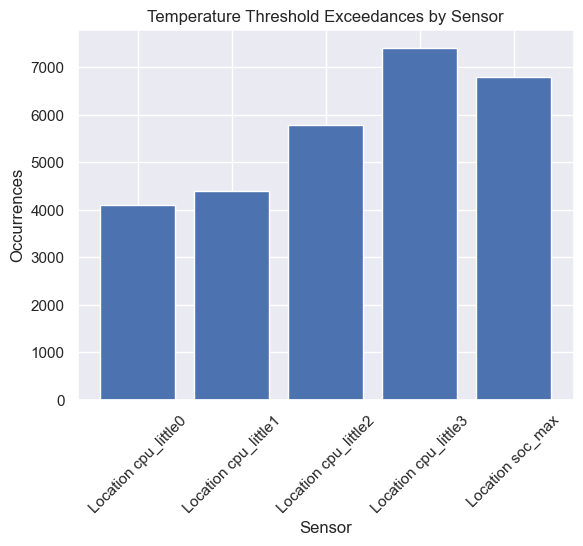

In [559]:
import matplotlib.pyplot as plt

sensor_names = ['Location cpu_little0', 'Location cpu_little1', 'Location cpu_little2', 'Location cpu_little3', 'Location soc_max']
occurrences = [4101, 4407, 5797, 7412, 6800]

plt.bar(sensor_names, occurrences)
plt.xlabel('Sensor')
plt.ylabel('Occurrences')
plt.title('Temperature Threshold Exceedances by Sensor')
plt.xticks(rotation=45)
plt.show()


In [584]:
df_num_clients

,Time,2.4 GHZ,5 Ghz High Band
0,2023-06-20 17:26:00,13,36
1,2023-06-20 17:27:00,13,36
2,2023-06-20 17:28:00,13,36
3,2023-06-20 17:29:00,13,36
4,2023-06-20 17:30:00,13,36
...,...,...,...
2876,2023-06-22 17:22:00,0,49
2877,2023-06-22 17:23:00,0,49
2878,2023-06-22 17:24:00,0,49
2879,2023-06-22 17:25:00,0,49


In [599]:
df_num_clients_router1

,Time,2.4 GHZ,5 Ggz Low Band
86,2023-05-11 07:40:00,0,43
87,2023-05-11 07:41:00,0,43
88,2023-05-11 07:42:00,0,43
89,2023-05-11 07:43:00,0,43
90,2023-05-11 07:44:00,0,43
...,...,...,...
2962,2023-05-13 07:36:00,1,48
2963,2023-05-13 07:37:00,1,48
2964,2023-05-13 07:38:00,2,49
2965,2023-05-13 07:39:00,0,0


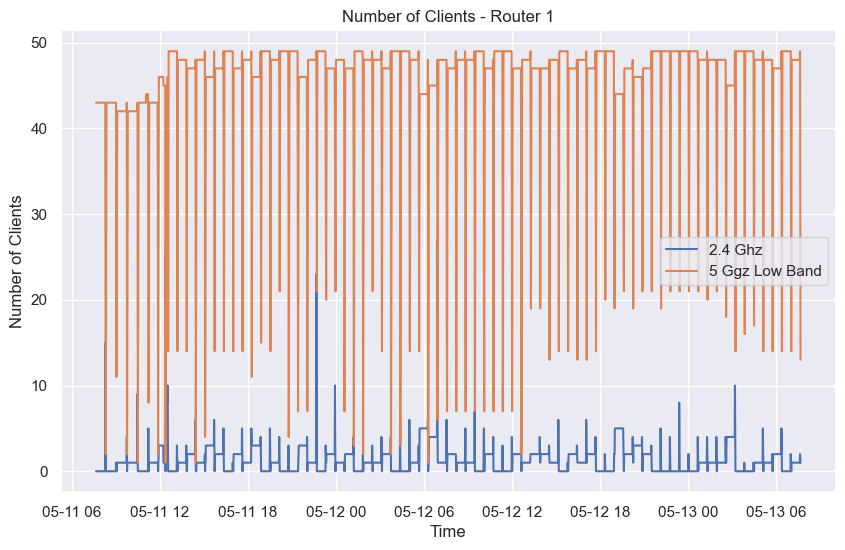

In [601]:
import matplotlib.pyplot as plt

# Filter out rows with both values equal to zero
df_filtered_router1 = df_num_clients_router1.loc[(df_num_clients_router1[['2.4 GHZ', '5 Ggz Low Band']] != 0).any(axis=1)]

# Create a figure and axes
fig, ax = plt.subplots(figsize=(10, 6))

# Plot the data for Router 1
ax.plot(df_filtered_router1['Time'], df_filtered_router1['2.4 GHZ'], label='2.4 Ghz')
ax.plot(df_filtered_router1['Time'], df_filtered_router1['5 Ggz Low Band'], label='5 Ggz Low Band')

# Set the x-axis label
ax.set_xlabel('Time')

# Set the y-axis label
ax.set_ylabel('Number of Clients')

# Set the plot title
ax.set_title('Number of Clients - Router 1')

# Add a legend
ax.legend()

# Display the plot
plt.show()


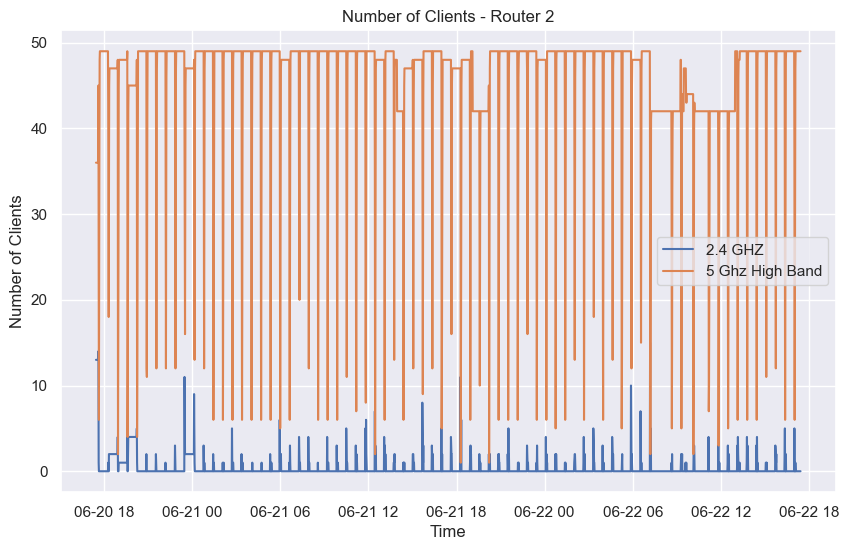

In [602]:
import matplotlib.pyplot as plt

# Filter out rows with both values equal to zero
df_filtered_router2 = df_num_clients.loc[(df_num_clients[['2.4 GHZ', '5 Ghz High Band']] != 0).any(axis=1)]

# Create a figure and axes
fig, ax = plt.subplots(figsize=(10, 6))

# Plot the data for Router 2
ax.plot(df_filtered_router2['Time'], df_filtered_router2['2.4 GHZ'], label='2.4 GHZ')
ax.plot(df_filtered_router2['Time'], df_filtered_router2['5 Ghz High Band'], label='5 Ghz High Band')

# Set the x-axis label
ax.set_xlabel('Time')

# Set the y-axis label
ax.set_ylabel('Number of Clients')

# Set the plot title
ax.set_title('Number of Clients - Router 2')

# Add a legend
ax.legend()

# Display the plot
plt.show()


In [607]:
df_memory_basic

,Time,RAM Total,RAM Used,RAM Cache + Buffer,RAM Free
0,2023-06-20 17:28:00,1713172480,986279936,378486784,348405760
1,2023-06-20 17:32:00,1713172480,987697152,377393152,348082176
2,2023-06-20 17:36:00,1713172480,942067712,377872384,393232384
3,2023-06-20 17:40:00,1713172480,943398912,381014016,388759552
4,2023-06-20 17:44:00,1713172480,950767616,383897600,378507264
...,...,...,...,...,...
716,2023-06-22 17:12:00,1713172480,963432448,343334912,406405120
717,2023-06-22 17:16:00,1713172480,964722688,344113152,404336640
718,2023-06-22 17:20:00,1713172480,968237056,340779008,404156416
719,2023-06-22 17:24:00,1713172480,965795840,340639744,406736896


In [608]:
df_memory_basic_router1

,Time,RAM Total,RAM Used,RAM Cache + Buffer,RAM Free
1,2023-05-11 07:40:00,1712283648,1119899648,490811392,101572608
2,2023-05-11 07:50:00,1712283648,1168269312,493477888,50536448
3,2023-05-11 08:00:00,1712283648,1164849152,489676800,57757696
4,2023-05-11 08:10:00,1712283648,1171406848,490942464,49934336
5,2023-05-11 08:20:00,1712283648,1132036096,491872256,88375296
...,...,...,...,...,...
285,2023-05-13 07:00:00,1712283648,1277444096,347168768,87670784
286,2023-05-13 07:10:00,1712283648,1308250112,348065792,55967744
287,2023-05-13 07:20:00,1712283648,1317650432,348913664,45719552
288,2023-05-13 07:30:00,1712283648,1317064704,348794880,46424064


In [609]:
import numpy as np

# Calculate the percentage of RAM used over time for Router 1
router1_ram_used_percent = df_memory_basic_router1['RAM Used'] / df_memory_basic_router1['RAM Total'] * 100

# Calculate the percentage of RAM used over time for Router 2
router2_ram_used_percent = df_memory_basic['RAM Used'] / df_memory_basic['RAM Total'] * 100

# Calculate the standard deviation for Router 1
router1_std = np.std(router1_ram_used_percent)

# Calculate the standard deviation for Router 2
router2_std = np.std(router2_ram_used_percent)

# Compare the standard deviation for both routers
same_time_frame = router1_ram_used_percent.index.equals(router2_ram_used_percent.index)

# Create a DataFrame to store the results
memory_usage_df = pd.DataFrame({
    'Time': df_memory_basic['Time'],
    'Router 1 RAM Used (%)': router1_ram_used_percent,
    'Router 2 RAM Used (%)': router2_ram_used_percent
})

# Display the memory usage DataFrame and standard deviations
print("Memory Usage:")
print(memory_usage_df)
print("\nStandard Deviation:")
print(f"Router 1: {router1_std}")
print(f"Router 2: {router2_std}")
print("\nDo both routers show greater standard deviation in the same time frame?")
print(same_time_frame)


Memory Usage:
                    Time  Router 1 RAM Used (%)  Router 2 RAM Used (%)
0    2023-06-20 17:28:00                    NaN              57.570382
1    2023-06-20 17:32:00              65.403863              57.653106
2    2023-06-20 17:36:00              68.228726              54.989659
3    2023-06-20 17:40:00              68.028983              55.067363
4    2023-06-20 17:44:00              68.411963              55.497484
..                   ...                    ...                    ...
716  2023-06-22 17:12:00                    NaN              56.236746
717  2023-06-22 17:16:00                    NaN              56.312058
718  2023-06-22 17:20:00                    NaN              56.517196
719  2023-06-22 17:24:00                    NaN              56.374700
720  2023-06-22 17:28:00                    NaN              56.423474

[721 rows x 3 columns]

Standard Deviation:
Router 1: 2.918022963316277
Router 2: 1.0311560132671902

Do both routers show greater st

In [612]:
df_memory_basic

,Time,RAM Total,RAM Used,RAM Cache + Buffer,RAM Free
0,2023-06-20 17:28:00,1713172480,986279936,378486784,348405760
1,2023-06-20 17:32:00,1713172480,987697152,377393152,348082176
2,2023-06-20 17:36:00,1713172480,942067712,377872384,393232384
3,2023-06-20 17:40:00,1713172480,943398912,381014016,388759552
4,2023-06-20 17:44:00,1713172480,950767616,383897600,378507264
...,...,...,...,...,...
716,2023-06-22 17:12:00,1713172480,963432448,343334912,406405120
717,2023-06-22 17:16:00,1713172480,964722688,344113152,404336640
718,2023-06-22 17:20:00,1713172480,968237056,340779008,404156416
719,2023-06-22 17:24:00,1713172480,965795840,340639744,406736896


C:\Users\mwj97\anaconda4\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency 4T will be used.

C:\Users\mwj97\anaconda4\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency 4T will be used.

C:\Users\mwj97\anaconda4\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency 4T will be used.



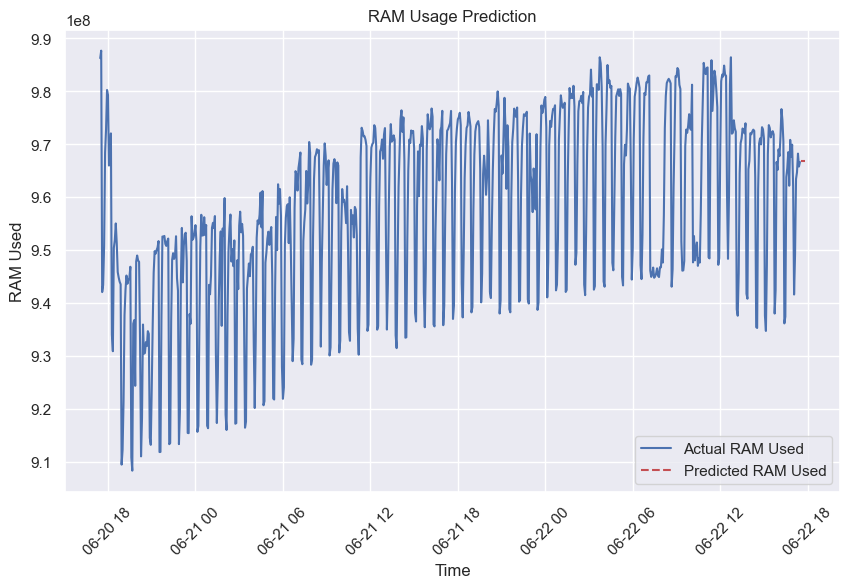

In [616]:
import pandas as pd
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt



# Fit the ARIMA model
model = ARIMA(df_memory_basic['RAM Used'], order=(1, 1, 1))
model_fit = model.fit()

# Predict RAM usage for the next 5 time points
forecast = model_fit.forecast(steps=1000)

# Create a new DataFrame for the predicted RAM usage
predicted_df = pd.DataFrame({'Time': pd.date_range(start=df_memory_basic.index[-1] + pd.Timedelta(minutes=4), periods=5, freq='4min'),
                             'Predicted RAM Used': forecast[0]})

# Concatenate the original DataFrame with the predicted DataFrame
combined_df = pd.concat([df_memory_basic, predicted_df])

# Plot the RAM usage over time
plt.figure(figsize=(10, 6))
plt.plot(combined_df.index, combined_df['RAM Used'], label='Actual RAM Used')
plt.plot(combined_df['Time'].tail(1000), combined_df['Predicted RAM Used'].tail(1000), 'r--', label='Predicted RAM Used')
plt.xlabel('Time')
plt.ylabel('RAM Used')
plt.title('RAM Usage Prediction')
plt.legend()
plt.xticks(rotation=45)
plt.grid(True)
plt.show()


Epoch 1/100
17/17 [==============================] - 2s 41ms/step - loss: 0.2139 - val_loss: 0.0652
Epoch 2/100
17/17 [==============================] - 0s 18ms/step - loss: 0.0452 - val_loss: 0.0393
Epoch 3/100
17/17 [==============================] - 0s 17ms/step - loss: 0.0390 - val_loss: 0.0325
Epoch 4/100
17/17 [==============================] - 0s 18ms/step - loss: 0.0373 - val_loss: 0.0327
Epoch 5/100
17/17 [==============================] - 0s 19ms/step - loss: 0.0371 - val_loss: 0.0323
Epoch 6/100
17/17 [==============================] - 0s 19ms/step - loss: 0.0367 - val_loss: 0.0316
Epoch 7/100
17/17 [==============================] - 0s 19ms/step - loss: 0.0364 - val_loss: 0.0321
Epoch 8/100
17/17 [==============================] - 0s 19ms/step - loss: 0.0358 - val_loss: 0.0311
Epoch 9/100
17/17 [==============================] - 0s 18ms/step - loss: 0.0357 - val_loss: 0.0307
Epoch 10/100
17/17 [==============================] - 0s 18ms/step - loss: 0.0351 - val_loss: 0.0304

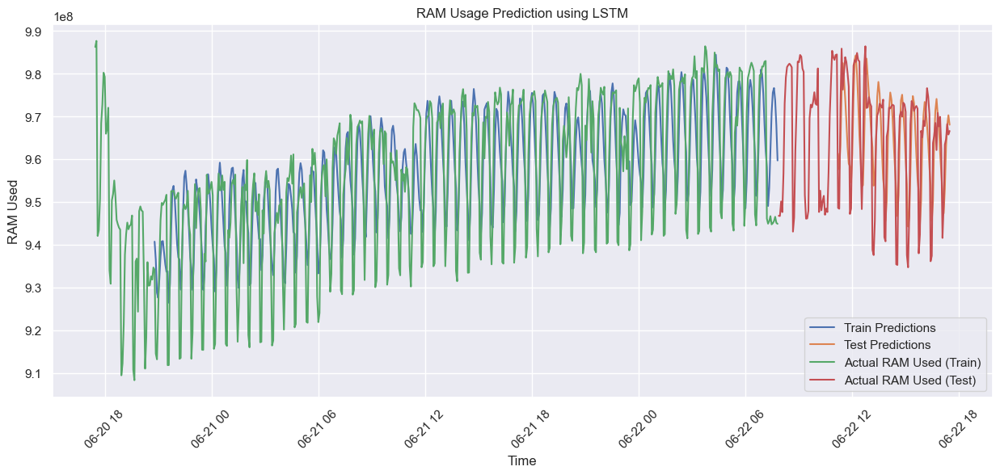

In [629]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping

# Prepare the data
data = df_memory_basic['RAM Used'].values.reshape(-1, 1)

# Normalize the data
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(data)

# Split the data into training and testing sets
train_size = int(len(scaled_data) * 0.8)
train_data = scaled_data[:train_size]
test_data = scaled_data[train_size:]

# Function to create training examples and targets
def create_sequences(data, window_size):
    X = []
    y = []
    for i in range(len(data) - window_size):
        X.append(data[i:i+window_size])
        y.append(data[i+window_size])
    return np.array(X), np.array(y)

# Define the window size for the LSTM model
window_size = 50

# Create training examples and targets
X_train, y_train = create_sequences(train_data, window_size)
X_test, y_test = create_sequences(test_data, window_size)

# Build the LSTM model
12model = Sequential()
model.add(LSTM(64, input_shape=(window_size, 1)))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')

# Train the model
early_stopping = EarlyStopping(patience=3, restore_best_weights=True)
model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test), callbacks=[early_stopping])

# Make predictions
train_predictions = model.predict(X_train)
test_predictions = model.predict(X_test)

# Inverse transform the predictions
train_predictions = scaler.inverse_transform(train_predictions)
test_predictions = scaler.inverse_transform(test_predictions)

# Plot the predictions
plt.figure(figsize=(15, 6))
plt.plot(df_memory_basic.index[window_size:train_size], train_predictions, label='Train Predictions')
plt.plot(df_memory_basic.index[train_size+window_size:], test_predictions, label='Test Predictions')
plt.plot(df_memory_basic.index[:train_size], df_memory_basic['RAM Used'].values[:train_size], label='Actual RAM Used (Train)')
plt.plot(df_memory_basic.index[train_size:], df_memory_basic['RAM Used'].values[train_size:], label='Actual RAM Used (Test)')
plt.xlabel('Time')
plt.ylabel('RAM Used')
plt.title('RAM Usage Prediction using LSTM')
plt.legend()
plt.xticks(rotation=45)
plt.grid(True)
plt.show()


Epoch 1/100
17/17 [==============================] - 2s 40ms/step - loss: 0.1447 - val_loss: 0.0344
Epoch 2/100
17/17 [==============================] - 0s 18ms/step - loss: 0.0393 - val_loss: 0.0315
Epoch 3/100
17/17 [==============================] - 0s 18ms/step - loss: 0.0362 - val_loss: 0.0321
Epoch 4/100
17/17 [==============================] - 0s 17ms/step - loss: 0.0360 - val_loss: 0.0312
Epoch 5/100
17/17 [==============================] - 0s 17ms/step - loss: 0.0367 - val_loss: 0.0330
Epoch 6/100
17/17 [==============================] - 0s 18ms/step - loss: 0.0361 - val_loss: 0.0333
Epoch 7/100
3/3 [==============================] - 0s 9ms/step


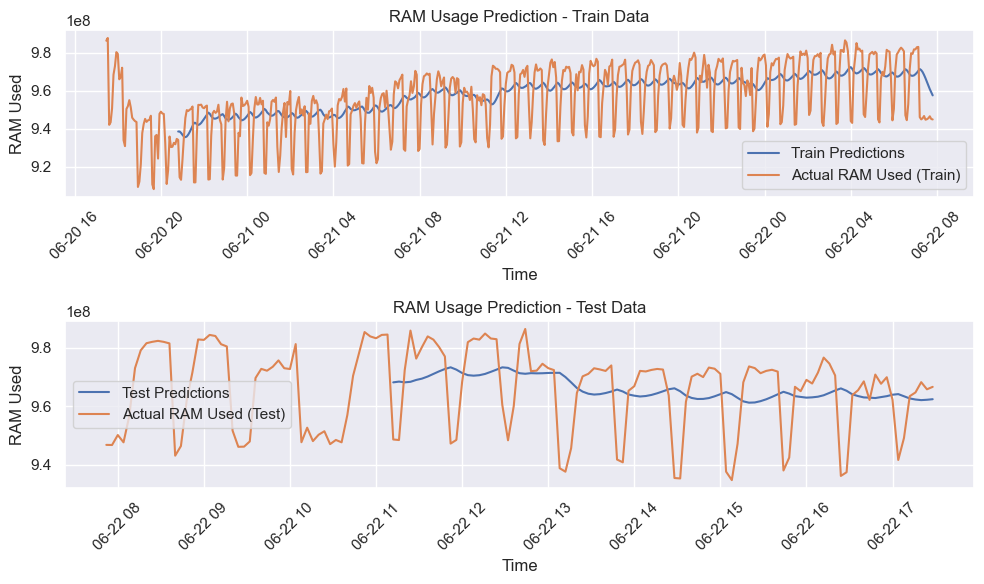

In [631]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping
import matplotlib.pyplot as plt

# Prepare the data
data = df_memory_basic['RAM Used'].values.reshape(-1, 1)

# Normalize the data
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(data)

# Split the data into training and testing sets
train_size = int(len(scaled_data) * 0.8)
train_data = scaled_data[:train_size]
test_data = scaled_data[train_size:]

# Function to create training examples and targets
def create_sequences(data, window_size):
    X = []
    y = []
    for i in range(len(data) - window_size):
        X.append(data[i:i+window_size])
        y.append(data[i+window_size])
    return np.array(X), np.array(y)

# Define the window size for the LSTM model
window_size = 50

# Create training examples and targets
X_train, y_train = create_sequences(train_data, window_size)
X_test, y_test = create_sequences(test_data, window_size)

# Build the LSTM model
model = Sequential()
model.add(LSTM(64, input_shape=(window_size, 1)))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')

# Train the model
early_stopping = EarlyStopping(patience=3, restore_best_weights=True)
model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test), callbacks=[early_stopping])

# Make predictions
train_predictions = model.predict(X_train)
test_predictions = model.predict(X_test)

# Inverse transform the predictions
train_predictions = scaler.inverse_transform(train_predictions)
test_predictions = scaler.inverse_transform(test_predictions)

# Plot the predictions
plt.figure(figsize=(10, 6))
plt.subplot(2, 1, 1)
plt.plot(df_memory_basic.index[window_size:train_size], train_predictions, label='Train Predictions')
plt.plot(df_memory_basic.index[:train_size], df_memory_basic['RAM Used'].values[:train_size], label='Actual RAM Used (Train)')
plt.xlabel('Time')
plt.ylabel('RAM Used')
plt.title('RAM Usage Prediction - Train Data')
plt.legend()
plt.xticks(rotation=45)
plt.grid(True)

plt.subplot(2, 1, 2)
plt.plot(df_memory_basic.index[train_size+window_size:], test_predictions, label='Test Predictions')
plt.plot(df_memory_basic.index[train_size:], df_memory_basic['RAM Used'].values[train_size:], label='Actual RAM Used (Test)')
plt.xlabel('Time')
plt.ylabel('RAM Used')
plt.title('RAM Usage Prediction - Test Data')
plt.legend()
plt.xticks(rotation=45)
plt.grid(True)

plt.tight_layout()
plt.show()


Epoch 1/100
6/6 [==============================] - 2s 94ms/step - loss: 0.3324 - val_loss: 0.3029
Epoch 2/100
6/6 [==============================] - 0s 21ms/step - loss: 0.0867 - val_loss: 0.0149
Epoch 3/100
6/6 [==============================] - 0s 23ms/step - loss: 0.0256 - val_loss: 0.0373
Epoch 4/100
6/6 [==============================] - 0s 27ms/step - loss: 0.0165 - val_loss: 0.0128
Epoch 5/100
6/6 [==============================] - 0s 23ms/step - loss: 0.0118 - val_loss: 0.0239
Epoch 6/100
6/6 [==============================] - 0s 22ms/step - loss: 0.0132 - val_loss: 0.0150
Epoch 7/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0095 - val_loss: 0.0088
Epoch 8/100
6/6 [==============================] - 0s 23ms/step - loss: 0.0098 - val_loss: 0.0089
Epoch 9/100
6/6 [==============================] - 0s 26ms/step - loss: 0.0095 - val_loss: 0.0093
Epoch 10/100
1/1 [==============================] - 0s 15ms/step


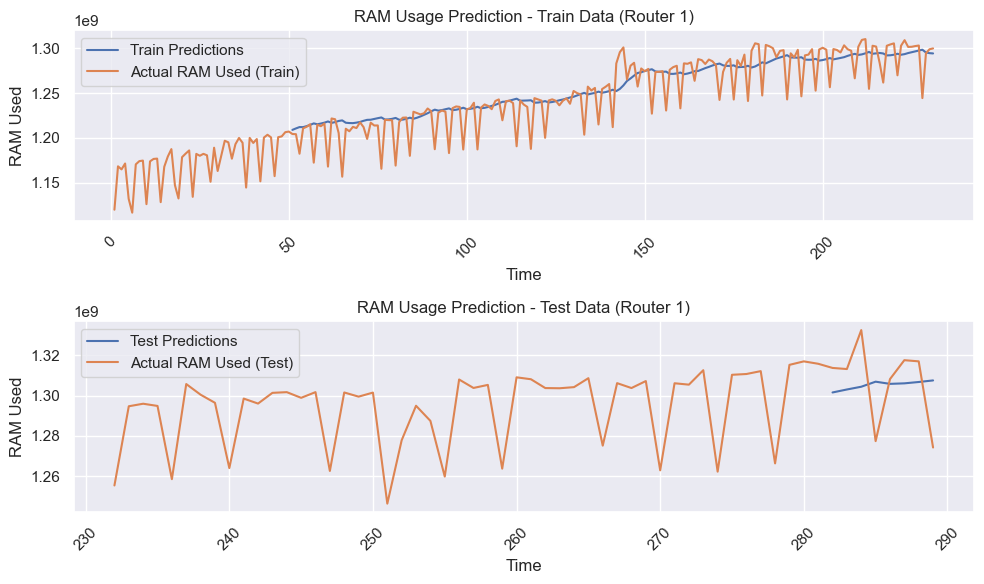

In [632]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping
import matplotlib.pyplot as plt

# Prepare the data
data = df_memory_basic_router1['RAM Used'].values.reshape(-1, 1)

# Normalize the data
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(data)

# Split the data into training and testing sets
train_size = int(len(scaled_data) * 0.8)
train_data = scaled_data[:train_size]
test_data = scaled_data[train_size:]

# Function to create training examples and targets
def create_sequences(data, window_size):
    X = []
    y = []
    for i in range(len(data) - window_size):
        X.append(data[i:i+window_size])
        y.append(data[i+window_size])
    return np.array(X), np.array(y)

# Define the window size for the LSTM model
window_size = 50

# Create training examples and targets
X_train, y_train = create_sequences(train_data, window_size)
X_test, y_test = create_sequences(test_data, window_size)

# Build the LSTM model
model = Sequential()
model.add(LSTM(64, input_shape=(window_size, 1)))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')

# Train the model
early_stopping = EarlyStopping(patience=3, restore_best_weights=True)
model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test), callbacks=[early_stopping])

# Make predictions
train_predictions = model.predict(X_train)
test_predictions = model.predict(X_test)

# Inverse transform the predictions
train_predictions = scaler.inverse_transform(train_predictions)
test_predictions = scaler.inverse_transform(test_predictions)

# Plot the predictions
plt.figure(figsize=(10, 6))
plt.subplot(2, 1, 1)
plt.plot(df_memory_basic_router1.index[window_size:train_size], train_predictions, label='Train Predictions')
plt.plot(df_memory_basic_router1.index[:train_size], df_memory_basic_router1['RAM Used'].values[:train_size], label='Actual RAM Used (Train)')
plt.xlabel('Time')
plt.ylabel('RAM Used')
plt.title('RAM Usage Prediction - Train Data (Router 1)')
plt.legend()
plt.xticks(rotation=45)
plt.grid(True)

plt.subplot(2, 1, 2)
plt.plot(df_memory_basic_router1.index[train_size+window_size:], test_predictions, label='Test Predictions')
plt.plot(df_memory_basic_router1.index[train_size:], df_memory_basic_router1['RAM Used'].values[train_size:], label='Actual RAM Used (Test)')
plt.xlabel('Time')
plt.ylabel('RAM Used')
plt.title('RAM Usage Prediction - Test Data (Router 1)')
plt.legend()
plt.xticks(rotation=45)
plt.grid(True)

plt.tight_layout()
plt.show()


Epoch 1/100
17/17 [==============================] - 8s 45ms/step - loss: 0.1707 - val_loss: 0.0379
Epoch 2/100
17/17 [==============================] - 0s 22ms/step - loss: 0.0412 - val_loss: 0.0322
Epoch 3/100
17/17 [==============================] - 0s 24ms/step - loss: 0.0377 - val_loss: 0.0334
Epoch 4/100
17/17 [==============================] - 0s 23ms/step - loss: 0.0369 - val_loss: 0.0316
Epoch 5/100
17/17 [==============================] - 0s 23ms/step - loss: 0.0360 - val_loss: 0.0316
Epoch 6/100
17/17 [==============================] - 0s 26ms/step - loss: 0.0359 - val_loss: 0.0309
Epoch 7/100
17/17 [==============================] - 0s 24ms/step - loss: 0.0356 - val_loss: 0.0315
Epoch 8/100
17/17 [==============================] - 1s 33ms/step - loss: 0.0349 - val_loss: 0.0307
Epoch 9/100
17/17 [==============================] - 0s 29ms/step - loss: 0.0349 - val_loss: 0.0300
Epoch 10/100
17/17 [==============================] - 0s 27ms/step - loss: 0.0346 - val_loss: 0.0298

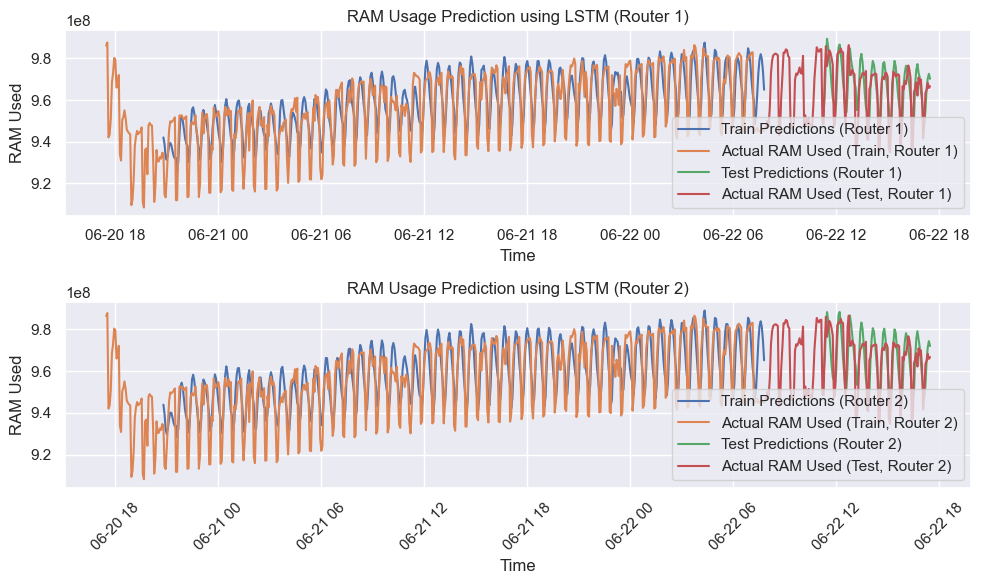

In [637]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping
import matplotlib.pyplot as plt

# Prepare the data for router 1
data_router1 = df_memory_basic['RAM Used'].values.reshape(-1, 1)

# Normalize the data for router 1
scaler_router1 = MinMaxScaler()
scaled_data_router1 = scaler_router1.fit_transform(data_router1)

# Split the data for router 1 into training and testing sets
train_size_router1 = int(len(scaled_data_router1) * 0.8)
train_data_router1 = scaled_data_router1[:train_size_router1]
test_data_router1 = scaled_data_router1[train_size_router1:]

# Function to create training examples and targets
def create_sequences(data, window_size):
    X = []
    y = []
    for i in range(len(data) - window_size):
        X.append(data[i:i+window_size])
        y.append(data[i+window_size])
    return np.array(X), np.array(y)

# Define the window size for the LSTM model
window_size = 50

# Create training examples and targets for router 1
X_train_router1, y_train_router1 = create_sequences(train_data_router1, window_size)
X_test_router1, y_test_router1 = create_sequences(test_data_router1, window_size)

# Build the LSTM model for router 1
model_router1 = Sequential()
model_router1.add(LSTM(64, input_shape=(window_size, 1)))
model_router1.add(Dense(1))
model_router1.compile(loss='mean_squared_error', optimizer='adam')

# Train the model for router 1
early_stopping_router1 = EarlyStopping(patience=3, restore_best_weights=True)
model_router1.fit(X_train_router1, y_train_router1, epochs=100, batch_size=32, validation_data=(X_test_router1, y_test_router1), callbacks=[early_stopping_router1])

# Make predictions for router 1
train_predictions_router1 = model_router1.predict(X_train_router1)
test_predictions_router1 = model_router1.predict(X_test_router1)

# Inverse transform the predictions for router 1
train_predictions_router1 = scaler_router1.inverse_transform(train_predictions_router1)
test_predictions_router1 = scaler_router1.inverse_transform(test_predictions_router1)


# Prepare the data for router 2
data_router2 = df_memory_basic['RAM Used'].values.reshape(-1, 1)

# Normalize the data for router 2
scaler_router2 = MinMaxScaler()
scaled_data_router2 = scaler_router2.fit_transform(data_router2)

# Split the data for router 2 into training and testing sets
train_size_router2 = int(len(scaled_data_router2) * 0.8)
train_data_router2 = scaled_data_router2[:train_size_router2]
test_data_router2 = scaled_data_router2[train_size_router2:]

# Create training examples and targets for router 2
X_train_router2, y_train_router2 = create_sequences(train_data_router2, window_size)
X_test_router2, y_test_router2 = create_sequences(test_data_router2, window_size)

# Build the LSTM model for router 2
model_router2 = Sequential()
model_router2.add(LSTM(64, input_shape=(window_size, 1)))
model_router2.add(Dense(1))
model_router2.compile(loss='mean_squared_error', optimizer='adam')

# Train the model for router 2
early_stopping_router2 = EarlyStopping(patience=3, restore_best_weights=True)
model_router2.fit(X_train_router2, y_train_router2, epochs=100, batch_size=32, validation_data=(X_test_router2, y_test_router2), callbacks=[early_stopping_router2])

# Make predictions for router 2
train_predictions_router2 = model_router2.predict(X_train_router2)
test_predictions_router2 = model_router2.predict(X_test_router2)

# Inverse transform the predictions for router 2
train_predictions_router2 = scaler_router2.inverse_transform(train_predictions_router2)
test_predictions_router2 = scaler_router2.inverse_transform(test_predictions_router2)


# Plot the predictions for both routers
plt.figure(figsize=(10, 6))
plt.subplot(2, 1, 1)
plt.plot(df_memory_basic.index[window_size:train_size_router1], train_predictions_router1, label='Train Predictions (Router 1)')
plt.plot(df_memory_basic.index[:train_size_router1], df_memory_basic['RAM Used'].values[:train_size_router1], label='Actual RAM Used (Train, Router 1)')
plt.plot(df_memory_basic.index[train_size_router1+window_size:], test_predictions_router1, label='Test Predictions (Router 1)')
plt.plot(df_memory_basic.index[train_size_router1:], df_memory_basic['RAM Used'].values[train_size_router1:], label='Actual RAM Used (Test, Router 1)')
plt.xlabel('Time')
plt.ylabel('RAM Used')
plt.title('RAM Usage Prediction using LSTM (Router 1)')
plt.legend()

plt.subplot(2, 1, 2)
plt.plot(df_memory_basic.index[window_size:train_size_router2], train_predictions_router2, label='Train Predictions (Router 2)')
plt.plot(df_memory_basic.index[:train_size_router2], df_memory_basic['RAM Used'].values[:train_size_router2], label='Actual RAM Used (Train, Router 2)')
plt.plot(df_memory_basic.index[train_size_router2+window_size:], test_predictions_router2, label='Test Predictions (Router 2)')
plt.plot(df_memory_basic.index[train_size_router2:], df_memory_basic['RAM Used'].values[train_size_router2:], label='Actual RAM Used (Test, Router 2)')
plt.xlabel('Time')
plt.ylabel('RAM Used')
plt.title('RAM Usage Prediction using LSTM (Router 2)')
plt.legend()

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [639]:
from sklearn.metrics import mean_squared_error

# Calculate RMSE for router 1
rmse_router1 = np.sqrt(mean_squared_error(y_test_router1, test_predictions_router1))

# Calculate RMSE for router 2
rmse_router2 = np.sqrt(mean_squared_error(y_test_router2, test_predictions_router2))

print("RMSE (Router 1):", rmse_router1)
print("RMSE (Router 2):", rmse_router2)


RMSE (Router 1): 966513493.8867714
RMSE (Router 2): 966099589.2199746


In [646]:
df_transmit 

,Time,Gateway_diff_checker
0,6/20/23 17:24,6234292
1,6/20/23 17:26,22306688
2,6/20/23 17:28,4937250
3,6/20/23 17:30,-8657210
4,6/20/23 17:32,5173823
...,...,...
1436,6/22/23 17:16,19167362
1437,6/22/23 17:18,-51422066
1438,6/22/23 17:20,-27842013
1439,6/22/23 17:22,34928573


In [644]:
df_transmit_router1

,Time,Gateway_diff_checker
9,2023-05-11 07:40:00,767793
10,2023-05-11 07:50:00,5903219
11,2023-05-11 08:00:00,5354994
12,2023-05-11 08:10:00,1573091
13,2023-05-11 08:20:00,-9900
...,...,...
293,2023-05-13 07:00:00,8333
294,2023-05-13 07:10:00,4212533
295,2023-05-13 07:20:00,5082999
296,2023-05-13 07:30:00,6338415


In [654]:
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

# Extract the relevant columns for analysis
data = df_transmit[['Time', 'Gateway_diff_checker']]

# Prepare the data for classification
X = data['Gateway_diff_checker'].values.reshape(-1, 1)
y = [1 if val < 0 else 0 for val in X]  # 1 for receiving more data (negative value), 0 for transmitting more data (positive value)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create and train the Random Forest Classifier
model = RandomForestClassifier()
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Print classification report
print(classification_report(y_test, y_pred))


              precision    recall  f1-score   support

           0       1.00      1.00      1.00       191
           1       1.00      1.00      1.00        98

    accuracy                           1.00       289
   macro avg       1.00      1.00      1.00       289
weighted avg       1.00      1.00      1.00       289



In [650]:
df_bedroom2_net

,Time,net_192.168.10.140 wlan1,net_192.168.10.140 wlan2,net_192.168.10.140 wlan3,net_192.168.10.140 wlan4,net_192.168.10.140 wlan5,net_192.168.10.140 wlan6,net_192.168.10.140 wlan7
0,6/20/23 17:24,9950627.0,40.5,40.5,40.5,40.5,40.5,40.5
1,6/20/23 17:26,10340068.0,122.0,122.0,122.0,122.0,122.0,122.0
2,6/20/23 17:28,12126451.0,6385.0,5875.0,6880.0,6859.0,5886.0,6660.0
3,6/20/23 17:30,22991075.0,521.0,597.0,521.0,521.0,597.0,521.0
4,6/20/23 17:32,13186484.0,324.0,284.0,324.0,324.0,284.0,324.0
...,...,...,...,...,...,...,...,...
1436,6/22/23 17:16,1168336.0,256.0,884789.0,932736.0,827749.0,920336.0,817829.0
1437,6/22/23 17:18,320747.0,0.0,614213.0,547253.0,494347.0,633394.0,724160.0
1438,6/22/23 17:20,384400.0,0.0,1526853.0,1430960.0,1370613.0,1107859.0,1411947.0
1439,6/22/23 17:22,683769.0,64.0,1203691.0,1006944.0,614277.0,922114.0,1068117.0


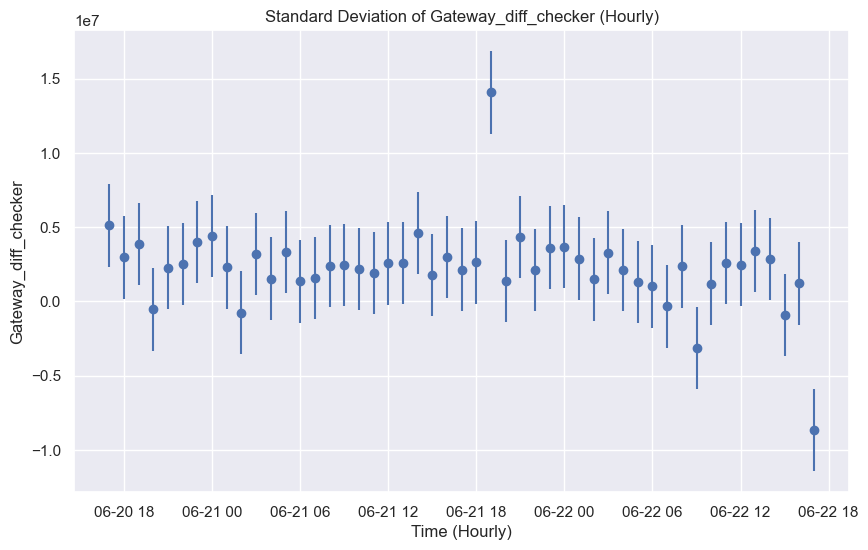

In [658]:
import pandas as pd
import matplotlib.pyplot as plt

# Convert the 'Time' column to datetime if needed
df_transmit['Time'] = pd.to_datetime(df_transmit['Time'])

# Resample the dataframe to hourly frequency
df_hourly = df_transmit.set_index('Time').resample('H').mean().reset_index()

# Compute the standard deviation for the Gateway_diff_checker column
std_dev = df_hourly['Gateway_diff_checker'].std()

# Plot the data with error bars representing the standard deviation
plt.figure(figsize=(10, 6))
plt.errorbar(x=df_hourly['Time'], y=df_hourly['Gateway_diff_checker'], yerr=std_dev, fmt='o')
plt.xlabel('Time (Hourly)')
plt.ylabel('Gateway_diff_checker')
plt.title('Standard Deviation of Gateway_diff_checker (Hourly)')
plt.grid(True)
plt.show()


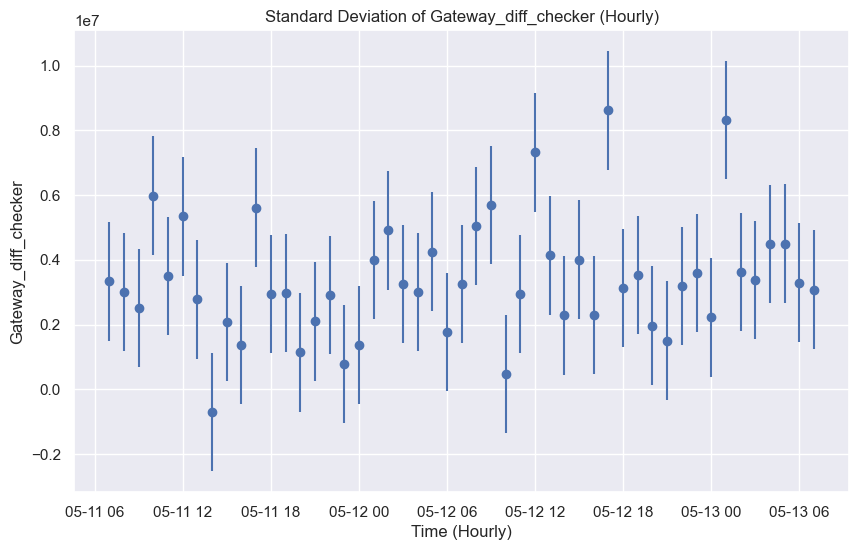

In [672]:
import pandas as pd
import matplotlib.pyplot as plt

# Convert the 'Time' column to datetime if needed
df_transmit['Time'] = pd.to_datetime(df_transmit_router1['Time'])

# Resample the dataframe to hourly frequency
df_hourly = df_transmit_router1.set_index('Time').resample('H').mean().reset_index()

# Compute the standard deviation for the Gateway_diff_checker column
std_dev = df_hourly['Gateway_diff_checker'].std()

# Plot the data with error bars representing the standard deviation
plt.figure(figsize=(10, 6))
plt.errorbar(x=df_hourly['Time'], y=df_hourly['Gateway_diff_checker'], yerr=std_dev, fmt='o')
plt.xlabel('Time (Hourly)')
plt.ylabel('Gateway_diff_checker')
plt.title('Standard Deviation of Gateway_diff_checker (Hourly)')
plt.grid(True)
plt.show()

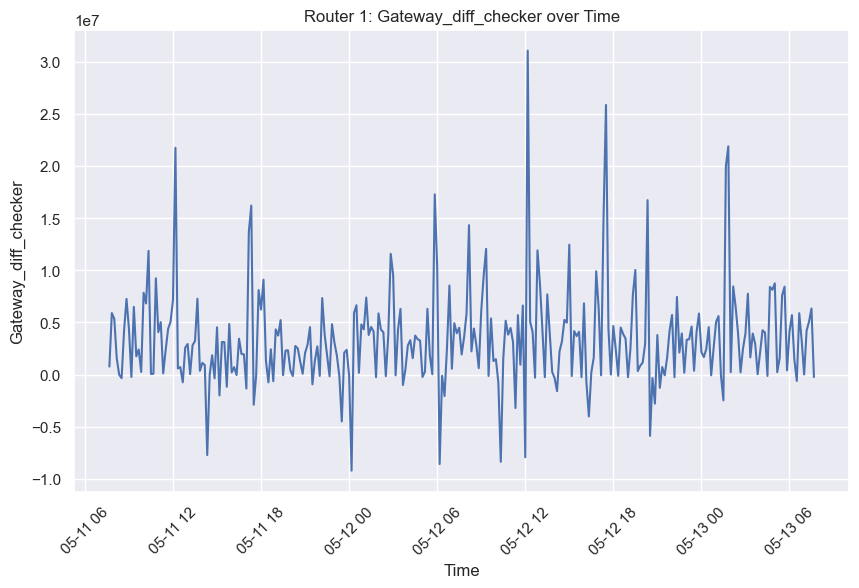

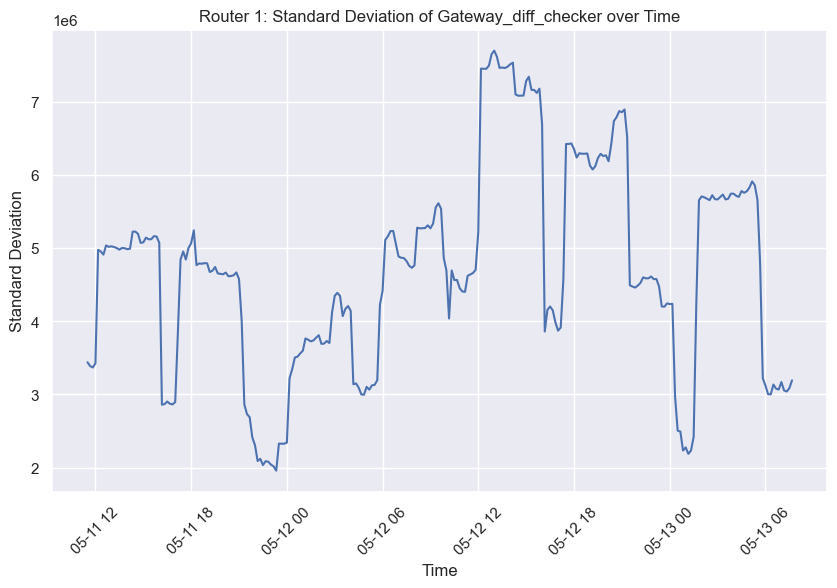

In [682]:
import matplotlib.pyplot as plt

# Line plot for 'Gateway_diff_checker' values over time (Router 1)
plt.figure(figsize=(10, 6))
plt.plot(df_transmit_router1['Time'], df_transmit_router1['Gateway_diff_checker'])
plt.title('Router 1: Gateway_diff_checker over Time')
plt.xlabel('Time')
plt.ylabel('Gateway_diff_checker')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()


# Line plot for standard deviations over time (Router 1)
plt.figure(figsize=(10, 6))
plt.plot(df_transmit_router1['Time'], df_transmit_router1['Gateway_diff_checker'].rolling(window=24).std())
plt.title('Router 1: Standard Deviation of Gateway_diff_checker over Time')
plt.xlabel('Time')
plt.ylabel('Standard Deviation')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()



In [683]:
df_trottle_router1

,Time,Current 0 in thermal-devfreq-0,Current 1 in mutt-pa1,Current 2 in mutt-pa2,Current 3 in mutt-pa1-no-ims,Current 4 in mutt-pa2-no-ims,Current 5 in tx-pwr-pa1,Current 6 in tx-pwr-pa2,Current 7 in scg-off-pa2,Current 8 in thermal-cpufreq-0,Max 0 in thermal-devfreq-0,Max 1 in mutt-pa1,Max 2 in mutt-pa2,Max 3 in mutt-pa1-no-ims,Max 4 in mutt-pa2-no-ims,Max 5 in tx-pwr-pa1,Max 6 in tx-pwr-pa2,Max 7 in scg-off-pa2,Max 8 in thermal-cpufreq-0
1,2023-05-11 07:40:00,0,0,0,0,0,0,0,0,0,3,8,8,1,1,3,3,1,15
2,2023-05-11 07:50:00,0,0,0,0,0,0,0,0,0,3,8,8,1,1,3,3,1,15
3,2023-05-11 08:00:00,0,0,0,0,0,0,0,0,0,3,8,8,1,1,3,3,1,15
4,2023-05-11 08:10:00,0,0,0,0,0,0,0,0,0,3,8,8,1,1,3,3,1,15
5,2023-05-11 08:20:00,0,0,0,0,0,0,0,0,0,3,8,8,1,1,3,3,1,15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
285,2023-05-13 07:00:00,0,0,0,0,0,0,0,0,0,3,8,8,1,1,3,3,1,15
286,2023-05-13 07:10:00,0,0,0,0,0,0,0,0,0,3,8,8,1,1,3,3,1,15
287,2023-05-13 07:20:00,3,0,0,0,0,0,0,0,0,3,8,8,1,1,3,3,1,15
288,2023-05-13 07:30:00,3,0,0,0,0,0,0,0,0,3,8,8,1,1,3,3,1,15


In [684]:
df_trottle_router1 = df_trottle_router1.iloc[:, :2]


In [685]:
df_trottle_router1

,Time,Current 0 in thermal-devfreq-0
1,2023-05-11 07:40:00,0
2,2023-05-11 07:50:00,0
3,2023-05-11 08:00:00,0
4,2023-05-11 08:10:00,0
5,2023-05-11 08:20:00,0
...,...,...
285,2023-05-13 07:00:00,0
286,2023-05-13 07:10:00,0
287,2023-05-13 07:20:00,3
288,2023-05-13 07:30:00,3


In [686]:
df_temp_router1

,Time,Location conn_gps Zone 21,Location cpu_little0 Zone 1,Location cpu_little1 Zone 2,Location cpu_little2 Zone 3,Location cpu_little3 Zone 4,Location dramc Zone 7,Location gpu0 Zone 5,Location gpu1 Zone 6,Location ltepa_ntc Zone 14,...,Location md_rf Zone 20,Location mmsys Zone 8,Location nrpa_ntc Zone 13,Location pmic Zone 16,Location pmic_vcore Zone 17,Location pmic_vgpu Zone 19,Location pmic_vproc Zone 18,Location rf_ntc Zone 15,Location soc_dram_ntc Zone 12,Location soc_max Zone 0
3,2023-05-11 07:40:00,-274,80.8,81.0,81.2,81.2,76.1,74.3,73.8,65.0,...,67,70.8,64.3,70.4,66.9,65.9,66.4,64.6,66.1,81.2
4,2023-05-11 07:44:00,-274,77.3,77.3,77.0,77.1,72.9,72.3,72.3,61.2,...,64,68.3,61.0,66.8,64.3,62.6,63.7,61.4,62.6,77.3
5,2023-05-11 07:48:00,-274,75.1,73.6,73.8,74.4,70.1,69.1,69.3,59.2,...,62,65.5,58.7,64.5,62.1,60.5,61.0,59.1,60.4,75.1
6,2023-05-11 07:52:00,-274,74.7,75.0,75.1,75.4,70.5,69.8,69.7,59.9,...,62,66.1,59.1,65.0,62.1,61.0,61.6,59.4,60.9,75.0
7,2023-05-11 07:56:00,-274,73.9,73.5,73.7,73.8,69.8,68.3,68.2,60.2,...,61,65.3,59.0,64.5,61.6,60.5,60.5,59.3,60.9,73.9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
719,2023-05-13 07:24:00,-274,90.4,91.3,91.5,91.1,85.0,84.5,84.2,73.2,...,75,80.3,71.4,79.3,75.5,73.4,74.5,71.6,74.1,91.5
720,2023-05-13 07:28:00,-274,94.0,93.4,94.0,95.1,88.0,86.9,86.7,74.7,...,77,82.1,73.0,81.1,77.7,75.5,76.6,73.2,75.7,95.0
721,2023-05-13 07:32:00,-274,94.4,94.8,96.0,94.5,88.6,87.8,87.4,76.0,...,78,83.1,74.1,82.3,78.2,76.6,77.7,74.4,76.9,96.2
722,2023-05-13 07:36:00,-274,95.5,96.0,96.6,95.9,89.7,88.7,88.2,76.9,...,78,84.4,75.0,83.5,79.3,77.1,78.2,75.3,77.9,96.6


In [689]:
import pandas as pd

# Assuming 'Time' is the column name for the time in df_temp_router1
df_temp_router1['Time'] = pd.to_datetime(df_temp_router1['Time'])

# Set 'Time' as the index of the dataframe
df_temp_router1.set_index('Time', inplace=True)

# Resample the dataframe at every 10-minute interval
df_temp_router1 = df_temp_router1.resample('10T').mean()

# Reset the index to make 'Time' a regular column
df_temp_router1.reset_index(inplace=True)


In [690]:

df_temp_router1

,Time,Location conn_gps Zone 21,Location cpu_little0 Zone 1,Location cpu_little1 Zone 2,Location cpu_little2 Zone 3,Location cpu_little3 Zone 4,Location dramc Zone 7,Location gpu0 Zone 5,Location gpu1 Zone 6,Location ltepa_ntc Zone 14,...,Location md_rf Zone 20,Location mmsys Zone 8,Location nrpa_ntc Zone 13,Location pmic Zone 16,Location pmic_vcore Zone 17,Location pmic_vgpu Zone 19,Location pmic_vproc Zone 18,Location rf_ntc Zone 15,Location soc_dram_ntc Zone 12,Location soc_max Zone 0
0,2023-05-11 07:40:00,-274.0,77.733333,77.300000,77.333333,77.566667,73.033333,71.900000,71.800000,61.800000,...,64.333333,68.200000,61.333333,67.233333,64.433333,63.000000,63.700000,61.700000,63.033333,77.866667
1,2023-05-11 07:50:00,-274.0,74.300000,74.250000,74.400000,74.600000,70.150000,69.050000,68.950000,60.050000,...,61.500000,65.700000,59.050000,64.750000,61.850000,60.750000,61.050000,59.350000,60.900000,74.450000
2,2023-05-11 08:00:00,-274.0,75.600000,75.266667,75.633333,75.833333,71.100000,70.066667,69.966667,60.666667,...,-49.333333,66.800000,59.600000,65.400000,62.633333,61.000000,61.733333,59.933333,61.533333,76.066667
3,2023-05-11 08:10:00,-274.0,75.450000,75.600000,75.900000,75.650000,71.150000,70.100000,69.950000,60.900000,...,62.500000,66.700000,59.900000,65.600000,62.900000,61.300000,62.100000,60.250000,61.800000,75.750000
4,2023-05-11 08:20:00,-274.0,72.166667,72.500000,72.866667,72.300000,67.933333,67.333333,67.033333,57.066667,...,60.666667,63.500000,56.733333,62.466667,59.966667,58.333333,59.433333,57.100000,58.300000,72.766667
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284,2023-05-13 07:00:00,-274.0,76.833333,77.433333,77.933333,77.466667,72.166667,71.300000,71.000000,61.033333,...,63.333333,67.266667,60.200000,66.600000,63.500000,61.900000,62.833333,60.566667,62.100000,77.800000
285,2023-05-13 07:10:00,-274.0,82.800000,82.900000,83.400000,83.350000,77.900000,76.600000,76.350000,67.050000,...,68.500000,72.800000,65.100000,71.900000,68.550000,66.650000,67.500000,65.450000,67.900000,83.400000
286,2023-05-13 07:20:00,-274.0,90.866667,91.266667,91.933333,91.566667,85.500000,84.733333,84.466667,73.133333,...,74.666667,80.200000,71.366667,79.100000,75.533333,73.566667,74.633333,71.633333,74.066667,92.266667
287,2023-05-13 07:30:00,-274.0,94.950000,95.400000,96.300000,95.200000,89.150000,88.250000,87.800000,76.450000,...,78.000000,83.750000,74.550000,82.900000,78.750000,76.850000,77.950000,74.850000,77.400000,96.400000


In [691]:
# Assuming 'Time' is the common column name for time in both dataframes
merged_df = pd.merge(df_temp_router1, df_trottle_router1, on='Time')


In [693]:
merged_df = merged_df.rename(columns={'Current 0 in thermal-devfreq-0': 'cooling_periods'})


In [694]:
merged_df

,Time,Location conn_gps Zone 21,Location cpu_little0 Zone 1,Location cpu_little1 Zone 2,Location cpu_little2 Zone 3,Location cpu_little3 Zone 4,Location dramc Zone 7,Location gpu0 Zone 5,Location gpu1 Zone 6,Location ltepa_ntc Zone 14,...,Location mmsys Zone 8,Location nrpa_ntc Zone 13,Location pmic Zone 16,Location pmic_vcore Zone 17,Location pmic_vgpu Zone 19,Location pmic_vproc Zone 18,Location rf_ntc Zone 15,Location soc_dram_ntc Zone 12,Location soc_max Zone 0,cooling_periods
0,2023-05-11 07:40:00,-274.0,77.733333,77.300000,77.333333,77.566667,73.033333,71.900000,71.800000,61.800000,...,68.200000,61.333333,67.233333,64.433333,63.000000,63.700000,61.700000,63.033333,77.866667,0
1,2023-05-11 07:50:00,-274.0,74.300000,74.250000,74.400000,74.600000,70.150000,69.050000,68.950000,60.050000,...,65.700000,59.050000,64.750000,61.850000,60.750000,61.050000,59.350000,60.900000,74.450000,0
2,2023-05-11 08:00:00,-274.0,75.600000,75.266667,75.633333,75.833333,71.100000,70.066667,69.966667,60.666667,...,66.800000,59.600000,65.400000,62.633333,61.000000,61.733333,59.933333,61.533333,76.066667,0
3,2023-05-11 08:10:00,-274.0,75.450000,75.600000,75.900000,75.650000,71.150000,70.100000,69.950000,60.900000,...,66.700000,59.900000,65.600000,62.900000,61.300000,62.100000,60.250000,61.800000,75.750000,0
4,2023-05-11 08:20:00,-274.0,72.166667,72.500000,72.866667,72.300000,67.933333,67.333333,67.033333,57.066667,...,63.500000,56.733333,62.466667,59.966667,58.333333,59.433333,57.100000,58.300000,72.766667,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284,2023-05-13 07:00:00,-274.0,76.833333,77.433333,77.933333,77.466667,72.166667,71.300000,71.000000,61.033333,...,67.266667,60.200000,66.600000,63.500000,61.900000,62.833333,60.566667,62.100000,77.800000,0
285,2023-05-13 07:10:00,-274.0,82.800000,82.900000,83.400000,83.350000,77.900000,76.600000,76.350000,67.050000,...,72.800000,65.100000,71.900000,68.550000,66.650000,67.500000,65.450000,67.900000,83.400000,0
286,2023-05-13 07:20:00,-274.0,90.866667,91.266667,91.933333,91.566667,85.500000,84.733333,84.466667,73.133333,...,80.200000,71.366667,79.100000,75.533333,73.566667,74.633333,71.633333,74.066667,92.266667,3
287,2023-05-13 07:30:00,-274.0,94.950000,95.400000,96.300000,95.200000,89.150000,88.250000,87.800000,76.450000,...,83.750000,74.550000,82.900000,78.750000,76.850000,77.950000,74.850000,77.400000,96.400000,3


In [696]:
merged_df.columns

Index(['Time', 'Location conn_gps      Zone 21',
       'Location cpu_little0      Zone 1', 'Location cpu_little1      Zone 2',
       'Location cpu_little2      Zone 3', 'Location cpu_little3      Zone 4',
       'Location dramc      Zone 7', 'Location gpu0      Zone 5',
       'Location gpu1      Zone 6', 'Location ltepa_ntc      Zone 14',
       'Location md_3g      Zone 11', 'Location md_4g      Zone 10',
       'Location md_5g      Zone 9', 'Location md_rf      Zone 20',
       'Location mmsys      Zone 8', 'Location nrpa_ntc      Zone 13',
       'Location pmic      Zone 16', 'Location pmic_vcore      Zone 17',
       'Location pmic_vgpu      Zone 19', 'Location pmic_vproc      Zone 18',
       'Location rf_ntc      Zone 15', 'Location soc_dram_ntc      Zone 12',
       'Location soc_max      Zone 0', 'cooling_periods'],
      dtype='object')

In [697]:
# Filter the dataframe based on cooling periods
cooling_periods = merged_df[merged_df['cooling_periods'] == 3]

# Select the temperature columns
temperature_columns = ['Location conn_gps      Zone 21', 'Location cpu_little0      Zone 1', 'Location cpu_little1      Zone 2', 'Location cpu_little2      Zone 3', 'Location cpu_little3      Zone 4', 'Location dramc      Zone 7', 'Location gpu0      Zone 5', 'Location gpu1      Zone 6', 'Location ltepa_ntc      Zone 14', 'Location md_3g      Zone 11', 'Location md_4g      Zone 10', 'Location md_5g      Zone 9', 'Location md_rf      Zone 20', 'Location mmsys      Zone 8', 'Location nrpa_ntc      Zone 13', 'Location pmic      Zone 16', 'Location pmic_vcore      Zone 17', 'Location pmic_vgpu      Zone 19', 'Location pmic_vproc      Zone 18', 'Location rf_ntc      Zone 15', 'Location soc_dram_ntc      Zone 12', 'Location soc_max      Zone 0']

# Select the relevant columns for analysis
analysis_columns = ['Time'] + temperature_columns

# Subset the dataframe to include only the relevant columns during cooling periods
cooling_period_data = cooling_periods[analysis_columns]

# Print the cooling period data
print(cooling_period_data)


                   Time  Location conn_gps      Zone 21  \
11  2023-05-11 09:30:00                          -274.0   
12  2023-05-11 09:40:00                          -274.0   
15  2023-05-11 10:10:00                          -274.0   
16  2023-05-11 10:20:00                          -274.0   
17  2023-05-11 10:30:00                          -274.0   
..                  ...                             ...   
280 2023-05-13 06:20:00                          -274.0   
281 2023-05-13 06:30:00                          -274.0   
286 2023-05-13 07:20:00                          -274.0   
287 2023-05-13 07:30:00                          -274.0   
288 2023-05-13 07:40:00                          -274.0   

     Location cpu_little0      Zone 1  Location cpu_little1      Zone 2  \
11                          88.700000                         88.050000   
12                          89.500000                         89.266667   
15                          88.050000                         87.8

In [699]:
cooling_period_data

,Time,Location conn_gps Zone 21,Location cpu_little0 Zone 1,Location cpu_little1 Zone 2,Location cpu_little2 Zone 3,Location cpu_little3 Zone 4,Location dramc Zone 7,Location gpu0 Zone 5,Location gpu1 Zone 6,Location ltepa_ntc Zone 14,...,Location md_rf Zone 20,Location mmsys Zone 8,Location nrpa_ntc Zone 13,Location pmic Zone 16,Location pmic_vcore Zone 17,Location pmic_vgpu Zone 19,Location pmic_vproc Zone 18,Location rf_ntc Zone 15,Location soc_dram_ntc Zone 12,Location soc_max Zone 0
11,2023-05-11 09:30:00,-274.0,88.700000,88.050000,88.950000,88.550000,83.200000,81.800000,81.500000,71.700000,...,73.500000,77.950000,69.800000,76.950000,73.400000,71.500000,72.300000,70.000000,72.550000,89.150000
12,2023-05-11 09:40:00,-274.0,89.500000,89.266667,90.133333,90.366667,84.800000,83.566667,83.333333,73.100000,...,75.666667,79.900000,71.700000,79.300000,75.333333,73.566667,74.466667,72.033333,74.133333,90.300000
15,2023-05-11 10:10:00,-274.0,88.050000,87.850000,88.200000,88.400000,82.750000,80.850000,80.300000,71.950000,...,72.500000,77.400000,69.950000,76.650000,72.850000,71.500000,72.000000,70.150000,72.600000,88.350000
16,2023-05-11 10:20:00,-274.0,91.266667,91.600000,92.100000,91.666667,86.666667,85.566667,85.266667,75.166667,...,77.333333,81.666667,73.333333,80.900000,77.133333,75.333333,76.266667,73.600000,76.033333,91.966667
17,2023-05-11 10:30:00,-274.0,86.150000,86.200000,86.750000,87.000000,81.200000,80.250000,80.100000,68.750000,...,72.500000,76.000000,68.450000,75.750000,72.050000,70.400000,71.500000,68.850000,70.200000,87.300000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
280,2023-05-13 06:20:00,-274.0,90.866667,90.333333,90.866667,91.733333,85.266667,83.833333,83.466667,73.066667,...,75.666667,79.933333,72.100000,79.933333,75.533333,73.933333,75.000000,72.400000,74.233333,91.733333
281,2023-05-13 06:30:00,-274.0,82.450000,82.300000,82.550000,83.000000,77.600000,77.100000,76.850000,66.200000,...,68.500000,73.100000,65.300000,72.200000,69.100000,67.200000,68.300000,65.700000,67.350000,83.150000
286,2023-05-13 07:20:00,-274.0,90.866667,91.266667,91.933333,91.566667,85.500000,84.733333,84.466667,73.133333,...,74.666667,80.200000,71.366667,79.100000,75.533333,73.566667,74.633333,71.633333,74.066667,92.266667
287,2023-05-13 07:30:00,-274.0,94.950000,95.400000,96.300000,95.200000,89.150000,88.250000,87.800000,76.450000,...,78.000000,83.750000,74.550000,82.900000,78.750000,76.850000,77.950000,74.850000,77.400000,96.400000


In [709]:
temperatures_after_cooling

,Location conn_gps Zone 21,Location cpu_little0 Zone 1,Location cpu_little1 Zone 2,Location cpu_little2 Zone 3,Location cpu_little3 Zone 4,Location dramc Zone 7,Location gpu0 Zone 5,Location gpu1 Zone 6,Location ltepa_ntc Zone 14,Location md_3g Zone 11,...,Location md_rf Zone 20,Location mmsys Zone 8,Location nrpa_ntc Zone 13,Location pmic Zone 16,Location pmic_vcore Zone 17,Location pmic_vgpu Zone 19,Location pmic_vproc Zone 18,Location rf_ntc Zone 15,Location soc_dram_ntc Zone 12,Location soc_max Zone 0


In [713]:
# Drop columns that are empty
df_traffic = df_traffic.dropna(axis=1, how='all')

# Drop columns that are filled with zeros
df_traffic = df_traffic.loc[:, (df_traffic != 0).any(axis=0)]


In [714]:
df_traffic

,Time,brlan0 - Receive,ccmni0 - Receive,cni0 - Receive,eth1 - Receive,eth_lan1 - Receive,eth_lan2 - Receive,lo - Receive,ra0 - Receive,rai0 - Receive,...,ra0 - Transmit,rai0 - Transmit,veth297478ae - Transmit,veth56438467 - Transmit,veth680f0a39 - Transmit,veth8fcf06f1 - Transmit,vetha1dcb680 - Transmit,vethb848bf5d - Transmit,vethbd5aced0 - Transmit,xlat - Transmit
0,2023-06-20 17:32:00,1477,214.0,3324,187057979,0,13791,0,2965.0,9071,...,15473964,177845571.0,142.0,163463,0.0,0.0,0.0,0.0,0.0,422.0
1,2023-06-20 17:36:00,19387,66410.0,3104,6369,4717,862,0,8517.0,23493,...,4803,39905.0,164.0,152593,0.0,0.0,0.0,0.0,0.0,7037.0
2,2023-06-20 17:40:00,13958,241.0,3148,5666,321,4318,0,0.0,17040,...,0,9198.0,158.0,152535,0.0,0.0,0.0,0.0,0.0,465.0
3,2023-06-20 17:44:00,27559,70.4,3324,115848862,0,1374367,0,0.0,132538,...,0,103555577.0,92.8,163450,0.0,0.0,0.0,0.0,0.0,66.1
4,2023-06-20 17:48:00,6553,0.0,3076,124229639,0,318530,0,0.0,81565,...,0,116498674.0,35.2,152534,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
716,2023-06-22 17:16:00,57780,249790.0,3104,67055358,0,197655,0,0.0,131732,...,0,74127050.0,142.0,192039,0.0,0.0,0.0,0.0,0.0,60058.0
717,2023-06-22 17:20:00,59230,153698.0,3296,118878031,0,167385,0,0.0,94070,...,0,121746625.0,71.5,205716,0.0,0.0,0.0,0.0,0.0,61796.0
718,2023-06-22 17:24:00,109253,227231.0,3396,112624575,0,202508,0,0.0,220812,...,0,101598005.0,158.0,205716,0.0,0.0,0.0,0.0,0.0,114033.0
719,2023-06-22 17:28:00,14092,144694.0,3104,78225369,0,198425,0,0.0,111529,...,0,65334874.0,107.0,192004,0.0,0.0,0.0,0.0,0.0,14509.0


In [715]:
df_traffic.columns

Index(['Time', 'brlan0 - Receive', 'ccmni0 - Receive', 'cni0 - Receive',
       'eth1 - Receive', 'eth_lan1 - Receive', 'eth_lan2 - Receive',
       'lo - Receive', 'ra0 - Receive', 'rai0 - Receive',
       'veth297478ae - Receive', 'veth56438467 - Receive',
       'veth680f0a39 - Receive', 'veth8fcf06f1 - Receive',
       'vetha1dcb680 - Receive', 'vethb848bf5d - Receive',
       'vethbd5aced0 - Receive', 'xlat - Receive', 'brlan0 - Transmit',
       'ccmni0 - Transmit', 'cni0 - Transmit', 'eth1 - Transmit',
       'eth_lan1 - Transmit', 'eth_lan2 - Transmit', 'lo - Transmit',
       'ra0 - Transmit', 'rai0 - Transmit', 'veth297478ae - Transmit',
       'veth56438467 - Transmit', 'veth680f0a39 - Transmit',
       'veth8fcf06f1 - Transmit', 'vetha1dcb680 - Transmit',
       'vethb848bf5d - Transmit', 'vethbd5aced0 - Transmit',
       'xlat - Transmit'],
      dtype='object')

In [723]:

receive_columns = [column for column in df_traffic.columns if "Receive" in column]
transmit_columns = [column for column in df_traffic.columns if "Transmit" in column]

new_columns = []
for receive_col, transmit_col in zip(receive_columns, transmit_columns):
    receive_process = receive_col.split(" - ")[0]
    transmit_process = transmit_col.split(" - ")[0]
    new_columns.extend([receive_col, transmit_col])

df_traffic_processed = df_traffic[new_columns]


In [724]:
df_traffic_processed

,brlan0 - Receive,brlan0 - Transmit,ccmni0 - Receive,ccmni0 - Transmit,cni0 - Receive,cni0 - Transmit,eth1 - Receive,eth1 - Transmit,eth_lan1 - Receive,eth_lan1 - Transmit,...,veth8fcf06f1 - Receive,veth8fcf06f1 - Transmit,vetha1dcb680 - Receive,vetha1dcb680 - Transmit,vethb848bf5d - Receive,vethb848bf5d - Transmit,vethbd5aced0 - Receive,vethbd5aced0 - Transmit,xlat - Receive,xlat - Transmit
Time,,,,,,,,,,,,,,,,,,,,,
2023-06-20 17:32:00,1477,30029,214.0,229.0,3324,163427,187057979,2071204,0,352.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,422.0,422.0
2023-06-20 17:36:00,19387,51029,66410.0,12674.0,3104,152534,6369,74678,4717,6056.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6973.0,7037.0
2023-06-20 17:40:00,13958,35269,241.0,409.0,3148,152586,5666,57667,321,11713.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,411.0,465.0
2023-06-20 17:44:00,27559,1847552,70.4,96.0,3324,163427,115848862,4444763,0,758.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,66.1,66.1
2023-06-20 17:48:00,6553,35068,0.0,0.0,3076,152499,124229639,1970057,0,72.5,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-06-22 17:16:00,57780,31364,249790.0,60030.0,3104,192003,67055358,1543069,0,428.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,56154.0,60058.0
2023-06-22 17:20:00,59230,32078,153698.0,61562.0,3296,205680,118878031,2135328,0,290.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,57540.0,61796.0
2023-06-22 17:24:00,109253,31445,227231.0,113961.0,3396,205767,112624575,2087585,0,145.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,107398.0,114033.0


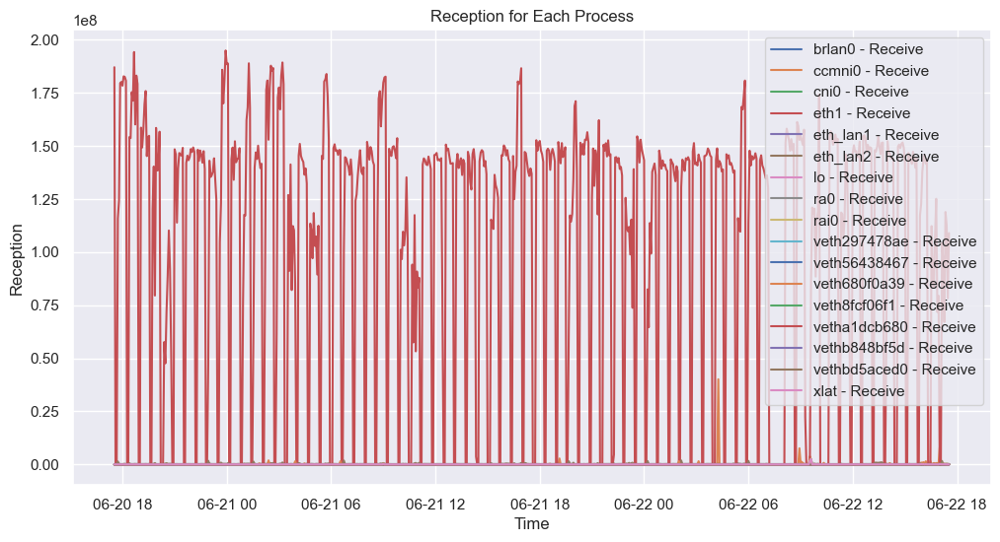

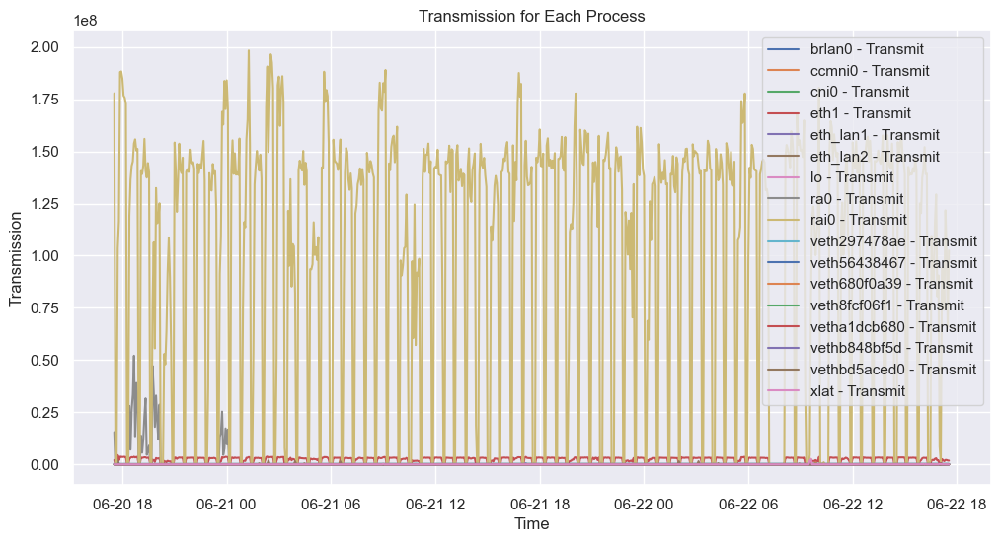

In [727]:
import matplotlib.pyplot as plt

# Get the columns for reception and transmission
receive_columns = df_traffic_processed.columns[df_traffic_processed.columns.str.contains('Receive')]
transmit_columns = df_traffic_processed.columns[df_traffic_processed.columns.str.contains('Transmit')]

# Plot reception for each process
plt.figure(figsize=(12, 6))
for column in receive_columns:
    plt.plot(df_traffic_processed.index, df_traffic_processed[column], label=column)
plt.xlabel('Time')
plt.ylabel('Reception')
plt.title('Reception for Each Process')
plt.legend()
plt.show()

# Plot transmission for each process
plt.figure(figsize=(12, 6))
for column in transmit_columns:
    plt.plot(df_traffic_processed.index, df_traffic_processed[column], label=column)
plt.xlabel('Time')
plt.ylabel('Transmission')
plt.title('Transmission for Each Process')
plt.legend()
plt.show()


In [730]:
print(df_traffic_processed.columns)


Index(['brlan0 - Receive', 'brlan0 - Transmit', 'ccmni0 - Receive',
       'ccmni0 - Transmit', 'cni0 - Receive', 'cni0 - Transmit',
       'eth1 - Receive', 'eth1 - Transmit', 'eth_lan1 - Receive',
       'eth_lan1 - Transmit', 'eth_lan2 - Receive', 'eth_lan2 - Transmit',
       'lo - Receive', 'lo - Transmit', 'ra0 - Receive', 'ra0 - Transmit',
       'rai0 - Receive', 'rai0 - Transmit', 'veth297478ae - Receive',
       'veth297478ae - Transmit', 'veth56438467 - Receive',
       'veth56438467 - Transmit', 'veth680f0a39 - Receive',
       'veth680f0a39 - Transmit', 'veth8fcf06f1 - Receive',
       'veth8fcf06f1 - Transmit', 'vetha1dcb680 - Receive',
       'vetha1dcb680 - Transmit', 'vethb848bf5d - Receive',
       'vethb848bf5d - Transmit', 'vethbd5aced0 - Receive',
       'vethbd5aced0 - Transmit', 'xlat - Receive', 'xlat - Transmit'],
      dtype='object')


,eth1 - Receive,rai0 - Transmit,ra0 - Transmit,ccmni0 - Receive,eth1 - Transmit
Time,,,,,
2023-06-20 17:32:00,187057979,177845571.0,15473964,214.0,2071204
2023-06-20 17:36:00,6369,39905.0,4803,66410.0,74678
2023-06-20 17:40:00,5666,9198.0,0,241.0,57667
2023-06-20 17:44:00,115848862,103555577.0,0,70.4,4444763
2023-06-20 17:48:00,124229639,116498674.0,0,0.0,1970057
...,...,...,...,...,...
2023-06-22 17:16:00,67055358,74127050.0,0,249790.0,1543069
2023-06-22 17:20:00,118878031,121746625.0,0,153698.0,2135328
2023-06-22 17:24:00,112624575,101598005.0,0,227231.0,2087585


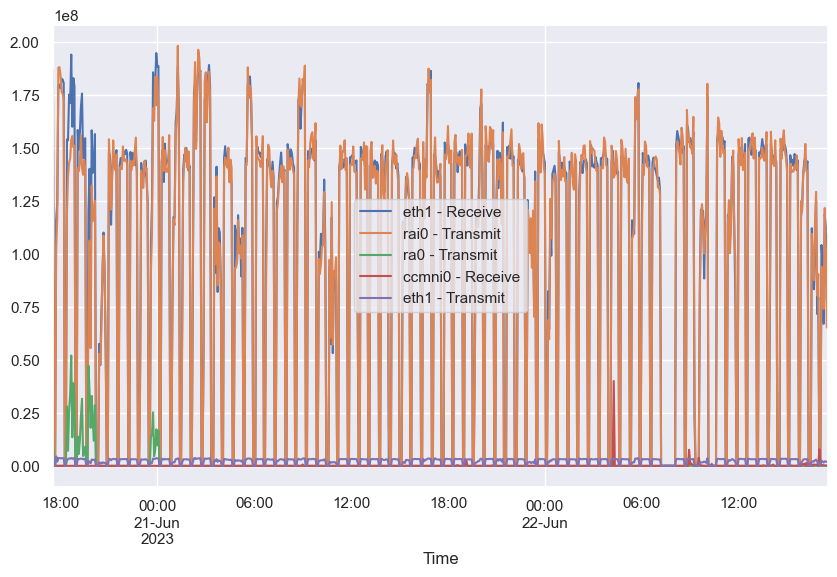

In [733]:
import numpy as np

# Calculate the standard deviation for each process
process_std = df_traffic_processed.std()

# Sort the processes based on standard deviation
sorted_processes = process_std.sort_values(ascending=False)

# Select the top processes with the highest standard deviation
top_processes = sorted_processes.head(5)

# Plot the reception data for the top processes
df_top_processes = df_traffic_processed[top_processes.index]
df_top_processes.plot(figsize=(10, 6))
df_top_processes

KeyError: "None of [Index(['Time', 'eth1', 'rai0', 'ra0', 'ccmni0'], dtype='object')] are in the [columns]"

<Axes: xlabel='Time'>

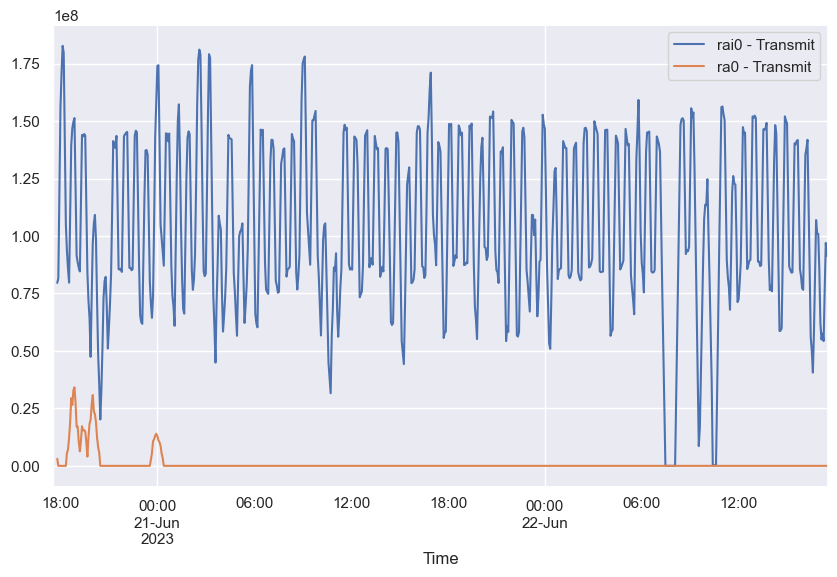

In [738]:
# Select the 'rai0' and 'ra0' reception and transmission columns
df_rai0_ra0 = df_traffic_processed[['rai0 - Transmit', 'ra0 - Transmit']]

# Apply a moving average with window size 5 to smooth the data
window_size = 5
df_rai0_ra0_smoothed = df_rai0_ra0.rolling(window=window_size).mean()

# Plot the smoothed reception and transmission data for 'rai0' and 'ra0'
df_rai0_ra0_smoothed.plot(figsize=(10, 6))


C:\Users\mwj97\anaconda4\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency 4T will be used.

C:\Users\mwj97\anaconda4\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency 4T will be used.

C:\Users\mwj97\anaconda4\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency 4T will be used.

C:\Users\mwj97\anaconda4\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency 4T will be used.

C:\Users\mwj97\anaconda4\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency 4T will be used.

C:\Users\mwj97\anaconda4\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency informatio

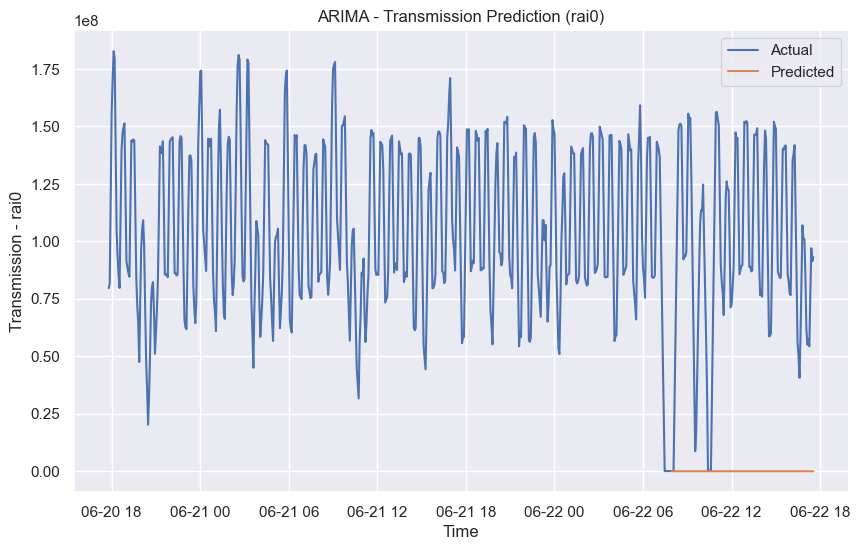

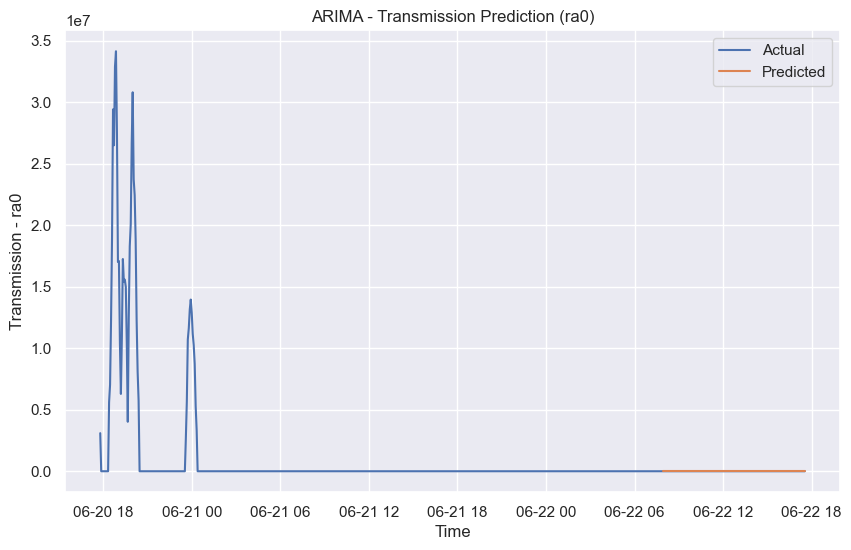

In [747]:
from statsmodels.tsa.arima.model import ARIMA

# Split the data into train and test sets
train_size = int(len(df_rai0_ra0_smoothed) * 0.8)
train_data, test_data = df_rai0_ra0_smoothed[:train_size], df_rai0_ra0_smoothed[train_size:]

# Fit the ARIMA model for 'rai0' transmission
model_rai0 = ARIMA(train_data['rai0 - Transmit'], order=(1, 1, 1))
model_fit_rai0 = model_rai0.fit()

# Fit the ARIMA model for 'ra0' transmission
model_ra0 = ARIMA(train_data['ra0 - Transmit'], order=(1, 1, 1))
model_fit_ra0 = model_ra0.fit()

# Make predictions on the test set for 'rai0' transmission
predictions_rai0 = model_fit_rai0.predict(start=len(train_data), end=len(df_rai0_ra0_smoothed)-1)

# Make predictions on the test set for 'ra0' transmission
predictions_ra0 = model_fit_ra0.predict(start=len(train_data), end=len(df_rai0_ra0_smoothed)-1)

# Plot the actual and predicted values for 'rai0' transmission
plt.figure(figsize=(10, 6))
plt.plot(df_rai0_ra0_smoothed.index, df_rai0_ra0_smoothed['rai0 - Transmit'], label='Actual')
plt.plot(predictions_rai0.index, predictions_rai0, label='Predicted')
plt.xlabel('Time')
plt.ylabel('Transmission - rai0')
plt.title('ARIMA - Transmission Prediction (rai0)')
plt.legend()
plt.show()

# Plot the actual and predicted values for 'ra0' transmission
plt.figure(figsize=(10, 6))
plt.plot(df_rai0_ra0_smoothed.index, df_rai0_ra0_smoothed['ra0 - Transmit'], label='Actual')
plt.plot(predictions_ra0.index, predictions_ra0, label='Predicted')
plt.xlabel('Time')
plt.ylabel('Transmission - ra0')
plt.title('ARIMA - Transmission Prediction (ra0)')
plt.legend()
plt.show()


In [753]:
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Assuming you have a DataFrame called 'df_rai0' with the index as the time and a column 'rai0 - Transmit'
# Prepare the data
X = df_traffic.index.values.reshape(-1, 1)  # Features: Time index
y = df_traffic['rai0 - Transmit']  # Target: rai0 - Transmit

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Define the Random Forest model
model = RandomForestRegressor(n_estimators=100, random_state=42)

# Train the model
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
print(f"RMSE: {rmse}")


RMSE: 117424205.98431922


In [754]:
df_bedroom2_net

,Time,net_192.168.10.140 wlan1,net_192.168.10.140 wlan2,net_192.168.10.140 wlan3,net_192.168.10.140 wlan4,net_192.168.10.140 wlan5,net_192.168.10.140 wlan6,net_192.168.10.140 wlan7
0,6/20/23 17:24,9950627.0,40.5,40.5,40.5,40.5,40.5,40.5
1,6/20/23 17:26,10340068.0,122.0,122.0,122.0,122.0,122.0,122.0
2,6/20/23 17:28,12126451.0,6385.0,5875.0,6880.0,6859.0,5886.0,6660.0
3,6/20/23 17:30,22991075.0,521.0,597.0,521.0,521.0,597.0,521.0
4,6/20/23 17:32,13186484.0,324.0,284.0,324.0,324.0,284.0,324.0
...,...,...,...,...,...,...,...,...
1436,6/22/23 17:16,1168336.0,256.0,884789.0,932736.0,827749.0,920336.0,817829.0
1437,6/22/23 17:18,320747.0,0.0,614213.0,547253.0,494347.0,633394.0,724160.0
1438,6/22/23 17:20,384400.0,0.0,1526853.0,1430960.0,1370613.0,1107859.0,1411947.0
1439,6/22/23 17:22,683769.0,64.0,1203691.0,1006944.0,614277.0,922114.0,1068117.0


In [755]:
df_recroom2_net

,Time,net_192.168.10.160 wlan1,net_192.168.10.160 wlan2,net_192.168.10.160 wlan3,net_192.168.10.160 wlan4,net_192.168.10.160 wlan5,net_192.168.10.160 wlan6,net_192.168.10.160 wlan7
0,6/20/23 17:24,9736480.0,0.0,0.0,167.0,0.0,0.0,60.8
1,6/20/23 17:26,10360665.0,0.0,0.0,126.0,167.0,0.0,0.0
2,6/20/23 17:28,10625100.0,1251.0,508.0,1696.0,1989.0,1696.0,1696.0
3,6/20/23 17:30,18052726.0,602.0,182.0,678.0,861.0,678.0,678.0
4,6/20/23 17:32,11254067.0,284.0,122.0,446.0,572.0,446.0,446.0
...,...,...,...,...,...,...,...,...
1436,6/22/23 17:16,215433.0,688235.0,903168.0,2207049.0,836375.0,651035.0,417915.0
1437,6/22/23 17:18,398453.0,734907.0,942400.0,1107794.0,858559.0,858907.0,520800.0
1438,6/22/23 17:20,1096339.0,753221.0,1207888.0,1056608.0,2664234.0,821008.0,842501.0
1439,6/22/23 17:22,420773.0,204187.0,1049867.0,457973.0,149952.0,429867.0,362907.0


In [756]:
df_bedroom1_net

,Time,net_192.168.10.130 wlan1,net_192.168.10.130 wlan2,net_192.168.10.130 wlan3,net_192.168.10.130 wlan4,net_192.168.10.130 wlan5,net_192.168.10.130 wlan6,net_192.168.10.130 wlan7
0,6/20/23 17:24,9148881.0,0.0,0.0,0.0,126.0,0.0,0.0
1,6/20/23 17:26,10340636.0,0.0,0.0,0.0,0.0,0.0,0.0
2,6/20/23 17:28,17891324.0,1370.0,1370.0,1370.0,1370.0,1537.0,1370.0
3,6/20/23 17:30,10408745.0,960.0,960.0,960.0,883.0,1050.0,960.0
4,6/20/23 17:32,24670782.0,527.0,527.0,527.0,527.0,694.0,527.0
...,...,...,...,...,...,...,...,...
1436,6/22/23 17:16,179963.0,1683669.0,1128149.0,1079376.0,1733269.0,1503456.0,1696069.0
1437,6/22/23 17:18,486112.0,1367398.0,1186346.0,826722.0,1675765.0,1459164.0,1433536.0
1438,6/22/23 17:20,327603.0,830165.0,1050885.0,1002939.0,1027739.0,798752.0,1142812.0
1439,6/22/23 17:22,226507.0,897760.0,796907.0,780373.0,846507.0,751440.0,2123112.0


In [757]:
df_kitchen_net

,Time,net_192.168.10.220 wlan1,net_192.168.10.220 wlan2,net_192.168.10.220 wlan3,net_192.168.10.220 wlan4,net_192.168.10.220 wlan5,net_192.168.10.220 wlan6,net_192.168.10.220 wlan7
0,6/20/23 17:24,37583625.0,0.0,0.0,614.0,0.0,0.0,0.0
1,6/20/23 17:26,44893092.0,81.1,81.1,142.0,81.1,40.5,81.1
2,6/20/23 17:28,14075675.0,7268.0,7191.0,5647.0,5695.0,5011.0,5557.0
3,6/20/23 17:30,30582193.0,678.0,678.0,678.0,804.0,678.0,678.0
4,6/20/23 17:32,15037188.0,365.0,365.0,324.0,324.0,324.0,284.0
...,...,...,...,...,...,...,...,...
1436,6/22/23 17:16,9189534.0,10198843.0,1541163.0,1733177.0,1219589.0,1397323.0,1548603.0
1437,6/22/23 17:18,57040.0,5174933.0,1034160.0,1278259.0,987867.0,1020933.0,817573.0
1438,6/22/23 17:20,255491.0,252960.0,1774853.0,1925599.0,1644407.0,1622747.0,1259013.0
1439,6/22/23 17:22,235664.0,15371931.0,954037.0,1799973.0,985813.0,831691.0,1156571.0


In [758]:
df_recroom1_net

,Time,net_192.168.10.150 wlan1,net_192.168.10.150 wlan2,net_192.168.10.150 wlan3,net_192.168.10.150 wlan4,net_192.168.10.150 wlan5,net_192.168.10.150 wlan6,net_192.168.10.150 wlan7
0,6/20/23 17:24,14304202.0,40.5,273.0,40.5,288.0,40.5,40.5
1,6/20/23 17:26,8938042.0,122.0,354.0,81.1,182.0,122.0,122.0
2,6/20/23 17:28,2622845.0,6413.0,6990.0,5809.0,6957.0,7124.0,7155.0
3,6/20/23 17:30,2342570.0,597.0,582.0,644.0,521.0,813.0,521.0
4,6/20/23 17:32,4798349.0,324.0,385.0,122.0,324.0,617.0,324.0
...,...,...,...,...,...,...,...,...
1436,6/22/23 17:16,358.0,773506.0,1165029.0,958879.0,678500.0,686389.0,1177429.0
1437,6/22/23 17:18,102.0,563787.0,704320.0,572114.0,440613.0,319093.0,643973.0
1438,6/22/23 17:20,51.2,1393951.0,1411120.0,1299520.0,808712.0,868126.0,1640107.0
1439,6/22/23 17:22,115.0,1025131.0,845744.0,796971.0,1195732.0,448117.0,1280571.0


In [761]:
df_recroom1_stats = df_recroom1_net.describe()

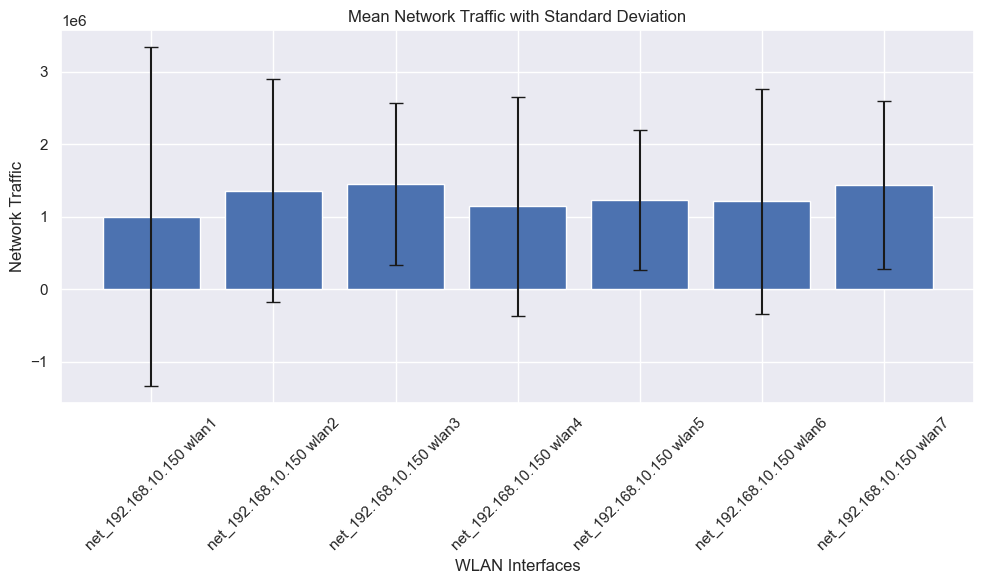

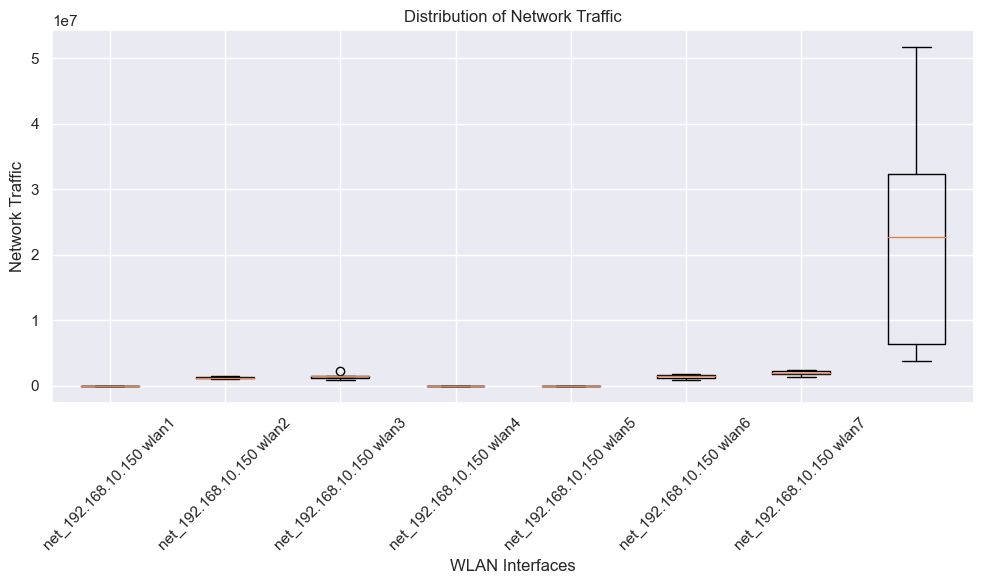

In [762]:
import matplotlib.pyplot as plt

# Extract the statistical measures from the DataFrame
count = df_recroom1_stats.loc['count']
mean = df_recroom1_stats.loc['mean']
std = df_recroom1_stats.loc['std']
min_val = df_recroom1_stats.loc['min']
q1 = df_recroom1_stats.loc['25%']
median = df_recroom1_stats.loc['50%']
q3 = df_recroom1_stats.loc['75%']
max_val = df_recroom1_stats.loc['max']

# Get the WLAN interface names
wlan_interfaces = df_recroom1_stats.columns

# Create the bar plot
plt.figure(figsize=(10, 6))
plt.bar(wlan_interfaces, mean, yerr=std, capsize=5)
plt.xlabel('WLAN Interfaces')
plt.ylabel('Network Traffic')
plt.title('Mean Network Traffic with Standard Deviation')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Create the box plot
plt.figure(figsize=(10, 6))
plt.boxplot(df_recroom1_stats.T)
plt.xlabel('WLAN Interfaces')
plt.ylabel('Network Traffic')
plt.title('Distribution of Network Traffic')
plt.xticks(range(1, len(wlan_interfaces) + 1), wlan_interfaces, rotation=45)
plt.tight_layout()
plt.show()


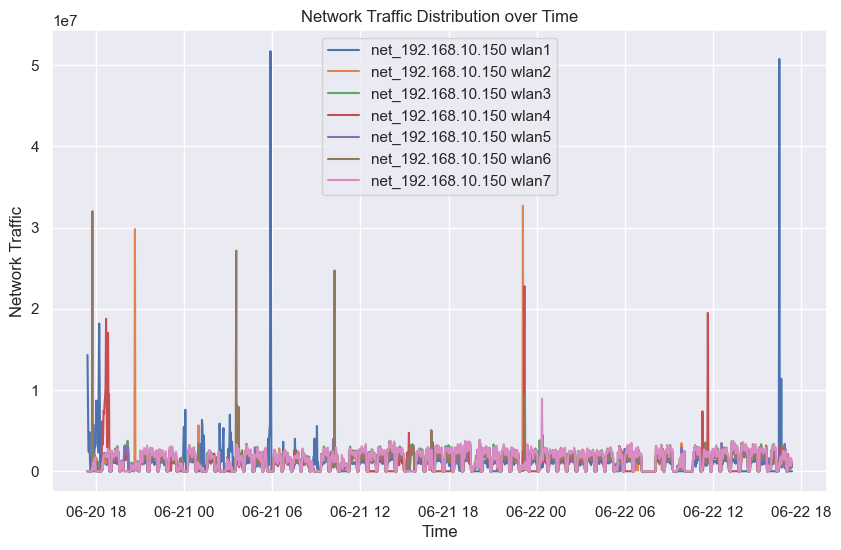

In [769]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set the style
sns.set_style('darkgrid')

# Create the line plot
plt.figure(figsize=(10, 6))
for column in df_recroom1_net.columns[1:]:
    sns.lineplot(data=df_recroom1_net, x='Time', y=column, label=column)

# Set the labels and title
plt.xlabel('Time')
plt.ylabel('Network Traffic')
plt.title('Network Traffic Distribution over Time')

# Display the plot
plt.legend()
plt.show()


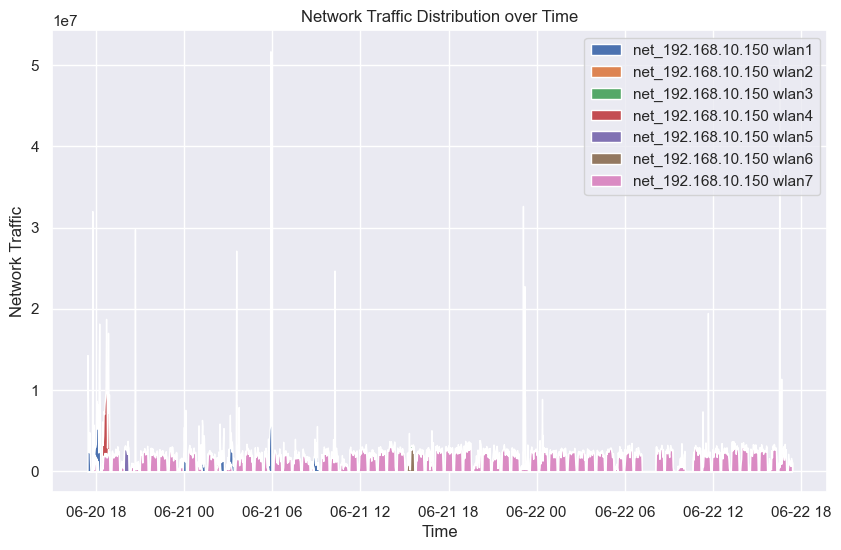

In [770]:
import matplotlib.pyplot as plt

# Create the area plot
plt.figure(figsize=(10, 6))
for column in df_recroom1_net.columns[1:]:
    plt.fill_between(df_recroom1_net['Time'], df_recroom1_net[column], label=column)

# Set the labels and title
plt.xlabel('Time')
plt.ylabel('Network Traffic')
plt.title('Network Traffic Distribution over Time')

# Display the plot
plt.legend()
plt.show()


In [771]:
import plotly.graph_objects as go

# Create the stacked area plot
fig = go.Figure()
for column in df_recroom1_net.columns[1:]:
    fig.add_trace(go.Scatter(x=df_recroom1_net['Time'], y=df_recroom1_net[column], mode='lines', name=column))

# Set the layout and title
fig.update_layout(xaxis_title='Time', yaxis_title='Network Traffic', title='Network Traffic Distribution over Time')

# Display the plot
fig.show()


In [780]:
import plotly.graph_objects as go

# Create the stacked area plot
fig = go.Figure()
for column in df_gallery1_net.columns[1:]:
    fig.add_trace(go.Scatter(x=df_gallery1_net['Time'], y=df_gallery1_net[column], mode='lines', name=column))

# Set the layout and title
fig.update_layout(xaxis_title='Time', yaxis_title='Network Traffic', title='Network Traffic Distribution over Time')

# Display the plot
fig.show()


In [782]:
import plotly.graph_objects as go

# Create the stacked area plot
fig = go.Figure()
for column in df_gallery2_net.columns[1:]:
    fig.add_trace(go.Scatter(x=df_gallery2_net.index, y=df_gallery2_net[column], mode='lines', name=column))

# Set the layout and title
fig.update_layout(xaxis_title='Time', yaxis_title='Network Traffic', title='Network Traffic Distribution over Time')

# Display the plot
fig.show()


In [783]:
import plotly.graph_objects as go

# Create the stacked area plot
fig = go.Figure()
for column in df_bedroom2_net.columns[1:]:
    fig.add_trace(go.Scatter(x=df_bedroom2_net.index, y=df_bedroom2_net[column], mode='lines', name=column))

# Set the layout and title
fig.update_layout(xaxis_title='Time', yaxis_title='Network Traffic', title='Network Traffic Distribution over Time')

# Display the plot
fig.show()


In [784]:
import plotly.graph_objects as go

# Create the stacked area plot
fig = go.Figure()
for column in df_recroom2_net.columns[1:]:
    fig.add_trace(go.Scatter(x=df_recroom2_net.index, y=df_recroom2_net[column], mode='lines', name=column))

# Set the layout and title
fig.update_layout(xaxis_title='Time', yaxis_title='Network Traffic', title='Network Traffic Distribution over Time')

# Display the plot
fig.show()


In [785]:
import plotly.graph_objects as go

# Create the stacked area plot
fig = go.Figure()
for column in df_bedroom1_net.columns[1:]:
    fig.add_trace(go.Scatter(x=df_bedroom1_net.index, y=df_bedroom1_net[column], mode='lines', name=column))

# Set the layout and title
fig.update_layout(xaxis_title='Time', yaxis_title='Network Traffic', title='Network Traffic Distribution over Time')

# Display the plot
fig.show()


In [786]:
import plotly.graph_objects as go

# Create the stacked area plot
fig = go.Figure()
for column in df_kitchen_net.columns[1:]:
    fig.add_trace(go.Scatter(x=df_kitchen_net.index, y=df_kitchen_net[column], mode='lines', name=column))

# Set the layout and title
fig.update_layout(xaxis_title='Time', yaxis_title='Network Traffic', title='Network Traffic Distribution over Time')

# Display the plot
fig.show()
